# Notebook Metadata

- **Notebook Name**: 02_model.ipynb
- **Title**: MoneyLion DS Assessment  
- **Author**: Khoon Ching Wong
- **Created**: 2024-09-24 
- **Last Modified**: 2025-09-25
- **Description**:
  <br>Continuation of `01_eda.ipynb`.
  <br>This notebook focuses on model training, where Optuna is applied for hyperparameter optimization, model selection and performance reporting, with the goal of minimizing institutional financial losses.
- **Inputs**:
  - temp/Loan-level/clean_df.parquet
- **Outputs**:  
  - temp/Loan-level/best_trials_ClassifierX.json
  - temp/Loan-level/all_metrics_ClassifierX.csv
  - temp/Loan-level/cm_final_ClassifierX.csv
  - temp/Loan-level/df_metrics_ClassifierX.csv
  - temp/Loan-level/exec_time_ClassifierX.csv
  - temp/Loan-level/lloss_auc_test_ClassifierX.csv
  - temp/Loan-level/lloss_auc_train_ClassifierX.csv
  - temp/Loan-level/cm_ClassifierX_all.pkl
  - temp/Loan-level/cm_labels_ClassifierX_all.pkl
- **Repository/Project Link**: https://github.com/wongkhoon/DS-Assessment/tree/main/MoneyLion/notebooks

# Import libraries

In [1]:
import gc
import os
import platform
from IPython.display import display, Markdown, HTML
import json
import pickle

import pandas as pd
import numpy as np
from collections import Counter

import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns

from tqdm import tqdm
import time
import logging
import optuna
import optunahub
from optuna.visualization import plot_pareto_front

import lightgbm as lgb

import sklearn.datasets
from sklearn.model_selection import GroupShuffleSplit, StratifiedGroupKFold
from sklearn.utils.class_weight import compute_sample_weight

from catboost import Pool
from catboost import CatBoostClassifier

import xgboost as xgb
from xgboost import XGBClassifier

from sklearn.ensemble import HistGradientBoostingClassifier

from sklearn.metrics import log_loss, average_precision_score, roc_curve, roc_auc_score, precision_recall_curve
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

import session_info

# Display settings configuration
- Configure display settings for enhanced output in Jupyter notebook

In [2]:
# Display full output in output cell, not only last result
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

# Maximum rows and columns of Pandas DataFrame
# pd.options.display.max_rows,
pd.options.display.max_columns

# Print all the contents of a Pandas DataFrame
#pd.set_option('display.max_rows', None) # Print unlimited number of rows by setting to None, default is 10
pd.set_option("display.max_columns", None) # Do not truncate cols to display all of them by setting to None
pd.set_option("display.width", None) # Auto-detect the width of df to display all columns in single line by setting to None
pd.set_option("display.max_colwidth", None) # Auto detect the max size of col and print contents of that col without truncation

# Create Temporary Directory for Intermediate Files
- Create a `temp` directory to store intermediate files (e.g. model metrics, Optuna trials).  
- These files will be reused for generating plots and tables, as well as for reloading intermediate data i.e. `clean_df.parquet`.

In [3]:
# Create the directory path if it doesn't exist and raise no errors if already exist
os.makedirs("temp/Loan-level", exist_ok = True)
temp_dir = "temp/Loan-level"

# Function

In [4]:
def save_results(clf_name, best_trials,
                 exec_time, lloss_auc_train, lloss_auc_test,
                 df_metrics, cm_final, cm_all, cm_labels):
    """
    Save results for a given classifier.
    
    Parameters:
        clf_name (str): Name identifier for the algorithm.
        exec_time (list of dict): Execution time data.
        lloss_auc_train (list of dict): Training log loss/AUC metrics.
        lloss_auc_test (list of dict): Test log loss/AUC metrics.
        df_metrics (pd.DataFrame): Additional metrics in Pandas DataFrame form.
        cm_final (array-like): The final confusion matrix.
        cm_all (list): List of confusion matrices for trials.
        cm_labels (list): Corresponding labels for the confusion matrices.
    """
    
    # Save tabular data as CSV
    pd.DataFrame(exec_time).to_csv(f'{temp_dir}/exec_time_{clf_name}.csv', index = False)
    pd.DataFrame(lloss_auc_train).to_csv(f'{temp_dir}/lloss_auc_train_{clf_name}.csv', index = False)
    pd.DataFrame(lloss_auc_test).to_csv(f'{temp_dir}/lloss_auc_test_{clf_name}.csv', index = False)
    pd.DataFrame(all_metrics).to_csv(f'{temp_dir}/all_metrics_{clf_name}.csv', index = False)
    df_metrics.to_csv(f'{temp_dir}/df_metrics_{clf_name}.csv', index = False)
    pd.DataFrame(cm_final).to_csv(f'{temp_dir}/cm_final_{clf_name}.csv', index = False)

    # Saves all the parameters of the best trial(s) into a JSON file
    with open(f'{temp_dir}/best_trials_{clf_name}.json', "w") as f:
        json.dump(best_trials, f, indent = 4)

    # Pickle complex objects (like lists, matrices, etc)
    with open(f'{temp_dir}/cm_{clf_name}_all.pkl', "wb") as f:
        pickle.dump(cm_all, f)
        
    with open(f'{temp_dir}/cm_labels_{clf_name}_all.pkl', "wb") as f:
        pickle.dump(cm_labels, f)

# Load Parquet Data File
- Load the processed Parquet data file generated in `01_eda.ipynb`
- Drop columns not of interest

In [5]:
# Load aggregated loan level parquet data file
clean_df = pd.read_parquet(f'{temp_dir}/clean_df.parquet', engine = "pyarrow")

#clean_df.columns.tolist()

# Drop columns not of interest
cols_to_drop = ["underwritingid", "loanId", "clarityFraudId",
                "applicationDate", "originatedDate",
                "loanStatus", "fpymtDate", "fpymtAmt", "fpymtStatus", "yr_mth", "mth",
                "principal_tot", "fees_tot", "paymentAmount_tot"]

clean_df.drop(columns = cols_to_drop,  inplace = True)

clean_df.info(verbose = "all")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32312 entries, 0 to 32311
Data columns (total 270 columns):
 #    Column                                           Dtype   
---   ------                                           -----   
 0    cfinq.thirtydaysago                              Int32   
 1    cfinq.twentyfourhoursago                         Int32   
 2    cfinq.oneminuteago                               Int32   
 3    cfinq.onehourago                                 Int32   
 4    cfinq.ninetydaysago                              Int32   
 5    cfinq.sevendaysago                               Int32   
 6    cfinq.tenminutesago                              Int32   
 7    cfinq.fifteendaysago                             Int32   
 8    cfinq.threesixtyfivedaysago                      Int32   
 9    cfind.inquiryonfilecurrentaddressconflict        boolean 
 10   cfind.totalnumberoffraudindicators               Int32   
 11   cfind.telephonenumberinconsistentwithaddress     boo

In [6]:
"""
# Print counts of unique values for all columns
for col in clean_df.columns:
    print(f'Value counts for column: {col}')
    print(clean_df[col].value_counts(dropna = False))  # Count occurrences of each unique value
    print("-" * 40)
""";

# Models
- **Identity and hashing assumption**
<br>- Assume a consistent, deterministic hashing algorithm that yields a unique hash for every loan applicant (`anon_ssn`)

- **Data splitting**
<br>- Train–test (80/20) with `GroupShuffleSplit` so that no `anon_ssn` appears in both train and test


- **Cross-validation on the training split**
<br>- `StratifiedGroupKFold` (5 folds) to:
    - Keep all samples from the same `anon_ssn` in the same fold (prevent leakage)
    - Preserve class balance
    - Use shuffling and a fixed `random_state` for robustness and reproducibility
<p></p>

- **Models (tree-based gradient boosting)**
  <br>- [LightGBM](#Optuna-with-LightGBM-Classifier): Grows trees by expanding the single branch that improves accuracy the most
  <br>- [HistGradientBoostingClassifier](#Optuna-with-HistGradientBoostingClassifier): Grows trees step by step, testing options in groups (buckets) for speed
  <br>- [XGBoost](#Optuna-with-XGB-Classifier): Grows trees evenly level by level, keeping the structure balanced
  <br>- [CatBoostClassifier](#Optuna-with-CatBoostClassifier): Grows trees in a perfectly symmetrical way, splitting all branches the same way at each step
  
<p>&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;Advantages of these classifiers:  
  <br>&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;- Require minimal preprocessing (e.g. no need for extensive encoding or scaling)  
  <br>&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;- Less sensitive to outliers in the data  
  <br>&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;- Less sensitive to multicollinearity  
  <br>&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;- Capable of capturing non-linear relationships effectively  
  <br>&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;- Support categorical features natively

- **Hyperparameter optimization**
<br>  - Optuna multi-objective hyperparameter optimization with stratified 5-fold CV over 100 sequential trials:
    - Calibration: *Log-loss* (minimize) — evaluates how closely the predicted probabilities match the true outcomes. Lower values indicate better probability calibration.
    - Discrimination: *PR-AUC* and *ROC-AUC* (maximize)
      <br>- *ROC-AUC*: Measures how well the model separates positives from negatives across all decision thresholds.
      <br>- *PR-AUC*: Focuses on precision–recall trade-offs, particularly valuable for imbalanced datasets where one class is much rarer.
<p></p>
      
- **Evaluation and reporting**
  <br>- Report objective metrics above (on CV and hold-out test)
  <br>- Confusion matrix and classification report
  <br>- Elapsed time

In [7]:
# Runs the objective() function 100 times, each with a different set of hyperparameters suggested by Optuna
n_trials = 100

In [8]:
# Unsure which sampler to use so load the AutoSampler plugin from OptunaHub to automatically select the most suitable built-in sampler for the search space during Optuna optimization
module = optunahub.load_module(package = "samplers/auto_sampler")

In [9]:
seed = 42

## Optuna with LightGBM

In [10]:
# Aggregated loan level data
X_df = clean_df.drop(columns = ["target", "anon_ssn"])

cat_cols = X_df.select_dtypes(include = "category").columns
cat_indices = [X_df.columns.get_loc(col) for col in cat_cols]

X_df = X_df.apply(lambda x: x.map(lambda z: np.nan if pd.isna(z) else z)) 
feature_name = list(X_df.columns)

y_df = clean_df["target"]

# Extract the grouping variable, anon_ssn
anon_ssn = clean_df["anon_ssn"];

In [11]:
# Convert categorical columns to numerical codes for Optuna with LightGBM, with NaN as -1
for col in X_df.columns:
    if isinstance(X_df[col].dtype, pd.CategoricalDtype):
        #print(col+": ordered?", {X_df[col].cat.ordered})
        X_df[col] = X_df[col].cat.codes

In [12]:
X = X_df.to_numpy()
y = y_df.to_numpy()

In [13]:
# A single train-test split (80%-20%) using GroupShuffleSplit, ensuring no data leakage due anon_ssn (grouped by anon_ssn) appear in both sets
# and use a fixed random seed for reproducibility
gss = GroupShuffleSplit(n_splits = 1, test_size = 0.2, random_state = seed)

# Generate the train and test indices from X, y, while ensuring all samples from the same anon_ssn stay together in train or test sets
train_idx, test_idx = next(gss.split(X, y, groups = anon_ssn))

# Use the indices to slice out the training and testing subsets of our feature matrix
X_train, X_test = X[train_idx], X[test_idx]

# Likewise, slice out the corresponding labels for training and testing
y_train, y_test = y[train_idx], y[test_idx]

# Keep track of anon_ssn for cross-validation
anon_ssn_train = anon_ssn[train_idx]  

In [14]:
display(Markdown(f"<span style = 'font-size: 18px; font-weight: bold;'> Overview of training and test sets:</span>"))

print(f'Training set:\n- {X_train.shape[0]} rows and {X_train.shape[1]} features')
print(f'- Target proportion:\n{pd.Series(y_train).value_counts(normalize = True)}\n')

print(f'Test set:\n- {X_test.shape[0]} rows and {X_test.shape[1]} features')
print(f'- Target proportion:\n{pd.Series(y_test).value_counts(normalize = True)}\n')

print(f'Training set for anon_ssn: {anon_ssn_train.shape[0]} row entries with {anon_ssn_train.nunique()} unique anon_ssn values')

<span style = 'font-size: 18px; font-weight: bold;'> Overview of training and test sets:</span>

Training set:
- 25838 rows and 268 features
- Target proportion:
0    0.507973
1    0.492027
Name: proportion, dtype: float64

Test set:
- 6474 rows and 268 features
- Target proportion:
0    0.505715
1    0.494285
Name: proportion, dtype: float64

Training set for anon_ssn: 25838 row entries with 24008 unique anon_ssn values


The target distribution between safe and risky loans does not suffer from severe class imbalance and is well balanced across both the training and test sets.

In [15]:
del X_df, y_df, X, y, gss, train_idx, test_idx;

In [16]:
# Define the Optuna objective function
def objective(trial):
    # https://lightgbm.readthedocs.io/en/latest/Parameters.html
    # https://lightgbm.readthedocs.io/en/stable/Parameters.html
    # https://lightgbm.readthedocs.io/en/latest/Parameters-Tuning.html
    # Define parameter search space
    param = {"objective": "binary",
             "metric": ["binary_logloss", "auc", "average_precision"],
             "device_type": "cpu",
             #"device_type": "gpu",  # Uses OpenCL backend on Windows
             #"gpu_platform_id": 0,
             #"gpu_device_id": 0,   
             "verbosity": 2,
             "boosting_type": trial.suggest_categorical("boosting_type", ["gbdt", "rf", "dart"]),
             "lambda_l1": trial.suggest_float("lambda_l1", 1e-8, 1e1, log = True),
             "lambda_l2": trial.suggest_float("lambda_l2", 1e-8, 1e1, log = True),
             "num_leaves": trial.suggest_int("num_leaves", 2, 256),
             "feature_fraction": trial.suggest_float("feature_fraction", 1e-1, 1e0),
             "bagging_fraction": trial.suggest_float("bagging_fraction", 1e-1, 1e0),
             "bagging_freq": trial.suggest_int("bagging_freq", 1, 10),
             "min_child_samples": trial.suggest_int("min_child_samples", 5, 200),
             "learning_rate": trial.suggest_float("learning_rate", 1e-2, 1e-1, log = True),
             "random_state": seed,
             "deterministic": True,
             "bagging_seed": seed,
             "feature_fraction_seed": seed,  
             "drop_seed": seed,
             "force_col_wise": True,
             "num_threads": -1, 
             "is_unbalance": trial.suggest_categorical("is_unbalance", [True, False]),
             "max_depth": -1, # <= 0, No tree depth limit
             "max_bin": trial.suggest_int("max_bin", 40, 255),
             "min_sum_hessian_in_leaf": trial.suggest_float("min_sum_hessian_in_leaf", 1e-10, 1e1, log = True),
             "max_delta_step": trial.suggest_float("max_delta_step", 1, 100),
             "feature_fraction_bynode": trial.suggest_float("feature_fraction_bynode", 1e-1, 1e0),
            }

    # Define how to split using StratifiedGroupKFold (5 folds, stratified, anon_ssn-safe)
    sgkf = StratifiedGroupKFold(n_splits = 5, shuffle = True, random_state = seed)

    # Lists to store the performance metrics from each fold
    lloss_scores, pr_auc_scores, roc_auc_scores = [], [], []

    # Iterate over each fold of the stratified, anon_ssn-aware split, numbering folds starting from 1
    for fold_idx, (train_index, valid_index) in enumerate(sgkf.split(X_train, y_train, groups = anon_ssn_train), start = 1):

        # Split into training and validation sets for this fold
        X_train_fold, X_valid_fold = X_train[train_index], X_train[valid_index]
        y_train_fold, y_valid_fold = y_train[train_index], y_train[valid_index]

        # Summarize the composition of classes in the train and validation sets
        train_0, train_1 = len(y_train_fold[y_train_fold == 0]), len(y_train_fold[y_train_fold == 1])
        valid_0, valid_1 = len(y_valid_fold[y_valid_fold == 0]), len(y_valid_fold[y_valid_fold == 1])
       
        print(f'Trial {trial.number}, Fold {fold_idx}: Train size = {len(train_index)} where 0 = {train_0}, 1 = {train_1}, 0/1 = {train_0/train_1}')
        print(f'Trial {trial.number}, Fold {fold_idx}: Validation size = {len(valid_index)} where  0 = {valid_0}, 1 = {valid_1}, 0/1 = {valid_0/valid_1}')

        # Create LightGBM datasets for efficient training
        dtrain_fold = lgb.Dataset(X_train_fold, label = y_train_fold, categorical_feature = cat_indices)
        dvalid_fold = lgb.Dataset(X_valid_fold, label = y_valid_fold)

        # Suggest the number of boosting rounds (trees) for the LightGBM model
        # This value is being tuned using Optuna's suggest_int method, which picks an integer between 50 and 500
        # The number of boosting rounds defines how many trees are built during training
        num_round = trial.suggest_int("num_boost_round", 5, 100)
      
        # https://lightgbm.readthedocs.io/en/stable/pythonapi/lightgbm.train.html
        # Train the LightGBM model using the provided parameters and training data
        # The num_boost_round parameter is specified separately rather than included in the param dictionary
        # This is because num_boost_round is not a model hyperparameter that affects the tree-building process,
        # but rather controls the number of boosting iterations during training.
        # Including it as a separate argument in lgb.train allows for more flexible and clear tuning using Optuna    
        start_fold = time.perf_counter()
        clf = lgb.train(params = param, train_set = dtrain_fold, 
                        num_boost_round = num_round,  # Get num_rounds from Optuna
                        valid_sets = [dvalid_fold]
                       )  
        end_fold = time.perf_counter()

        # Predict probabilities and convert to binary labels at 0.5 threshold
        y_prob_fold = clf.predict(X_valid_fold)
        y_pred_fold = np.rint(y_prob_fold) # Set y_pred_fold = 1 if y_prob_fold => 0.5 and 0 if y_prob_fold < 0.5
        
        print(f'Trial {trial.number}, Fold {fold_idx}: '
              f'Log loss = {log_loss(y_valid_fold, y_prob_fold)}, '
              f'Average precision = {average_precision_score(y_valid_fold, y_prob_fold)}, '
              f'ROC-AUC = {roc_auc_score(y_valid_fold, y_prob_fold)}, '
              f'Elapsed Time = {end_fold - start_fold} seconds')         
        
        # Calculate and store the evaluation metrics for this fold
        lloss_scores.append(log_loss(y_valid_fold, y_prob_fold))
        pr_auc_scores.append(average_precision_score(y_valid_fold, y_prob_fold))
        roc_auc_scores.append(roc_auc_score(y_valid_fold, y_prob_fold))

        del X_train_fold, X_valid_fold, y_train_fold, y_valid_fold, dtrain_fold, dvalid_fold, clf, start_fold, end_fold
        gc.collect()

    # Calculate average metrics across all folds for Optuna to optimize
    mean_lloss = np.mean(lloss_scores)
    mean_pr_auc = np.mean(pr_auc_scores)
    mean_roc_auc = np.mean(roc_auc_scores)

    del lloss_scores, pr_auc_scores, roc_auc_scores
    gc.collect()
    
    #  Return the metrics to Optuna for optimization
    return mean_lloss, mean_pr_auc, mean_roc_auc

Optimization Progress:   0%|          | 0/100 [00:00<?, ?it/s]

Trial 0, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 0, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 11600
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 5235 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 42 and depth = 9
[LightGBM] [Debug] Re-bagging, using 5180 data to train
[LightGBM] [

Optimization Progress:   1%|1         | 1/100 [00:15<25:26, 15.42s/it]

Trial 1, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 1, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 21036
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 15798 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 56 and depth = 11
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 62 and depth = 10
[LightGBM] [Warning] No further splits with positive gain, best ga

Optimization Progress:   2%|2         | 2/100 [00:33<27:54, 17.08s/it]

Trial 2, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 2, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 10006
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 15148 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 51 and depth = 12
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 56 and depth = 13
[LightGBM] [Warning] No further splits with positive gain, best ga

Optimization Progress:   3%|3         | 3/100 [00:49<26:41, 16.51s/it]

Trial 3, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 3, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.805817
[LightGBM] [Info] Total Bins 24071
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 267
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 5514 data to train
[LightGBM] [Debug] Trained a tree with leaves = 17 and depth = 6
[LightGBM] [Debug] Trained a tree with leaves = 17 and depth = 7
[LightGBM] [Debug] Trained a tree with leaves = 17 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 17 and depth = 6
[LightGBM] [Debug] Trained a tree with leaves = 17 and depth = 8
[LightGBM] [Debug] Train

Optimization Progress:   4%|4         | 4/100 [01:00<22:48, 14.26s/it]

Trial 4, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 4, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 8523
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 4037 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 14 and depth = 5
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 17 and depth = 6
[LightGBM] [Warning] No further splits with positive gain, best gain: 

Optimization Progress:   5%|5         | 5/100 [01:10<20:19, 12.84s/it]

Trial 5, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 5, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 27687
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 8104 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 32 and depth = 8
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 35 and depth = 9
[LightGBM] [Warning] No further splits with positive gain, best gain:

Optimization Progress:   6%|6         | 6/100 [01:21<19:00, 12.13s/it]

Trial 6, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 6, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.792997
[LightGBM] [Info] Total Bins 20218
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 256
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 12618 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 71 and depth = 12
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 96 and depth = 14
[LightGBM] [Debug] Re-bagging, using 12655 data to train
[LightGBM

Optimization Progress:   7%|7         | 7/100 [01:31<17:55, 11.57s/it]

Trial 7, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 7, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 11147
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 9953 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 65 and depth = 12
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 64 and depth = 12
[LightGBM] [Warning] No further splits with positive gain, best gai

Optimization Progress:   8%|8         | 8/100 [01:47<19:41, 12.85s/it]

Trial 8, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 8, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 7358
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 9522 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 26 and depth = 7
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 25 and depth = 7
[LightGBM] [Warning] No further splits with positive gain, best gain: 

Optimization Progress:   9%|9         | 9/100 [02:02<20:23, 13.45s/it]

Trial 9, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 9, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 17568
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 3223 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 16 and depth = 6
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 15 and depth = 7
[LightGBM] [Warning] No further splits with positive gain, best gain:

Optimization Progress:  10%|#         | 10/100 [02:13<19:19, 12.88s/it]

Trial 10, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 10, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.796981
[LightGBM] [Info] Total Bins 9564
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 259
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 6184 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 57 and depth = 10
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 67 and depth = 14
[LightGBM] [Warning] No further splits with positive gain, best ga

Optimization Progress:  11%|#1        | 11/100 [02:27<19:42, 13.29s/it]

Trial 11, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 11, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 19014
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 10167 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 34 and depth = 8
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 39 and depth = 9
[LightGBM] [Warning] No further splits with positive gain, best ga

Optimization Progress:  12%|#2        | 12/100 [02:40<19:21, 13.20s/it]

Trial 12, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 12, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 8297
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 6273 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Re-bagging, using 6246 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 57 and depth = 10
[LightGBM]

Optimization Progress:  13%|#3        | 13/100 [02:52<18:29, 12.76s/it]

Trial 13, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 13, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.804600
[LightGBM] [Info] Total Bins 29002
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 265
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 19497 data to train
[LightGBM] [Debug] Trained a tree with leaves = 209 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 209 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 209 and depth = 19
[LightGBM] [Debug] Re-bagging, using 19452 data to train
[LightGBM] [Debug] Trained a tree with leaves = 209 and depth = 20
[LightGBM] [Debug] Tr

Optimization Progress:  14%|#4        | 14/100 [03:11<21:02, 14.68s/it]

Trial 14, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 14, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 12063
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 18369 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 34 and depth = 9
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 35 and depth = 10
[LightGBM] [Warning] No further splits with positive gain, best g

Optimization Progress:  15%|#5        | 15/100 [03:23<19:19, 13.65s/it]

Trial 15, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 15, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 19890
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 10808 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 26 and depth = 10
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 24 and depth = 7
[LightGBM] [Warning] No further splits with positive gain, best g

Optimization Progress:  16%|#6        | 16/100 [03:34<18:13, 13.02s/it]

Trial 16, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 16, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 24804
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 2947 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 26 and depth = 7
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 24 and depth = 6
[LightGBM] [Warning] No further splits with positive gain, best gai

Optimization Progress:  17%|#7        | 17/100 [03:49<18:40, 13.51s/it]

Trial 17, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 17, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.794337
[LightGBM] [Info] Total Bins 10352
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 257
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 3248 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 18 and depth = 6
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 19 and depth = 6
[LightGBM] [Warning] No further splits with positive gain, best gai

Optimization Progress:  18%|#8        | 18/100 [04:05<19:29, 14.26s/it]

Trial 18, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 18, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 7940
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 6760 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 34 and depth = 8
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 33 and depth = 8
[LightGBM] [Debug] Re-bagging, using 6778 data to train
[LightGBM] [

Optimization Progress:  19%|#9        | 19/100 [04:18<18:56, 14.03s/it]

Trial 19, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 19, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.796981
[LightGBM] [Info] Total Bins 21915
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 259
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 8731 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 72 and depth = 16
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 88 and depth = 15
[LightGBM] [Warning] No further splits with positive gain, best g

Optimization Progress:  20%|##        | 20/100 [04:44<23:14, 17.43s/it]

Trial 20, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 20, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 14105
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 9540 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 47 and depth = 9
[LightGBM] [Warning] No further splits with positive gain, best ga

Optimization Progress:  21%|##1       | 21/100 [04:59<22:04, 16.77s/it]

Trial 21, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 21, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 15336
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 10556 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 44 and depth = 10
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 54 and depth = 11
[LightGBM] [Warning] No further splits with positive gain, best 

Optimization Progress:  22%|##2       | 22/100 [05:10<19:37, 15.10s/it]

Trial 22, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 22, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.790295
[LightGBM] [Info] Total Bins 22226
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 254
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 14649 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 24 and depth = 11
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 19 and depth = 8
[LightGBM] [Warning] No further splits with positive gain, best g

Optimization Progress:  23%|##3       | 23/100 [05:22<18:10, 14.16s/it]

Trial 23, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 23, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 16789
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 14527 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 54 and depth = 11
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 55 and depth = 11
[LightGBM] [Warning] No further splits with positive gain, best 

Optimization Progress:  24%|##4       | 24/100 [05:34<17:10, 13.55s/it]

Trial 24, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 24, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 27471
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 2806 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 12 and depth = 4
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 11 and depth = 4
[LightGBM] [Warning] No further splits with positive gain, best gai

Optimization Progress:  25%|##5       | 25/100 [05:46<16:26, 13.15s/it]

Trial 25, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 25, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 24366
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 10496 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 47 and depth = 9
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 44 and depth = 10
[LightGBM] [Debug] Re-bagging, using 10463 data to train
[LightGB

Optimization Progress:  26%|##6       | 26/100 [06:06<18:29, 14.99s/it]

Trial 26, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 26, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 29191
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 16006 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 31 and depth = 10
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 45 and depth = 8
[LightGBM] [Warning] No further splits with positive gain, best g

Optimization Progress:  27%|##7       | 27/100 [06:21<18:31, 15.22s/it]

Trial 27, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 27, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 11253
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 7912 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 33 and depth = 9
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 32 and depth = 8
[LightGBM] [Warning] No further splits with positive gain, best gai

Optimization Progress:  28%|##8       | 28/100 [06:33<17:04, 14.23s/it]

Trial 28, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 28, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 28226
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 3312 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 9 and depth = 4
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 10 and depth = 4
[LightGBM] [Warning] No further splits with positive gain, best gain

Optimization Progress:  29%|##9       | 29/100 [06:43<15:19, 12.95s/it]

Trial 29, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 29, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 23584
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 13595 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 65 and depth = 14
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 74 and depth = 12
[LightGBM] [Warning] No further splits with positive gain, best 

Optimization Progress:  30%|###       | 30/100 [06:57<15:15, 13.08s/it]

Trial 30, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 30, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 8631
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 7776 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 9 and depth = 4
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 9 and depth = 4
[LightGBM] [Warning] No further splits with positive gain, best gain: 

Optimization Progress:  31%|###1      | 31/100 [07:10<14:57, 13.01s/it]

Trial 31, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 31, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 9440
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 16585 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 60 and depth = 14
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 70 and depth = 11
[LightGBM] [Warning] No further splits with positive gain, best g

Optimization Progress:  32%|###2      | 32/100 [07:24<15:15, 13.47s/it]

Trial 32, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 32, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 24150
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 7527 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 30 and depth = 9
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 32 and depth = 7
[LightGBM] [Warning] No further splits with positive gain, best gai

Optimization Progress:  33%|###3      | 33/100 [07:41<16:15, 14.56s/it]

Trial 33, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 33, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 12184
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 5834 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 19 and depth = 6
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 20 and depth = 7
[LightGBM] [Warning] No further splits with positive gain, best gai

Optimization Progress:  34%|###4      | 34/100 [07:54<15:23, 13.99s/it]

Trial 34, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 34, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 15448
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 7530 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 22 and depth = 7
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 25 and depth = 7
[LightGBM] [Debug] Re-bagging, using 7591 data to train
[LightGBM] 

Optimization Progress:  35%|###5      | 35/100 [08:07<14:52, 13.72s/it]

Trial 35, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 35, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 7358
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 2241 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 10 and depth = 4
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 10 and depth = 4
[LightGBM] [Warning] No further splits with positive gain, best gain

Optimization Progress:  36%|###6      | 36/100 [08:19<14:00, 13.13s/it]

Trial 36, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 36, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 11033
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 11682 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 77 and depth = 13
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 92 and depth = 13
[LightGBM] [Warning] No further splits with positive gain, best 

Optimization Progress:  37%|###7      | 37/100 [08:32<13:49, 13.16s/it]

Trial 37, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 37, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 23907
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 17461 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 69 and depth = 12
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 83 and depth = 13
[LightGBM] [Warning] No further splits with positive gain, best 

Optimization Progress:  38%|###8      | 38/100 [08:44<13:16, 12.84s/it]

Trial 38, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 38, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.798290
[LightGBM] [Info] Total Bins 17915
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 260
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 14894 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 44 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 81 and depth = 13
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 56 and depth = 1

Optimization Progress:  39%|###9      | 39/100 [08:55<12:27, 12.25s/it]

Trial 39, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 39, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 20107
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 6705 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 27 and depth = 7
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 34 and depth = 10
[LightGBM] [Debug] Re-bagging, using 6698 data to train
[LightGBM]

Optimization Progress:  40%|####      | 40/100 [09:11<13:26, 13.44s/it]

Trial 40, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 40, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.790295
[LightGBM] [Info] Total Bins 27148
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 254
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 18199 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 60 and depth = 11
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 56 and depth = 10
[LightGBM] [Warning] No further splits with positive gain, best 

Optimization Progress:  41%|####1     | 41/100 [09:28<14:13, 14.47s/it]

Trial 41, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 41, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 25876
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 5292 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 43 and depth = 9
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 41 and depth = 10
[LightGBM] [Debug] Re-bagging, using 5231 data to train
[LightGBM]

Optimization Progress:  42%|####2     | 42/100 [09:45<14:43, 15.23s/it]

Trial 42, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 42, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.805817
[LightGBM] [Info] Total Bins 16928
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 267
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 5608 data to train
[LightGBM] [Debug] Trained a tree with leaves = 104 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 104 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 104 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 104 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 104 and depth = 16
[LightGBM] [

Optimization Progress:  43%|####3     | 43/100 [10:03<15:17, 16.10s/it]

Trial 43, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 43, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.790295
[LightGBM] [Info] Total Bins 20104
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 254
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 15800 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 19 and depth = 9
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 25 and depth = 8
[LightGBM] [Debug] Re-bagging, using 15945 data to train
[LightGBM

Optimization Progress:  44%|####4     | 44/100 [10:14<13:28, 14.45s/it]

Trial 44, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 44, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 12968
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 3425 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 6 and depth = 4
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 6 and depth = 3
[LightGBM] [Warning] No further splits with positive gain, best gain:

Optimization Progress:  45%|####5     | 45/100 [10:26<12:38, 13.78s/it]

Trial 45, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 45, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.796981
[LightGBM] [Info] Total Bins 14564
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 259
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 9603 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 29 and depth = 8
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 22 and depth = 6
[LightGBM] [Warning] No further splits with positive gain, best gai

Optimization Progress:  46%|####6     | 46/100 [10:39<12:05, 13.44s/it]

Trial 46, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 46, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.796981
[LightGBM] [Info] Total Bins 15571
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 259
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 17830 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 178 and depth = 19
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 201 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 206 and depth 

Optimization Progress:  47%|####6     | 47/100 [10:50<11:18, 12.80s/it]

Trial 47, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 47, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.794337
[LightGBM] [Info] Total Bins 22776
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 257
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 10427 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 62 and depth = 14
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 64 and depth = 12
[LightGBM] [Warning] No further splits with positive gain, best 

Optimization Progress:  48%|####8     | 48/100 [11:04<11:26, 13.20s/it]

Trial 48, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 48, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 25983
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 5347 data to train
[LightGBM] [Debug] Trained a tree with leaves = 36 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 36 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 36 and depth = 7
[LightGBM] [Debug] Trained a tree with leaves = 36 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 36 and depth = 11
[LightGBM] [Debug] T

Optimization Progress:  49%|####9     | 49/100 [11:17<11:16, 13.26s/it]

Trial 49, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 49, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 24796
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 12453 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 33 and depth = 9
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 33 and depth = 8
[LightGBM] [Warning] No further splits with positive gain, best ga

Optimization Progress:  50%|#####     | 50/100 [11:32<11:18, 13.58s/it]

Trial 50, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 50, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 15120
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 14380 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 48 and depth = 13
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 53 and depth = 11
[LightGBM] [Warning] No further splits with positive gain, best 

Optimization Progress:  51%|#####1    | 51/100 [11:43<10:28, 12.83s/it]

Trial 51, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 51, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 24796
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 12453 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 48 and depth = 10
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 59 and depth = 11
[LightGBM] [Warning] No further splits with positive gain, best 

Optimization Progress:  52%|#####2    | 52/100 [12:00<11:15, 14.07s/it]

Trial 52, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 52, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 25876
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 5347 data to train
[LightGBM] [Debug] Trained a tree with leaves = 36 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 36 and depth = 10
[LightGBM] [Debug] Re-bagging, using 5294 data to train
[LightGBM] [Debug] Trained a tree with leaves = 36 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 36 and depth = 8
[LightGBM] [Debug] Re-bagging,

Optimization Progress:  53%|#####3    | 53/100 [12:12<10:34, 13.51s/it]

Trial 53, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 53, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.805817
[LightGBM] [Info] Total Bins 16928
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 267
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 5608 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 145 and depth = 20
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 153 and depth = 20
[LightGBM] [Warning] No further splits with positive gain, best

Optimization Progress:  54%|#####4    | 54/100 [12:38<13:16, 17.32s/it]

Trial 54, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 54, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 7940
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 5347 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 25 and depth = 7
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 30 and depth = 7
[LightGBM] [Warning] No further splits with positive gain, best gain

Optimization Progress:  55%|#####5    | 55/100 [12:50<11:43, 15.64s/it]

Trial 55, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 55, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 15120
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 5834 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 17 and depth = 6
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 21 and depth = 7
[LightGBM] [Warning] No further splits with positive gain, best gai

Optimization Progress:  56%|#####6    | 56/100 [13:00<10:12, 13.92s/it]

Trial 56, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 56, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 7940
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 7530 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 24 and depth = 6
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 21 and depth = 6
[LightGBM] [Debug] Re-bagging, using 7591 data to train
[LightGBM] [

Optimization Progress:  57%|#####6    | 57/100 [13:12<09:31, 13.30s/it]

Trial 57, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 57, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 7358
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 2241 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 10 and depth = 4
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 10 and depth = 4
[LightGBM] [Warning] No further splits with positive gain, best gain

Optimization Progress:  58%|#####8    | 58/100 [13:24<09:08, 13.05s/it]

Trial 58, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 58, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 11147
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 5292 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 41 and depth = 9
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 39 and depth = 10
[LightGBM] [Warning] No further splits with positive gain, best ga

Optimization Progress:  59%|#####8    | 59/100 [13:38<09:03, 13.26s/it]

Trial 59, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 59, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 7940
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 6760 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 34 and depth = 8
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 33 and depth = 8
[LightGBM] [Debug] Re-bagging, using 6778 data to train
[LightGBM] [

Optimization Progress:  60%|######    | 60/100 [13:50<08:36, 12.91s/it]

Trial 60, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 60, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 24804
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 10496 data to train
[LightGBM] [Debug] Trained a tree with leaves = 48 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 48 and depth = 9
[LightGBM] [Debug] Re-bagging, using 10463 data to train
[LightGBM] [Debug] Trained a tree with leaves = 48 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 48 and depth = 12
[LightGBM] [Debug] Re-bagg

Optimization Progress:  61%|######1   | 61/100 [14:01<08:01, 12.34s/it]

Trial 61, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 61, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 12968
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 3425 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 7 and depth = 4
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 6 and depth = 3
[LightGBM] [Warning] No further splits with positive gain, best gain:

Optimization Progress:  62%|######2   | 62/100 [14:11<07:22, 11.66s/it]

Trial 62, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 62, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 23584
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 13595 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 64 and depth = 14
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 65 and depth = 13
[LightGBM] [Warning] No further splits with positive gain, best 

Optimization Progress:  63%|######3   | 63/100 [14:24<07:29, 12.14s/it]

Trial 63, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 63, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 12063
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 18369 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 32 and depth = 10
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 42 and depth = 11
[LightGBM] [Warning] No further splits with positive gain, best 

Optimization Progress:  64%|######4   | 64/100 [14:36<07:06, 11.85s/it]

Trial 64, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 64, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 10006
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 15148 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 51 and depth = 12
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 56 and depth = 13
[LightGBM] [Warning] No further splits with positive gain, best 

Optimization Progress:  65%|######5   | 65/100 [14:51<07:30, 12.88s/it]

Trial 65, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 65, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 24150
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 7527 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 26 and depth = 7
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 26 and depth = 8
[LightGBM] [Warning] No further splits with positive gain, best gai

Optimization Progress:  66%|######6   | 66/100 [15:07<07:48, 13.77s/it]

Trial 66, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 66, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 11147
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 14380 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 51 and depth = 12
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 55 and depth = 13
[LightGBM] [Warning] No further splits with positive gain, best 

Optimization Progress:  67%|######7   | 67/100 [15:20<07:29, 13.63s/it]

Trial 67, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 67, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 9448
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 16585 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 90 and depth = 15
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 85 and depth = 13
[LightGBM] [Warning] No further splits with positive gain, best g

Optimization Progress:  68%|######8   | 68/100 [15:38<08:00, 15.03s/it]

Trial 68, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 68, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.798290
[LightGBM] [Info] Total Bins 21918
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 260
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 14894 data to train
[LightGBM] [Debug] Trained a tree with leaves = 81 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 81 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 81 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 81 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 81 and depth = 14
[LightGBM] [Debu

Optimization Progress:  69%|######9   | 69/100 [16:02<09:10, 17.77s/it]

Trial 69, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 69, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 7940
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 7776 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 37 and depth = 9
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 38 and depth = 9
[LightGBM] [Debug] Re-bagging, using 7845 data to train
[LightGBM] [

Optimization Progress:  70%|#######   | 70/100 [16:15<08:03, 16.13s/it]

Trial 70, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 70, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.790295
[LightGBM] [Info] Total Bins 20104
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 254
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 15800 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 19 and depth = 9
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 25 and depth = 8
[LightGBM] [Debug] Re-bagging, using 15945 data to train
[LightGBM

Optimization Progress:  71%|#######1  | 71/100 [16:26<07:01, 14.54s/it]

Trial 71, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 71, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 11147
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 9953 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 65 and depth = 12
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 65 and depth = 12
[LightGBM] [Warning] No further splits with positive gain, best g

Optimization Progress:  72%|#######2  | 72/100 [16:43<07:12, 15.43s/it]

Trial 72, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 72, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 19014
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 10167 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 34 and depth = 8
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 39 and depth = 9
[LightGBM] [Warning] No further splits with positive gain, best ga

Optimization Progress:  73%|#######3  | 73/100 [16:55<06:32, 14.54s/it]

Trial 73, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 73, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.796981
[LightGBM] [Info] Total Bins 21915
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 259
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 8731 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 73 and depth = 14
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 75 and depth = 16
[LightGBM] [Debug] Re-bagging, using 8796 data to train
[LightGBM

Optimization Progress:  74%|#######4  | 74/100 [17:18<07:21, 16.97s/it]

Trial 74, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 74, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 19898
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 2947 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 25 and depth = 7
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 25 and depth = 6
[LightGBM] [Warning] No further splits with positive gain, best gai

Optimization Progress:  75%|#######5  | 75/100 [17:32<06:43, 16.15s/it]

Trial 75, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 75, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 24366
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 10496 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 43 and depth = 9
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 44 and depth = 11
[LightGBM] [Debug] Re-bagging, using 10463 data to train
[LightGB

Optimization Progress:  76%|#######6  | 76/100 [17:50<06:34, 16.45s/it]

Trial 76, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 76, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 15448
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 12453 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 33 and depth = 8
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 29 and depth = 10
[LightGBM] [Warning] No further splits with positive gain, best g

Optimization Progress:  77%|#######7  | 77/100 [18:01<05:47, 15.10s/it]

Trial 77, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 77, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 8297
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 6273 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 51 and depth = 10
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 63 and depth = 13
[LightGBM] [Debug] Re-bagging, using 6246 data to train
[LightGBM]

Optimization Progress:  78%|#######8  | 78/100 [18:15<05:19, 14.51s/it]

Trial 78, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 78, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 24158
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 7527 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 52 and depth = 11
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 53 and depth = 9
[LightGBM] [Debug] Re-bagging, using 7589 data to train
[LightGBM]

Optimization Progress:  79%|#######9  | 79/100 [18:33<05:30, 15.71s/it]

Trial 79, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 79, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 9448
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 16585 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 57 and depth = 11
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 43 and depth = 12
[LightGBM] [Warning] No further splits with positive gain, best g

Optimization Progress:  80%|########  | 80/100 [18:45<04:48, 14.44s/it]

Trial 80, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 80, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 23592
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 9953 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 62 and depth = 15
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 57 and depth = 11
[LightGBM] [Warning] No further splits with positive gain, best g

Optimization Progress:  81%|########1 | 81/100 [18:58<04:27, 14.09s/it]

Trial 81, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 81, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.796981
[LightGBM] [Info] Total Bins 20226
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 259
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 13083 data to train
[LightGBM] [Debug] Trained a tree with leaves = 96 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 96 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 96 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 96 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 96 and depth = 14
[LightGBM] [Debu

Optimization Progress:  82%|########2 | 82/100 [19:14<04:24, 14.70s/it]

Trial 82, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 82, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 24158
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 5834 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 51 and depth = 11
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 48 and depth = 11
[LightGBM] [Warning] No further splits with positive gain, best g

Optimization Progress:  83%|########2 | 83/100 [19:30<04:16, 15.08s/it]

Trial 83, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 83, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 28977
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 2928 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 13 and depth = 5
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 13 and depth = 5
[LightGBM] [Warning] No further splits with positive gain, best gai

Optimization Progress:  84%|########4 | 84/100 [19:44<03:55, 14.74s/it]

Trial 84, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 84, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.790295
[LightGBM] [Info] Total Bins 11136
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 254
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 9953 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 32 and depth = 8
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 34 and depth = 9
[LightGBM] [Warning] No further splits with positive gain, best gai

Optimization Progress:  85%|########5 | 85/100 [19:57<03:32, 14.19s/it]

Trial 85, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 85, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 25876
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 2806 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 21 and depth = 6
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 24 and depth = 7
[LightGBM] [Warning] No further splits with positive gain, best gai

Optimization Progress:  86%|########6 | 86/100 [20:10<03:13, 13.83s/it]

Trial 86, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 86, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 22771
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 16585 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 82 and depth = 14
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 83 and depth = 12
[LightGBM] [Warning] No further splits with positive gain, best 

Optimization Progress:  87%|########7 | 87/100 [20:31<03:30, 16.17s/it]

Trial 87, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 87, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.798290
[LightGBM] [Info] Total Bins 17915
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 260
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 14894 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 78 and depth = 13
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 41 and depth = 9
[LightGBM] [Warning] No further splits with positive gain, best g

Optimization Progress:  88%|########8 | 88/100 [20:43<02:57, 14.83s/it]

Trial 88, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 88, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 22663
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 6273 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 32 and depth = 7
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 30 and depth = 8
[LightGBM] [Warning] No further splits with positive gain, best gai

Optimization Progress:  89%|########9 | 89/100 [20:55<02:32, 13.84s/it]

Trial 89, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 89, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.796981
[LightGBM] [Info] Total Bins 9564
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 259
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 6184 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 59 and depth = 10
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 61 and depth = 13
[LightGBM] [Warning] No further splits with positive gain, best ga

Optimization Progress:  90%|######### | 90/100 [21:08<02:17, 13.73s/it]

Trial 90, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 90, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 12968
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 4096 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 20 and depth = 6
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 18 and depth = 6
[LightGBM] [Warning] No further splits with positive gain, best gai

Optimization Progress:  91%|#########1| 91/100 [21:21<02:02, 13.58s/it]

Trial 91, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 91, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 23584
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 10496 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 53 and depth = 12
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 57 and depth = 12
[LightGBM] [Debug] Re-bagging, using 10463 data to train
[LightG

Optimization Progress:  92%|#########2| 92/100 [21:34<01:47, 13.41s/it]

Trial 92, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 92, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 24804
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 5347 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 39 and depth = 8
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 40 and depth = 8
[LightGBM] [Warning] No further splits with positive gain, best gai

Optimization Progress:  93%|#########3| 93/100 [21:48<01:33, 13.35s/it]

Trial 93, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 93, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.795662
[LightGBM] [Info] Total Bins 15120
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 258
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 14380 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 58 and depth = 12
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 68 and depth = 13
[LightGBM] [Warning] No further splits with positive gain, best 

Optimization Progress:  94%|#########3| 94/100 [22:02<01:22, 13.75s/it]

Trial 94, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 94, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 19014
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 16585 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 73 and depth = 16
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 103 and depth = 15
[LightGBM] [Warning] No further splits with positive gain, best

Optimization Progress:  95%|#########5| 95/100 [22:18<01:11, 14.24s/it]

Trial 95, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 95, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 24150
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 7527 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 24 and depth = 7
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 31 and depth = 9
[LightGBM] [Warning] No further splits with positive gain, best gai

Optimization Progress:  96%|#########6| 96/100 [22:33<00:58, 14.65s/it]

Trial 96, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 96, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 25868
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 10167 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 47 and depth = 11
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 52 and depth = 11
[LightGBM] [Warning] No further splits with positive gain, best 

Optimization Progress:  97%|#########7| 97/100 [22:52<00:47, 15.98s/it]

Trial 97, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 97, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.804600
[LightGBM] [Info] Total Bins 29002
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 265
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 19497 data to train
[LightGBM] [Debug] Trained a tree with leaves = 209 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 209 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 209 and depth = 19
[LightGBM] [Debug] Re-bagging, using 19452 data to train
[LightGBM] [Debug] Trained a tree with leaves = 209 and depth = 20
[LightGBM] [Debug] Tr

Optimization Progress:  98%|#########8| 98/100 [23:10<00:32, 16.41s/it]

Trial 98, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 98, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.805817
[LightGBM] [Info] Total Bins 7969
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 267
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 6760 data to train
[LightGBM] [Debug] Trained a tree with leaves = 89 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 89 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 89 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 89 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 89 and depth = 18
[LightGBM] [Debug]

Optimization Progress:  99%|#########9| 99/100 [23:24<00:15, 15.83s/it]

Trial 99, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 99, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[LightGBM] [Info] Number of positive: 10130, number of negative: 10533
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.791640
[LightGBM] [Info] Total Bins 11253
[LightGBM] [Info] Number of data points in the train set: 20663, number of used features: 255
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490248 -> initscore=-0.039012
[LightGBM] [Info] Start training from score -0.039012
[LightGBM] [Debug] Re-bagging, using 7912 data to train
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 32 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 40 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 40 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 40 and depth = 9
[LightGBM]

Optimization Progress: 100%|##########| 100/100 [23:36<00:00, 14.51s/it]

Optuna Optimization Elapsed Time: 1416.1865574000003 seconds


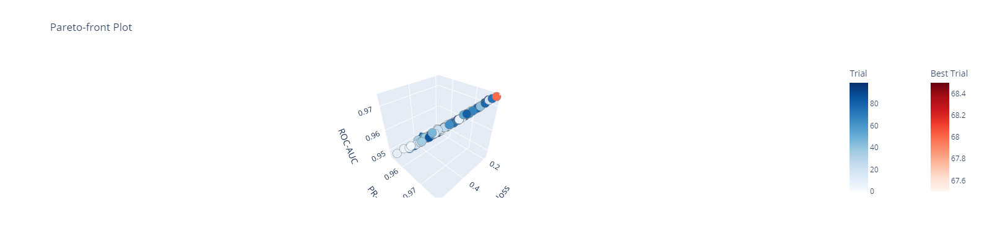

Optimization Progress: 100%|##########| 100/100 [23:36<00:00, 14.17s/it]


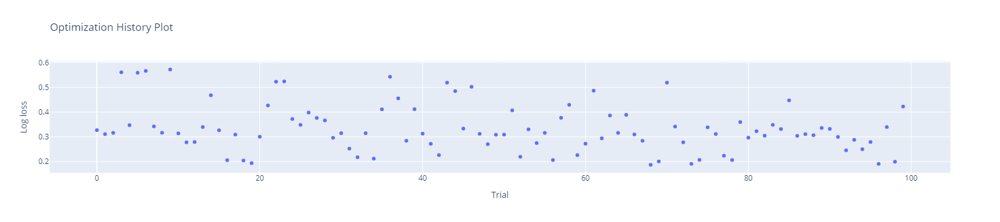

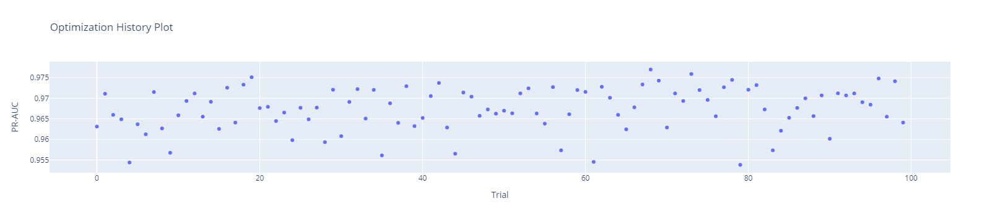

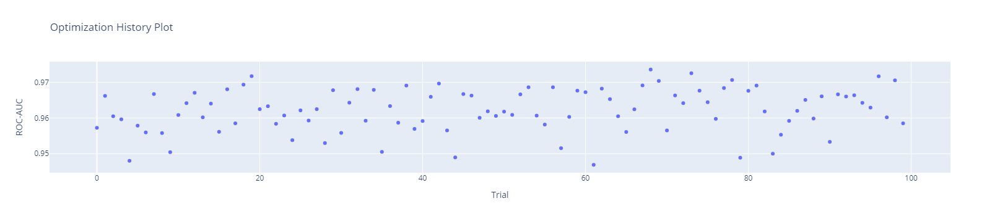

<span style = 'font-size: 18px; font-weight: bold;'> Training with Best Trial 68 </span>

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 12713, number of negative: 13125
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.804279
[LightGBM] [Info] Total Bins 22087
[LightGBM] [Info] Number of data points in the train set: 25838, number of used features: 265
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.492027 -> initscore=-0.031894
[LightGBM] [Info] Start training from score -0.031894
[LightGBM] [Debug] Re-bagging, using 18633 data to train
[LightGBM] [Debug] Trained a tree with leaves = 81 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 81 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 81 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 81 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 81 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 81 and depth = 16
[LightGBM] [Debug] Re-bagging, using 18737 data to tr

In [17]:
# Initialize a progress bar for visual feedback during optimization
# https://tqdm.github.io/docs/tqdm/
trial_progress = tqdm(total = n_trials, desc = "Optimization Progress", leave = True,
                      ascii = True, # Plain text mode
                      dynamic_ncols = True # Auto-fit width
                     )

# Callback for Optuna to update the progress bar after each trial
def update_progress(study_lgbm, trial):
    trial_progress.update(1)

# Disable Optuna's stdout handler so notebook isn’t spammed
optuna.logging.disable_default_handler()

# Enable propagation to Python’s logging
optuna.logging.enable_propagation()
optuna.logging.set_verbosity(optuna.logging.DEBUG)

# Configure Python logging
logging.basicConfig(filename = "optuna_debug_LGBM.log", filemode = "w", level = logging.DEBUG, format = "%(asctime)s %(levelname)s %(message)s")

study_lgbm = optuna.create_study(study_name = "Optuna for LGBM",
                                 directions = ["minimize", "maximize", "maximize"],
                                 sampler = module.AutoSampler(seed = seed)
                                )

start_optuna = time.perf_counter()
study_lgbm.optimize(objective, n_trials = n_trials, n_jobs = 1, callbacks = [update_progress])
end_optuna = time.perf_counter()
print(f'Optuna Optimization Elapsed Time: {end_optuna -  start_optuna} seconds')

# Create a Pareto-front plot (3D scatter plot) to show trade-off between log-loss, PR_AUC and ROC-AUC for each trial
fig = plot_pareto_front(study_lgbm, target_names = ["Log loss", "PR-AUC", "ROC-AUC"])
fig.update_layout(width = 900, height = 400)
fig.show()

trial_progress.close()

# Plot optimization history plot for each objective
metrics = ["Log loss", "PR-AUC", "ROC-AUC"]
for i, obj in enumerate(metrics):
    optuna.visualization.plot_optimization_history(study_lgbm,
                                                   target = lambda t: t.values[i],  # Correctly target each objective
                                                   target_name = obj).show()

best_trials = study_lgbm.best_trials
best_trials_lgbm = {}

# Lists to store the performance metrics from best trial(s)
exec_time_lgbm, lloss_auc_train_lgbm, lloss_auc_test_lgbm, all_metrics = [], [], [], []

# List to store confusion matrices and their labels
cm_lgbm_all, cm_labels_lgbm_all = [], []

for i, trial in enumerate(best_trials):

    display(Markdown(f"<span style = 'font-size: 18px; font-weight: bold;'> Training with Best Trial {trial.number} </span>"))

    best_params = trial.params

    # Non-optimized and best Optuna optimized parameters
    full_params = {"objective": "binary",
                   "metric": ["binary_logloss", "auc", "average_precision"],
                   "device_type": "cpu",
                   "verbosity": 2,   
                   "random_state": seed,
                   "deterministic": True,
                   "bagging_seed": seed,
                   "feature_fraction_seed": seed,
                   "drop_seed": seed,
                   "force_col_wise": True,
                   "num_threads": -1,
                   "max_depth": -1, # <= 0, No tree depth limit
                   **best_params
                  }
    
    # Prepare the data - 80% training set and 20% test set
    dtrain_all = lgb.Dataset(X_train, label = y_train, categorical_feature = cat_indices, feature_name = feature_name) 
    dtest_all = lgb.Dataset(X_test, label = y_test, categorical_feature = cat_indices, 
                            feature_name = feature_name)
    
    #display(HTML(str(trial.params)))
    display(HTML(full_params.__repr__()))

    # To be able to store num_boost_round as well
    best_trials_lgbm[trial.number] = full_params.copy()
    
    # Extract `num_boost_round` separately (default to 100 if not found)
    num_boost_round = full_params.pop("num_boost_round", 100)  # Remove from dictionary and set default
    
    start_train = time.perf_counter()
    # https://lightgbm.readthedocs.io/en/stable/pythonapi/lightgbm.train.html
    final_lgbm = lgb.train(params = full_params, 
                           train_set = dtrain_all,  
                           num_boost_round = num_boost_round # Pass explicitly
                          )
    end_train = time.perf_counter()

    print(f'Training Elapsed Time: {end_train - start_train} seconds') 
  
    # Save trained final_lgbm from the best trial
    final_lgbm.save_model(f'{temp_dir}/booster_LGBM_best_trial_{trial.number}.txt')

    y_prob_all = final_lgbm.predict(X_test)
    y_pred_all = np.rint(y_prob_all)

    print(f'Log loss: (Train) {trial.values[0]} vs (Test) {log_loss(y_test, y_prob_all)}')
    print(f'PR-AUC:   (Train) {trial.values[1]} vs (Test) {average_precision_score(y_test, y_prob_all)}')
    print(f'ROC-AUC:  (Train) {trial.values[2]} vs (Test) {roc_auc_score(y_test, y_prob_all)}')

    exec_time_lgbm.append({"Classifier": "LGBM",
                           "Best Trial": trial.number,
                           "Optimization Elapsed Time (s)": end_optuna - start_optuna,
                           "Training Elapsed Time (s)": end_train - start_train})

    lloss_auc_train_lgbm.append({"Classifier": "LGBM",
                               "Best Trial": trial.number,
                               "Set": "Training",
                               "Log loss": trial.values[0], 
                               "PR-AUC": trial.values[1], 
                               "ROC-AUC": trial.values[2]})

    lloss_auc_test_lgbm.append({"Classifier": "LGBM",
                              "Best Trial": trial.number,
                              "Set": "Test",
                              "Log loss": log_loss(y_test, y_prob_all), 
                              "PR-AUC": average_precision_score(y_test, y_prob_all), 
                              "ROC-AUC": roc_auc_score(y_test, y_prob_all)})
    
    report = classification_report(y_test, y_pred_all, target_names = ["Safe", "Risky"], output_dict = True)
    all_metrics.append({"Classifier": "LGBM",
                        "Trial": trial.number,
                        "Accuracy": accuracy_score(y_test, y_pred_all),
                        "Precision (Safe)": report["Safe"]["precision"],
                        "Recall (Safe)": report["Safe"]["recall"],
                        "F1-score (Safe)": report["Safe"]["f1-score"],
                        "Precision (Risky)": report["Risky"]["precision"],
                        "Recall (Risky)": report["Risky"]["recall"],
                        "F1-score (Risky)": report["Risky"]["f1-score"],
                        "Precision (Macro avg)": report["macro avg"]["precision"],
                        "Recall (Macro avg)": report["macro avg"]["recall"],
                        "F1-score (Macro avg)": report["macro avg"]["f1-score"],
                        "Precision (Weighted avg)": report["weighted avg"]["precision"],
                        "Recall (Weighted avg)": report["weighted avg"]["recall"],
                        "F1-score (Weighted avg)": report["weighted avg"]["f1-score"]})

    # Store confusion matrix
    cm_final_lgbm = confusion_matrix(y_test, y_pred_all)
    cm_lgbm_all.append(cm_final_lgbm)
    cm_labels_lgbm_all.append(f'LGBM Confusion Matrix for Best Trial {trial.number}')  # Store label for subplots     

df_metrics_lgbm = pd.DataFrame(all_metrics)

gc.collect();

In [18]:
save_results(clf_name = "LGBM",
             best_trials = best_trials_lgbm,
             exec_time = exec_time_lgbm,
             lloss_auc_train = lloss_auc_train_lgbm,
             lloss_auc_test = lloss_auc_test_lgbm,
             df_metrics = df_metrics_lgbm,
             cm_final = cm_final_lgbm,
             cm_all = cm_lgbm_all,
             cm_labels = cm_labels_lgbm_all)

## Optuna with HistGradientBoostingClassifier

In [19]:
gc.collect();

In [20]:
X_df = clean_df.drop(columns = ["target", "anon_ssn"])

y_df = clean_df.target

anon_ssn = clean_df.anon_ssn;

In [21]:
# A single train-test split (80%-20%) using GroupShuffleSplit, ensuring that no anon_ssn (grouped by anon_ssn) appear in both sets
gss = GroupShuffleSplit(n_splits = 1, test_size = 0.2, random_state = seed)
train_idx, test_idx = next(gss.split(X_df, y_df, groups = anon_ssn))

X_train, X_test = X_df.iloc[train_idx], X_df.iloc[test_idx]
y_train, y_test = y_df.iloc[train_idx], y_df.iloc[test_idx]

anon_ssn_train = anon_ssn[train_idx]  # Keeping track of anon_ssn for cross-validation

In [22]:
del X_df, y_df, gss, train_idx, test_idx;

In [23]:
def objective(trial):

    # https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.HistGradientBoostingClassifier.html
    # https://scikit-learn.org/stable/modules/ensemble.html#categorical-support-gbdt
    param = {"loss": "log_loss", 
             "verbose": 2, 
             "learning_rate": trial.suggest_float("learning_rate", 1e-2, 1e-1, log = True),
             "max_iter": trial.suggest_int("max_iter", 5, 100),
             "max_leaf_nodes": trial.suggest_int("max_leaf_nodes", 2, 256),
             "min_samples_leaf": trial.suggest_int("min_samples_leaf", 5, 200),
             "l2_regularization": trial.suggest_float("l2_regularization", 1e-8, 1e1, log = True),
             "class_weight": trial.suggest_categorical("class_weight", [None, "balanced"]), # classes are balance
             "random_state": seed,
             "categorical_features": "from_dtype",
             "max_depth": None,
             "max_features": trial.suggest_float("max_features", 1e-1, 1e0),
             "max_bins": trial.suggest_int("max_bins", 40, 255),
             #"monotonic_cst":  trial.suggest_categorical("monotonic_cst", [None, -1, 0, 1]),
             "interaction_cst": trial.suggest_categorical("interaction_cst", 
                                                          ["pairwise"
                                                           ,"no_interactions"]),
             "warm_start": trial.suggest_categorical("warm_start",[False, True])
            }   
    
    sgkf = StratifiedGroupKFold(n_splits = 5, shuffle = True, random_state = seed)
    lloss_scores, pr_auc_scores, roc_auc_scores = [], [], []
    
    for fold_idx, (train_index, valid_index) in enumerate(sgkf.split(X_train, y_train, groups = anon_ssn_train), start = 1):

        # Extract train and validation sets
        X_train_fold, X_valid_fold = X_train.iloc[train_index], X_train.iloc[valid_index]
        y_train_fold, y_valid_fold = y_train.iloc[train_index], y_train.iloc[valid_index]
        
        # Summarize the composition of classes in the train and validation sets
        train_0, train_1 = len(y_train_fold[y_train_fold == 0]), len(y_train_fold[y_train_fold == 1])
        valid_0, valid_1 = len(y_valid_fold[y_valid_fold == 0]), len(y_valid_fold[y_valid_fold == 1])

        print(f'Trial {trial.number}, Fold {fold_idx}: Train size = {len(train_index)} where 0 = {train_0}, 1 = {train_1}, 0/1 = {train_0/train_1}')
        print(f'Trial {trial.number}, Fold {fold_idx}: Validation size = {len(valid_index)} where  0 = {valid_0}, 1 = {valid_1}, 0/1 = {valid_0/valid_1}')

        clf = HistGradientBoostingClassifier(**param)
            
        start_fold = time.perf_counter()
        clf.fit(X_train_fold, y_train_fold)
        end_fold = time.perf_counter()

        # Predict probabilities
        y_prob_fold = clf.predict_proba(X_valid_fold)[:, 1]

        print(f'Trial {trial.number}, Fold {fold_idx}: '
              f'Log loss = {log_loss(y_valid_fold, y_prob_fold)}, '
              f'Average precision = {average_precision_score(y_valid_fold, y_prob_fold)}, '
              f'ROC-AUC = {roc_auc_score(y_valid_fold, y_prob_fold)}, '
              f'Elapsed Time = {end_fold - start_fold} seconds')          
        
        # Calculate and store the evaluation metrics for this fold
        lloss_scores.append(log_loss(y_valid_fold, y_prob_fold))
        pr_auc_scores.append(average_precision_score(y_valid_fold, y_prob_fold))
        roc_auc_scores.append(roc_auc_score(y_valid_fold, y_prob_fold))

        del X_train_fold, X_valid_fold, y_train_fold, y_valid_fold, clf, start_fold, end_fold
        gc.collect()

    # Calculate average metrics across all folds for Optuna to optimize
    mean_lloss = np.mean(lloss_scores)
    mean_pr_auc = np.mean(pr_auc_scores)
    mean_roc_auc = np.mean(roc_auc_scores)

    del lloss_scores, pr_auc_scores, roc_auc_scores
    gc.collect()
    
    #  Return the metrics to Optuna for optimization
    return mean_lloss, mean_pr_auc, mean_roc_auc  

Optimization Progress:   0%|          | 0/100 [00:00<?, ?it/s]

Trial 0, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 0, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
Binning 0.040 GB of training data: 0.141 s
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 19 leaves, max depth = 9, train loss: 0.68006, val loss: 0.67964, in 0.016s
1 tree, 19 leaves, max depth = 9, train loss: 0.66763, val loss: 0.66685, in 0.016s
1 tree, 19 leaves, max depth = 9, train loss: 0.65585, val loss: 0.65476, in 0.000s
1 tree, 7 leaves, max depth = 5, train loss: 0.64478, val loss: 0.64325, in 0.000s
1 tree, 19 leaves, max depth = 9, train loss: 0.63425, val loss: 0.63238, in 0.016s
1 tree, 19 leaves, max depth = 9, train loss: 0.62427, val loss: 0.62208, in 0.000s
1 tree, 19 leaves, max depth = 8, train loss: 0.61494, val loss: 0.61244, in 0.000s
1 tree, 19 leaves, max depth = 8, train loss: 0.60610, val loss: 0.60325, in 0.000s
1 tree, 19 leaves, max depth = 9, 

Optimization Progress:   1%|1         | 1/100 [00:12<21:16, 12.90s/it]

Trial 1, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 1, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.143 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 64 leaves, max depth = 14, train loss: 0.67836, val loss: 0.67826, in 0.016s
1 tree, 101 leaves, max depth = 13, train loss: 0.66426, val loss: 0.66417, in 0.016s
1 tree, 97 leaves, max depth = 12, train loss: 0.65085, val loss: 0.65081, in 0.016s
1 tree, 91 leaves, max depth = 13, train loss: 0.63799, val loss: 0.63795, in 0.016s
1 tree, 93 leaves, max depth = 13, train loss: 0.62573, val loss: 0.62569, in 0.016s
1 tree, 101 leaves, max depth = 13, train loss: 0.61408, val loss: 0.61410, in 0.016s
1 tree, 93 leaves, max depth = 13, train loss: 0.60293, val loss: 0.60296, in 0.016s
1 tree, 93 leaves, max depth = 13, train loss: 0.59236, val loss: 0.59238, in 0.016s
1 tree, 118 leaves, max depth 

Optimization Progress:   2%|2         | 2/100 [00:29<24:13, 14.83s/it]

Trial 2, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 2, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 33 leaves, max depth = 8, train loss: 0.66988, val loss: 0.66936, in 0.016s
1 tree, 32 leaves, max depth = 7, train loss: 0.64735, val loss: 0.64677, in 0.016s
1 tree, 27 leaves, max depth = 8, train loss: 0.62702, val loss: 0.62621, in 0.016s
1 tree, 33 leaves, max depth = 7, train loss: 0.60789, val loss: 0.60700, in 0.016s
1 tree, 37 leaves, max depth = 7, train loss: 0.59157, val loss: 0.59044, in 0.031s
1 tree, 27 leaves, max depth = 7, train loss: 0.57534, val loss: 0.57389, in 0.000s
1 tree, 40 leaves, max depth = 9, train loss: 0.56066, val loss: 0.55895, in 0.016s
1 tree, 33 leaves, max depth = 10, train loss: 0.54615, val loss: 0.54432, in 0.016s
1 tree, 41 leaves, max depth = 10, trai

Optimization Progress:   3%|3         | 3/100 [00:38<19:37, 12.14s/it]

Trial 3, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 3, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.141 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 56 leaves, max depth = 11, train loss: 0.68265, val loss: 0.68255, in 0.016s
1 tree, 76 leaves, max depth = 11, train loss: 0.67219, val loss: 0.67220, in 0.016s
1 tree, 101 leaves, max depth = 13, train loss: 0.66265, val loss: 0.66258, in 0.031s
1 tree, 93 leaves, max depth = 12, train loss: 0.65301, val loss: 0.65292, in 0.016s
1 tree, 73 leaves, max depth = 13, train loss: 0.64421, val loss: 0.64402, in 0.016s
1 tree, 82 leaves, max depth = 11, train loss: 0.63505, val loss: 0.63491, in 0.016s
1 tree, 81 leaves, max depth = 13, train loss: 0.62663, val loss: 0.62649, in 0.016s
1 tree, 79 leaves, max depth = 13, train loss: 0.61810, val loss: 0.61803, in 0.016s
1 tree, 78 leaves, max depth = 

Optimization Progress:   4%|4         | 4/100 [00:51<20:32, 12.84s/it]

Trial 4, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 4, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.174 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 17 leaves, max depth = 7, train loss: 0.67412, val loss: 0.67382, in 0.016s
1 tree, 17 leaves, max depth = 6, train loss: 0.65525, val loss: 0.65467, in 0.000s
1 tree, 17 leaves, max depth = 7, train loss: 0.63726, val loss: 0.63628, in 0.031s
1 tree, 17 leaves, max depth = 7, train loss: 0.62082, val loss: 0.61942, in 0.016s
1 tree, 17 leaves, max depth = 6, train loss: 0.60647, val loss: 0.60492, in 0.016s
1 tree, 17 leaves, max depth = 9, train loss: 0.59321, val loss: 0.59147, in 0.016s
1 tree, 17 leaves, max depth = 7, train loss: 0.57988, val loss: 0.57792, in 0.016s
1 tree, 17 leaves, max depth = 7, train loss: 0.56780, val loss: 0.56557, in 0.016s
1 tree, 17 leaves, max depth = 7, train 

Optimization Progress:   5%|5         | 5/100 [01:05<20:30, 12.96s/it]

Trial 5, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 5, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.158 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 12 leaves, max depth = 7, train loss: 0.68648, val loss: 0.68626, in 0.016s
1 tree, 15 leaves, max depth = 9, train loss: 0.67994, val loss: 0.67954, in 0.000s
1 tree, 12 leaves, max depth = 8, train loss: 0.67354, val loss: 0.67299, in 0.016s
1 tree, 5 leaves, max depth = 3, train loss: 0.66732, val loss: 0.66654, in 0.000s
1 tree, 19 leaves, max depth = 10, train loss: 0.66132, val loss: 0.66036, in 0.000s
1 tree, 15 leaves, max depth = 7, train loss: 0.65548, val loss: 0.65430, in 0.016s
1 tree, 19 leaves, max depth = 10, train loss: 0.64981, val loss: 0.64846, in 0.000s
1 tree, 15 leaves, max depth = 9, train loss: 0.64430, val loss: 0.64278, in 0.000s
1 tree, 15 leaves, max depth = 10, trai

Optimization Progress:   6%|6         | 6/100 [01:14<18:16, 11.67s/it]

Trial 6, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 6, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 31 leaves, max depth = 7, train loss: 0.64682, val loss: 0.64584, in 0.016s
1 tree, 31 leaves, max depth = 9, train loss: 0.60923, val loss: 0.60826, in 0.016s
1 tree, 31 leaves, max depth = 11, train loss: 0.57663, val loss: 0.57493, in 0.016s
1 tree, 31 leaves, max depth = 11, train loss: 0.54702, val loss: 0.54501, in 0.016s
1 tree, 31 leaves, max depth = 10, train loss: 0.52327, val loss: 0.52099, in 0.016s
1 tree, 31 leaves, max depth = 9, train loss: 0.50163, val loss: 0.49901, in 0.016s
1 tree, 31 leaves, max depth = 10, train loss: 0.48332, val loss: 0.48045, in 0.016s
1 tree, 31 leaves, max depth = 10, train loss: 0.46715, val loss: 0.46376, in 0.016s
1 tree, 26 leaves, max depth = 9, t

Optimization Progress:   7%|7         | 7/100 [01:24<17:07, 11.05s/it]

Trial 7, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 7, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
Binning 0.040 GB of training data: 0.220 s
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 50 leaves, max depth = 11, train loss: 0.66112, val loss: 0.66111, in 0.031s
1 tree, 49 leaves, max depth = 11, train loss: 0.63276, val loss: 0.63277, in 0.016s
1 tree, 50 leaves, max depth = 11, train loss: 0.60721, val loss: 0.60719, in 0.031s
1 tree, 52 leaves, max depth = 11, train loss: 0.58504, val loss: 0.58493, in 0.016s
1 tree, 49 leaves, max depth = 11, train loss: 0.56405, val loss: 0.56390, in 0.031s
1 tree, 52 leaves, max depth = 11, train loss: 0.54583, val loss: 0.54557, in 0.016s
1 tree, 47 leaves, max depth = 11, train loss: 0.52809, val loss: 0.52771, in 0.016s
1 tree, 48 leaves, max depth = 11, train loss: 0.51192, val loss: 0.51143, in 0.031s
[9/36] 1 tree, 47 leaves,

Optimization Progress:   8%|8         | 8/100 [01:38<18:50, 12.29s/it]

Trial 8, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 8, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.141 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 5 leaves, max depth = 3, train loss: 0.67012, val loss: 0.66942, in 0.000s
1 tree, 5 leaves, max depth = 3, train loss: 0.64882, val loss: 0.64743, in 0.016s
1 tree, 5 leaves, max depth = 3, train loss: 0.62956, val loss: 0.62755, in 0.000s
1 tree, 4 leaves, max depth = 3, train loss: 0.61219, val loss: 0.60943, in 0.000s
1 tree, 5 leaves, max depth = 3, train loss: 0.59636, val loss: 0.59301, in 0.016s
1 tree, 5 leaves, max depth = 3, train loss: 0.58199, val loss: 0.57806, in 0.000s
1 tree, 5 leaves, max depth = 3, train loss: 0.56910, val loss: 0.56462, in 0.000s
1 tree, 5 leaves, max depth = 3, train loss: 0.55737, val loss: 0.55235, in 0.016s
1 tree, 7 leaves, max depth = 4, train loss: 0.5

Optimization Progress:   9%|9         | 9/100 [01:51<18:51, 12.44s/it]

Trial 9, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 9, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.159 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 77 leaves, max depth = 17, train loss: 0.64898, val loss: 0.64781, in 0.016s
1 tree, 75 leaves, max depth = 17, train loss: 0.61250, val loss: 0.61028, in 0.016s
1 tree, 76 leaves, max depth = 18, train loss: 0.58242, val loss: 0.57932, in 0.000s
1 tree, 77 leaves, max depth = 18, train loss: 0.55778, val loss: 0.55395, in 0.016s
1 tree, 127 leaves, max depth = 13, train loss: 0.53453, val loss: 0.53256, in 0.016s
1 tree, 76 leaves, max depth = 17, train loss: 0.51534, val loss: 0.51258, in 0.016s
1 tree, 127 leaves, max depth = 14, train loss: 0.49704, val loss: 0.49590, in 0.016s
1 tree, 77 leaves, max depth = 17, train loss: 0.48227, val loss: 0.48041, in 0.000s
1 tree, 76 leaves, max depth =

Optimization Progress:  10%|#         | 10/100 [02:02<18:03, 12.04s/it]

Trial 10, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 10, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.190 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 77 leaves, max depth = 19, train loss: 0.68188, val loss: 0.68157, in 0.000s
1 tree, 80 leaves, max depth = 17, train loss: 0.67108, val loss: 0.67043, in 0.016s
1 tree, 80 leaves, max depth = 17, train loss: 0.66079, val loss: 0.65980, in 0.016s
1 tree, 76 leaves, max depth = 17, train loss: 0.65117, val loss: 0.64997, in 0.000s
1 tree, 80 leaves, max depth = 15, train loss: 0.64190, val loss: 0.64041, in 0.016s
1 tree, 80 leaves, max depth = 15, train loss: 0.63304, val loss: 0.63127, in 0.016s
1 tree, 73 leaves, max depth = 19, train loss: 0.62468, val loss: 0.62268, in 0.000s
1 tree, 78 leaves, max depth = 18, train loss: 0.61668, val loss: 0.61449, in 0.016s
1 tree, 80 leaves, max depth =

Optimization Progress:  11%|#1        | 11/100 [02:15<18:14, 12.30s/it]

Trial 11, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 11, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 43 leaves, max depth = 11, train loss: 0.68296, val loss: 0.68266, in 0.016s
1 tree, 6 leaves, max depth = 4, train loss: 0.67751, val loss: 0.67678, in 0.000s
1 tree, 43 leaves, max depth = 12, train loss: 0.66797, val loss: 0.66700, in 0.000s
1 tree, 7 leaves, max depth = 5, train loss: 0.65892, val loss: 0.65761, in 0.000s
1 tree, 7 leaves, max depth = 5, train loss: 0.65025, val loss: 0.64861, in 0.000s
1 tree, 42 leaves, max depth = 13, train loss: 0.64185, val loss: 0.63997, in 0.016s
1 tree, 7 leaves, max depth = 5, train loss: 0.63387, val loss: 0.63168, in 0.000s
1 tree, 42 leaves, max depth = 13, train loss: 0.62624, val loss: 0.62380, in 0.016s
1 tree, 24 leaves, max depth = 8, trai

Optimization Progress:  12%|#2        | 12/100 [02:26<17:21, 11.83s/it]

Trial 12, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 12, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 13 leaves, max depth = 7, train loss: 0.67249, val loss: 0.67184, in 0.000s
1 tree, 5 leaves, max depth = 3, train loss: 0.66180, val loss: 0.66028, in 0.016s
1 tree, 17 leaves, max depth = 8, train loss: 0.64349, val loss: 0.64145, in 0.000s
1 tree, 5 leaves, max depth = 3, train loss: 0.62687, val loss: 0.62418, in 0.016s
1 tree, 5 leaves, max depth = 3, train loss: 0.61165, val loss: 0.60833, in 0.000s
1 tree, 14 leaves, max depth = 9, train loss: 0.59754, val loss: 0.59373, in 0.016s
1 tree, 5 leaves, max depth = 3, train loss: 0.58471, val loss: 0.58032, in 0.000s
1 tree, 16 leaves, max depth = 8, train loss: 0.57300, val loss: 0.56817, in 0.016s
1 tree, 34 leaves, max depth = 7, train lo

Optimization Progress:  13%|#3        | 13/100 [02:35<15:56, 11.00s/it]

Trial 13, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 13, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.157 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 6 leaves, max depth = 4, train loss: 0.67771, val loss: 0.67720, in 0.016s
1 tree, 5 leaves, max depth = 3, train loss: 0.66296, val loss: 0.66204, in 0.000s
1 tree, 5 leaves, max depth = 4, train loss: 0.64917, val loss: 0.64781, in 0.016s
1 tree, 4 leaves, max depth = 3, train loss: 0.63630, val loss: 0.63442, in 0.000s
1 tree, 5 leaves, max depth = 3, train loss: 0.62422, val loss: 0.62195, in 0.000s
1 tree, 5 leaves, max depth = 3, train loss: 0.61289, val loss: 0.61025, in 0.016s
1 tree, 4 leaves, max depth = 3, train loss: 0.60240, val loss: 0.59937, in 0.000s
1 tree, 4 leaves, max depth = 3, train loss: 0.59256, val loss: 0.58915, in 0.000s
1 tree, 5 leaves, max depth = 3, train loss: 0

Optimization Progress:  14%|#4        | 14/100 [02:45<15:11, 10.60s/it]

Trial 14, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 14, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 37 leaves, max depth = 11, train loss: 0.68557, val loss: 0.68534, in 0.000s
1 tree, 37 leaves, max depth = 14, train loss: 0.67812, val loss: 0.67769, in 0.016s
1 tree, 38 leaves, max depth = 10, train loss: 0.67091, val loss: 0.67028, in 0.000s
1 tree, 6 leaves, max depth = 4, train loss: 0.66395, val loss: 0.66305, in 0.016s
1 tree, 38 leaves, max depth = 14, train loss: 0.65719, val loss: 0.65609, in 0.000s
1 tree, 38 leaves, max depth = 14, train loss: 0.65064, val loss: 0.64936, in 0.016s
1 tree, 37 leaves, max depth = 13, train loss: 0.64434, val loss: 0.64289, in 0.000s
1 tree, 37 leaves, max depth = 12, train loss: 0.63825, val loss: 0.63663, in 0.016s
1 tree, 38 leaves, max depth = 1

Optimization Progress:  15%|#5        | 15/100 [02:56<15:20, 10.83s/it]

Trial 15, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 15, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.158 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 49 leaves, max depth = 10, train loss: 0.66220, val loss: 0.66243, in 0.016s
1 tree, 48 leaves, max depth = 11, train loss: 0.63453, val loss: 0.63502, in 0.015s
1 tree, 48 leaves, max depth = 11, train loss: 0.60959, val loss: 0.61019, in 0.016s
1 tree, 51 leaves, max depth = 13, train loss: 0.58790, val loss: 0.58839, in 0.016s
1 tree, 51 leaves, max depth = 11, train loss: 0.56691, val loss: 0.56733, in 0.016s
1 tree, 50 leaves, max depth = 12, train loss: 0.54896, val loss: 0.54928, in 0.016s
1 tree, 49 leaves, max depth = 10, train loss: 0.53166, val loss: 0.53207, in 0.016s
1 tree, 51 leaves, max depth = 11, train loss: 0.51556, val loss: 0.51590, in 0.016s
1 tree, 48 leaves, max depth =

Optimization Progress:  16%|#6        | 16/100 [03:10<16:26, 11.75s/it]

Trial 16, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 16, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 37 leaves, max depth = 12, train loss: 0.68427, val loss: 0.68410, in 0.000s
1 tree, 39 leaves, max depth = 12, train loss: 0.67611, val loss: 0.67582, in 0.016s
1 tree, 32 leaves, max depth = 11, train loss: 0.66815, val loss: 0.66773, in 0.016s
1 tree, 36 leaves, max depth = 10, train loss: 0.66014, val loss: 0.65970, in 0.016s
1 tree, 38 leaves, max depth = 11, train loss: 0.65280, val loss: 0.65227, in 0.016s
1 tree, 40 leaves, max depth = 11, train loss: 0.64479, val loss: 0.64426, in 0.016s
1 tree, 22 leaves, max depth = 9, train loss: 0.63793, val loss: 0.63733, in 0.016s
1 tree, 36 leaves, max depth = 10, train loss: 0.63064, val loss: 0.63002, in 0.016s
1 tree, 33 leaves, max depth = 

Optimization Progress:  17%|#7        | 17/100 [03:25<17:42, 12.80s/it]

Trial 17, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 17, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.143 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 32 leaves, max depth = 9, train loss: 0.66507, val loss: 0.66472, in 0.016s
1 tree, 19 leaves, max depth = 8, train loss: 0.63841, val loss: 0.63797, in 0.016s
1 tree, 11 leaves, max depth = 5, train loss: 0.61633, val loss: 0.61549, in 0.016s
1 tree, 20 leaves, max depth = 8, train loss: 0.59559, val loss: 0.59439, in 0.016s
1 tree, 20 leaves, max depth = 8, train loss: 0.57693, val loss: 0.57546, in 0.016s
1 tree, 43 leaves, max depth = 11, train loss: 0.55961, val loss: 0.55818, in 0.016s
1 tree, 32 leaves, max depth = 8, train loss: 0.54219, val loss: 0.54094, in 0.016s
1 tree, 22 leaves, max depth = 10, train loss: 0.52658, val loss: 0.52496, in 0.000s
1 tree, 22 leaves, max depth = 8, tr

Optimization Progress:  18%|#8        | 18/100 [03:35<16:17, 11.92s/it]

Trial 18, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 18, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.158 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 52 leaves, max depth = 16, train loss: 0.66318, val loss: 0.66227, in 0.015s
1 tree, 52 leaves, max depth = 16, train loss: 0.63692, val loss: 0.63517, in 0.000s
1 tree, 51 leaves, max depth = 16, train loss: 0.61382, val loss: 0.61127, in 0.016s
1 tree, 54 leaves, max depth = 17, train loss: 0.59360, val loss: 0.59055, in 0.016s
1 tree, 52 leaves, max depth = 17, train loss: 0.57550, val loss: 0.57175, in 0.000s
Fit 5 trees in 0.314 s, (261 total leaves)
Time spent computing histograms: 0.024s
Time spent finding best splits:  0.005s
Time spent applying splits:      0.004s
Time spent predicting:           0.000s
Trial 18, Fold 1: Log loss = 0.5758696069682718, Average precision = 0.81401190977

Optimization Progress:  19%|#9        | 19/100 [03:43<14:33, 10.79s/it]

Trial 19, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 19, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.126 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 42 leaves, max depth = 9, train loss: 0.68003, val loss: 0.68007, in 0.016s
1 tree, 45 leaves, max depth = 10, train loss: 0.66750, val loss: 0.66754, in 0.016s
1 tree, 44 leaves, max depth = 11, train loss: 0.65551, val loss: 0.65557, in 0.016s
1 tree, 44 leaves, max depth = 9, train loss: 0.64402, val loss: 0.64410, in 0.016s
1 tree, 48 leaves, max depth = 13, train loss: 0.63301, val loss: 0.63311, in 0.016s
1 tree, 49 leaves, max depth = 13, train loss: 0.62247, val loss: 0.62257, in 0.016s
1 tree, 55 leaves, max depth = 11, train loss: 0.61234, val loss: 0.61250, in 0.016s
1 tree, 43 leaves, max depth = 11, train loss: 0.60261, val loss: 0.60279, in 0.016s
1 tree, 53 leaves, max depth = 1

Optimization Progress:  20%|##        | 20/100 [03:54<14:10, 10.63s/it]

Trial 20, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 20, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 101 leaves, max depth = 15, train loss: 0.68483, val loss: 0.68463, in 0.000s
1 tree, 104 leaves, max depth = 17, train loss: 0.67663, val loss: 0.67620, in 0.016s
1 tree, 104 leaves, max depth = 17, train loss: 0.66871, val loss: 0.66805, in 0.016s
1 tree, 106 leaves, max depth = 14, train loss: 0.66116, val loss: 0.66033, in 0.016s
1 tree, 105 leaves, max depth = 19, train loss: 0.65386, val loss: 0.65283, in 0.000s
1 tree, 105 leaves, max depth = 19, train loss: 0.64681, val loss: 0.64558, in 0.000s
1 tree, 104 leaves, max depth = 21, train loss: 0.64007, val loss: 0.63868, in 0.016s
1 tree, 104 leaves, max depth = 19, train loss: 0.63356, val loss: 0.63201, in 0.016s
1 tree, 105 leaves, ma

Optimization Progress:  21%|##1       | 21/100 [04:10<16:19, 12.40s/it]

Trial 21, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 21, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 17 leaves, max depth = 8, train loss: 0.67808, val loss: 0.67764, in 0.000s
1 tree, 17 leaves, max depth = 8, train loss: 0.66413, val loss: 0.66327, in 0.000s
1 tree, 17 leaves, max depth = 8, train loss: 0.65103, val loss: 0.64976, in 0.016s
1 tree, 17 leaves, max depth = 8, train loss: 0.63883, val loss: 0.63723, in 0.000s
1 tree, 17 leaves, max depth = 7, train loss: 0.62725, val loss: 0.62526, in 0.016s
1 tree, 17 leaves, max depth = 8, train loss: 0.61634, val loss: 0.61397, in 0.000s
1 tree, 17 leaves, max depth = 8, train loss: 0.60617, val loss: 0.60351, in 0.016s
1 tree, 17 leaves, max depth = 8, train loss: 0.59648, val loss: 0.59347, in 0.000s
1 tree, 17 leaves, max depth = 7, trai

Optimization Progress:  22%|##2       | 22/100 [04:21<15:25, 11.86s/it]

Trial 22, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 22, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 48 leaves, max depth = 11, train loss: 0.66298, val loss: 0.66325, in 0.016s
1 tree, 48 leaves, max depth = 11, train loss: 0.63598, val loss: 0.63648, in 0.016s
1 tree, 48 leaves, max depth = 12, train loss: 0.61156, val loss: 0.61214, in 0.016s
1 tree, 48 leaves, max depth = 12, train loss: 0.59031, val loss: 0.59090, in 0.016s
1 tree, 48 leaves, max depth = 12, train loss: 0.57004, val loss: 0.57076, in 0.016s
1 tree, 48 leaves, max depth = 12, train loss: 0.55147, val loss: 0.55217, in 0.031s
1 tree, 48 leaves, max depth = 11, train loss: 0.53410, val loss: 0.53461, in 0.016s
1 tree, 48 leaves, max depth = 10, train loss: 0.51818, val loss: 0.51851, in 0.016s
1 tree, 48 leaves, max depth =

Optimization Progress:  23%|##3       | 23/100 [04:34<15:40, 12.21s/it]

Trial 23, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 23, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.157 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 51 leaves, max depth = 15, train loss: 0.67715, val loss: 0.67667, in 0.016s
1 tree, 50 leaves, max depth = 15, train loss: 0.66222, val loss: 0.66127, in 0.000s
1 tree, 51 leaves, max depth = 15, train loss: 0.64827, val loss: 0.64687, in 0.016s
1 tree, 50 leaves, max depth = 15, train loss: 0.63522, val loss: 0.63339, in 0.016s
1 tree, 51 leaves, max depth = 15, train loss: 0.62300, val loss: 0.62075, in 0.000s
1 tree, 50 leaves, max depth = 15, train loss: 0.61154, val loss: 0.60888, in 0.016s
1 tree, 51 leaves, max depth = 15, train loss: 0.60079, val loss: 0.59774, in 0.016s
1 tree, 51 leaves, max depth = 15, train loss: 0.59070, val loss: 0.58727, in 0.000s
1 tree, 50 leaves, max depth =

Optimization Progress:  24%|##4       | 24/100 [04:47<15:47, 12.46s/it]

Trial 24, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 24, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 20 leaves, max depth = 8, train loss: 0.68729, val loss: 0.68711, in 0.000s
1 tree, 20 leaves, max depth = 8, train loss: 0.68158, val loss: 0.68122, in 0.016s
1 tree, 20 leaves, max depth = 8, train loss: 0.67600, val loss: 0.67547, in 0.000s
1 tree, 20 leaves, max depth = 8, train loss: 0.67057, val loss: 0.66986, in 0.016s
1 tree, 20 leaves, max depth = 8, train loss: 0.66526, val loss: 0.66438, in 0.000s
1 tree, 20 leaves, max depth = 8, train loss: 0.66009, val loss: 0.65904, in 0.016s
1 tree, 20 leaves, max depth = 8, train loss: 0.65503, val loss: 0.65382, in 0.000s
1 tree, 20 leaves, max depth = 8, train loss: 0.65010, val loss: 0.64872, in 0.016s
1 tree, 20 leaves, max depth = 8, trai

Optimization Progress:  25%|##5       | 25/100 [04:55<13:56, 11.15s/it]

Trial 25, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 25, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.205 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 6 leaves, max depth = 4, train loss: 0.66934, val loss: 0.66854, in 0.016s
1 tree, 4 leaves, max depth = 3, train loss: 0.65718, val loss: 0.65539, in 0.000s
1 tree, 7 leaves, max depth = 4, train loss: 0.63648, val loss: 0.63409, in 0.016s
1 tree, 4 leaves, max depth = 3, train loss: 0.61800, val loss: 0.61486, in 0.000s
1 tree, 7 leaves, max depth = 4, train loss: 0.60112, val loss: 0.59737, in 0.016s
1 tree, 8 leaves, max depth = 5, train loss: 0.58600, val loss: 0.58163, in 0.000s
1 tree, 4 leaves, max depth = 3, train loss: 0.57225, val loss: 0.56724, in 0.016s
1 tree, 8 leaves, max depth = 5, train loss: 0.55985, val loss: 0.55430, in 0.000s
1 tree, 28 leaves, max depth = 7, train loss: 

Optimization Progress:  26%|##6       | 26/100 [05:05<13:24, 10.88s/it]

Trial 26, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 26, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.143 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 190 leaves, max depth = 15, train loss: 0.68518, val loss: 0.68533, in 0.016s
1 tree, 190 leaves, max depth = 15, train loss: 0.67727, val loss: 0.67748, in 0.031s
1 tree, 190 leaves, max depth = 14, train loss: 0.66946, val loss: 0.66980, in 0.031s
1 tree, 190 leaves, max depth = 14, train loss: 0.66197, val loss: 0.66236, in 0.016s
1 tree, 190 leaves, max depth = 14, train loss: 0.65457, val loss: 0.65492, in 0.031s
1 tree, 190 leaves, max depth = 16, train loss: 0.64780, val loss: 0.64813, in 0.016s
1 tree, 190 leaves, max depth = 14, train loss: 0.64114, val loss: 0.64149, in 0.016s
1 tree, 190 leaves, max depth = 16, train loss: 0.63454, val loss: 0.63490, in 0.038s
1 tree, 190 leaves, ma

Optimization Progress:  27%|##7       | 27/100 [05:16<13:20, 10.96s/it]

Trial 27, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 27, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 39 leaves, max depth = 9, train loss: 0.66511, val loss: 0.66498, in 0.016s
1 tree, 52 leaves, max depth = 10, train loss: 0.63941, val loss: 0.63945, in 0.016s
1 tree, 55 leaves, max depth = 9, train loss: 0.61638, val loss: 0.61627, in 0.016s
1 tree, 59 leaves, max depth = 10, train loss: 0.59531, val loss: 0.59502, in 0.016s
1 tree, 51 leaves, max depth = 10, train loss: 0.57582, val loss: 0.57567, in 0.016s
1 tree, 53 leaves, max depth = 10, train loss: 0.55789, val loss: 0.55776, in 0.016s
1 tree, 54 leaves, max depth = 12, train loss: 0.54232, val loss: 0.54228, in 0.016s
1 tree, 56 leaves, max depth = 10, train loss: 0.52719, val loss: 0.52691, in 0.016s
1 tree, 56 leaves, max depth = 1

Optimization Progress:  28%|##8       | 28/100 [05:28<13:31, 11.27s/it]

Trial 28, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 28, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 35 leaves, max depth = 8, train loss: 0.67338, val loss: 0.67336, in 0.016s
1 tree, 35 leaves, max depth = 10, train loss: 0.65449, val loss: 0.65448, in 0.016s
1 tree, 35 leaves, max depth = 9, train loss: 0.63710, val loss: 0.63698, in 0.016s
1 tree, 35 leaves, max depth = 10, train loss: 0.62067, val loss: 0.62051, in 0.016s
1 tree, 35 leaves, max depth = 10, train loss: 0.60563, val loss: 0.60531, in 0.016s
1 tree, 35 leaves, max depth = 8, train loss: 0.59171, val loss: 0.59136, in 0.016s
1 tree, 35 leaves, max depth = 8, train loss: 0.57880, val loss: 0.57822, in 0.016s
1 tree, 35 leaves, max depth = 9, train loss: 0.56571, val loss: 0.56515, in 0.016s
1 tree, 35 leaves, max depth = 8, t

Optimization Progress:  29%|##9       | 29/100 [05:42<14:05, 11.91s/it]

Trial 29, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 29, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.158 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 13 leaves, max depth = 5, train loss: 0.68812, val loss: 0.68797, in 0.015s
1 tree, 13 leaves, max depth = 5, train loss: 0.68339, val loss: 0.68309, in 0.000s
1 tree, 13 leaves, max depth = 5, train loss: 0.67875, val loss: 0.67831, in 0.000s
1 tree, 16 leaves, max depth = 9, train loss: 0.67425, val loss: 0.67371, in 0.016s
1 tree, 13 leaves, max depth = 5, train loss: 0.66979, val loss: 0.66911, in 0.000s
1 tree, 13 leaves, max depth = 5, train loss: 0.66543, val loss: 0.66461, in 0.016s
1 tree, 14 leaves, max depth = 5, train loss: 0.66114, val loss: 0.66019, in 0.000s
1 tree, 14 leaves, max depth = 5, train loss: 0.65695, val loss: 0.65586, in 0.016s
1 tree, 14 leaves, max depth = 5, trai

Optimization Progress:  30%|###       | 30/100 [05:51<12:56, 11.09s/it]

Trial 30, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 30, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.155 s 0.040 GB of training data: 
0.003 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 79 leaves, max depth = 17, train loss: 0.68638, val loss: 0.68620, in 0.016s
1 tree, 84 leaves, max depth = 19, train loss: 0.67984, val loss: 0.67947, in 0.000s
1 tree, 84 leaves, max depth = 19, train loss: 0.67349, val loss: 0.67292, in 0.016s
1 tree, 83 leaves, max depth = 15, train loss: 0.66737, val loss: 0.66667, in 0.016s
1 tree, 84 leaves, max depth = 17, train loss: 0.66144, val loss: 0.66057, in 0.016s
1 tree, 84 leaves, max depth = 17, train loss: 0.65567, val loss: 0.65464, in 0.000s
1 tree, 80 leaves, max depth = 18, train loss: 0.65010, val loss: 0.64890, in 0.016s
1 tree, 83 leaves, max depth = 17, train loss: 0.64467, val loss: 0.64335, in 0.016s
1 tree, 84 leaves, max depth =

Optimization Progress:  31%|###1      | 31/100 [06:06<14:02, 12.21s/it]

Trial 31, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 31, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 194 leaves, max depth = 18, train loss: 0.68167, val loss: 0.68189, in 0.016s
1 tree, 127 leaves, max depth = 15, train loss: 0.67091, val loss: 0.67120, in 0.031s
1 tree, 63 leaves, max depth = 10, train loss: 0.66041, val loss: 0.66056, in 0.016s
1 tree, 183 leaves, max depth = 15, train loss: 0.64992, val loss: 0.65031, in 0.031s
1 tree, 64 leaves, max depth = 13, train loss: 0.64028, val loss: 0.64060, in 0.016s
1 tree, 184 leaves, max depth = 16, train loss: 0.63057, val loss: 0.63109, in 0.016s
1 tree, 59 leaves, max depth = 11, train loss: 0.62149, val loss: 0.62184, in 0.016s
1 tree, 113 leaves, max depth = 15, train loss: 0.61202, val loss: 0.61229, in 0.016s
1 tree, 116 leaves, max d

Optimization Progress:  32%|###2      | 32/100 [06:23<15:39, 13.81s/it]

Trial 32, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 32, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 27 leaves, max depth = 9, train loss: 0.67187, val loss: 0.67116, in 0.000s
1 tree, 29 leaves, max depth = 11, train loss: 0.65255, val loss: 0.65121, in 0.016s
1 tree, 26 leaves, max depth = 9, train loss: 0.63460, val loss: 0.63274, in 0.000s
1 tree, 8 leaves, max depth = 5, train loss: 0.61833, val loss: 0.61577, in 0.000s
1 tree, 26 leaves, max depth = 9, train loss: 0.60334, val loss: 0.60025, in 0.016s
1 tree, 26 leaves, max depth = 9, train loss: 0.58961, val loss: 0.58601, in 0.000s
1 tree, 30 leaves, max depth = 12, train loss: 0.57720, val loss: 0.57310, in 0.016s
1 tree, 29 leaves, max depth = 10, train loss: 0.56586, val loss: 0.56125, in 0.000s
1 tree, 27 leaves, max depth = 10, t

Optimization Progress:  33%|###3      | 33/100 [06:35<14:38, 13.11s/it]

Trial 33, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 33, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.143 s 0.040 GB of training data: 
0.015 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 27 leaves, max depth = 12, train loss: 0.67757, val loss: 0.67715, in 0.000s
1 tree, 28 leaves, max depth = 12, train loss: 0.66302, val loss: 0.66218, in 0.016s
1 tree, 29 leaves, max depth = 12, train loss: 0.64939, val loss: 0.64816, in 0.000s
1 tree, 29 leaves, max depth = 12, train loss: 0.63662, val loss: 0.63501, in 0.016s
1 tree, 29 leaves, max depth = 12, train loss: 0.62465, val loss: 0.62267, in 0.000s
1 tree, 29 leaves, max depth = 12, train loss: 0.61341, val loss: 0.61107, in 0.016s
1 tree, 29 leaves, max depth = 12, train loss: 0.60286, val loss: 0.60017, in 0.000s
1 tree, 29 leaves, max depth = 12, train loss: 0.59293, val loss: 0.58991, in 0.016s
1 tree, 30 leaves, max depth =

Optimization Progress:  34%|###4      | 34/100 [06:44<12:59, 11.81s/it]

Trial 34, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 34, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.141 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 64 leaves, max depth = 16, train loss: 0.65572, val loss: 0.65450, in 0.000s
1 tree, 64 leaves, max depth = 16, train loss: 0.62421, val loss: 0.62186, in 0.016s
1 tree, 68 leaves, max depth = 19, train loss: 0.59754, val loss: 0.59454, in 0.016s
1 tree, 68 leaves, max depth = 19, train loss: 0.57469, val loss: 0.57110, in 0.000s
1 tree, 68 leaves, max depth = 15, train loss: 0.55484, val loss: 0.55033, in 0.016s
1 tree, 107 leaves, max depth = 18, train loss: 0.53642, val loss: 0.53322, in 0.000s
1 tree, 67 leaves, max depth = 18, train loss: 0.52055, val loss: 0.51683, in 0.016s
1 tree, 106 leaves, max depth = 18, train loss: 0.50540, val loss: 0.50285, in 0.016s
1 tree, 67 leaves, max depth

Optimization Progress:  35%|###5      | 35/100 [06:56<12:58, 11.97s/it]

Trial 35, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 35, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.158 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 15 leaves, max depth = 6, train loss: 0.68744, val loss: 0.68725, in 0.000s
1 tree, 15 leaves, max depth = 6, train loss: 0.68204, val loss: 0.68167, in 0.016s
1 tree, 15 leaves, max depth = 6, train loss: 0.67677, val loss: 0.67623, in 0.000s
1 tree, 16 leaves, max depth = 7, train loss: 0.67163, val loss: 0.67090, in 0.016s
1 tree, 15 leaves, max depth = 6, train loss: 0.66660, val loss: 0.66570, in 0.000s
1 tree, 15 leaves, max depth = 6, train loss: 0.66168, val loss: 0.66061, in 0.016s
1 tree, 15 leaves, max depth = 6, train loss: 0.65688, val loss: 0.65564, in 0.000s
1 tree, 15 leaves, max depth = 6, train loss: 0.65218, val loss: 0.65077, in 0.016s
1 tree, 15 leaves, max depth = 6, trai

Optimization Progress:  36%|###6      | 36/100 [07:08<12:41, 11.90s/it]

Trial 36, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 36, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 15 leaves, max depth = 6, train loss: 0.67203, val loss: 0.67173, in 0.016s
1 tree, 15 leaves, max depth = 6, train loss: 0.64883, val loss: 0.64854, in 0.000s
1 tree, 11 leaves, max depth = 6, train loss: 0.63083, val loss: 0.63017, in 0.016s
1 tree, 17 leaves, max depth = 6, train loss: 0.61309, val loss: 0.61227, in 0.016s
1 tree, 13 leaves, max depth = 5, train loss: 0.59605, val loss: 0.59496, in 0.016s
1 tree, 20 leaves, max depth = 6, train loss: 0.58042, val loss: 0.57903, in 0.016s
1 tree, 16 leaves, max depth = 6, train loss: 0.56613, val loss: 0.56452, in 0.016s
1 tree, 21 leaves, max depth = 6, train loss: 0.55287, val loss: 0.55115, in 0.016s
1 tree, 17 leaves, max depth = 6, trai

Optimization Progress:  37%|###7      | 37/100 [07:18<11:52, 11.31s/it]

Trial 37, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 37, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 66 leaves, max depth = 10, train loss: 0.67495, val loss: 0.67482, in 0.016s
1 tree, 66 leaves, max depth = 13, train loss: 0.65724, val loss: 0.65695, in 0.016s
1 tree, 66 leaves, max depth = 14, train loss: 0.64077, val loss: 0.64054, in 0.031s
1 tree, 66 leaves, max depth = 12, train loss: 0.62631, val loss: 0.62619, in 0.016s
1 tree, 66 leaves, max depth = 12, train loss: 0.61130, val loss: 0.61109, in 0.016s
1 tree, 66 leaves, max depth = 10, train loss: 0.59835, val loss: 0.59787, in 0.031s
1 tree, 66 leaves, max depth = 16, train loss: 0.58679, val loss: 0.58628, in 0.016s
1 tree, 66 leaves, max depth = 13, train loss: 0.57493, val loss: 0.57441, in 0.016s
1 tree, 66 leaves, max depth =

Optimization Progress:  38%|###8      | 38/100 [07:27<11:05, 10.74s/it]

Trial 38, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 38, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.157 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 25 leaves, max depth = 10, train loss: 0.68529, val loss: 0.68505, in 0.016s
1 tree, 25 leaves, max depth = 14, train loss: 0.67774, val loss: 0.67729, in 0.000s
1 tree, 25 leaves, max depth = 9, train loss: 0.67044, val loss: 0.66980, in 0.016s
1 tree, 6 leaves, max depth = 4, train loss: 0.66340, val loss: 0.66250, in 0.000s
1 tree, 25 leaves, max depth = 15, train loss: 0.65656, val loss: 0.65546, in 0.016s
1 tree, 25 leaves, max depth = 13, train loss: 0.64994, val loss: 0.64864, in 0.000s
1 tree, 25 leaves, max depth = 14, train loss: 0.64359, val loss: 0.64211, in 0.016s
1 tree, 25 leaves, max depth = 10, train loss: 0.63744, val loss: 0.63578, in 0.000s
1 tree, 25 leaves, max depth = 12

Optimization Progress:  39%|###9      | 39/100 [07:38<11:00, 10.82s/it]

Trial 39, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 39, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.157 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 64 leaves, max depth = 16, train loss: 0.68187, val loss: 0.68155, in 0.016s
1 tree, 64 leaves, max depth = 16, train loss: 0.67129, val loss: 0.67067, in 0.016s
1 tree, 64 leaves, max depth = 16, train loss: 0.66120, val loss: 0.66028, in 0.000s
1 tree, 64 leaves, max depth = 16, train loss: 0.65157, val loss: 0.65035, in 0.016s
1 tree, 64 leaves, max depth = 16, train loss: 0.64237, val loss: 0.64087, in 0.016s
1 tree, 64 leaves, max depth = 16, train loss: 0.63357, val loss: 0.63179, in 0.000s
1 tree, 64 leaves, max depth = 16, train loss: 0.62517, val loss: 0.62311, in 0.016s
1 tree, 64 leaves, max depth = 16, train loss: 0.61712, val loss: 0.61480, in 0.000s
1 tree, 64 leaves, max depth =

Optimization Progress:  40%|####      | 40/100 [07:52<11:48, 11.80s/it]

Trial 40, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 40, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.126 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 33 leaves, max depth = 11, train loss: 0.67951, val loss: 0.67910, in 0.000s
1 tree, 33 leaves, max depth = 11, train loss: 0.66665, val loss: 0.66584, in 0.016s
1 tree, 33 leaves, max depth = 11, train loss: 0.65451, val loss: 0.65332, in 0.000s
1 tree, 29 leaves, max depth = 10, train loss: 0.64315, val loss: 0.64166, in 0.016s
1 tree, 33 leaves, max depth = 11, train loss: 0.63231, val loss: 0.63046, in 0.000s
1 tree, 34 leaves, max depth = 11, train loss: 0.62205, val loss: 0.61985, in 0.016s
1 tree, 32 leaves, max depth = 12, train loss: 0.61254, val loss: 0.61001, in 0.000s
1 tree, 34 leaves, max depth = 11, train loss: 0.60333, val loss: 0.60047, in 0.016s
1 tree, 34 leaves, max depth =

Optimization Progress:  41%|####1     | 41/100 [08:02<10:59, 11.18s/it]

Trial 41, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 41, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 26 leaves, max depth = 11, train loss: 0.65757, val loss: 0.65670, in 0.016s
1 tree, 29 leaves, max depth = 11, train loss: 0.62692, val loss: 0.62497, in 0.000s
1 tree, 28 leaves, max depth = 11, train loss: 0.60070, val loss: 0.59791, in 0.016s
1 tree, 29 leaves, max depth = 11, train loss: 0.57855, val loss: 0.57500, in 0.000s
1 tree, 30 leaves, max depth = 12, train loss: 0.55919, val loss: 0.55488, in 0.016s
1 tree, 56 leaves, max depth = 10, train loss: 0.54133, val loss: 0.53809, in 0.000s
1 tree, 31 leaves, max depth = 14, train loss: 0.52568, val loss: 0.52173, in 0.016s
1 tree, 55 leaves, max depth = 11, train loss: 0.51091, val loss: 0.50792, in 0.016s
1 tree, 30 leaves, max depth =

Optimization Progress:  42%|####2     | 42/100 [08:13<10:41, 11.06s/it]

Trial 42, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 42, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 13 leaves, max depth = 5, train loss: 0.68314, val loss: 0.68317, in 0.016s
1 tree, 13 leaves, max depth = 5, train loss: 0.67366, val loss: 0.67373, in 0.016s
1 tree, 13 leaves, max depth = 5, train loss: 0.66449, val loss: 0.66459, in 0.016s
1 tree, 15 leaves, max depth = 6, train loss: 0.65563, val loss: 0.65577, in 0.016s
1 tree, 15 leaves, max depth = 6, train loss: 0.64705, val loss: 0.64724, in 0.016s
1 tree, 15 leaves, max depth = 6, train loss: 0.63875, val loss: 0.63897, in 0.016s
1 tree, 16 leaves, max depth = 5, train loss: 0.63053, val loss: 0.63071, in 0.000s
1 tree, 14 leaves, max depth = 5, train loss: 0.62275, val loss: 0.62293, in 0.016s
1 tree, 14 leaves, max depth = 5, trai

Optimization Progress:  43%|####3     | 43/100 [08:22<10:07, 10.65s/it]

Trial 43, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 43, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.127 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 29 leaves, max depth = 10, train loss: 0.68834, val loss: 0.68819, in 0.016s
1 tree, 29 leaves, max depth = 12, train loss: 0.68379, val loss: 0.68350, in 0.000s
1 tree, 27 leaves, max depth = 10, train loss: 0.67926, val loss: 0.67884, in 0.016s
1 tree, 7 leaves, max depth = 5, train loss: 0.67485, val loss: 0.67427, in 0.000s
1 tree, 29 leaves, max depth = 11, train loss: 0.67055, val loss: 0.66984, in 0.000s
1 tree, 29 leaves, max depth = 12, train loss: 0.66632, val loss: 0.66546, in 0.016s
1 tree, 29 leaves, max depth = 10, train loss: 0.66220, val loss: 0.66121, in 0.000s
1 tree, 30 leaves, max depth = 12, train loss: 0.65815, val loss: 0.65703, in 0.016s
1 tree, 29 leaves, max depth = 1

Optimization Progress:  44%|####4     | 44/100 [08:34<10:11, 10.92s/it]

Trial 44, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 44, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.158 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 26 leaves, max depth = 7, train loss: 0.67205, val loss: 0.67196, in 0.016s
1 tree, 34 leaves, max depth = 10, train loss: 0.65221, val loss: 0.65221, in 0.016s
1 tree, 31 leaves, max depth = 7, train loss: 0.63397, val loss: 0.63387, in 0.016s
1 tree, 38 leaves, max depth = 10, train loss: 0.61672, val loss: 0.61668, in 0.016s
1 tree, 38 leaves, max depth = 7, train loss: 0.60176, val loss: 0.60165, in 0.016s
1 tree, 23 leaves, max depth = 7, train loss: 0.58762, val loss: 0.58727, in 0.016s
1 tree, 33 leaves, max depth = 7, train loss: 0.57428, val loss: 0.57371, in 0.016s
1 tree, 37 leaves, max depth = 10, train loss: 0.56062, val loss: 0.56003, in 0.016s
1 tree, 38 leaves, max depth = 10, 

Optimization Progress:  45%|####5     | 45/100 [08:50<11:33, 12.62s/it]

Trial 45, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 45, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.158 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 47 leaves, max depth = 11, train loss: 0.65211, val loss: 0.65237, in 0.016s
1 tree, 49 leaves, max depth = 12, train loss: 0.61671, val loss: 0.61729, in 0.016s
1 tree, 47 leaves, max depth = 11, train loss: 0.58596, val loss: 0.58668, in 0.016s
1 tree, 48 leaves, max depth = 12, train loss: 0.55998, val loss: 0.56050, in 0.016s
1 tree, 49 leaves, max depth = 10, train loss: 0.53547, val loss: 0.53585, in 0.000s
1 tree, 52 leaves, max depth = 12, train loss: 0.51513, val loss: 0.51539, in 0.000s
1 tree, 51 leaves, max depth = 10, train loss: 0.49554, val loss: 0.49563, in 0.016s
1 tree, 51 leaves, max depth = 10, train loss: 0.47806, val loss: 0.47795, in 0.016s
1 tree, 50 leaves, max depth =

Optimization Progress:  46%|####6     | 46/100 [09:01<10:47, 11.99s/it]

Trial 46, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 46, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.190 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 41 leaves, max depth = 11, train loss: 0.68146, val loss: 0.68153, in 0.016s
1 tree, 41 leaves, max depth = 11, train loss: 0.67023, val loss: 0.67037, in 0.016s
1 tree, 41 leaves, max depth = 11, train loss: 0.65945, val loss: 0.65964, in 0.016s
1 tree, 41 leaves, max depth = 11, train loss: 0.64907, val loss: 0.64933, in 0.031s
1 tree, 41 leaves, max depth = 11, train loss: 0.63909, val loss: 0.63941, in 0.016s
1 tree, 41 leaves, max depth = 11, train loss: 0.62948, val loss: 0.62986, in 0.031s
1 tree, 41 leaves, max depth = 11, train loss: 0.62022, val loss: 0.62065, in 0.031s
1 tree, 41 leaves, max depth = 11, train loss: 0.61129, val loss: 0.61177, in 0.016s
1 tree, 41 leaves, max depth =

Optimization Progress:  47%|####6     | 47/100 [09:14<10:56, 12.39s/it]

Trial 47, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 47, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.127 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 65 leaves, max depth = 17, train loss: 0.67073, val loss: 0.67007, in 0.000s
1 tree, 65 leaves, max depth = 17, train loss: 0.65039, val loss: 0.64911, in 0.016s
1 tree, 65 leaves, max depth = 17, train loss: 0.63191, val loss: 0.63002, in 0.016s
1 tree, 65 leaves, max depth = 17, train loss: 0.61507, val loss: 0.61262, in 0.000s
1 tree, 65 leaves, max depth = 17, train loss: 0.59970, val loss: 0.59670, in 0.016s
1 tree, 65 leaves, max depth = 17, train loss: 0.58565, val loss: 0.58213, in 0.000s
1 tree, 65 leaves, max depth = 17, train loss: 0.57279, val loss: 0.56878, in 0.016s
1 tree, 65 leaves, max depth = 17, train loss: 0.56100, val loss: 0.55651, in 0.000s
1 tree, 65 leaves, max depth =

Optimization Progress:  48%|####8     | 48/100 [09:26<10:32, 12.16s/it]

Trial 48, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 48, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.143 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 21 leaves, max depth = 8, train loss: 0.68062, val loss: 0.68020, in 0.016s
1 tree, 21 leaves, max depth = 8, train loss: 0.66875, val loss: 0.66793, in 0.000s
1 tree, 21 leaves, max depth = 8, train loss: 0.65749, val loss: 0.65628, in 0.016s
1 tree, 21 leaves, max depth = 8, train loss: 0.64681, val loss: 0.64522, in 0.000s
1 tree, 21 leaves, max depth = 8, train loss: 0.63667, val loss: 0.63471, in 0.016s
1 tree, 21 leaves, max depth = 8, train loss: 0.62704, val loss: 0.62471, in 0.000s
1 tree, 21 leaves, max depth = 8, train loss: 0.61789, val loss: 0.61520, in 0.016s
1 tree, 21 leaves, max depth = 8, train loss: 0.60918, val loss: 0.60615, in 0.000s
1 tree, 21 leaves, max depth = 8, trai

Optimization Progress:  49%|####9     | 49/100 [09:37<10:02, 11.81s/it]

Trial 49, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 49, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.173 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 6 leaves, max depth = 4, train loss: 0.64967, val loss: 0.64819, in 0.016s
1 tree, 7 leaves, max depth = 4, train loss: 0.61370, val loss: 0.61102, in 0.000s
1 tree, 8 leaves, max depth = 5, train loss: 0.58401, val loss: 0.58024, in 0.016s
1 tree, 5 leaves, max depth = 3, train loss: 0.55969, val loss: 0.55494, in 0.000s
1 tree, 41 leaves, max depth = 10, train loss: 0.53764, val loss: 0.53467, in 0.016s
1 tree, 7 leaves, max depth = 4, train loss: 0.51850, val loss: 0.51461, in 0.000s
1 tree, 40 leaves, max depth = 13, train loss: 0.50111, val loss: 0.49877, in 0.016s
1 tree, 5 leaves, max depth = 3, train loss: 0.48634, val loss: 0.48316, in 0.000s
1 tree, 7 leaves, max depth = 4, train los

Optimization Progress:  50%|#####     | 50/100 [09:46<09:11, 11.02s/it]

Trial 50, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 50, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.143 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 93 leaves, max depth = 19, train loss: 0.67691, val loss: 0.67669, in 0.016s
1 tree, 93 leaves, max depth = 12, train loss: 0.66030, val loss: 0.66018, in 0.016s
1 tree, 51 leaves, max depth = 14, train loss: 0.64396, val loss: 0.64362, in 0.016s
1 tree, 93 leaves, max depth = 19, train loss: 0.63039, val loss: 0.62996, in 0.016s
1 tree, 93 leaves, max depth = 12, train loss: 0.61710, val loss: 0.61688, in 0.016s
1 tree, 93 leaves, max depth = 17, train loss: 0.60445, val loss: 0.60429, in 0.016s
1 tree, 92 leaves, max depth = 14, train loss: 0.59204, val loss: 0.59153, in 0.016s
1 tree, 93 leaves, max depth = 17, train loss: 0.57944, val loss: 0.57868, in 0.016s
1 tree, 93 leaves, max depth =

Optimization Progress:  51%|#####1    | 51/100 [10:01<09:53, 12.12s/it]

Trial 51, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 51, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.125 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 69 leaves, max depth = 14, train loss: 0.64940, val loss: 0.64810, in 0.016s
1 tree, 73 leaves, max depth = 19, train loss: 0.61326, val loss: 0.61086, in 0.000s
1 tree, 73 leaves, max depth = 17, train loss: 0.58337, val loss: 0.58023, in 0.016s
1 tree, 68 leaves, max depth = 16, train loss: 0.55886, val loss: 0.55494, in 0.000s
1 tree, 115 leaves, max depth = 16, train loss: 0.53645, val loss: 0.53415, in 0.016s
1 tree, 74 leaves, max depth = 19, train loss: 0.51724, val loss: 0.51411, in 0.016s
1 tree, 115 leaves, max depth = 17, train loss: 0.49958, val loss: 0.49786, in 0.000s
1 tree, 69 leaves, max depth = 16, train loss: 0.48468, val loss: 0.48225, in 0.016s
1 tree, 74 leaves, max depth

Optimization Progress:  52%|#####2    | 52/100 [10:09<08:46, 10.97s/it]

Trial 52, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 52, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.143 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 66 leaves, max depth = 10, train loss: 0.65370, val loss: 0.65348, in 0.016s
1 tree, 103 leaves, max depth = 12, train loss: 0.61890, val loss: 0.61892, in 0.016s
1 tree, 100 leaves, max depth = 12, train loss: 0.58839, val loss: 0.58842, in 0.031s
1 tree, 106 leaves, max depth = 13, train loss: 0.56160, val loss: 0.56168, in 0.016s
1 tree, 105 leaves, max depth = 12, train loss: 0.53781, val loss: 0.53800, in 0.016s
1 tree, 103 leaves, max depth = 12, train loss: 0.51668, val loss: 0.51697, in 0.016s
1 tree, 107 leaves, max depth = 13, train loss: 0.49788, val loss: 0.49834, in 0.016s
1 tree, 108 leaves, max depth = 12, train loss: 0.48101, val loss: 0.48159, in 0.016s
1 tree, 115 leaves, max

Optimization Progress:  53%|#####3    | 53/100 [10:22<09:09, 11.70s/it]

Trial 53, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 53, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.157 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 37 leaves, max depth = 8, train loss: 0.68173, val loss: 0.68168, in 0.016s
1 tree, 44 leaves, max depth = 11, train loss: 0.67031, val loss: 0.67032, in 0.016s
1 tree, 45 leaves, max depth = 11, train loss: 0.65933, val loss: 0.65942, in 0.016s
1 tree, 51 leaves, max depth = 8, train loss: 0.64935, val loss: 0.64935, in 0.016s
1 tree, 59 leaves, max depth = 10, train loss: 0.63979, val loss: 0.63967, in 0.016s
1 tree, 45 leaves, max depth = 11, train loss: 0.62996, val loss: 0.62992, in 0.016s
1 tree, 42 leaves, max depth = 10, train loss: 0.62072, val loss: 0.62061, in 0.016s
1 tree, 39 leaves, max depth = 10, train loss: 0.61171, val loss: 0.61150, in 0.016s
1 tree, 44 leaves, max depth = 1

Optimization Progress:  54%|#####4    | 54/100 [10:36<09:18, 12.14s/it]

Trial 54, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 54, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.126 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 74 leaves, max depth = 19, train loss: 0.64843, val loss: 0.64717, in 0.016s
1 tree, 76 leaves, max depth = 19, train loss: 0.61204, val loss: 0.60963, in 0.000s
1 tree, 79 leaves, max depth = 19, train loss: 0.58201, val loss: 0.57855, in 0.016s
1 tree, 76 leaves, max depth = 17, train loss: 0.55730, val loss: 0.55297, in 0.016s
1 tree, 132 leaves, max depth = 16, train loss: 0.53483, val loss: 0.53240, in 0.016s
1 tree, 79 leaves, max depth = 19, train loss: 0.51546, val loss: 0.51214, in 0.016s
1 tree, 131 leaves, max depth = 17, train loss: 0.49773, val loss: 0.49607, in 0.016s
1 tree, 79 leaves, max depth = 15, train loss: 0.48253, val loss: 0.48004, in 0.016s
1 tree, 132 leaves, max dept

Optimization Progress:  55%|#####5    | 55/100 [10:49<09:26, 12.59s/it]

Trial 55, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 55, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
Binning 0.040 GB of training data: 0.205 s
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 48 leaves, max depth = 11, train loss: 0.67308, val loss: 0.67327, in 0.016s
1 tree, 48 leaves, max depth = 11, train loss: 0.65437, val loss: 0.65472, in 0.016s
1 tree, 48 leaves, max depth = 12, train loss: 0.63687, val loss: 0.63735, in 0.016s
1 tree, 48 leaves, max depth = 11, train loss: 0.62118, val loss: 0.62166, in 0.016s
1 tree, 48 leaves, max depth = 12, train loss: 0.60572, val loss: 0.60620, in 0.016s
1 tree, 48 leaves, max depth = 11, train loss: 0.59126, val loss: 0.59186, in 0.031s
1 tree, 48 leaves, max depth = 12, train loss: 0.57761, val loss: 0.57821, in 0.016s
1 tree, 48 leaves, max depth = 11, train loss: 0.56481, val loss: 0.56552, in 0.016s
1 tree, 48 leaves, max 

Optimization Progress:  56%|#####6    | 56/100 [11:00<08:50, 12.06s/it]

Trial 56, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 56, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.158 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 21 leaves, max depth = 8, train loss: 0.68062, val loss: 0.68020, in 0.000s
1 tree, 21 leaves, max depth = 8, train loss: 0.66875, val loss: 0.66793, in 0.016s
1 tree, 21 leaves, max depth = 8, train loss: 0.65749, val loss: 0.65628, in 0.000s
1 tree, 21 leaves, max depth = 8, train loss: 0.64681, val loss: 0.64522, in 0.016s
1 tree, 21 leaves, max depth = 8, train loss: 0.63667, val loss: 0.63471, in 0.000s
1 tree, 21 leaves, max depth = 8, train loss: 0.62704, val loss: 0.62471, in 0.016s
1 tree, 21 leaves, max depth = 8, train loss: 0.61789, val loss: 0.61520, in 0.016s
1 tree, 21 leaves, max depth = 8, train loss: 0.60918, val loss: 0.60615, in 0.000s
1 tree, 21 leaves, max depth = 8, trai

Optimization Progress:  57%|#####6    | 57/100 [11:13<08:49, 12.32s/it]

Trial 57, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 57, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 32 leaves, max depth = 12, train loss: 0.67075, val loss: 0.67008, in 0.000s
1 tree, 31 leaves, max depth = 12, train loss: 0.65045, val loss: 0.64913, in 0.016s
1 tree, 31 leaves, max depth = 12, train loss: 0.63199, val loss: 0.63006, in 0.000s
1 tree, 30 leaves, max depth = 13, train loss: 0.61534, val loss: 0.61293, in 0.000s
1 tree, 29 leaves, max depth = 10, train loss: 0.59998, val loss: 0.59701, in 0.016s
1 tree, 29 leaves, max depth = 10, train loss: 0.58594, val loss: 0.58243, in 0.000s
1 tree, 29 leaves, max depth = 10, train loss: 0.57308, val loss: 0.56906, in 0.016s
1 tree, 30 leaves, max depth = 10, train loss: 0.56130, val loss: 0.55678, in 0.000s
1 tree, 29 leaves, max depth =

Optimization Progress:  58%|#####8    | 58/100 [11:25<08:37, 12.31s/it]

Trial 58, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 58, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.127 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 23 leaves, max depth = 7, train loss: 0.67353, val loss: 0.67345, in 0.016s
1 tree, 32 leaves, max depth = 12, train loss: 0.65484, val loss: 0.65486, in 0.016s
1 tree, 34 leaves, max depth = 12, train loss: 0.63738, val loss: 0.63749, in 0.016s
1 tree, 31 leaves, max depth = 12, train loss: 0.62104, val loss: 0.62122, in 0.016s
1 tree, 35 leaves, max depth = 12, train loss: 0.60571, val loss: 0.60596, in 0.016s
1 tree, 32 leaves, max depth = 12, train loss: 0.59129, val loss: 0.59158, in 0.016s
1 tree, 34 leaves, max depth = 10, train loss: 0.57818, val loss: 0.57836, in 0.016s
1 tree, 30 leaves, max depth = 7, train loss: 0.56553, val loss: 0.56565, in 0.016s
1 tree, 34 leaves, max depth = 1

Optimization Progress:  59%|#####8    | 59/100 [11:35<07:59, 11.70s/it]

Trial 59, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 59, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 29 leaves, max depth = 11, train loss: 0.67087, val loss: 0.67019, in 0.016s
1 tree, 28 leaves, max depth = 11, train loss: 0.65066, val loss: 0.64935, in 0.000s
1 tree, 29 leaves, max depth = 11, train loss: 0.63229, val loss: 0.63037, in 0.000s
1 tree, 28 leaves, max depth = 11, train loss: 0.61556, val loss: 0.61305, in 0.015s
1 tree, 30 leaves, max depth = 11, train loss: 0.60022, val loss: 0.59717, in 0.000s
1 tree, 28 leaves, max depth = 11, train loss: 0.58627, val loss: 0.58267, in 0.016s
1 tree, 29 leaves, max depth = 13, train loss: 0.57353, val loss: 0.56955, in 0.000s
1 tree, 28 leaves, max depth = 11, train loss: 0.56189, val loss: 0.55740, in 0.016s
1 tree, 30 leaves, max depth =

Optimization Progress:  60%|######    | 60/100 [11:45<07:18, 10.97s/it]

Trial 60, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 60, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.157 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 20 leaves, max depth = 7, train loss: 0.66210, val loss: 0.66184, in 0.016s
1 tree, 19 leaves, max depth = 5, train loss: 0.63373, val loss: 0.63343, in 0.016s
1 tree, 18 leaves, max depth = 6, train loss: 0.60928, val loss: 0.60887, in 0.016s
1 tree, 20 leaves, max depth = 6, train loss: 0.58612, val loss: 0.58565, in 0.016s
1 tree, 22 leaves, max depth = 8, train loss: 0.56516, val loss: 0.56470, in 0.016s
1 tree, 19 leaves, max depth = 8, train loss: 0.54680, val loss: 0.54608, in 0.000s
1 tree, 21 leaves, max depth = 8, train loss: 0.52910, val loss: 0.52830, in 0.000s
1 tree, 22 leaves, max depth = 8, train loss: 0.51294, val loss: 0.51208, in 0.016s
1 tree, 20 leaves, max depth = 5, trai

Optimization Progress:  61%|######1   | 61/100 [11:55<06:58, 10.73s/it]

Trial 61, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 61, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.141 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 75 leaves, max depth = 16, train loss: 0.67118, val loss: 0.67058, in 0.016s
1 tree, 75 leaves, max depth = 17, train loss: 0.65078, val loss: 0.64955, in 0.016s
1 tree, 75 leaves, max depth = 17, train loss: 0.63224, val loss: 0.63040, in 0.000s
1 tree, 75 leaves, max depth = 15, train loss: 0.61552, val loss: 0.61325, in 0.016s
1 tree, 75 leaves, max depth = 19, train loss: 0.60027, val loss: 0.59751, in 0.016s
1 tree, 75 leaves, max depth = 19, train loss: 0.58634, val loss: 0.58311, in 0.000s
1 tree, 75 leaves, max depth = 18, train loss: 0.57368, val loss: 0.57001, in 0.016s
1 tree, 75 leaves, max depth = 19, train loss: 0.56208, val loss: 0.55807, in 0.016s
1 tree, 75 leaves, max depth =

Optimization Progress:  62%|######2   | 62/100 [12:09<07:22, 11.65s/it]

Trial 62, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 62, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.143 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 49 leaves, max depth = 10, train loss: 0.65202, val loss: 0.65248, in 0.016s
1 tree, 49 leaves, max depth = 10, train loss: 0.61666, val loss: 0.61748, in 0.016s
1 tree, 49 leaves, max depth = 10, train loss: 0.58585, val loss: 0.58689, in 0.016s
1 tree, 50 leaves, max depth = 12, train loss: 0.55982, val loss: 0.56076, in 0.016s
1 tree, 50 leaves, max depth = 10, train loss: 0.53538, val loss: 0.53637, in 0.016s
1 tree, 51 leaves, max depth = 12, train loss: 0.51502, val loss: 0.51592, in 0.016s
1 tree, 54 leaves, max depth = 11, train loss: 0.49548, val loss: 0.49624, in 0.016s
1 tree, 53 leaves, max depth = 10, train loss: 0.47812, val loss: 0.47875, in 0.016s
1 tree, 54 leaves, max depth =

Optimization Progress:  63%|######3   | 63/100 [12:23<07:36, 12.33s/it]

Trial 63, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 63, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.127 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 17 leaves, max depth = 6, train loss: 0.67126, val loss: 0.67128, in 0.016s
1 tree, 17 leaves, max depth = 6, train loss: 0.65074, val loss: 0.65091, in 0.016s
1 tree, 17 leaves, max depth = 6, train loss: 0.63284, val loss: 0.63309, in 0.000s
1 tree, 17 leaves, max depth = 6, train loss: 0.61529, val loss: 0.61548, in 0.016s
1 tree, 17 leaves, max depth = 6, train loss: 0.59926, val loss: 0.59925, in 0.016s
1 tree, 17 leaves, max depth = 6, train loss: 0.58432, val loss: 0.58410, in 0.016s
1 tree, 17 leaves, max depth = 5, train loss: 0.57048, val loss: 0.57017, in 0.016s
1 tree, 17 leaves, max depth = 6, train loss: 0.55672, val loss: 0.55634, in 0.016s
1 tree, 17 leaves, max depth = 5, trai

Optimization Progress:  64%|######4   | 64/100 [12:33<07:06, 11.84s/it]

Trial 64, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 64, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.015 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 35 leaves, max depth = 8, train loss: 0.67357, val loss: 0.67362, in 0.016s
1 tree, 35 leaves, max depth = 10, train loss: 0.65487, val loss: 0.65513, in 0.016s
1 tree, 35 leaves, max depth = 10, train loss: 0.63740, val loss: 0.63785, in 0.016s
1 tree, 35 leaves, max depth = 10, train loss: 0.62105, val loss: 0.62163, in 0.016s
1 tree, 35 leaves, max depth = 10, train loss: 0.60634, val loss: 0.60689, in 0.016s
1 tree, 35 leaves, max depth = 10, train loss: 0.59292, val loss: 0.59325, in 0.000s
1 tree, 35 leaves, max depth = 11, train loss: 0.58012, val loss: 0.58027, in 0.016s
1 tree, 35 leaves, max depth = 10, train loss: 0.56701, val loss: 0.56709, in 0.031s
1 tree, 35 leaves, max depth = 

Optimization Progress:  65%|######5   | 65/100 [12:47<07:13, 12.38s/it]

Trial 65, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 65, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.157 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 115 leaves, max depth = 18, train loss: 0.67687, val loss: 0.67681, in 0.016s
1 tree, 115 leaves, max depth = 18, train loss: 0.66007, val loss: 0.65980, in 0.031s
1 tree, 115 leaves, max depth = 19, train loss: 0.64443, val loss: 0.64402, in 0.031s
1 tree, 115 leaves, max depth = 20, train loss: 0.63097, val loss: 0.63039, in 0.016s
1 tree, 115 leaves, max depth = 16, train loss: 0.61752, val loss: 0.61694, in 0.016s
1 tree, 72 leaves, max depth = 13, train loss: 0.60427, val loss: 0.60342, in 0.031s
1 tree, 115 leaves, max depth = 15, train loss: 0.59202, val loss: 0.59098, in 0.016s
1 tree, 115 leaves, max depth = 15, train loss: 0.58010, val loss: 0.57915, in 0.016s
1 tree, 115 leaves, max

Optimization Progress:  66%|######6   | 66/100 [13:04<07:52, 13.90s/it]

Trial 66, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 66, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.206 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 64 leaves, max depth = 16, train loss: 0.65572, val loss: 0.65450, in 0.016s
1 tree, 64 leaves, max depth = 16, train loss: 0.62421, val loss: 0.62186, in 0.016s
1 tree, 68 leaves, max depth = 19, train loss: 0.59754, val loss: 0.59454, in 0.016s
1 tree, 68 leaves, max depth = 19, train loss: 0.57469, val loss: 0.57110, in 0.016s
1 tree, 68 leaves, max depth = 15, train loss: 0.55484, val loss: 0.55033, in 0.000s
1 tree, 107 leaves, max depth = 18, train loss: 0.53642, val loss: 0.53322, in 0.016s
1 tree, 67 leaves, max depth = 18, train loss: 0.52055, val loss: 0.51683, in 0.016s
1 tree, 106 leaves, max depth = 18, train loss: 0.50540, val loss: 0.50285, in 0.016s
1 tree, 67 leaves, max depth

Optimization Progress:  67%|######7   | 67/100 [13:19<07:45, 14.10s/it]

Trial 67, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 67, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 123 leaves, max depth = 13, train loss: 0.66207, val loss: 0.66244, in 0.016s
1 tree, 123 leaves, max depth = 12, train loss: 0.63449, val loss: 0.63467, in 0.016s
1 tree, 123 leaves, max depth = 14, train loss: 0.60773, val loss: 0.60835, in 0.031s
1 tree, 123 leaves, max depth = 14, train loss: 0.58359, val loss: 0.58395, in 0.016s
1 tree, 123 leaves, max depth = 13, train loss: 0.56303, val loss: 0.56339, in 0.016s
1 tree, 123 leaves, max depth = 12, train loss: 0.54270, val loss: 0.54312, in 0.016s
1 tree, 123 leaves, max depth = 14, train loss: 0.52582, val loss: 0.52646, in 0.031s
1 tree, 123 leaves, max depth = 15, train loss: 0.50930, val loss: 0.51002, in 0.016s
1 tree, 123 leaves, ma

Optimization Progress:  68%|######8   | 68/100 [13:32<07:17, 13.68s/it]

Trial 68, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 68, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.205 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 29 leaves, max depth = 11, train loss: 0.68570, val loss: 0.68549, in 0.016s
1 tree, 31 leaves, max depth = 12, train loss: 0.67859, val loss: 0.67818, in 0.000s
1 tree, 28 leaves, max depth = 10, train loss: 0.67171, val loss: 0.67115, in 0.016s
1 tree, 31 leaves, max depth = 11, train loss: 0.66511, val loss: 0.66436, in 0.000s
1 tree, 31 leaves, max depth = 12, train loss: 0.65863, val loss: 0.65769, in 0.016s
1 tree, 31 leaves, max depth = 12, train loss: 0.65235, val loss: 0.65121, in 0.000s
1 tree, 30 leaves, max depth = 12, train loss: 0.64632, val loss: 0.64499, in 0.016s
1 tree, 29 leaves, max depth = 10, train loss: 0.64047, val loss: 0.63894, in 0.000s
1 tree, 30 leaves, max depth =

Optimization Progress:  69%|######9   | 69/100 [13:45<06:56, 13.42s/it]

Trial 69, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 69, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.210 s 0.040 GB of training data: 
0.006 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 81 leaves, max depth = 11, train loss: 0.63986, val loss: 0.63959, in 0.022s
1 tree, 81 leaves, max depth = 14, train loss: 0.59513, val loss: 0.59500, in 0.027s
1 tree, 81 leaves, max depth = 13, train loss: 0.55742, val loss: 0.55748, in 0.027s
1 tree, 81 leaves, max depth = 10, train loss: 0.52598, val loss: 0.52567, in 0.025s
1 tree, 81 leaves, max depth = 14, train loss: 0.49873, val loss: 0.49862, in 0.027s
1 tree, 81 leaves, max depth = 11, train loss: 0.47577, val loss: 0.47540, in 0.024s
1 tree, 81 leaves, max depth = 12, train loss: 0.45490, val loss: 0.45454, in 0.022s
1 tree, 81 leaves, max depth = 13, train loss: 0.42895, val loss: 0.42968, in 0.030s
1 tree, 81 leaves, max depth =

Optimization Progress:  70%|#######   | 70/100 [14:04<07:36, 15.20s/it]

Trial 70, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 70, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.166 s 0.040 GB of training data: 
0.004 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 36 leaves, max depth = 13, train loss: 0.67807, val loss: 0.67763, in 0.010s
1 tree, 36 leaves, max depth = 13, train loss: 0.66411, val loss: 0.66325, in 0.002s
1 tree, 36 leaves, max depth = 13, train loss: 0.65101, val loss: 0.64973, in 0.017s
1 tree, 36 leaves, max depth = 13, train loss: 0.63869, val loss: 0.63702, in 0.012s
1 tree, 36 leaves, max depth = 13, train loss: 0.62711, val loss: 0.62506, in 0.004s
1 tree, 36 leaves, max depth = 13, train loss: 0.61620, val loss: 0.61378, in 0.014s
1 tree, 36 leaves, max depth = 13, train loss: 0.60593, val loss: 0.60315, in 0.001s
1 tree, 36 leaves, max depth = 13, train loss: 0.59625, val loss: 0.59312, in 0.017s
1 tree, 36 leaves, max depth =

Optimization Progress:  71%|#######1  | 71/100 [14:16<06:52, 14.21s/it]

Trial 71, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 71, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.186 s 0.040 GB of training data: 
0.006 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 41 leaves, max depth = 14, train loss: 0.68366, val loss: 0.68339, in 0.011s
1 tree, 41 leaves, max depth = 14, train loss: 0.67456, val loss: 0.67401, in 0.012s
1 tree, 41 leaves, max depth = 14, train loss: 0.66581, val loss: 0.66499, in 0.012s
1 tree, 41 leaves, max depth = 14, train loss: 0.65740, val loss: 0.65632, in 0.011s
1 tree, 41 leaves, max depth = 14, train loss: 0.64931, val loss: 0.64798, in 0.011s
1 tree, 41 leaves, max depth = 14, train loss: 0.64153, val loss: 0.63996, in 0.011s
1 tree, 41 leaves, max depth = 17, train loss: 0.63405, val loss: 0.63223, in 0.005s
1 tree, 41 leaves, max depth = 14, train loss: 0.62685, val loss: 0.62479, in 0.015s
1 tree, 41 leaves, max depth =

Optimization Progress:  72%|#######2  | 72/100 [14:31<06:44, 14.46s/it]

Trial 72, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 72, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.174 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 31 leaves, max depth = 8, train loss: 0.67697, val loss: 0.67687, in 0.016s
1 tree, 31 leaves, max depth = 9, train loss: 0.65917, val loss: 0.65903, in 0.016s
1 tree, 31 leaves, max depth = 9, train loss: 0.64329, val loss: 0.64282, in 0.016s
1 tree, 31 leaves, max depth = 10, train loss: 0.62763, val loss: 0.62691, in 0.016s
1 tree, 31 leaves, max depth = 8, train loss: 0.61362, val loss: 0.61266, in 0.016s
1 tree, 31 leaves, max depth = 9, train loss: 0.60063, val loss: 0.59951, in 0.031s
1 tree, 31 leaves, max depth = 11, train loss: 0.58836, val loss: 0.58702, in 0.016s
1 tree, 31 leaves, max depth = 8, train loss: 0.57685, val loss: 0.57542, in 0.016s
1 tree, 31 leaves, max depth = 9, tr

Optimization Progress:  73%|#######3  | 73/100 [14:46<06:34, 14.60s/it]

Trial 73, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 73, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 50 leaves, max depth = 10, train loss: 0.68290, val loss: 0.68280, in 0.016s
1 tree, 75 leaves, max depth = 11, train loss: 0.67228, val loss: 0.67213, in 0.016s
1 tree, 83 leaves, max depth = 13, train loss: 0.66279, val loss: 0.66251, in 0.016s
1 tree, 76 leaves, max depth = 11, train loss: 0.65306, val loss: 0.65280, in 0.016s
1 tree, 76 leaves, max depth = 12, train loss: 0.64407, val loss: 0.64377, in 0.016s
1 tree, 77 leaves, max depth = 12, train loss: 0.63495, val loss: 0.63466, in 0.016s
1 tree, 75 leaves, max depth = 15, train loss: 0.62648, val loss: 0.62613, in 0.016s
1 tree, 76 leaves, max depth = 12, train loss: 0.61796, val loss: 0.61761, in 0.016s
1 tree, 77 leaves, max depth =

Optimization Progress:  74%|#######4  | 74/100 [15:01<06:24, 14.80s/it]

Trial 74, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 74, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.157 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 31 leaves, max depth = 7, train loss: 0.67330, val loss: 0.67326, in 0.016s
1 tree, 31 leaves, max depth = 9, train loss: 0.65458, val loss: 0.65471, in 0.016s
1 tree, 31 leaves, max depth = 11, train loss: 0.63709, val loss: 0.63734, in 0.016s
1 tree, 31 leaves, max depth = 9, train loss: 0.62070, val loss: 0.62092, in 0.016s
1 tree, 31 leaves, max depth = 11, train loss: 0.60535, val loss: 0.60569, in 0.016s
1 tree, 31 leaves, max depth = 10, train loss: 0.59092, val loss: 0.59126, in 0.016s
1 tree, 31 leaves, max depth = 11, train loss: 0.57792, val loss: 0.57821, in 0.016s
1 tree, 31 leaves, max depth = 6, train loss: 0.56526, val loss: 0.56537, in 0.016s
1 tree, 31 leaves, max depth = 10,

Optimization Progress:  75%|#######5  | 75/100 [15:18<06:27, 15.51s/it]

Trial 75, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 75, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.173 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 27 leaves, max depth = 8, train loss: 0.67221, val loss: 0.67213, in 0.016s
1 tree, 38 leaves, max depth = 11, train loss: 0.65231, val loss: 0.65222, in 0.016s
1 tree, 37 leaves, max depth = 9, train loss: 0.63380, val loss: 0.63384, in 0.016s
1 tree, 41 leaves, max depth = 11, train loss: 0.61653, val loss: 0.61666, in 0.031s
1 tree, 33 leaves, max depth = 9, train loss: 0.60101, val loss: 0.60101, in 0.016s
1 tree, 40 leaves, max depth = 12, train loss: 0.58590, val loss: 0.58598, in 0.016s
1 tree, 34 leaves, max depth = 7, train loss: 0.57252, val loss: 0.57234, in 0.016s
1 tree, 41 leaves, max depth = 11, train loss: 0.55908, val loss: 0.55882, in 0.031s
1 tree, 38 leaves, max depth = 12,

Optimization Progress:  76%|#######6  | 76/100 [15:31<05:55, 14.81s/it]

Trial 76, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 76, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.141 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 17 leaves, max depth = 9, train loss: 0.68558, val loss: 0.68534, in 0.000s
1 tree, 6 leaves, max depth = 4, train loss: 0.68143, val loss: 0.68087, in 0.000s
1 tree, 17 leaves, max depth = 8, train loss: 0.67412, val loss: 0.67336, in 0.016s
1 tree, 6 leaves, max depth = 4, train loss: 0.66707, val loss: 0.66605, in 0.000s
1 tree, 17 leaves, max depth = 9, train loss: 0.66021, val loss: 0.65900, in 0.000s
1 tree, 17 leaves, max depth = 9, train loss: 0.65357, val loss: 0.65217, in 0.016s
1 tree, 6 leaves, max depth = 4, train loss: 0.64716, val loss: 0.64551, in 0.000s
1 tree, 17 leaves, max depth = 7, train loss: 0.64100, val loss: 0.63918, in 0.016s
1 tree, 17 leaves, max depth = 7, train l

Optimization Progress:  77%|#######7  | 77/100 [15:42<05:12, 13.58s/it]

Trial 77, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 77, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.143 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 215 leaves, max depth = 15, train loss: 0.67801, val loss: 0.67814, in 0.031s
1 tree, 239 leaves, max depth = 15, train loss: 0.66343, val loss: 0.66381, in 0.031s
1 tree, 239 leaves, max depth = 19, train loss: 0.65008, val loss: 0.65061, in 0.016s
1 tree, 239 leaves, max depth = 21, train loss: 0.63755, val loss: 0.63810, in 0.031s
1 tree, 239 leaves, max depth = 16, train loss: 0.62487, val loss: 0.62569, in 0.031s
1 tree, 239 leaves, max depth = 16, train loss: 0.61277, val loss: 0.61378, in 0.016s
1 tree, 239 leaves, max depth = 16, train loss: 0.60123, val loss: 0.60250, in 0.031s
1 tree, 239 leaves, max depth = 16, train loss: 0.59020, val loss: 0.59172, in 0.031s
1 tree, 239 leaves, ma

Optimization Progress:  78%|#######8  | 78/100 [16:04<05:53, 16.07s/it]

Trial 78, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 78, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.158 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 29 leaves, max depth = 10, train loss: 0.67124, val loss: 0.67051, in 0.016s
1 tree, 29 leaves, max depth = 10, train loss: 0.65149, val loss: 0.65008, in 0.000s
1 tree, 29 leaves, max depth = 10, train loss: 0.63349, val loss: 0.63142, in 0.016s
1 tree, 31 leaves, max depth = 11, train loss: 0.61737, val loss: 0.61467, in 0.000s
1 tree, 30 leaves, max depth = 11, train loss: 0.60230, val loss: 0.59900, in 0.016s
1 tree, 30 leaves, max depth = 11, train loss: 0.58849, val loss: 0.58462, in 0.000s
1 tree, 31 leaves, max depth = 9, train loss: 0.57593, val loss: 0.57164, in 0.016s
1 tree, 31 leaves, max depth = 11, train loss: 0.56429, val loss: 0.55947, in 0.016s
1 tree, 31 leaves, max depth = 

Optimization Progress:  79%|#######9  | 79/100 [16:17<05:15, 15.03s/it]

Trial 79, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 79, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 59 leaves, max depth = 13, train loss: 0.68276, val loss: 0.68246, in 0.000s
1 tree, 58 leaves, max depth = 13, train loss: 0.67273, val loss: 0.67213, in 0.016s
1 tree, 59 leaves, max depth = 11, train loss: 0.66312, val loss: 0.66230, in 0.016s
1 tree, 58 leaves, max depth = 12, train loss: 0.65404, val loss: 0.65296, in 0.000s
1 tree, 59 leaves, max depth = 13, train loss: 0.64525, val loss: 0.64390, in 0.016s
1 tree, 59 leaves, max depth = 13, train loss: 0.63684, val loss: 0.63521, in 0.016s
1 tree, 59 leaves, max depth = 15, train loss: 0.62886, val loss: 0.62696, in 0.000s
1 tree, 59 leaves, max depth = 13, train loss: 0.62123, val loss: 0.61907, in 0.016s
1 tree, 59 leaves, max depth =

Optimization Progress:  80%|########  | 80/100 [16:28<04:39, 13.97s/it]

Trial 80, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 80, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.236 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 35 leaves, max depth = 8, train loss: 0.68558, val loss: 0.68559, in 0.031s
1 tree, 35 leaves, max depth = 10, train loss: 0.67822, val loss: 0.67832, in 0.016s
1 tree, 35 leaves, max depth = 10, train loss: 0.67105, val loss: 0.67123, in 0.016s
1 tree, 35 leaves, max depth = 10, train loss: 0.66407, val loss: 0.66432, in 0.016s
1 tree, 35 leaves, max depth = 9, train loss: 0.65741, val loss: 0.65768, in 0.016s
1 tree, 35 leaves, max depth = 11, train loss: 0.65121, val loss: 0.65141, in 0.016s
1 tree, 35 leaves, max depth = 10, train loss: 0.64510, val loss: 0.64521, in 0.016s
1 tree, 35 leaves, max depth = 10, train loss: 0.63875, val loss: 0.63893, in 0.016s
1 tree, 35 leaves, max depth = 1

Optimization Progress:  81%|########1 | 81/100 [16:44<04:37, 14.61s/it]

Trial 81, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 81, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.147 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 7 leaves, max depth = 3, train loss: 0.68509, val loss: 0.68486, in 0.016s
1 tree, 8 leaves, max depth = 4, train loss: 0.67748, val loss: 0.67703, in 0.000s
1 tree, 8 leaves, max depth = 4, train loss: 0.67013, val loss: 0.66946, in 0.016s
1 tree, 7 leaves, max depth = 3, train loss: 0.66301, val loss: 0.66212, in 0.000s
1 tree, 8 leaves, max depth = 4, train loss: 0.65612, val loss: 0.65502, in 0.000s
1 tree, 8 leaves, max depth = 4, train loss: 0.64945, val loss: 0.64814, in 0.016s
1 tree, 8 leaves, max depth = 4, train loss: 0.64299, val loss: 0.64148, in 0.000s
1 tree, 7 leaves, max depth = 3, train loss: 0.63674, val loss: 0.63502, in 0.016s
1 tree, 8 leaves, max depth = 4, train loss: 0

Optimization Progress:  82%|########2 | 82/100 [16:52<03:48, 12.69s/it]

Trial 82, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 82, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.158 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 73 leaves, max depth = 10, train loss: 0.68500, val loss: 0.68496, in 0.016s
1 tree, 105 leaves, max depth = 15, train loss: 0.67689, val loss: 0.67690, in 0.016s
1 tree, 107 leaves, max depth = 15, train loss: 0.66899, val loss: 0.66908, in 0.016s
1 tree, 106 leaves, max depth = 15, train loss: 0.66132, val loss: 0.66148, in 0.031s
1 tree, 84 leaves, max depth = 14, train loss: 0.65406, val loss: 0.65418, in 0.016s
1 tree, 129 leaves, max depth = 12, train loss: 0.64690, val loss: 0.64701, in 0.016s
1 tree, 76 leaves, max depth = 10, train loss: 0.64000, val loss: 0.64006, in 0.031s
1 tree, 120 leaves, max depth = 13, train loss: 0.63308, val loss: 0.63320, in 0.016s
1 tree, 81 leaves, max de

Optimization Progress:  83%|########2 | 83/100 [17:14<04:21, 15.41s/it]

Trial 83, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 83, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.143 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 67 leaves, max depth = 15, train loss: 0.66953, val loss: 0.66899, in 0.016s
1 tree, 93 leaves, max depth = 11, train loss: 0.64669, val loss: 0.64604, in 0.016s
1 tree, 88 leaves, max depth = 11, train loss: 0.62569, val loss: 0.62495, in 0.016s
1 tree, 97 leaves, max depth = 11, train loss: 0.60662, val loss: 0.60563, in 0.016s
1 tree, 92 leaves, max depth = 13, train loss: 0.58877, val loss: 0.58770, in 0.016s
1 tree, 91 leaves, max depth = 11, train loss: 0.57351, val loss: 0.57232, in 0.016s
1 tree, 93 leaves, max depth = 13, train loss: 0.55812, val loss: 0.55687, in 0.016s
1 tree, 99 leaves, max depth = 11, train loss: 0.54378, val loss: 0.54230, in 0.016s
1 tree, 102 leaves, max depth 

Optimization Progress:  84%|########4 | 84/100 [17:30<04:08, 15.54s/it]

Trial 84, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 84, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.190 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 76 leaves, max depth = 19, train loss: 0.68533, val loss: 0.68510, in 0.016s
1 tree, 76 leaves, max depth = 19, train loss: 0.67777, val loss: 0.67731, in 0.016s
1 tree, 76 leaves, max depth = 19, train loss: 0.67046, val loss: 0.66978, in 0.000s
1 tree, 80 leaves, max depth = 15, train loss: 0.66345, val loss: 0.66261, in 0.016s
1 tree, 77 leaves, max depth = 19, train loss: 0.65659, val loss: 0.65554, in 0.016s
1 tree, 77 leaves, max depth = 19, train loss: 0.64996, val loss: 0.64869, in 0.016s
1 tree, 77 leaves, max depth = 19, train loss: 0.64353, val loss: 0.64205, in 0.016s
1 tree, 78 leaves, max depth = 19, train loss: 0.63730, val loss: 0.63562, in 0.000s
1 tree, 78 leaves, max depth =

Optimization Progress:  85%|########5 | 85/100 [17:43<03:42, 14.82s/it]

Trial 85, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 85, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 71 leaves, max depth = 12, train loss: 0.67320, val loss: 0.67335, in 0.016s
1 tree, 71 leaves, max depth = 12, train loss: 0.65476, val loss: 0.65504, in 0.016s
1 tree, 71 leaves, max depth = 12, train loss: 0.63751, val loss: 0.63791, in 0.016s
1 tree, 75 leaves, max depth = 11, train loss: 0.62134, val loss: 0.62183, in 0.016s
1 tree, 70 leaves, max depth = 12, train loss: 0.60616, val loss: 0.60674, in 0.016s
1 tree, 73 leaves, max depth = 12, train loss: 0.59190, val loss: 0.59259, in 0.031s
1 tree, 73 leaves, max depth = 12, train loss: 0.57848, val loss: 0.57927, in 0.016s
1 tree, 76 leaves, max depth = 12, train loss: 0.56584, val loss: 0.56672, in 0.016s
1 tree, 71 leaves, max depth =

Optimization Progress:  86%|########6 | 86/100 [17:55<03:16, 14.02s/it]

Trial 86, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 86, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 27 leaves, max depth = 12, train loss: 0.67757, val loss: 0.67715, in 0.000s
1 tree, 28 leaves, max depth = 12, train loss: 0.66302, val loss: 0.66218, in 0.016s
1 tree, 29 leaves, max depth = 12, train loss: 0.64939, val loss: 0.64816, in 0.000s
1 tree, 29 leaves, max depth = 12, train loss: 0.63662, val loss: 0.63501, in 0.000s
1 tree, 29 leaves, max depth = 12, train loss: 0.62465, val loss: 0.62267, in 0.000s
1 tree, 29 leaves, max depth = 12, train loss: 0.61341, val loss: 0.61107, in 0.000s
1 tree, 29 leaves, max depth = 12, train loss: 0.60286, val loss: 0.60017, in 0.016s
1 tree, 29 leaves, max depth = 12, train loss: 0.59293, val loss: 0.58991, in 0.000s
1 tree, 30 leaves, max depth =

Optimization Progress:  87%|########7 | 87/100 [18:04<02:39, 12.30s/it]

Trial 87, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 87, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.143 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 47 leaves, max depth = 13, train loss: 0.68085, val loss: 0.68060, in 0.016s
1 tree, 40 leaves, max depth = 10, train loss: 0.66875, val loss: 0.66851, in 0.016s
1 tree, 44 leaves, max depth = 18, train loss: 0.65796, val loss: 0.65750, in 0.016s
1 tree, 42 leaves, max depth = 13, train loss: 0.64705, val loss: 0.64650, in 0.016s
1 tree, 46 leaves, max depth = 15, train loss: 0.63693, val loss: 0.63619, in 0.016s
1 tree, 49 leaves, max depth = 13, train loss: 0.62728, val loss: 0.62638, in 0.016s
1 tree, 41 leaves, max depth = 13, train loss: 0.61796, val loss: 0.61691, in 0.000s
1 tree, 59 leaves, max depth = 14, train loss: 0.60916, val loss: 0.60806, in 0.031s
1 tree, 53 leaves, max depth =

Optimization Progress:  88%|########8 | 88/100 [18:16<02:29, 12.42s/it]

Trial 88, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 88, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.127 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 48 leaves, max depth = 12, train loss: 0.66967, val loss: 0.66915, in 0.016s
1 tree, 66 leaves, max depth = 11, train loss: 0.64700, val loss: 0.64635, in 0.016s
1 tree, 71 leaves, max depth = 10, train loss: 0.62636, val loss: 0.62541, in 0.016s
1 tree, 68 leaves, max depth = 10, train loss: 0.60731, val loss: 0.60607, in 0.016s
1 tree, 65 leaves, max depth = 11, train loss: 0.58948, val loss: 0.58812, in 0.016s
1 tree, 65 leaves, max depth = 10, train loss: 0.57294, val loss: 0.57148, in 0.016s
1 tree, 45 leaves, max depth = 8, train loss: 0.55918, val loss: 0.55744, in 0.016s
1 tree, 47 leaves, max depth = 12, train loss: 0.54569, val loss: 0.54363, in 0.016s
1 tree, 66 leaves, max depth = 

Optimization Progress:  89%|########9 | 89/100 [18:26<02:07, 11.58s/it]

Trial 89, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 89, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.158 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 76 leaves, max depth = 15, train loss: 0.64936, val loss: 0.64820, in 0.016s
1 tree, 89 leaves, max depth = 15, train loss: 0.61314, val loss: 0.61094, in 0.016s
1 tree, 87 leaves, max depth = 17, train loss: 0.58324, val loss: 0.58025, in 0.016s
1 tree, 79 leaves, max depth = 18, train loss: 0.55869, val loss: 0.55509, in 0.016s
1 tree, 128 leaves, max depth = 16, train loss: 0.53618, val loss: 0.53443, in 0.016s
1 tree, 89 leaves, max depth = 16, train loss: 0.51692, val loss: 0.51438, in 0.016s
1 tree, 128 leaves, max depth = 17, train loss: 0.49916, val loss: 0.49824, in 0.016s
1 tree, 78 leaves, max depth = 18, train loss: 0.48429, val loss: 0.48275, in 0.016s
1 tree, 89 leaves, max depth

Optimization Progress:  90%|######### | 90/100 [18:41<02:07, 12.76s/it]

Trial 90, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 90, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.157 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 17 leaves, max depth = 7, train loss: 0.67072, val loss: 0.67079, in 0.016s
1 tree, 17 leaves, max depth = 7, train loss: 0.65012, val loss: 0.65020, in 0.016s
1 tree, 17 leaves, max depth = 6, train loss: 0.63101, val loss: 0.63108, in 0.016s
1 tree, 17 leaves, max depth = 7, train loss: 0.61323, val loss: 0.61326, in 0.016s
1 tree, 17 leaves, max depth = 7, train loss: 0.59667, val loss: 0.59655, in 0.016s
1 tree, 17 leaves, max depth = 5, train loss: 0.58126, val loss: 0.58117, in 0.016s
1 tree, 17 leaves, max depth = 6, train loss: 0.56683, val loss: 0.56673, in 0.016s
1 tree, 17 leaves, max depth = 7, train loss: 0.55333, val loss: 0.55314, in 0.016s
1 tree, 17 leaves, max depth = 6, trai

Optimization Progress:  91%|#########1| 91/100 [18:55<01:55, 12.88s/it]

Trial 91, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 91, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.143 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 25 leaves, max depth = 10, train loss: 0.66806, val loss: 0.66726, in 0.016s
1 tree, 6 leaves, max depth = 4, train loss: 0.65533, val loss: 0.65349, in 0.000s
1 tree, 25 leaves, max depth = 9, train loss: 0.63376, val loss: 0.63130, in 0.000s
1 tree, 6 leaves, max depth = 4, train loss: 0.61459, val loss: 0.61135, in 0.016s
1 tree, 6 leaves, max depth = 4, train loss: 0.59735, val loss: 0.59338, in 0.000s
1 tree, 24 leaves, max depth = 11, train loss: 0.58161, val loss: 0.57708, in 0.016s
1 tree, 5 leaves, max depth = 3, train loss: 0.56757, val loss: 0.56237, in 0.000s
1 tree, 24 leaves, max depth = 9, train loss: 0.55498, val loss: 0.54928, in 0.000s
1 tree, 47 leaves, max depth = 8, train 

Optimization Progress:  92%|#########2| 92/100 [19:04<01:34, 11.76s/it]

Trial 92, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 92, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.174 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 7 leaves, max depth = 4, train loss: 0.67285, val loss: 0.67218, in 0.016s
1 tree, 7 leaves, max depth = 4, train loss: 0.65443, val loss: 0.65314, in 0.000s
1 tree, 7 leaves, max depth = 4, train loss: 0.63752, val loss: 0.63563, in 0.016s
1 tree, 6 leaves, max depth = 5, train loss: 0.62230, val loss: 0.61982, in 0.000s
1 tree, 7 leaves, max depth = 4, train loss: 0.60796, val loss: 0.60494, in 0.000s
1 tree, 7 leaves, max depth = 4, train loss: 0.59474, val loss: 0.59119, in 0.016s
1 tree, 7 leaves, max depth = 4, train loss: 0.58254, val loss: 0.57848, in 0.000s
1 tree, 8 leaves, max depth = 5, train loss: 0.57127, val loss: 0.56672, in 0.016s
1 tree, 8 leaves, max depth = 5, train loss: 0

Optimization Progress:  93%|#########3| 93/100 [19:13<01:17, 11.05s/it]

Trial 93, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 93, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.126 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 128 leaves, max depth = 12, train loss: 0.67794, val loss: 0.67791, in 0.016s
1 tree, 207 leaves, max depth = 16, train loss: 0.66330, val loss: 0.66346, in 0.016s
1 tree, 248 leaves, max depth = 17, train loss: 0.65023, val loss: 0.65032, in 0.031s
1 tree, 248 leaves, max depth = 16, train loss: 0.63690, val loss: 0.63718, in 0.031s
1 tree, 248 leaves, max depth = 14, train loss: 0.62439, val loss: 0.62466, in 0.016s
1 tree, 248 leaves, max depth = 16, train loss: 0.61230, val loss: 0.61272, in 0.031s
1 tree, 248 leaves, max depth = 24, train loss: 0.60136, val loss: 0.60184, in 0.031s
1 tree, 248 leaves, max depth = 24, train loss: 0.59107, val loss: 0.59145, in 0.031s
1 tree, 248 leaves, ma

Optimization Progress:  94%|#########3| 94/100 [19:34<01:24, 14.08s/it]

Trial 94, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 94, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.188 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 25 leaves, max depth = 8, train loss: 0.68468, val loss: 0.68456, in 0.016s
1 tree, 25 leaves, max depth = 7, train loss: 0.67578, val loss: 0.67558, in 0.016s
1 tree, 25 leaves, max depth = 9, train loss: 0.66743, val loss: 0.66703, in 0.016s
1 tree, 25 leaves, max depth = 7, train loss: 0.65936, val loss: 0.65894, in 0.031s
1 tree, 25 leaves, max depth = 11, train loss: 0.65200, val loss: 0.65144, in 0.000s
1 tree, 25 leaves, max depth = 9, train loss: 0.64487, val loss: 0.64418, in 0.000s
1 tree, 25 leaves, max depth = 7, train loss: 0.63743, val loss: 0.63670, in 0.016s
1 tree, 18 leaves, max depth = 7, train loss: 0.63053, val loss: 0.62967, in 0.016s
1 tree, 25 leaves, max depth = 8, tra

Optimization Progress:  95%|#########5| 95/100 [19:47<01:07, 13.55s/it]

Trial 95, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 95, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.141 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 30 leaves, max depth = 12, train loss: 0.67525, val loss: 0.67497, in 0.016s
1 tree, 30 leaves, max depth = 8, train loss: 0.65881, val loss: 0.65818, in 0.016s
1 tree, 26 leaves, max depth = 10, train loss: 0.64364, val loss: 0.64269, in 0.016s
1 tree, 30 leaves, max depth = 11, train loss: 0.62939, val loss: 0.62833, in 0.000s
1 tree, 28 leaves, max depth = 10, train loss: 0.61602, val loss: 0.61486, in 0.016s
1 tree, 28 leaves, max depth = 12, train loss: 0.60305, val loss: 0.60166, in 0.016s
1 tree, 28 leaves, max depth = 10, train loss: 0.59104, val loss: 0.58948, in 0.016s
1 tree, 30 leaves, max depth = 8, train loss: 0.57859, val loss: 0.57686, in 0.016s
1 tree, 31 leaves, max depth = 1

Optimization Progress:  96%|#########6| 96/100 [20:00<00:53, 13.40s/it]

Trial 96, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 96, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 101 leaves, max depth = 15, train loss: 0.68483, val loss: 0.68463, in 0.016s
1 tree, 103 leaves, max depth = 17, train loss: 0.67663, val loss: 0.67620, in 0.016s
1 tree, 103 leaves, max depth = 17, train loss: 0.66871, val loss: 0.66805, in 0.016s
1 tree, 106 leaves, max depth = 14, train loss: 0.66116, val loss: 0.66033, in 0.000s
1 tree, 105 leaves, max depth = 19, train loss: 0.65386, val loss: 0.65283, in 0.016s
1 tree, 105 leaves, max depth = 19, train loss: 0.64681, val loss: 0.64558, in 0.016s
1 tree, 104 leaves, max depth = 21, train loss: 0.64007, val loss: 0.63868, in 0.016s
1 tree, 103 leaves, max depth = 19, train loss: 0.63356, val loss: 0.63201, in 0.016s
1 tree, 105 leaves, ma

Optimization Progress:  97%|#########7| 97/100 [20:16<00:42, 14.27s/it]

Trial 97, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 97, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 35 leaves, max depth = 13, train loss: 0.67810, val loss: 0.67770, in 0.000s
1 tree, 35 leaves, max depth = 13, train loss: 0.66417, val loss: 0.66339, in 0.016s
1 tree, 35 leaves, max depth = 13, train loss: 0.65109, val loss: 0.64994, in 0.000s
1 tree, 31 leaves, max depth = 11, train loss: 0.63895, val loss: 0.63747, in 0.016s
1 tree, 35 leaves, max depth = 13, train loss: 0.62738, val loss: 0.62555, in 0.000s
1 tree, 35 leaves, max depth = 13, train loss: 0.61649, val loss: 0.61432, in 0.016s
1 tree, 35 leaves, max depth = 13, train loss: 0.60624, val loss: 0.60373, in 0.000s
1 tree, 35 leaves, max depth = 13, train loss: 0.59657, val loss: 0.59375, in 0.016s
1 tree, 35 leaves, max depth =

Optimization Progress:  98%|#########8| 98/100 [20:27<00:26, 13.34s/it]

Trial 98, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 98, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.174 s 0.040 GB of training data: 
0.000 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 25 leaves, max depth = 10, train loss: 0.67807, val loss: 0.67763, in 0.000s
1 tree, 25 leaves, max depth = 10, train loss: 0.66412, val loss: 0.66325, in 0.000s
1 tree, 25 leaves, max depth = 10, train loss: 0.65101, val loss: 0.64974, in 0.016s
1 tree, 25 leaves, max depth = 10, train loss: 0.63882, val loss: 0.63720, in 0.000s
1 tree, 25 leaves, max depth = 10, train loss: 0.62723, val loss: 0.62523, in 0.016s
1 tree, 25 leaves, max depth = 10, train loss: 0.61632, val loss: 0.61395, in 0.000s
1 tree, 25 leaves, max depth = 11, train loss: 0.60616, val loss: 0.60346, in 0.016s
1 tree, 25 leaves, max depth = 10, train loss: 0.59647, val loss: 0.59341, in 0.000s
1 tree, 25 leaves, max depth =

Optimization Progress:  99%|#########9| 99/100 [20:40<00:13, 13.36s/it]

Trial 99, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 99, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0.142 s 0.040 GB of training data: 
0.016 s 0.004 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 29 leaves, max depth = 9, train loss: 0.66366, val loss: 0.66376, in 0.016s
1 tree, 25 leaves, max depth = 8, train loss: 0.63715, val loss: 0.63719, in 0.016s
1 tree, 32 leaves, max depth = 8, train loss: 0.61314, val loss: 0.61315, in 0.016s
1 tree, 33 leaves, max depth = 9, train loss: 0.59124, val loss: 0.59133, in 0.016s
1 tree, 33 leaves, max depth = 8, train loss: 0.57128, val loss: 0.57141, in 0.016s
1 tree, 34 leaves, max depth = 9, train loss: 0.55304, val loss: 0.55316, in 0.016s
1 tree, 33 leaves, max depth = 9, train loss: 0.53633, val loss: 0.53644, in 0.016s
1 tree, 36 leaves, max depth = 9, train loss: 0.52098, val loss: 0.52109, in 0.016s
1 tree, 38 leaves, max depth = 9, trai

Optimization Progress: 100%|##########| 100/100 [20:54<00:00, 13.38s/it]

Optuna Optimization Elapsed Time: 1254.3631370999992 seconds


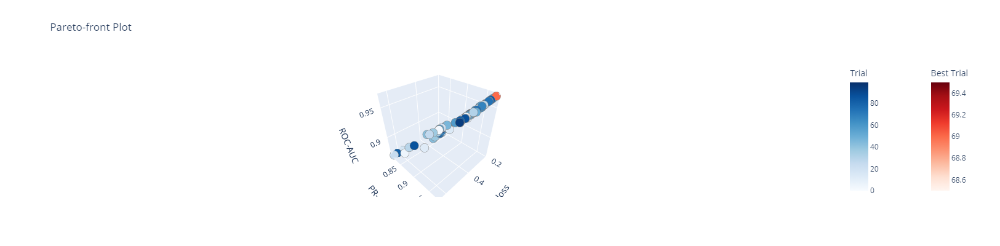

Optimization Progress: 100%|##########| 100/100 [20:54<00:00, 12.54s/it]


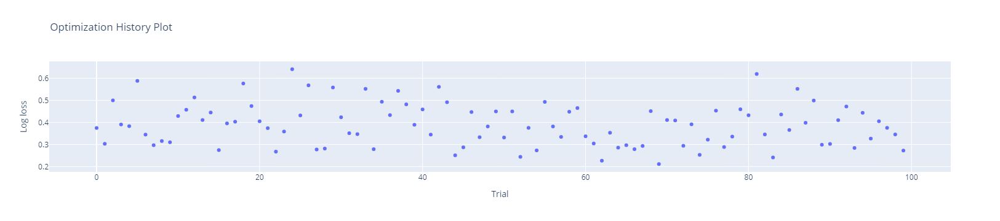

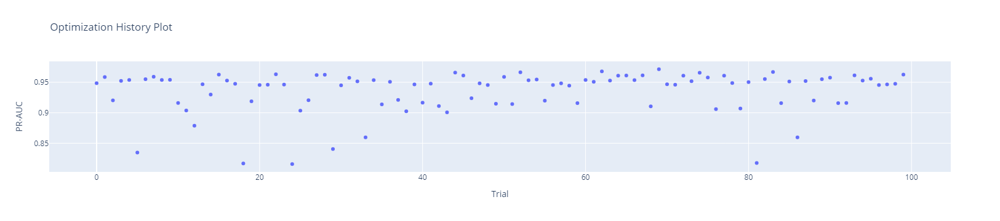

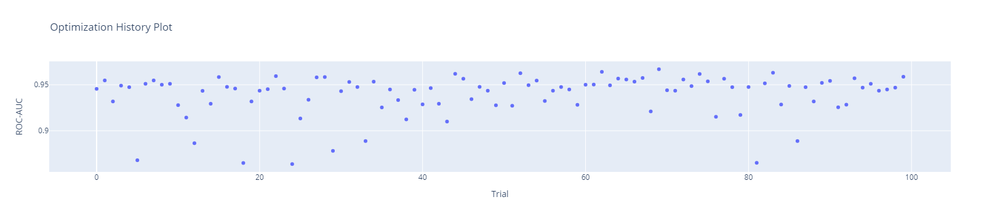

<span style = "font-size: 18px; font-weight: bold;"> Training with Best Trial 69: </span>

Full_params: {'loss': 'log_loss', 'verbose': 2, 'random_state': 42, 'categorical_features': 'from_dtype', 'max_depth': None, 'learning_rate': 0.09615350775493679, 'max_iter': 64, 'max_leaf_nodes': 81, 'min_samples_leaf': 47, 'l2_regularization': 1.1831955846640462e-05, 'class_weight': None, 'max_features': 0.7736302453809708, 'max_bins': 217, 'interaction_cst': 'pairwise', 'warm_start': False}
Binning 0.050 GB of training data: 0.236 s
0.016 s 0.006 GB of validation data: 
Fitting gradient boosted rounds:
1 tree, 81 leaves, max depth = 12, train loss: 0.63949, val loss: 0.64037, in 0.031s
1 tree, 81 leaves, max depth = 12, train loss: 0.59379, val loss: 0.59532, in 0.031s
1 tree, 81 leaves, max depth = 12, train loss: 0.55562, val loss: 0.55774, in 0.031s
1 tree, 81 leaves, max depth = 12, train loss: 0.52336, val loss: 0.52629, in 0.031s
1 tree, 81 leaves, max depth = 12, train loss: 0.49575, val loss: 0.49935, in 0.031s
1 tree, 81 leaves, max depth = 13, train loss: 0.47204, val loss

In [24]:
trial_progress = tqdm(total = n_trials, desc = "Optimization Progress", leave = True,
                      ascii = True,  # Plain text mode
                      dynamic_ncols = True   # Auto-fit width
                     )

def update_progress(study_hgbc, trial):
    trial_progress.update(1)

optuna.logging.disable_default_handler()

optuna.logging.enable_propagation()
optuna.logging.set_verbosity(optuna.logging.DEBUG)

logging.basicConfig(filename = "optuna_debug_HistGradientBoostingClassifier.log", filemode = "w", level = logging.DEBUG, format="%(asctime)s %(levelname)s %(message)s")

study_hgbc = optuna.create_study(study_name = "Optuna with HistGradientBoostingClassifier",
                                 directions = ["minimize", "maximize", "maximize"],
                                 sampler = module.AutoSampler(seed = seed)                                     
                               )

start_optuna = time.perf_counter()
study_hgbc.optimize(objective, n_trials = n_trials, n_jobs = 1, callbacks = [update_progress]) 
end_optuna = time.perf_counter()

print(f'Optuna Optimization Elapsed Time: {end_optuna - start_optuna} seconds')

fig = plot_pareto_front(study_hgbc, target_names = ["Log loss", "PR-AUC", "ROC-AUC"])
fig.update_layout(width = 900, height = 400)  # Set desired width and height in pixels
fig.show()

trial_progress.close()

metrics = ["Log loss", "PR-AUC", "ROC-AUC"]
for i, obj in enumerate(metrics):
    optuna.visualization.plot_optimization_history(study_hgbc,
                                                   target = lambda t: t.values[i],  # Correctly target each objective
                                                   target_name = obj).show()

best_trials = study_hgbc.best_trials
best_trials_hgbc = {}

exec_time_hgbc, lloss_auc_train_hgbc, lloss_auc_test_hgbc, all_metrics = [], [], [], []
cm_hgbc_all, cm_labels_hgbc_all = [], []

for i, trial in enumerate(best_trials):

    display(Markdown(f'<span style = "font-size: 18px; font-weight: bold;"> Training with Best Trial {trial.number}: </span>'))

    best_params = trial.params
    
    # Non-optimized and best Optuna optimized parameters
    full_params = {"loss": "log_loss",
                   "verbose": 2, 
                   "random_state": seed,
                   "categorical_features": "from_dtype",
                   "max_depth": None,                     
                   **best_params
                  }      
    print("Full_params:", full_params)
    best_trials_hgbc[trial.number] = full_params

    final_hgbc = HistGradientBoostingClassifier(**full_params)

    start_train = time.perf_counter()
    final_hgbc.fit(X_train, y_train)
    end_train = time.perf_counter()

    print(f'Training Elapsed Time: {end_train - start_train} seconds') 

    exec_time_hgbc.append({"Classifier": "HistGradientBoostingClassifier",
                           "Best Trial": trial.number,
                           "Optimization Elapsed Time (s)": end_optuna - start_optuna,
                           "Training Elapsed Time (s)": end_train - start_train})
    
    y_prob_all = final_hgbc.predict_proba(X_test)[:, 1]  
    y_pred_all = final_hgbc.predict(X_test)

    print(f'Log loss: (Train) {trial.values[0]} vs (Test) {log_loss(y_test, y_prob_all)}')
    print(f'PR-AUC:   (Train) {trial.values[1]} vs (Test) {average_precision_score(y_test, y_prob_all)}')
    print(f'ROC-AUC:  (Train) {trial.values[2]} vs (Test) {roc_auc_score(y_test, y_prob_all)}')

    lloss_auc_train_hgbc.append({"Classifier": "HistGradientBoostingClassifier",
                                 "Best Trial": trial.number,
                                 "Set": "Training",
                                 "Log loss": trial.values[0], 
                                 "PR-AUC": trial.values[1], 
                                 "ROC-AUC": trial.values[2]})

    lloss_auc_test_hgbc.append({"Classifier": "HistGradientBoostingClassifier",
                                "Best Trial": trial.number,
                                "Set": "Test",
                                "Log loss": log_loss(y_test, y_prob_all), 
                                "PR-AUC": average_precision_score(y_test, y_prob_all),
                                "ROC-AUC": roc_auc_score(y_test, y_prob_all)})

    report = classification_report(y_test, y_pred_all, target_names = ["Safe", "Risky"], output_dict = True)
    all_metrics.append({"Classifier": "HistGradientBoostingClassifier",
                        "Trial": trial.number,
                        "Accuracy": accuracy_score(y_test, y_pred_all),
                        "Precision (Safe)": report["Safe"]["precision"],
                        "Recall (Safe)": report["Safe"]["recall"],
                        "F1-score (Safe)": report["Safe"]["f1-score"],
                        "Precision (Risky)": report["Risky"]["precision"],
                        "Recall (Risky)": report["Risky"]["recall"],
                        "F1-score (Risky)": report["Risky"]["f1-score"],
                        "Precision (Macro avg)": report["macro avg"]["precision"],
                        "Recall (Macro avg)": report["macro avg"]["recall"],
                        "F1-score (Macro avg)": report["macro avg"]["f1-score"],
                        "Precision (Weighted avg)": report["weighted avg"]["precision"],
                        "Recall (Weighted avg)": report["weighted avg"]["recall"],
                        "F1-score (Weighted avg)": report["weighted avg"]["f1-score"]})
  

    # Store confusion matrix
    cm_final_hgbc = confusion_matrix(y_test, y_pred_all)
    cm_hgbc_all.append(cm_final_hgbc)
    cm_labels_hgbc_all.append(f'HistGradientBoostingClassifier Confusion Matrix for Best Trial {trial.number}')  # Store label for subplots     

df_metrics_hgbc = pd.DataFrame(all_metrics)

gc.collect();

In [25]:
save_results(clf_name = "HistGradientBoostingClassifier",
             best_trials = best_trials_hgbc,
             exec_time = exec_time_hgbc,
             lloss_auc_train = lloss_auc_train_hgbc,
             lloss_auc_test = lloss_auc_test_hgbc,
             df_metrics = df_metrics_hgbc,
             cm_final = cm_final_hgbc,
             cm_all = cm_hgbc_all,
             cm_labels = cm_labels_hgbc_all)

## Optuna with XGBoost

In [26]:
gc.collect();

In [27]:
X_df = clean_df.drop(columns = ["target", "anon_ssn"])

y_df = clean_df.target

anon_ssn = clean_df.anon_ssn;

In [28]:
# A single train-test split (80%-20%) using GroupShuffleSplit, ensuring that no anon_ssn (grouped by anon_ssn) appear in both sets
gss = GroupShuffleSplit(n_splits = 1, test_size = 0.2, random_state = seed)
train_idx, test_idx = next(gss.split(X_df, y_df, groups = anon_ssn))

X_train, X_test = X_df.iloc[train_idx], X_df.iloc[test_idx]
y_train, y_test = y_df.iloc[train_idx], y_df.iloc[test_idx]

anon_ssn_train = anon_ssn[train_idx]  # Keeping track of anon_ssn for cross-validation

In [29]:
# Estimate scale_pos_weight value to be used if data is imbalance only
estimate = Counter(y_train)[0] / Counter(y_train)[1]

In [30]:
del X_df, y_df, gss, train_idx, test_idx;

In [31]:
# Define the objective function
def objective(trial):
    
    # https://xgboost.readthedocs.io/en/stable/parameter.html#learning-task-parameters
    # https://xgboost.readthedocs.io/en/latest/treemethod.html
    # https://xgboost.readthedocs.io/en/stable/python/python_api.html#module-xgboost.training 
    # https://xgboost.readthedocs.io/en/stable/parameter.html#parameters-for-tree-booster
    param = {
        "objective": "binary:logistic",
        "booster": trial.suggest_categorical("booster", ["gbtree", "dart"]),
        "device": "cpu",
        "verbosity": 2,
        "validate_parameters": True,
        "eval_metric": ["logloss", "auc", "aucpr"],
        "seed": seed,
        "eta": trial.suggest_float("eta", 1e-2, 1e-1, log = True),
        "gamma": trial.suggest_float("gamma", 1e-8, 5e0, log = True),
        "max_depth": 0, # No limit on depth
        "min_child_weight": trial.suggest_float("min_child_weight", 1e-10, 1e1, log = True),
        "max_delta_step": trial.suggest_float("max_delta_step", 1, 100),
        "subsample": trial.suggest_float("subsample", 1e-1, 1.0),
        "sampling_method": "uniform",  # Only 'uniform' is supported on CPU
        "colsample_bytree": trial.suggest_float("colsample_bytree", 1e-1, 1e0),
        "colsample_bylevel": trial.suggest_float("colsample_bylevel", 1e-1, 1e0),
        "colsample_bynode": trial.suggest_float("colsample_bynode", 1e-1, 1e0),
        "lambda": trial.suggest_float("lambda", 1e-8, 1e1, log = True),
        "alpha": trial.suggest_float("alpha", 1e-8, 1e1, log = True),
        "tree_method": trial.suggest_categorical("tree_method", ["auto", "approx", "hist"]),  # CPU-supported methods
        "scale_pos_weight": trial.suggest_categorical("scale_pos_weight", [1, estimate]),
        "grow_policy": trial.suggest_categorical("grow_policy", ["depthwise", "lossguide"]),
        "max_leaves": trial.suggest_int("max_leaves", 2, 256),
        "max_bin": trial.suggest_int("max_bin", 40, 255),
        "num_parallel_tree": 1,
    }
   
    sgkf = StratifiedGroupKFold(n_splits = 5, shuffle = True, random_state = seed)
    lloss_scores, pr_auc_scores, roc_auc_scores = [], [], []
    
    for fold_idx, (train_index, valid_index) in enumerate(sgkf.split(X_train, y_train, groups = anon_ssn_train), start = 1):
  
        # Split data into training and validation sets
        X_train_fold, X_valid_fold = X_train.iloc[train_index], X_train.iloc[valid_index]
        y_train_fold, y_valid_fold = y_train.iloc[train_index], y_train.iloc[valid_index]       

        # Summarize the composition of classes in the train and validation sets
        train_0, train_1 = len(y_train_fold[y_train_fold == 0]), len(y_train_fold[y_train_fold == 1])
        valid_0, valid_1 = len(y_valid_fold[y_valid_fold == 0]), len(y_valid_fold[y_valid_fold == 1])

        print(f'Trial {trial.number}, Fold {fold_idx}: Train size = {len(train_index)} where 0 = {train_0}, 1 = {train_1}, 0/1 = {train_0/train_1}')
        print(f'Trial {trial.number}, Fold {fold_idx}: Validation size = {len(valid_index)} where  0 = {valid_0}, 1 = {valid_1}, 0/1 = {valid_0/valid_1}')

        # Create XGBoost datasets
        # https://xgboost.readthedocs.io/en/stable/python/python_api.html
        dtrain_fold = xgb.DMatrix(X_train_fold, label = y_train_fold, enable_categorical = True, nthread = -1)
        dvalid_fold = xgb.DMatrix(X_valid_fold, label = y_valid_fold, enable_categorical = True, nthread = -1)

        num_round = trial.suggest_int("num_boost_round", 5, 100)
         
        start_fold = time.perf_counter()
        # Train the model with the specified parameters and data
        # https://xgboost.readthedocs.io/en/stable/python/python_api.html#xgboost.train
        clf = xgb.train(param, 
                        dtrain_fold, 
                        num_boost_round = num_round,
                        evals = [(dvalid_fold, "validation")], # ValueError: Must have at least 1 validation dataset for early stopping
                        early_stopping_rounds = 50 
                       )
        end_fold = time.perf_counter()
        
        print(clf.attributes())  # Check model attributes
        
        y_prob_fold = clf.predict(dvalid_fold)   
        y_pred_fold = np.rint(y_prob_fold) # Set y_pred_fold = 1 if y_prob_fold => 0.5 and 0 if y_prob_fold < 0.5

        print(f'Trial {trial.number}, Fold {fold_idx}: '
              f'Log loss = {log_loss(y_valid_fold, y_prob_fold)}, '
              f'Average precision = {average_precision_score(y_valid_fold, y_prob_fold)}, '
              f'ROC-AUC = {roc_auc_score(y_valid_fold, y_prob_fold)}, '
              f'Elapsed Time = {end_fold - start_fold} seconds')   
        
        lloss_scores.append(log_loss(y_valid_fold, y_prob_fold))
        pr_auc_scores.append(average_precision_score(y_valid_fold, y_prob_fold))
        roc_auc_scores.append(roc_auc_score(y_valid_fold, y_prob_fold))

        del X_train_fold, X_valid_fold, y_train_fold, y_valid_fold, dtrain_fold, dvalid_fold, clf, start_fold, end_fold
        gc.collect()
        
    mean_lloss = np.mean(lloss_scores)
    mean_pr_auc = np.mean(pr_auc_scores)
    mean_roc_auc = np.mean(roc_auc_scores)

    del lloss_scores, pr_auc_scores, roc_auc_scores
    gc.collect()

    return mean_lloss, mean_pr_auc, mean_roc_auc

Optimization Progress:   0%|          | 0/100 [00:00<?, ?it/s]

Trial 0, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 0, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[17:58:56] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.68714	validation-auc:0.91258	validation-aucpr:0.91700
[17:58:56] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.68097	validation-auc:0.93166	validation-aucpr:0.93703
[17:58:56] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.67488	validation-auc:0.93897	validation-aucpr:0.94349
[17:58:56] INFO: C:\buildkite-agent\builds

Optimization Progress:   1%|1         | 1/100 [01:28<2:25:19, 88.08s/it]

Trial 1, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 1, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[18:00:22] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.63392	validation-auc:0.94384	validation-aucpr:0.94999
[18:00:22] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.58832	validation-auc:0.94990	validation-aucpr:0.94299
[18:00:23] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.54919	validation-auc:0.95494	validation-aucpr:0.94824
[18:00:23] INFO: C:\buildkite-agent\builds

Optimization Progress:   2%|2         | 2/100 [01:43<1:13:57, 45.28s/it]

Trial 2, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 2, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.68353	validation-auc:0.91262	validation-aucpr:0.91609
[1]	validation-logloss:0.67234	validation-auc:0.94708	validation-aucpr:0.95478
[2]	validation-logloss:0.66292	validation-auc:0.95054	validation-aucpr:0.95893
[3]	validation-logloss:0.65436	validation-auc:0.94975	validation-aucpr:0.95791
[4]	validation-logloss:0.64550	validation-auc:0.95050	validation-aucpr:0.95875
[5]	validation-logloss:0.63603	validation-auc:0.95166	validation-aucpr:0.95911
[6]	validation-logloss:0.62775	validation-auc:0.95168	validation-aucpr:0.95896
[7]	validation-logloss:0.62005	validation-auc:0.95170	validation-aucpr:0.95889
[8]	validation-logloss:0.61279	validation-auc:0.95124	validation-aucpr:0.95832
[9]	validation-logloss:0.60512	validation-auc:0.95178	validation-aucpr:0.95881
[10]	validation-logloss:0.598

Optimization Progress:   3%|3         | 3/100 [02:00<52:27, 32.45s/it]  

Trial 3, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 3, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.68648	validation-auc:0.92196	validation-aucpr:0.92137
[1]	validation-logloss:0.67979	validation-auc:0.93993	validation-aucpr:0.94332
[2]	validation-logloss:0.67481	validation-auc:0.93782	validation-aucpr:0.94263
[3]	validation-logloss:0.67037	validation-auc:0.94815	validation-aucpr:0.95520
[4]	validation-logloss:0.66325	validation-auc:0.95313	validation-aucpr:0.96064
[5]	validation-logloss:0.65757	validation-auc:0.95367	validation-aucpr:0.96074
[6]	validation-logloss:0.65164	validation-auc:0.95371	validation-aucpr:0.96076
[7]	validation-logloss:0.64613	validation-auc:0.95296	validation-aucpr:0.95999
[8]	validation-logloss:0.63929	validation-auc:0.95503	validation-aucpr:0.96216
[9]	validation-logloss:0.63400	validation-auc:0.95465	validation-aucpr:0.96159
[10]	validation-logloss:0.628

Optimization Progress:   4%|4         | 4/100 [02:22<45:23, 28.37s/it]

Trial 4, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 4, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.65332	validation-auc:0.91488	validation-aucpr:0.93009
[1]	validation-logloss:0.61677	validation-auc:0.95002	validation-aucpr:0.93873
[2]	validation-logloss:0.58489	validation-auc:0.95826	validation-aucpr:0.95774
[3]	validation-logloss:0.55534	validation-auc:0.96160	validation-aucpr:0.96131
[4]	validation-logloss:0.52807	validation-auc:0.96369	validation-aucpr:0.96267
[5]	validation-logloss:0.50386	validation-auc:0.96427	validation-aucpr:0.96573
[6]	validation-logloss:0.48156	validation-auc:0.96485	validation-aucpr:0.96500
[7]	validation-logloss:0.46084	validation-auc:0.96574	validation-aucpr:0.96729
[8]	validation-logloss:0.44250	validation-auc:0.96652	validation-aucpr:0.96887
[9]	validation-logloss:0.42517	validation-auc:0.96669	validation-aucpr:0.96917
[10]	validation-logloss:0.409

Optimization Progress:   5%|5         | 5/100 [02:47<42:36, 26.91s/it]

Trial 5, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 5, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.68411	validation-auc:0.92495	validation-aucpr:0.92667
[1]	validation-logloss:0.67398	validation-auc:0.95069	validation-aucpr:0.95639
[2]	validation-logloss:0.66382	validation-auc:0.95533	validation-aucpr:0.96185
[3]	validation-logloss:0.65600	validation-auc:0.95352	validation-aucpr:0.95998
[4]	validation-logloss:0.64691	validation-auc:0.95499	validation-aucpr:0.96191
[5]	validation-logloss:0.63940	validation-auc:0.95475	validation-aucpr:0.96156
[6]	validation-logloss:0.63110	validation-auc:0.95566	validation-aucpr:0.96202
[7]	validation-logloss:0.62281	validation-auc:0.95646	validation-aucpr:0.96287
[8]	validation-logloss:0.61529	validation-auc:0.95652	validation-aucpr:0.96296
[9]	validation-logloss:0.60838	validation-auc:0.95570	validation-aucpr:0.96218
[10]	validation-logloss:0.601

Optimization Progress:   6%|6         | 6/100 [03:11<41:00, 26.18s/it]

Trial 6, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 6, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.66868	validation-auc:0.92656	validation-aucpr:0.89275
[1]	validation-logloss:0.64642	validation-auc:0.94301	validation-aucpr:0.93566
[2]	validation-logloss:0.62475	validation-auc:0.95046	validation-aucpr:0.95092
[3]	validation-logloss:0.60542	validation-auc:0.95212	validation-aucpr:0.95692
[4]	validation-logloss:0.58687	validation-auc:0.95403	validation-aucpr:0.95893
[5]	validation-logloss:0.56954	validation-auc:0.95452	validation-aucpr:0.95945
[6]	validation-logloss:0.54956	validation-auc:0.96044	validation-aucpr:0.96491
[7]	validation-logloss:0.53461	validation-auc:0.96030	validation-aucpr:0.96489
[8]	validation-logloss:0.51724	validation-auc:0.96261	validation-aucpr:0.96724
[9]	validation-logloss:0.50330	validation-auc:0.96294	validation-aucpr:0.96786
[10]	validation-logloss:0.490

Optimization Progress:   7%|7         | 7/100 [03:29<36:20, 23.45s/it]

Trial 7, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 7, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.68016	validation-auc:0.89251	validation-aucpr:0.87031
[1]	validation-logloss:0.66712	validation-auc:0.90934	validation-aucpr:0.90403
[2]	validation-logloss:0.65493	validation-auc:0.91940	validation-aucpr:0.91914
[3]	validation-logloss:0.64218	validation-auc:0.92620	validation-aucpr:0.93081
[4]	validation-logloss:0.63544	validation-auc:0.92475	validation-aucpr:0.93087
[5]	validation-logloss:0.62441	validation-auc:0.93475	validation-aucpr:0.94099
[6]	validation-logloss:0.61526	validation-auc:0.93665	validation-aucpr:0.94386
[7]	validation-logloss:0.60932	validation-auc:0.93241	validation-aucpr:0.94166
[8]	validation-logloss:0.59916	validation-auc:0.93500	validation-aucpr:0.94389
[9]	validation-logloss:0.58964	validation-auc:0.93711	validation-aucpr:0.94473
[10]	validation-logloss:0.580

Optimization Progress:   8%|8         | 8/100 [03:43<31:07, 20.30s/it]

Trial 8, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 8, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.67257	validation-auc:0.92769	validation-aucpr:0.91050
[1]	validation-logloss:0.65027	validation-auc:0.95658	validation-aucpr:0.95645
[2]	validation-logloss:0.63157	validation-auc:0.95832	validation-aucpr:0.96167
[3]	validation-logloss:0.61415	validation-auc:0.95866	validation-aucpr:0.96361
[4]	validation-logloss:0.59720	validation-auc:0.95935	validation-aucpr:0.96394
[5]	validation-logloss:0.58111	validation-auc:0.95989	validation-aucpr:0.96423
[6]	validation-logloss:0.56754	validation-auc:0.95943	validation-aucpr:0.96397
[7]	validation-logloss:0.55336	validation-auc:0.95981	validation-aucpr:0.96470
[8]	validation-logloss:0.53679	validation-auc:0.96220	validation-aucpr:0.96740
[9]	validation-logloss:0.52404	validation-auc:0.96238	validation-aucpr:0.96753
[10]	validation-logloss:0.512

Optimization Progress:   9%|9         | 9/100 [03:59<28:51, 19.02s/it]

Trial 9, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 9, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[18:02:53] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.68501	validation-auc:0.94432	validation-aucpr:0.94674
[18:02:53] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.67707	validation-auc:0.94745	validation-aucpr:0.94975
[18:02:53] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.66938	validation-auc:0.95070	validation-aucpr:0.95346
[18:02:53] INFO: C:\buildkite-agent\builds

Optimization Progress:  10%|#         | 10/100 [04:26<32:11, 21.47s/it]

Trial 10, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 10, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.67854	validation-auc:0.91581	validation-aucpr:0.90795
[1]	validation-logloss:0.66452	validation-auc:0.92989	validation-aucpr:0.92944
[2]	validation-logloss:0.64978	validation-auc:0.94898	validation-aucpr:0.95368
[3]	validation-logloss:0.63678	validation-auc:0.95179	validation-aucpr:0.95817
[4]	validation-logloss:0.62092	validation-auc:0.95804	validation-aucpr:0.96407
[5]	validation-logloss:0.60858	validation-auc:0.95759	validation-aucpr:0.96377
[6]	validation-logloss:0.59778	validation-auc:0.95701	validation-aucpr:0.96330
[7]	validation-logloss:0.58770	validation-auc:0.95669	validation-aucpr:0.96292
[8]	validation-logloss:0.57914	validation-auc:0.95677	validation-aucpr:0.96342
[9]	validation-logloss:0.57009	validation-auc:0.95599	validation-aucpr:0.96237
[10]	validation-logloss:0.5

Optimization Progress:  11%|#1        | 11/100 [04:40<28:38, 19.30s/it]

Trial 11, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 11, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[18:03:37] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.68589	validation-auc:0.95478	validation-aucpr:0.95734
[18:03:40] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.67891	validation-auc:0.96195	validation-aucpr:0.96755
[18:03:43] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.67204	validation-auc:0.96271	validation-aucpr:0.96876
[18:03:46] INFO: C:\buildkite-agent\buil

Optimization Progress:  12%|#2        | 12/100 [25:57<9:49:25, 401.88s/it]

Trial 12, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 12, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[18:24:53] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.66259	validation-auc:0.94294	validation-aucpr:0.93924
[18:24:55] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.63428	validation-auc:0.95463	validation-aucpr:0.95805
[18:24:56] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.60932	validation-auc:0.95643	validation-aucpr:0.96112
[18:24:58] INFO: C:\buildkite-agent\buil

Optimization Progress:  13%|#3        | 13/100 [30:31<8:46:37, 363.19s/it]

Trial 13, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 13, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[18:29:32] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.68199	validation-auc:0.91934	validation-aucpr:0.89907
[18:29:32] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.67118	validation-auc:0.94339	validation-aucpr:0.94700
[18:29:32] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.65875	validation-auc:0.96044	validation-aucpr:0.96344
[18:29:32] INFO: C:\buildkite-agent\buil

Optimization Progress:  14%|#4        | 14/100 [31:20<6:24:32, 268.29s/it]

Trial 14, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 14, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[18:30:23] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.67300	validation-auc:0.93535	validation-aucpr:0.91414
[18:30:23] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.65352	validation-auc:0.95997	validation-aucpr:0.94955
[18:30:23] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.63501	validation-auc:0.96534	validation-aucpr:0.96582
[18:30:23] INFO: C:\buildkite-agent\buil

Optimization Progress:  15%|#5        | 15/100 [32:16<4:49:20, 204.24s/it]

Trial 15, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 15, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[18:31:11] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.65835	validation-auc:0.95231	validation-aucpr:0.95569
[18:31:11] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.62991	validation-auc:0.95311	validation-aucpr:0.95398
[18:31:11] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.60171	validation-auc:0.95713	validation-aucpr:0.96099
[18:31:11] INFO: C:\buildkite-agent\buil

Optimization Progress:  16%|#6        | 16/100 [32:52<3:35:03, 153.61s/it]

Trial 16, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 16, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.66463	validation-auc:0.95925	validation-aucpr:0.96434
[1]	validation-logloss:0.64010	validation-auc:0.96240	validation-aucpr:0.96801
[2]	validation-logloss:0.61513	validation-auc:0.96566	validation-aucpr:0.97118
[3]	validation-logloss:0.59295	validation-auc:0.96626	validation-aucpr:0.97152
[4]	validation-logloss:0.57390	validation-auc:0.96643	validation-aucpr:0.97140
[5]	validation-logloss:0.55627	validation-auc:0.96664	validation-aucpr:0.97154
[6]	validation-logloss:0.54065	validation-auc:0.96639	validation-aucpr:0.97129
[7]	validation-logloss:0.52491	validation-auc:0.96629	validation-aucpr:0.97117
[8]	validation-logloss:0.51049	validation-auc:0.96623	validation-aucpr:0.97103
[9]	validation-logloss:0.49658	validation-auc:0.96627	validation-aucpr:0.97104
[10]	validation-logloss:0.4

Optimization Progress:  17%|#7        | 17/100 [33:52<2:53:29, 125.41s/it]

Trial 17, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 17, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.68070	validation-auc:0.94898	validation-aucpr:0.92672
[1]	validation-logloss:0.67016	validation-auc:0.96222	validation-aucpr:0.96208
[2]	validation-logloss:0.65893	validation-auc:0.96484	validation-aucpr:0.96820
[3]	validation-logloss:0.64785	validation-auc:0.96631	validation-aucpr:0.96911
[4]	validation-logloss:0.63708	validation-auc:0.96744	validation-aucpr:0.97010
[5]	validation-logloss:0.62658	validation-auc:0.96754	validation-aucpr:0.96975
[6]	validation-logloss:0.61637	validation-auc:0.96832	validation-aucpr:0.97309
[7]	validation-logloss:0.60679	validation-auc:0.96827	validation-aucpr:0.97310
[8]	validation-logloss:0.59797	validation-auc:0.96876	validation-aucpr:0.97353
[9]	validation-logloss:0.58967	validation-auc:0.96903	validation-aucpr:0.97361
[10]	validation-logloss:0.5

Optimization Progress:  18%|#8        | 18/100 [34:09<2:06:46, 92.76s/it] 

Trial 18, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 18, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.66415	validation-auc:0.90117	validation-aucpr:0.89825
[1]	validation-logloss:0.63802	validation-auc:0.91492	validation-aucpr:0.91811
[2]	validation-logloss:0.61375	validation-auc:0.92827	validation-aucpr:0.93063
[3]	validation-logloss:0.58648	validation-auc:0.94237	validation-aucpr:0.94863
[4]	validation-logloss:0.56778	validation-auc:0.94191	validation-aucpr:0.95001
[5]	validation-logloss:0.54988	validation-auc:0.94233	validation-aucpr:0.95046
[6]	validation-logloss:0.52795	validation-auc:0.94457	validation-aucpr:0.95350
[7]	validation-logloss:0.50871	validation-auc:0.94546	validation-aucpr:0.95459
[8]	validation-logloss:0.49224	validation-auc:0.94577	validation-aucpr:0.95474
[9]	validation-logloss:0.47824	validation-auc:0.94599	validation-aucpr:0.95491
[10]	validation-logloss:0.4

Optimization Progress:  19%|#9        | 19/100 [34:27<1:35:04, 70.43s/it]

Trial 19, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 19, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.66687	validation-auc:0.95022	validation-aucpr:0.94356
[1]	validation-logloss:0.64264	validation-auc:0.96143	validation-aucpr:0.96320
[2]	validation-logloss:0.62001	validation-auc:0.96411	validation-aucpr:0.96722
[3]	validation-logloss:0.60135	validation-auc:0.96370	validation-aucpr:0.96627
[4]	validation-logloss:0.58193	validation-auc:0.96485	validation-aucpr:0.96795
[5]	validation-logloss:0.56536	validation-auc:0.96431	validation-aucpr:0.97006
[6]	validation-logloss:0.55004	validation-auc:0.96422	validation-aucpr:0.96988
[7]	validation-logloss:0.53504	validation-auc:0.96411	validation-aucpr:0.96973
[8]	validation-logloss:0.52199	validation-auc:0.96384	validation-aucpr:0.96953
[9]	validation-logloss:0.50660	validation-auc:0.96426	validation-aucpr:0.96991
[10]	validation-logloss:0.4

Optimization Progress:  20%|##        | 20/100 [34:37<1:09:46, 52.33s/it]

Trial 20, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 20, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[18:33:33] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.66078	validation-auc:0.93642	validation-aucpr:0.93490
[18:33:33] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.63086	validation-auc:0.94541	validation-aucpr:0.94612
[18:33:33] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.60533	validation-auc:0.94667	validation-aucpr:0.94864
[18:33:33] INFO: C:\buildkite-agent\buil

Optimization Progress:  21%|##1       | 21/100 [35:22<1:05:56, 50.08s/it]

Trial 21, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 21, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[18:34:22] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.68447	validation-auc:0.93569	validation-aucpr:0.89227
[18:34:22] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.67583	validation-auc:0.96004	validation-aucpr:0.95021
[18:34:22] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.66753	validation-auc:0.96484	validation-aucpr:0.96664
[18:34:22] INFO: C:\buildkite-agent\buil

Optimization Progress:  22%|##2       | 22/100 [37:17<1:30:15, 69.43s/it]

Trial 22, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 22, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[18:36:11] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.66534	validation-auc:0.82859	validation-aucpr:0.81740
[18:36:11] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.63069	validation-auc:0.84888	validation-aucpr:0.82950
[18:36:11] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.61584	validation-auc:0.86316	validation-aucpr:0.85073
[18:36:11] INFO: C:\buildkite-agent\buil

Optimization Progress:  23%|##3       | 23/100 [37:27<1:06:26, 51.77s/it]

Trial 23, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 23, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.65142	validation-auc:0.94745	validation-aucpr:0.95243
[1]	validation-logloss:0.62137	validation-auc:0.94927	validation-aucpr:0.95089
[2]	validation-logloss:0.59166	validation-auc:0.95627	validation-aucpr:0.95819
[3]	validation-logloss:0.56790	validation-auc:0.95636	validation-aucpr:0.96088
[4]	validation-logloss:0.54506	validation-auc:0.95734	validation-aucpr:0.96296
[5]	validation-logloss:0.52566	validation-auc:0.95732	validation-aucpr:0.96323
[6]	validation-logloss:0.50700	validation-auc:0.95756	validation-aucpr:0.96351
[7]	validation-logloss:0.49095	validation-auc:0.95730	validation-aucpr:0.96324
[8]	validation-logloss:0.47611	validation-auc:0.95725	validation-aucpr:0.96301
[9]	validation-logloss:0.46227	validation-auc:0.95769	validation-aucpr:0.96355
[10]	validation-logloss:0.4

Optimization Progress:  24%|##4       | 24/100 [37:40<50:37, 39.97s/it]  

Trial 24, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 24, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[18:36:34] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.67754	validation-auc:0.94648	validation-aucpr:0.95313
[18:36:34] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.66446	validation-auc:0.95291	validation-aucpr:0.94587
[18:36:34] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.65146	validation-auc:0.95806	validation-aucpr:0.95520
[18:36:34] INFO: C:\buildkite-agent\buil

Optimization Progress:  25%|##5       | 25/100 [38:13<47:30, 38.01s/it]

Trial 25, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 25, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.67136	validation-auc:0.92645	validation-aucpr:0.92797
[1]	validation-logloss:0.65045	validation-auc:0.93927	validation-aucpr:0.94577
[2]	validation-logloss:0.62847	validation-auc:0.95043	validation-aucpr:0.95863
[3]	validation-logloss:0.60879	validation-auc:0.95524	validation-aucpr:0.96105
[4]	validation-logloss:0.59011	validation-auc:0.95747	validation-aucpr:0.96265
[5]	validation-logloss:0.57531	validation-auc:0.95568	validation-aucpr:0.96092
[6]	validation-logloss:0.55744	validation-auc:0.95778	validation-aucpr:0.96344
[7]	validation-logloss:0.54321	validation-auc:0.95790	validation-aucpr:0.96430
[8]	validation-logloss:0.53138	validation-auc:0.95740	validation-aucpr:0.96381
[9]	validation-logloss:0.51916	validation-auc:0.95736	validation-aucpr:0.96369
[10]	validation-logloss:0.5

Optimization Progress:  26%|##6       | 26/100 [38:28<38:27, 31.18s/it]

Trial 26, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 26, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[18:37:23] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.68542	validation-auc:0.95577	validation-aucpr:0.96213
[18:37:24] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.67867	validation-auc:0.96068	validation-aucpr:0.96692
[18:37:26] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.67120	validation-auc:0.96338	validation-aucpr:0.96919
[18:37:27] INFO: C:\buildkite-agent\buil

Optimization Progress:  27%|##7       | 27/100 [47:35<3:45:59, 185.75s/it]

Trial 27, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 27, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.67710	validation-auc:0.81462	validation-aucpr:0.74736
[1]	validation-logloss:0.66225	validation-auc:0.89137	validation-aucpr:0.83793
[2]	validation-logloss:0.64776	validation-auc:0.93149	validation-aucpr:0.91845
[3]	validation-logloss:0.63378	validation-auc:0.94311	validation-aucpr:0.93988
[4]	validation-logloss:0.62062	validation-auc:0.94563	validation-aucpr:0.94713
[5]	validation-logloss:0.60765	validation-auc:0.95090	validation-aucpr:0.95911
[6]	validation-logloss:0.59496	validation-auc:0.95299	validation-aucpr:0.96198
[7]	validation-logloss:0.58297	validation-auc:0.95449	validation-aucpr:0.96269
[8]	validation-logloss:0.57165	validation-auc:0.95677	validation-aucpr:0.96310
[9]	validation-logloss:0.56193	validation-auc:0.95746	validation-aucpr:0.96273
[10]	validation-logloss:0.5

Optimization Progress:  28%|##8       | 28/100 [48:52<3:03:46, 153.15s/it]

Trial 28, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 28, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.67453	validation-auc:0.92966	validation-aucpr:0.92412
[1]	validation-logloss:0.65734	validation-auc:0.94220	validation-aucpr:0.94079
[2]	validation-logloss:0.64190	validation-auc:0.94381	validation-aucpr:0.94793
[3]	validation-logloss:0.62513	validation-auc:0.95034	validation-aucpr:0.95588
[4]	validation-logloss:0.61047	validation-auc:0.95093	validation-aucpr:0.95709
[5]	validation-logloss:0.59542	validation-auc:0.95285	validation-aucpr:0.95884
[6]	validation-logloss:0.58235	validation-auc:0.95329	validation-aucpr:0.95917
[7]	validation-logloss:0.56761	validation-auc:0.95724	validation-aucpr:0.96378
[8]	validation-logloss:0.55330	validation-auc:0.95864	validation-aucpr:0.96548
[9]	validation-logloss:0.54248	validation-auc:0.95811	validation-aucpr:0.96489
[10]	validation-logloss:0.5

Optimization Progress:  29%|##9       | 29/100 [49:06<2:11:52, 111.45s/it]

Trial 29, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 29, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[18:48:01] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.64541	validation-auc:0.91169	validation-aucpr:0.91761
[18:48:01] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.60390	validation-auc:0.93151	validation-aucpr:0.93490
[18:48:01] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.56258	validation-auc:0.94565	validation-aucpr:0.95033
[18:48:01] INFO: C:\buildkite-agent\buil

Optimization Progress:  30%|###       | 30/100 [49:53<1:47:34, 92.21s/it] 

Trial 30, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 30, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.68429	validation-auc:0.94592	validation-aucpr:0.95150
[1]	validation-logloss:0.67552	validation-auc:0.93777	validation-aucpr:0.94722
[2]	validation-logloss:0.66675	validation-auc:0.94673	validation-aucpr:0.94831
[3]	validation-logloss:0.65861	validation-auc:0.95024	validation-aucpr:0.95688
[4]	validation-logloss:0.65139	validation-auc:0.95150	validation-aucpr:0.95454
[5]	validation-logloss:0.64332	validation-auc:0.95423	validation-aucpr:0.96099
[6]	validation-logloss:0.63530	validation-auc:0.95723	validation-aucpr:0.96523
[7]	validation-logloss:0.62740	validation-auc:0.95863	validation-aucpr:0.96553
[8]	validation-logloss:0.61993	validation-auc:0.95944	validation-aucpr:0.96701
[9]	validation-logloss:0.61339	validation-auc:0.95979	validation-aucpr:0.96727
[10]	validation-logloss:0.6

Optimization Progress:  31%|###1      | 31/100 [50:17<1:22:15, 71.52s/it]

Trial 31, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 31, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.66183	validation-auc:0.95646	validation-aucpr:0.95706
[1]	validation-logloss:0.63297	validation-auc:0.96248	validation-aucpr:0.96496
[2]	validation-logloss:0.60646	validation-auc:0.96382	validation-aucpr:0.96777
[3]	validation-logloss:0.58199	validation-auc:0.96545	validation-aucpr:0.97079
[4]	validation-logloss:0.55933	validation-auc:0.96640	validation-aucpr:0.97186
[5]	validation-logloss:0.53802	validation-auc:0.96680	validation-aucpr:0.97221
[6]	validation-logloss:0.51885	validation-auc:0.96668	validation-aucpr:0.97209
[7]	validation-logloss:0.50046	validation-auc:0.96686	validation-aucpr:0.97228
[8]	validation-logloss:0.48402	validation-auc:0.96716	validation-aucpr:0.97265
[9]	validation-logloss:0.46789	validation-auc:0.96732	validation-aucpr:0.97279
[10]	validation-logloss:0.4

Optimization Progress:  32%|###2      | 32/100 [50:30<1:01:27, 54.22s/it]

Trial 32, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 32, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.67263	validation-auc:0.94340	validation-aucpr:0.95202
[1]	validation-logloss:0.65321	validation-auc:0.95034	validation-aucpr:0.95581
[2]	validation-logloss:0.63598	validation-auc:0.95080	validation-aucpr:0.95973
[3]	validation-logloss:0.61883	validation-auc:0.95193	validation-aucpr:0.96076
[4]	validation-logloss:0.60229	validation-auc:0.95492	validation-aucpr:0.96341
[5]	validation-logloss:0.58667	validation-auc:0.95776	validation-aucpr:0.96592
[6]	validation-logloss:0.57125	validation-auc:0.95920	validation-aucpr:0.96671
[7]	validation-logloss:0.55687	validation-auc:0.96026	validation-aucpr:0.96781
[8]	validation-logloss:0.54337	validation-auc:0.96070	validation-aucpr:0.96799
[9]	validation-logloss:0.53106	validation-auc:0.96176	validation-aucpr:0.96795
[10]	validation-logloss:0.5

Optimization Progress:  33%|###3      | 33/100 [2:21:10<31:04:44, 1669.92s/it]

Trial 33, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 33, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.68334	validation-auc:0.96185	validation-aucpr:0.96505
[1]	validation-logloss:0.67396	validation-auc:0.96582	validation-aucpr:0.97007
[2]	validation-logloss:0.66562	validation-auc:0.96601	validation-aucpr:0.97066
[3]	validation-logloss:0.65712	validation-auc:0.96579	validation-aucpr:0.97046
[4]	validation-logloss:0.64923	validation-auc:0.96559	validation-aucpr:0.97019
[5]	validation-logloss:0.64059	validation-auc:0.96629	validation-aucpr:0.97070
[6]	validation-logloss:0.63328	validation-auc:0.96574	validation-aucpr:0.97018
[7]	validation-logloss:0.62495	validation-auc:0.96681	validation-aucpr:0.97111
[8]	validation-logloss:0.61692	validation-auc:0.96710	validation-aucpr:0.97144
[9]	validation-logloss:0.60912	validation-auc:0.96732	validation-aucpr:0.97173
[10]	validation-logloss:0.6

Optimization Progress:  34%|###4      | 34/100 [2:21:33<21:33:26, 1175.85s/it]

Trial 34, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 34, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.68198	validation-auc:0.95130	validation-aucpr:0.95540
[1]	validation-logloss:0.67112	validation-auc:0.95892	validation-aucpr:0.96265
[2]	validation-logloss:0.66069	validation-auc:0.96145	validation-aucpr:0.96424
[3]	validation-logloss:0.65041	validation-auc:0.96213	validation-aucpr:0.96619
[4]	validation-logloss:0.64063	validation-auc:0.96271	validation-aucpr:0.96646
[5]	validation-logloss:0.63112	validation-auc:0.96362	validation-aucpr:0.96797
{'best_iteration': '5', 'best_score': '0.967973486067347'}
Trial 34, Fold 1: Log loss = 0.6311222487753312, Average precision = 0.9682110235622168, ROC-AUC = 0.9636233677702738, Elapsed Time = 0.641079200002423 seconds
Trial 34, Fold 2: Train size = 20701 where 0 = 10471, 1 = 10230, 0/1 = 1.0235581622678396
Trial 34, Fold 2: Validation size 

Optimization Progress:  35%|###5      | 35/100 [2:21:45<14:55:20, 826.47s/it] 

Trial 35, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 35, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.66299	validation-auc:0.94914	validation-aucpr:0.93790
[1]	validation-logloss:0.63898	validation-auc:0.95939	validation-aucpr:0.95686
[2]	validation-logloss:0.61353	validation-auc:0.96323	validation-aucpr:0.96870
[3]	validation-logloss:0.59262	validation-auc:0.96437	validation-aucpr:0.96937
[4]	validation-logloss:0.57084	validation-auc:0.96506	validation-aucpr:0.97017
[5]	validation-logloss:0.55311	validation-auc:0.96458	validation-aucpr:0.96955
[6]	validation-logloss:0.53632	validation-auc:0.96413	validation-aucpr:0.96899
[7]	validation-logloss:0.52077	validation-auc:0.96405	validation-aucpr:0.96897
[8]	validation-logloss:0.50527	validation-auc:0.96454	validation-aucpr:0.96942
[9]	validation-logloss:0.49136	validation-auc:0.96459	validation-aucpr:0.96880
[10]	validation-logloss:0.4

Optimization Progress:  36%|###6      | 36/100 [2:22:02<10:22:32, 583.63s/it]

Trial 36, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 36, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.62882	validation-auc:0.93107	validation-aucpr:0.88995
[1]	validation-logloss:0.57594	validation-auc:0.95804	validation-aucpr:0.94536
[2]	validation-logloss:0.53013	validation-auc:0.96362	validation-aucpr:0.96144
[3]	validation-logloss:0.49113	validation-auc:0.96601	validation-aucpr:0.96749
[4]	validation-logloss:0.45755	validation-auc:0.96711	validation-aucpr:0.97002
[5]	validation-logloss:0.42871	validation-auc:0.96667	validation-aucpr:0.96973
[6]	validation-logloss:0.40344	validation-auc:0.96731	validation-aucpr:0.97032
[7]	validation-logloss:0.38041	validation-auc:0.96826	validation-aucpr:0.97101
[8]	validation-logloss:0.36071	validation-auc:0.96869	validation-aucpr:0.97158
[9]	validation-logloss:0.34296	validation-auc:0.96910	validation-aucpr:0.97160
[10]	validation-logloss:0.3

Optimization Progress:  37%|###7      | 37/100 [2:23:42<7:40:34, 438.64s/it] 

Trial 37, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 37, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.65316	validation-auc:0.94886	validation-aucpr:0.95153
[1]	validation-logloss:0.61796	validation-auc:0.95469	validation-aucpr:0.95909
[2]	validation-logloss:0.58590	validation-auc:0.95620	validation-aucpr:0.96087
[3]	validation-logloss:0.55682	validation-auc:0.95743	validation-aucpr:0.96198
[4]	validation-logloss:0.53131	validation-auc:0.95800	validation-aucpr:0.96257
[5]	validation-logloss:0.50323	validation-auc:0.96314	validation-aucpr:0.96681
[6]	validation-logloss:0.48294	validation-auc:0.96276	validation-aucpr:0.96647
[7]	validation-logloss:0.46407	validation-auc:0.96293	validation-aucpr:0.96638
[8]	validation-logloss:0.44304	validation-auc:0.96503	validation-aucpr:0.96855
[9]	validation-logloss:0.42751	validation-auc:0.96508	validation-aucpr:0.96846
[10]	validation-logloss:0.4

Optimization Progress:  38%|###8      | 38/100 [2:24:04<5:24:16, 313.82s/it]

Trial 38, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 38, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[20:22:58] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.68047	validation-auc:0.91070	validation-aucpr:0.89779
[20:22:58] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.66627	validation-auc:0.93986	validation-aucpr:0.93921
[20:22:58] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.65357	validation-auc:0.94255	validation-aucpr:0.94553
[20:22:58] INFO: C:\buildkite-agent\buil

Optimization Progress:  39%|###9      | 39/100 [2:24:34<3:52:14, 228.43s/it]

Trial 39, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 39, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.69226	validation-auc:0.63014	validation-aucpr:0.67987
[1]	validation-logloss:0.68619	validation-auc:0.89844	validation-aucpr:0.87978
[2]	validation-logloss:0.68015	validation-auc:0.92588	validation-aucpr:0.92816
[3]	validation-logloss:0.67398	validation-auc:0.93739	validation-aucpr:0.94171
[4]	validation-logloss:0.66769	validation-auc:0.94633	validation-aucpr:0.95256
[5]	validation-logloss:0.66270	validation-auc:0.94563	validation-aucpr:0.95211
[6]	validation-logloss:0.65710	validation-auc:0.94542	validation-aucpr:0.95179
[7]	validation-logloss:0.65143	validation-auc:0.94734	validation-aucpr:0.95300
[8]	validation-logloss:0.64719	validation-auc:0.94662	validation-aucpr:0.95258
[9]	validation-logloss:0.64204	validation-auc:0.94688	validation-aucpr:0.95271
[10]	validation-logloss:0.6

Optimization Progress:  40%|####      | 40/100 [2:24:52<2:45:16, 165.27s/it]

Trial 40, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 40, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[20:23:46] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.63086	validation-auc:0.92500	validation-aucpr:0.89044
[20:23:46] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.58262	validation-auc:0.95148	validation-aucpr:0.93704
[20:23:46] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.53810	validation-auc:0.95822	validation-aucpr:0.95171
[20:23:46] INFO: C:\buildkite-agent\buil

Optimization Progress:  41%|####1     | 41/100 [2:25:54<2:12:09, 134.40s/it]

Trial 41, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 41, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.68331	validation-auc:0.95047	validation-aucpr:0.95393
[1]	validation-logloss:0.67501	validation-auc:0.95415	validation-aucpr:0.95984
[2]	validation-logloss:0.66635	validation-auc:0.95465	validation-aucpr:0.96120
[3]	validation-logloss:0.65800	validation-auc:0.95560	validation-aucpr:0.96189
[4]	validation-logloss:0.65015	validation-auc:0.95545	validation-aucpr:0.96146
[5]	validation-logloss:0.64237	validation-auc:0.95490	validation-aucpr:0.96079
[6]	validation-logloss:0.63338	validation-auc:0.95775	validation-aucpr:0.96387
[7]	validation-logloss:0.62638	validation-auc:0.95698	validation-aucpr:0.96304
[8]	validation-logloss:0.61959	validation-auc:0.95631	validation-aucpr:0.96217
[9]	validation-logloss:0.61143	validation-auc:0.95731	validation-aucpr:0.96141
[10]	validation-logloss:0.6

Optimization Progress:  42%|####2     | 42/100 [2:26:24<1:39:34, 103.01s/it]

Trial 42, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 42, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.68113	validation-auc:0.94891	validation-aucpr:0.92942
[1]	validation-logloss:0.66946	validation-auc:0.96345	validation-aucpr:0.96057
[2]	validation-logloss:0.65818	validation-auc:0.96507	validation-aucpr:0.96730
[3]	validation-logloss:0.64900	validation-auc:0.96546	validation-aucpr:0.96958
[4]	validation-logloss:0.63959	validation-auc:0.96565	validation-aucpr:0.96935
[5]	validation-logloss:0.63061	validation-auc:0.96558	validation-aucpr:0.96940
[6]	validation-logloss:0.62165	validation-auc:0.96546	validation-aucpr:0.96913
[7]	validation-logloss:0.61220	validation-auc:0.96615	validation-aucpr:0.97013
[8]	validation-logloss:0.60262	validation-auc:0.96637	validation-aucpr:0.97038
[9]	validation-logloss:0.59342	validation-auc:0.96671	validation-aucpr:0.97070
[10]	validation-logloss:0.5

Optimization Progress:  43%|####3     | 43/100 [2:26:42<1:13:49, 77.72s/it] 

Trial 43, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 43, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[20:25:37] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.67385	validation-auc:0.94143	validation-aucpr:0.94742
[20:25:37] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.65498	validation-auc:0.95671	validation-aucpr:0.96049
[20:25:37] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.63800	validation-auc:0.95647	validation-aucpr:0.95995
[20:25:37] INFO: C:\buildkite-agent\buil

Optimization Progress:  44%|####4     | 44/100 [2:27:03<56:40, 60.72s/it]  

Trial 44, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 44, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.65514	validation-auc:0.87809	validation-aucpr:0.88222
[1]	validation-logloss:0.60224	validation-auc:0.94543	validation-aucpr:0.95331
[2]	validation-logloss:0.56799	validation-auc:0.94776	validation-aucpr:0.95521
[3]	validation-logloss:0.53744	validation-auc:0.94993	validation-aucpr:0.95683
[4]	validation-logloss:0.51274	validation-auc:0.95064	validation-aucpr:0.95757
[5]	validation-logloss:0.48533	validation-auc:0.95375	validation-aucpr:0.95984
[6]	validation-logloss:0.46379	validation-auc:0.95533	validation-aucpr:0.96080
[7]	validation-logloss:0.44329	validation-auc:0.95685	validation-aucpr:0.96192
[8]	validation-logloss:0.42770	validation-auc:0.95626	validation-aucpr:0.96119
[9]	validation-logloss:0.41215	validation-auc:0.95657	validation-aucpr:0.96147
[10]	validation-logloss:0.4

Optimization Progress:  45%|####5     | 45/100 [2:32:45<2:12:49, 144.91s/it]

Trial 45, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 45, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.67020	validation-auc:0.93525	validation-aucpr:0.92509
[1]	validation-logloss:0.64890	validation-auc:0.94891	validation-aucpr:0.95024
[2]	validation-logloss:0.62574	validation-auc:0.96047	validation-aucpr:0.96201
[3]	validation-logloss:0.60522	validation-auc:0.96166	validation-aucpr:0.96670
[4]	validation-logloss:0.58834	validation-auc:0.96130	validation-aucpr:0.96647
[5]	validation-logloss:0.57257	validation-auc:0.96252	validation-aucpr:0.96778
[6]	validation-logloss:0.55801	validation-auc:0.96231	validation-aucpr:0.96771
[7]	validation-logloss:0.54446	validation-auc:0.96181	validation-aucpr:0.96734
[8]	validation-logloss:0.53092	validation-auc:0.96239	validation-aucpr:0.96754
[9]	validation-logloss:0.51747	validation-auc:0.96278	validation-aucpr:0.96804
[10]	validation-logloss:0.5

Optimization Progress:  46%|####6     | 46/100 [2:32:58<1:34:55, 105.48s/it]

Trial 46, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 46, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[20:31:56] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.64076	validation-auc:0.93869	validation-aucpr:0.93708
[20:32:00] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.60029	validation-auc:0.95067	validation-aucpr:0.94280
[20:32:04] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.56030	validation-auc:0.95506	validation-aucpr:0.95160
[20:32:08] INFO: C:\buildkite-agent\buil

Optimization Progress:  47%|####6     | 47/100 [2:47:24<4:54:45, 333.68s/it]

Trial 47, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 47, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[20:46:18] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.68214	validation-auc:0.93801	validation-aucpr:0.91337
[20:46:18] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.67009	validation-auc:0.95823	validation-aucpr:0.95300
[20:46:18] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.65805	validation-auc:0.96329	validation-aucpr:0.96345
[20:46:18] INFO: C:\buildkite-agent\buil

Optimization Progress:  48%|####8     | 48/100 [2:47:34<3:25:00, 236.55s/it]

Trial 48, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 48, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.65265	validation-auc:0.92815	validation-aucpr:0.91366
[1]	validation-logloss:0.61911	validation-auc:0.95030	validation-aucpr:0.94360
[2]	validation-logloss:0.58864	validation-auc:0.95679	validation-aucpr:0.95677
[3]	validation-logloss:0.56412	validation-auc:0.95688	validation-aucpr:0.95950
[4]	validation-logloss:0.54044	validation-auc:0.95838	validation-aucpr:0.96405
[5]	validation-logloss:0.52041	validation-auc:0.95850	validation-aucpr:0.96382
[6]	validation-logloss:0.50156	validation-auc:0.95872	validation-aucpr:0.96450
[7]	validation-logloss:0.48352	validation-auc:0.95926	validation-aucpr:0.96478
[8]	validation-logloss:0.46713	validation-auc:0.95954	validation-aucpr:0.96497
{'best_iteration': '8', 'best_score': '0.9649673171907855'}
Trial 48, Fold 1: Log loss = 0.467128135091192

Optimization Progress:  49%|####9     | 49/100 [2:48:13<2:30:30, 177.07s/it]

Trial 49, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 49, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.66453	validation-auc:0.94548	validation-aucpr:0.90619
[1]	validation-logloss:0.63846	validation-auc:0.96347	validation-aucpr:0.96426
[2]	validation-logloss:0.61384	validation-auc:0.96495	validation-aucpr:0.96393
[3]	validation-logloss:0.59333	validation-auc:0.96549	validation-aucpr:0.96700
[4]	validation-logloss:0.57190	validation-auc:0.96666	validation-aucpr:0.96992
[5]	validation-logloss:0.55194	validation-auc:0.96736	validation-aucpr:0.97049
[6]	validation-logloss:0.53343	validation-auc:0.96833	validation-aucpr:0.97261
[7]	validation-logloss:0.51641	validation-auc:0.96822	validation-aucpr:0.97019
[8]	validation-logloss:0.50181	validation-auc:0.96823	validation-aucpr:0.97071
[9]	validation-logloss:0.48792	validation-auc:0.96822	validation-aucpr:0.97064
[10]	validation-logloss:0.4

Optimization Progress:  50%|#####     | 50/100 [2:49:00<1:55:06, 138.13s/it]

Trial 50, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 50, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.68362	validation-auc:0.93883	validation-aucpr:0.94319
[1]	validation-logloss:0.67417	validation-auc:0.94860	validation-aucpr:0.95309
[2]	validation-logloss:0.66495	validation-auc:0.95193	validation-aucpr:0.95658
[3]	validation-logloss:0.65565	validation-auc:0.95530	validation-aucpr:0.95966
[4]	validation-logloss:0.64702	validation-auc:0.95608	validation-aucpr:0.96053
[5]	validation-logloss:0.63888	validation-auc:0.95603	validation-aucpr:0.96063
[6]	validation-logloss:0.62932	validation-auc:0.96132	validation-aucpr:0.96664
[7]	validation-logloss:0.62109	validation-auc:0.96145	validation-aucpr:0.96677
[8]	validation-logloss:0.61321	validation-auc:0.96188	validation-aucpr:0.96707
[9]	validation-logloss:0.60432	validation-auc:0.96388	validation-aucpr:0.96926
[10]	validation-logloss:0.5

Optimization Progress:  51%|#####1    | 51/100 [2:49:14<1:22:31, 101.05s/it]

Trial 51, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 51, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.68291	validation-auc:0.95205	validation-aucpr:0.95616
[1]	validation-logloss:0.67265	validation-auc:0.95976	validation-aucpr:0.96540
[2]	validation-logloss:0.66447	validation-auc:0.95993	validation-aucpr:0.96584
[3]	validation-logloss:0.65478	validation-auc:0.96073	validation-aucpr:0.96659
[4]	validation-logloss:0.64542	validation-auc:0.96077	validation-aucpr:0.96667
[5]	validation-logloss:0.63731	validation-auc:0.96148	validation-aucpr:0.96697
[6]	validation-logloss:0.62850	validation-auc:0.96148	validation-aucpr:0.96707
[7]	validation-logloss:0.62023	validation-auc:0.96169	validation-aucpr:0.96733
[8]	validation-logloss:0.61176	validation-auc:0.96215	validation-aucpr:0.96777
[9]	validation-logloss:0.60441	validation-auc:0.96229	validation-aucpr:0.96770
[10]	validation-logloss:0.5

Optimization Progress:  52%|#####2    | 52/100 [2:49:27<59:41, 74.61s/it]   

Trial 52, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 52, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[20:48:22] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.66455	validation-auc:0.95712	validation-aucpr:0.96324
[20:48:22] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.63859	validation-auc:0.96221	validation-aucpr:0.96793
[20:48:22] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.61703	validation-auc:0.96202	validation-aucpr:0.96628
[20:48:22] INFO: C:\buildkite-agent\buil

Optimization Progress:  53%|#####3    | 53/100 [2:51:30<1:09:43, 89.01s/it]

Trial 53, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 53, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[20:50:33] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.67632	validation-auc:0.94589	validation-aucpr:0.94841
[20:50:33] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.66148	validation-auc:0.95293	validation-aucpr:0.95900
[20:50:33] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.64589	validation-auc:0.95853	validation-aucpr:0.96463
[20:50:33] INFO: C:\buildkite-agent\buil

Optimization Progress:  54%|#####4    | 54/100 [2:52:52<1:06:36, 86.88s/it]

Trial 54, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 54, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.67402	validation-auc:0.92686	validation-aucpr:0.90773
[1]	validation-logloss:0.65665	validation-auc:0.95221	validation-aucpr:0.95385
[2]	validation-logloss:0.63894	validation-auc:0.95776	validation-aucpr:0.95910
[3]	validation-logloss:0.62399	validation-auc:0.95890	validation-aucpr:0.96099
[4]	validation-logloss:0.60903	validation-auc:0.96046	validation-aucpr:0.96456
[5]	validation-logloss:0.59579	validation-auc:0.96061	validation-aucpr:0.96533
[6]	validation-logloss:0.58195	validation-auc:0.96187	validation-aucpr:0.96646
[7]	validation-logloss:0.56959	validation-auc:0.96171	validation-aucpr:0.96615
[8]	validation-logloss:0.55747	validation-auc:0.96237	validation-aucpr:0.96731
[9]	validation-logloss:0.54655	validation-auc:0.96174	validation-aucpr:0.96680
[10]	validation-logloss:0.5

Optimization Progress:  55%|#####5    | 55/100 [2:54:24<1:06:21, 88.47s/it]

Trial 55, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 55, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.68388	validation-auc:0.94851	validation-aucpr:0.94833
[1]	validation-logloss:0.67489	validation-auc:0.96102	validation-aucpr:0.96180
[2]	validation-logloss:0.66598	validation-auc:0.96393	validation-aucpr:0.96686
[3]	validation-logloss:0.65723	validation-auc:0.96541	validation-aucpr:0.96763
[4]	validation-logloss:0.64867	validation-auc:0.96675	validation-aucpr:0.97182
[5]	validation-logloss:0.64021	validation-auc:0.96787	validation-aucpr:0.97176
[6]	validation-logloss:0.63302	validation-auc:0.96805	validation-aucpr:0.97183
[7]	validation-logloss:0.62502	validation-auc:0.96887	validation-aucpr:0.97372
[8]	validation-logloss:0.61730	validation-auc:0.96873	validation-aucpr:0.97362
[9]	validation-logloss:0.60971	validation-auc:0.96859	validation-aucpr:0.97364
[10]	validation-logloss:0.6

Optimization Progress:  56%|#####6    | 56/100 [2:54:45<49:55, 68.08s/it]  

Trial 56, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 56, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[20:53:39] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.66058	validation-auc:0.94692	validation-aucpr:0.93916
[20:53:39] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.63109	validation-auc:0.96084	validation-aucpr:0.96099
[20:53:39] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.60382	validation-auc:0.96396	validation-aucpr:0.96927
[20:53:39] INFO: C:\buildkite-agent\buil

Optimization Progress:  57%|#####6    | 57/100 [2:55:22<42:08, 58.81s/it]

Trial 57, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 57, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.67453	validation-auc:0.92966	validation-aucpr:0.92412
[1]	validation-logloss:0.65734	validation-auc:0.94220	validation-aucpr:0.94079
[2]	validation-logloss:0.64190	validation-auc:0.94381	validation-aucpr:0.94793
[3]	validation-logloss:0.62513	validation-auc:0.95034	validation-aucpr:0.95588
[4]	validation-logloss:0.61047	validation-auc:0.95093	validation-aucpr:0.95709
[5]	validation-logloss:0.59542	validation-auc:0.95285	validation-aucpr:0.95884
[6]	validation-logloss:0.58235	validation-auc:0.95329	validation-aucpr:0.95917
[7]	validation-logloss:0.56761	validation-auc:0.95724	validation-aucpr:0.96378
[8]	validation-logloss:0.55330	validation-auc:0.95864	validation-aucpr:0.96548
[9]	validation-logloss:0.54248	validation-auc:0.95811	validation-aucpr:0.96489
[10]	validation-logloss:0.5

Optimization Progress:  58%|#####8    | 58/100 [2:55:36<31:44, 45.34s/it]

Trial 58, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 58, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.68570	validation-auc:0.91254	validation-aucpr:0.88376
[1]	validation-logloss:0.67832	validation-auc:0.94100	validation-aucpr:0.94213
[2]	validation-logloss:0.67010	validation-auc:0.95528	validation-aucpr:0.95899
[3]	validation-logloss:0.66274	validation-auc:0.95750	validation-aucpr:0.96288
[4]	validation-logloss:0.65580	validation-auc:0.95827	validation-aucpr:0.96318
[5]	validation-logloss:0.64802	validation-auc:0.96097	validation-aucpr:0.96472
[6]	validation-logloss:0.64046	validation-auc:0.96242	validation-aucpr:0.96642
[7]	validation-logloss:0.63304	validation-auc:0.96390	validation-aucpr:0.96787
[8]	validation-logloss:0.62653	validation-auc:0.96393	validation-aucpr:0.96765
[9]	validation-logloss:0.61939	validation-auc:0.96481	validation-aucpr:0.96922
[10]	validation-logloss:0.6

Optimization Progress:  59%|#####8    | 59/100 [2:56:32<33:16, 48.70s/it]

Trial 59, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 59, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[20:55:27] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.67899	validation-auc:0.92790	validation-aucpr:0.92841
[20:55:27] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.66477	validation-auc:0.94561	validation-aucpr:0.94981
[20:55:27] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.64949	validation-auc:0.95777	validation-aucpr:0.96367
[20:55:27] INFO: C:\buildkite-agent\buil

Optimization Progress:  60%|######    | 60/100 [2:58:08<41:47, 62.69s/it]

Trial 60, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 60, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.66602	validation-auc:0.94155	validation-aucpr:0.94613
[1]	validation-logloss:0.64043	validation-auc:0.94913	validation-aucpr:0.94290
[2]	validation-logloss:0.61669	validation-auc:0.95412	validation-aucpr:0.94777
[3]	validation-logloss:0.59698	validation-auc:0.95686	validation-aucpr:0.95489
[4]	validation-logloss:0.57847	validation-auc:0.95856	validation-aucpr:0.95584
[5]	validation-logloss:0.55960	validation-auc:0.95962	validation-aucpr:0.95884
[6]	validation-logloss:0.54102	validation-auc:0.96212	validation-aucpr:0.96556
[7]	validation-logloss:0.52451	validation-auc:0.96234	validation-aucpr:0.96771
[8]	validation-logloss:0.50834	validation-auc:0.96280	validation-aucpr:0.96736
[9]	validation-logloss:0.49254	validation-auc:0.96374	validation-aucpr:0.96812
[10]	validation-logloss:0.4

Optimization Progress:  61%|######1   | 61/100 [2:58:43<35:29, 54.61s/it]

Trial 61, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 61, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.65332	validation-auc:0.91488	validation-aucpr:0.93009
[1]	validation-logloss:0.61684	validation-auc:0.94953	validation-aucpr:0.93989
[2]	validation-logloss:0.58403	validation-auc:0.95482	validation-aucpr:0.94498
[3]	validation-logloss:0.55500	validation-auc:0.96038	validation-aucpr:0.95724
[4]	validation-logloss:0.52896	validation-auc:0.96244	validation-aucpr:0.96479
[5]	validation-logloss:0.50474	validation-auc:0.96346	validation-aucpr:0.96611
[6]	validation-logloss:0.48500	validation-auc:0.96421	validation-aucpr:0.96559
[7]	validation-logloss:0.46407	validation-auc:0.96601	validation-aucpr:0.96882
[8]	validation-logloss:0.44688	validation-auc:0.96662	validation-aucpr:0.97142
[9]	validation-logloss:0.43114	validation-auc:0.96671	validation-aucpr:0.97134
[10]	validation-logloss:0.4

Optimization Progress:  62%|######2   | 62/100 [2:59:08<28:50, 45.54s/it]

Trial 62, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 62, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[20:58:06] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.68248	validation-auc:0.93953	validation-aucpr:0.94317
[20:58:06] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.67097	validation-auc:0.95882	validation-aucpr:0.96404
[20:58:06] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.66079	validation-auc:0.96151	validation-aucpr:0.96615
[20:58:06] INFO: C:\buildkite-agent\buil

Optimization Progress:  63%|######3   | 63/100 [2:59:56<28:40, 46.50s/it]

Trial 63, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 63, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.67832	validation-auc:0.92353	validation-aucpr:0.92326
[1]	validation-logloss:0.66323	validation-auc:0.94121	validation-aucpr:0.94346
[2]	validation-logloss:0.65079	validation-auc:0.93858	validation-aucpr:0.94112
[3]	validation-logloss:0.63928	validation-auc:0.93992	validation-aucpr:0.94359
[4]	validation-logloss:0.62799	validation-auc:0.93817	validation-aucpr:0.94204
[5]	validation-logloss:0.61553	validation-auc:0.94174	validation-aucpr:0.94691
[6]	validation-logloss:0.60391	validation-auc:0.94419	validation-aucpr:0.95006
[7]	validation-logloss:0.59353	validation-auc:0.94477	validation-aucpr:0.95064
[8]	validation-logloss:0.58297	validation-auc:0.94535	validation-aucpr:0.95151
[9]	validation-logloss:0.57233	validation-auc:0.94666	validation-aucpr:0.95298
[10]	validation-logloss:0.5

Optimization Progress:  64%|######4   | 64/100 [3:00:09<21:43, 36.20s/it]

Trial 64, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 64, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.65272	validation-auc:0.90122	validation-aucpr:0.85272
[1]	validation-logloss:0.61729	validation-auc:0.94674	validation-aucpr:0.92387
[2]	validation-logloss:0.58508	validation-auc:0.95753	validation-aucpr:0.95646
[3]	validation-logloss:0.55693	validation-auc:0.96058	validation-aucpr:0.96534
[4]	validation-logloss:0.53309	validation-auc:0.96161	validation-aucpr:0.96567
[5]	validation-logloss:0.50919	validation-auc:0.96258	validation-aucpr:0.96642
[6]	validation-logloss:0.48774	validation-auc:0.96286	validation-aucpr:0.96647
[7]	validation-logloss:0.46849	validation-auc:0.96315	validation-aucpr:0.96667
[8]	validation-logloss:0.45033	validation-auc:0.96312	validation-aucpr:0.96462
[9]	validation-logloss:0.43244	validation-auc:0.96418	validation-aucpr:0.96547
[10]	validation-logloss:0.4

Optimization Progress:  65%|######5   | 65/100 [3:01:43<31:19, 53.69s/it]

Trial 65, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 65, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.63304	validation-auc:0.95532	validation-aucpr:0.95790
[1]	validation-logloss:0.58295	validation-auc:0.96014	validation-aucpr:0.96636
[2]	validation-logloss:0.53928	validation-auc:0.96217	validation-aucpr:0.96760
[3]	validation-logloss:0.50166	validation-auc:0.96332	validation-aucpr:0.96852
[4]	validation-logloss:0.47213	validation-auc:0.96449	validation-aucpr:0.96940
[5]	validation-logloss:0.44658	validation-auc:0.96425	validation-aucpr:0.96917
[6]	validation-logloss:0.42039	validation-auc:0.96533	validation-aucpr:0.96993
[7]	validation-logloss:0.39782	validation-auc:0.96551	validation-aucpr:0.97012
[8]	validation-logloss:0.37855	validation-auc:0.96556	validation-aucpr:0.97004
[9]	validation-logloss:0.36118	validation-auc:0.96567	validation-aucpr:0.97013
[10]	validation-logloss:0.3

Optimization Progress:  66%|######6   | 66/100 [3:02:04<24:52, 43.90s/it]

Trial 66, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 66, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.66326	validation-auc:0.94744	validation-aucpr:0.92501
[1]	validation-logloss:0.63903	validation-auc:0.95849	validation-aucpr:0.95428
[2]	validation-logloss:0.61594	validation-auc:0.96031	validation-aucpr:0.95947
[3]	validation-logloss:0.59520	validation-auc:0.96201	validation-aucpr:0.96459
[4]	validation-logloss:0.57298	validation-auc:0.96370	validation-aucpr:0.96639
[5]	validation-logloss:0.55201	validation-auc:0.96421	validation-aucpr:0.96559
[6]	validation-logloss:0.53231	validation-auc:0.96527	validation-aucpr:0.96632
[7]	validation-logloss:0.51598	validation-auc:0.96536	validation-aucpr:0.96836
[8]	validation-logloss:0.50123	validation-auc:0.96552	validation-aucpr:0.96853
[9]	validation-logloss:0.48724	validation-auc:0.96581	validation-aucpr:0.96871
[10]	validation-logloss:0.4

Optimization Progress:  67%|######7   | 67/100 [3:02:22<19:51, 36.11s/it]

Trial 67, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 67, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.67790	validation-auc:0.95553	validation-aucpr:0.96092
[1]	validation-logloss:0.66503	validation-auc:0.95859	validation-aucpr:0.96439
[2]	validation-logloss:0.65245	validation-auc:0.95961	validation-aucpr:0.96443
[3]	validation-logloss:0.64023	validation-auc:0.96095	validation-aucpr:0.96598
[4]	validation-logloss:0.62862	validation-auc:0.96154	validation-aucpr:0.96621
[5]	validation-logloss:0.61621	validation-auc:0.96280	validation-aucpr:0.96709
[6]	validation-logloss:0.60377	validation-auc:0.96375	validation-aucpr:0.96800
[7]	validation-logloss:0.59216	validation-auc:0.96451	validation-aucpr:0.96998
[8]	validation-logloss:0.58076	validation-auc:0.96534	validation-aucpr:0.97092
[9]	validation-logloss:0.57128	validation-auc:0.96557	validation-aucpr:0.97103
[10]	validation-logloss:0.5

Optimization Progress:  68%|######8   | 68/100 [3:02:39<16:08, 30.27s/it]

Trial 68, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 68, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[21:01:39] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.68643	validation-auc:0.93634	validation-aucpr:0.92382
[21:01:39] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.67955	validation-auc:0.95075	validation-aucpr:0.95354
[21:01:39] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.67197	validation-auc:0.96136	validation-aucpr:0.96432
[21:01:39] INFO: C:\buildkite-agent\buil

Optimization Progress:  69%|######9   | 69/100 [3:04:32<28:27, 55.10s/it]

Trial 69, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 69, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.68494	validation-auc:0.94993	validation-aucpr:0.95429
[1]	validation-logloss:0.67660	validation-auc:0.96044	validation-aucpr:0.96753
[2]	validation-logloss:0.66935	validation-auc:0.96113	validation-aucpr:0.96789
[3]	validation-logloss:0.66162	validation-auc:0.96248	validation-aucpr:0.96906
[4]	validation-logloss:0.65393	validation-auc:0.96286	validation-aucpr:0.96944
[5]	validation-logloss:0.64613	validation-auc:0.96437	validation-aucpr:0.97053
[6]	validation-logloss:0.63846	validation-auc:0.96489	validation-aucpr:0.97098
[7]	validation-logloss:0.63111	validation-auc:0.96482	validation-aucpr:0.97094
[8]	validation-logloss:0.62390	validation-auc:0.96504	validation-aucpr:0.97111
[9]	validation-logloss:0.61769	validation-auc:0.96516	validation-aucpr:0.97119
[10]	validation-logloss:0.6

Optimization Progress:  70%|#######   | 70/100 [3:24:19<3:17:27, 394.91s/it]

Trial 70, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 70, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.67291	validation-auc:0.94441	validation-aucpr:0.94450
[1]	validation-logloss:0.65387	validation-auc:0.95691	validation-aucpr:0.96256
[2]	validation-logloss:0.63586	validation-auc:0.96020	validation-aucpr:0.96376
[3]	validation-logloss:0.61769	validation-auc:0.96293	validation-aucpr:0.96850
[4]	validation-logloss:0.60076	validation-auc:0.96394	validation-aucpr:0.96921
[5]	validation-logloss:0.58723	validation-auc:0.96332	validation-aucpr:0.96823
[6]	validation-logloss:0.57224	validation-auc:0.96408	validation-aucpr:0.96918
[7]	validation-logloss:0.55889	validation-auc:0.96397	validation-aucpr:0.96910
[8]	validation-logloss:0.54658	validation-auc:0.96418	validation-aucpr:0.96924
[9]	validation-logloss:0.53292	validation-auc:0.96483	validation-aucpr:0.96994
[10]	validation-logloss:0.5

Optimization Progress:  71%|#######1  | 71/100 [3:25:57<2:27:49, 305.83s/it]

Trial 71, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 71, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.68602	validation-auc:0.87396	validation-aucpr:0.80837
[1]	validation-logloss:0.67872	validation-auc:0.93204	validation-aucpr:0.89510
[2]	validation-logloss:0.67175	validation-auc:0.94868	validation-aucpr:0.93511
[3]	validation-logloss:0.66563	validation-auc:0.95252	validation-aucpr:0.94511
[4]	validation-logloss:0.65966	validation-auc:0.95486	validation-aucpr:0.95009
[5]	validation-logloss:0.65359	validation-auc:0.95698	validation-aucpr:0.95965
[6]	validation-logloss:0.64780	validation-auc:0.95800	validation-aucpr:0.96071
[7]	validation-logloss:0.64125	validation-auc:0.95999	validation-aucpr:0.96304
[8]	validation-logloss:0.63498	validation-auc:0.96099	validation-aucpr:0.96406
[9]	validation-logloss:0.62864	validation-auc:0.96217	validation-aucpr:0.96529
[10]	validation-logloss:0.6

Optimization Progress:  72%|#######2  | 72/100 [3:26:35<1:45:09, 225.35s/it]

Trial 72, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 72, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[21:25:30] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.63479	validation-auc:0.95862	validation-aucpr:0.96396
[21:25:30] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.58509	validation-auc:0.96387	validation-aucpr:0.96927
[21:25:30] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.54597	validation-auc:0.96471	validation-aucpr:0.96937
[21:25:30] INFO: C:\buildkite-agent\buil

Optimization Progress:  73%|#######3  | 73/100 [3:27:19<1:16:53, 170.88s/it]

Trial 73, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 73, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.66221	validation-auc:0.95893	validation-aucpr:0.96232
[1]	validation-logloss:0.63373	validation-auc:0.96436	validation-aucpr:0.96920
[2]	validation-logloss:0.60796	validation-auc:0.96393	validation-aucpr:0.96892
[3]	validation-logloss:0.58642	validation-auc:0.96412	validation-aucpr:0.96906
[4]	validation-logloss:0.56384	validation-auc:0.96473	validation-aucpr:0.96955
[5]	validation-logloss:0.54293	validation-auc:0.96522	validation-aucpr:0.97028
[6]	validation-logloss:0.52508	validation-auc:0.96544	validation-aucpr:0.97039
[7]	validation-logloss:0.50736	validation-auc:0.96576	validation-aucpr:0.97049
[8]	validation-logloss:0.49035	validation-auc:0.96622	validation-aucpr:0.97123
[9]	validation-logloss:0.47459	validation-auc:0.96620	validation-aucpr:0.97130
[10]	validation-logloss:0.4

Optimization Progress:  74%|#######4  | 74/100 [3:27:33<53:39, 123.83s/it]  

Trial 74, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 74, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.68198	validation-auc:0.94945	validation-aucpr:0.95422
[1]	validation-logloss:0.67126	validation-auc:0.95865	validation-aucpr:0.96317
[2]	validation-logloss:0.66095	validation-auc:0.96173	validation-aucpr:0.96655
[3]	validation-logloss:0.65066	validation-auc:0.96379	validation-aucpr:0.96784
[4]	validation-logloss:0.64073	validation-auc:0.96415	validation-aucpr:0.96847
[5]	validation-logloss:0.63119	validation-auc:0.96441	validation-aucpr:0.96861
{'best_iteration': '5', 'best_score': '0.968609721886661'}
Trial 74, Fold 1: Log loss = 0.6311894079791622, Average precision = 0.9684504452958994, ROC-AUC = 0.9644080418978793, Elapsed Time = 0.4654045999996015 seconds
Trial 74, Fold 2: Train size = 20701 where 0 = 10471, 1 = 10230, 0/1 = 1.0235581622678396
Trial 74, Fold 2: Validation size

Optimization Progress:  75%|#######5  | 75/100 [3:27:43<37:24, 89.78s/it] 

Trial 75, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 75, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.68520	validation-auc:0.96108	validation-aucpr:0.96645
[1]	validation-logloss:0.67745	validation-auc:0.96484	validation-aucpr:0.96898
[2]	validation-logloss:0.67011	validation-auc:0.96581	validation-aucpr:0.97084
[3]	validation-logloss:0.66370	validation-auc:0.96473	validation-aucpr:0.97008
[4]	validation-logloss:0.65640	validation-auc:0.96545	validation-aucpr:0.97065
[5]	validation-logloss:0.64993	validation-auc:0.96599	validation-aucpr:0.97107
[6]	validation-logloss:0.64306	validation-auc:0.96662	validation-aucpr:0.97164
[7]	validation-logloss:0.63706	validation-auc:0.96605	validation-aucpr:0.97109
[8]	validation-logloss:0.63108	validation-auc:0.96553	validation-aucpr:0.97105
[9]	validation-logloss:0.62520	validation-auc:0.96538	validation-aucpr:0.97085
[10]	validation-logloss:0.6

Optimization Progress:  76%|#######6  | 76/100 [3:27:56<26:38, 66.61s/it]

Trial 76, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 76, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.64608	validation-auc:0.94500	validation-aucpr:0.93574
[1]	validation-logloss:0.60419	validation-auc:0.96165	validation-aucpr:0.95555
[2]	validation-logloss:0.57083	validation-auc:0.96431	validation-aucpr:0.96414
[3]	validation-logloss:0.53722	validation-auc:0.96636	validation-aucpr:0.96455
[4]	validation-logloss:0.50807	validation-auc:0.96670	validation-aucpr:0.96465
[5]	validation-logloss:0.48209	validation-auc:0.96723	validation-aucpr:0.96472
[6]	validation-logloss:0.45801	validation-auc:0.96734	validation-aucpr:0.96508
[7]	validation-logloss:0.43931	validation-auc:0.96743	validation-aucpr:0.96713
[8]	validation-logloss:0.41907	validation-auc:0.96811	validation-aucpr:0.96767
[9]	validation-logloss:0.40061	validation-auc:0.96850	validation-aucpr:0.96786
[10]	validation-logloss:0.3

Optimization Progress:  77%|#######7  | 77/100 [3:28:19<20:32, 53.57s/it]

Trial 77, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 77, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[21:27:18] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.64124	validation-auc:0.94910	validation-aucpr:0.95290
[21:27:18] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.59675	validation-auc:0.95926	validation-aucpr:0.95782
[21:27:18] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.55690	validation-auc:0.96340	validation-aucpr:0.96624
[21:27:18] INFO: C:\buildkite-agent\buil

Optimization Progress:  78%|#######8  | 78/100 [3:29:59<24:45, 67.54s/it]

Trial 78, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 78, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[21:28:53] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.66663	validation-auc:0.94171	validation-aucpr:0.94109
[21:28:53] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.64201	validation-auc:0.96091	validation-aucpr:0.95450
[21:28:53] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.61922	validation-auc:0.96447	validation-aucpr:0.96116
[21:28:53] INFO: C:\buildkite-agent\buil

Optimization Progress:  79%|#######9  | 79/100 [3:30:36<20:23, 58.25s/it]

Trial 79, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 79, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[21:29:31] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.68590	validation-auc:0.95495	validation-aucpr:0.95753
[21:29:32] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.67954	validation-auc:0.95942	validation-aucpr:0.96511
[21:29:33] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.67347	validation-auc:0.95824	validation-aucpr:0.96384
[21:29:35] INFO: C:\buildkite-agent\buil

Optimization Progress:  80%|########  | 80/100 [3:41:35<1:19:33, 238.65s/it]

Trial 80, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 80, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.65533	validation-auc:0.93478	validation-aucpr:0.92750
[1]	validation-logloss:0.61742	validation-auc:0.95600	validation-aucpr:0.96118
[2]	validation-logloss:0.58746	validation-auc:0.95738	validation-aucpr:0.96255
[3]	validation-logloss:0.56010	validation-auc:0.95831	validation-aucpr:0.96297
[4]	validation-logloss:0.53597	validation-auc:0.95916	validation-aucpr:0.96383
[5]	validation-logloss:0.51466	validation-auc:0.95938	validation-aucpr:0.96429
[6]	validation-logloss:0.49433	validation-auc:0.95993	validation-aucpr:0.96474
[7]	validation-logloss:0.47623	validation-auc:0.96009	validation-aucpr:0.96453
[8]	validation-logloss:0.45946	validation-auc:0.96034	validation-aucpr:0.96501
[9]	validation-logloss:0.44537	validation-auc:0.96008	validation-aucpr:0.96468
[10]	validation-logloss:0.4

Optimization Progress:  81%|########1 | 81/100 [3:41:52<54:27, 171.96s/it]  

Trial 81, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 81, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[21:40:46] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.66439	validation-auc:0.95973	validation-aucpr:0.96404
[21:40:46] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.63782	validation-auc:0.96425	validation-aucpr:0.96873
[21:40:46] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.61348	validation-auc:0.96444	validation-aucpr:0.96878
[21:40:46] INFO: C:\buildkite-agent\buil

Optimization Progress:  82%|########2 | 82/100 [3:42:04<37:11, 123.97s/it]

Trial 82, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 82, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[21:41:04] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.66022	validation-auc:0.95140	validation-aucpr:0.95862
[21:41:05] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.63158	validation-auc:0.95985	validation-aucpr:0.96379
[21:41:05] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.60299	validation-auc:0.96466	validation-aucpr:0.97005
[21:41:05] INFO: C:\buildkite-agent\buil

Optimization Progress:  83%|########2 | 83/100 [3:44:08<35:11, 124.22s/it]

Trial 83, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 83, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.67223	validation-auc:0.91925	validation-aucpr:0.92320
[1]	validation-logloss:0.65105	validation-auc:0.94335	validation-aucpr:0.94678
[2]	validation-logloss:0.63256	validation-auc:0.94560	validation-aucpr:0.94919
[3]	validation-logloss:0.61417	validation-auc:0.94817	validation-aucpr:0.95285
[4]	validation-logloss:0.59744	validation-auc:0.95010	validation-aucpr:0.95527
[5]	validation-logloss:0.58148	validation-auc:0.95143	validation-aucpr:0.95652
[6]	validation-logloss:0.56842	validation-auc:0.95139	validation-aucpr:0.95635
[7]	validation-logloss:0.55433	validation-auc:0.95200	validation-aucpr:0.95683
[8]	validation-logloss:0.53832	validation-auc:0.95750	validation-aucpr:0.96241
[9]	validation-logloss:0.52726	validation-auc:0.95686	validation-aucpr:0.96173
[10]	validation-logloss:0.5

Optimization Progress:  84%|########4 | 84/100 [3:44:22<24:18, 91.18s/it] 

Trial 84, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 84, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.68515	validation-auc:0.94861	validation-aucpr:0.92425
[1]	validation-logloss:0.67829	validation-auc:0.96219	validation-aucpr:0.96205
[2]	validation-logloss:0.67094	validation-auc:0.96421	validation-aucpr:0.96619
[3]	validation-logloss:0.66356	validation-auc:0.96568	validation-aucpr:0.96876
[4]	validation-logloss:0.65724	validation-auc:0.96543	validation-aucpr:0.96880
[5]	validation-logloss:0.65032	validation-auc:0.96593	validation-aucpr:0.96942
[6]	validation-logloss:0.64396	validation-auc:0.96623	validation-aucpr:0.96967
[7]	validation-logloss:0.63782	validation-auc:0.96662	validation-aucpr:0.97154
[8]	validation-logloss:0.63165	validation-auc:0.96649	validation-aucpr:0.97135
[9]	validation-logloss:0.62510	validation-auc:0.96694	validation-aucpr:0.97169
[10]	validation-logloss:0.6

Optimization Progress:  85%|########5 | 85/100 [3:44:40<17:15, 69.03s/it]

Trial 85, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 85, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.66495	validation-auc:0.95626	validation-aucpr:0.96087
[1]	validation-logloss:0.63938	validation-auc:0.96148	validation-aucpr:0.96693
[2]	validation-logloss:0.61518	validation-auc:0.96324	validation-aucpr:0.96821
[3]	validation-logloss:0.59263	validation-auc:0.96340	validation-aucpr:0.96846
[4]	validation-logloss:0.57147	validation-auc:0.96446	validation-aucpr:0.96972
[5]	validation-logloss:0.55163	validation-auc:0.96551	validation-aucpr:0.97048
[6]	validation-logloss:0.53320	validation-auc:0.96628	validation-aucpr:0.97106
[7]	validation-logloss:0.51596	validation-auc:0.96735	validation-aucpr:0.97224
[8]	validation-logloss:0.50137	validation-auc:0.96757	validation-aucpr:0.97228
[9]	validation-logloss:0.48649	validation-auc:0.96820	validation-aucpr:0.97197
[10]	validation-logloss:0.4

Optimization Progress:  86%|########6 | 86/100 [3:45:22<14:14, 61.02s/it]

Trial 86, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 86, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.68238	validation-auc:0.95468	validation-aucpr:0.94200
[1]	validation-logloss:0.67214	validation-auc:0.96377	validation-aucpr:0.96689
[2]	validation-logloss:0.66215	validation-auc:0.96635	validation-aucpr:0.97169
[3]	validation-logloss:0.65219	validation-auc:0.96699	validation-aucpr:0.97231
[4]	validation-logloss:0.64346	validation-auc:0.96786	validation-aucpr:0.97295
[5]	validation-logloss:0.63442	validation-auc:0.96695	validation-aucpr:0.97228
[6]	validation-logloss:0.62549	validation-auc:0.96680	validation-aucpr:0.97217
[7]	validation-logloss:0.61751	validation-auc:0.96697	validation-aucpr:0.97218
[8]	validation-logloss:0.60864	validation-auc:0.96780	validation-aucpr:0.97290
[9]	validation-logloss:0.60004	validation-auc:0.96856	validation-aucpr:0.97349
[10]	validation-logloss:0.5

Optimization Progress:  87%|########7 | 87/100 [3:49:59<27:13, 125.67s/it]

Trial 87, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 87, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.66841	validation-auc:0.91973	validation-aucpr:0.87848
[1]	validation-logloss:0.64508	validation-auc:0.95583	validation-aucpr:0.94072
[2]	validation-logloss:0.62419	validation-auc:0.96261	validation-aucpr:0.96576
[3]	validation-logloss:0.60364	validation-auc:0.96458	validation-aucpr:0.96851
[4]	validation-logloss:0.58423	validation-auc:0.96598	validation-aucpr:0.96908
[5]	validation-logloss:0.56593	validation-auc:0.96685	validation-aucpr:0.96984
[6]	validation-logloss:0.54867	validation-auc:0.96743	validation-aucpr:0.96912
[7]	validation-logloss:0.53240	validation-auc:0.96778	validation-aucpr:0.96876
[8]	validation-logloss:0.51698	validation-auc:0.96802	validation-aucpr:0.96898
[9]	validation-logloss:0.50226	validation-auc:0.96867	validation-aucpr:0.97061
[10]	validation-logloss:0.4

Optimization Progress:  88%|########8 | 88/100 [3:50:18<18:44, 93.73s/it] 

Trial 88, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 88, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.67879	validation-auc:0.94026	validation-aucpr:0.94310
[1]	validation-logloss:0.66553	validation-auc:0.94625	validation-aucpr:0.94913
[2]	validation-logloss:0.65201	validation-auc:0.94978	validation-aucpr:0.95335
[3]	validation-logloss:0.63958	validation-auc:0.95177	validation-aucpr:0.95584
[4]	validation-logloss:0.62735	validation-auc:0.95260	validation-aucpr:0.95705
[5]	validation-logloss:0.61310	validation-auc:0.96017	validation-aucpr:0.96567
[6]	validation-logloss:0.60127	validation-auc:0.96091	validation-aucpr:0.96615
[7]	validation-logloss:0.58892	validation-auc:0.96204	validation-aucpr:0.96761
[8]	validation-logloss:0.57856	validation-auc:0.96218	validation-aucpr:0.96769
[9]	validation-logloss:0.56692	validation-auc:0.96295	validation-aucpr:0.96882
[10]	validation-logloss:0.5

Optimization Progress:  89%|########9 | 89/100 [3:50:33<12:51, 70.17s/it]

Trial 89, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 89, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.65288	validation-auc:0.95789	validation-aucpr:0.96334
[1]	validation-logloss:0.61737	validation-auc:0.96161	validation-aucpr:0.96669
[2]	validation-logloss:0.58472	validation-auc:0.96400	validation-aucpr:0.96993
[3]	validation-logloss:0.55552	validation-auc:0.96476	validation-aucpr:0.97077
[4]	validation-logloss:0.52917	validation-auc:0.96521	validation-aucpr:0.97137
[5]	validation-logloss:0.50523	validation-auc:0.96574	validation-aucpr:0.97169
[6]	validation-logloss:0.48312	validation-auc:0.96599	validation-aucpr:0.97131
[7]	validation-logloss:0.46302	validation-auc:0.96659	validation-aucpr:0.97149
[8]	validation-logloss:0.44414	validation-auc:0.96723	validation-aucpr:0.97191
[9]	validation-logloss:0.42642	validation-auc:0.96779	validation-aucpr:0.97241
[10]	validation-logloss:0.4

Optimization Progress:  90%|######### | 90/100 [3:51:38<11:27, 68.71s/it]

Trial 90, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 90, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[21:50:33] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.68354	validation-auc:0.92709	validation-aucpr:0.92888
[21:50:33] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.67487	validation-auc:0.95282	validation-aucpr:0.94079
[21:50:33] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.66557	validation-auc:0.96054	validation-aucpr:0.95758
[21:50:33] INFO: C:\buildkite-agent\buil

Optimization Progress:  91%|#########1| 91/100 [3:52:18<08:59, 59.98s/it]

Trial 91, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 91, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[21:51:13] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.68534	validation-auc:0.95976	validation-aucpr:0.96326
[21:51:14] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.67859	validation-auc:0.96192	validation-aucpr:0.96653
[21:51:15] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.67123	validation-auc:0.96368	validation-aucpr:0.96761
[21:51:16] INFO: C:\buildkite-agent\buil

Optimization Progress:  92%|#########2| 92/100 [3:56:36<15:55, 119.39s/it]

Trial 92, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 92, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.65897	validation-auc:0.94764	validation-aucpr:0.95389
[1]	validation-logloss:0.63078	validation-auc:0.91919	validation-aucpr:0.88950
[2]	validation-logloss:0.60254	validation-auc:0.94006	validation-aucpr:0.92849
[3]	validation-logloss:0.57999	validation-auc:0.94494	validation-aucpr:0.93579
[4]	validation-logloss:0.55751	validation-auc:0.95116	validation-aucpr:0.94720
[5]	validation-logloss:0.53479	validation-auc:0.95516	validation-aucpr:0.95929
[6]	validation-logloss:0.51695	validation-auc:0.95573	validation-aucpr:0.95946
[7]	validation-logloss:0.50079	validation-auc:0.95573	validation-aucpr:0.95886
[8]	validation-logloss:0.48499	validation-auc:0.95665	validation-aucpr:0.96060
[9]	validation-logloss:0.47000	validation-auc:0.95739	validation-aucpr:0.96080
[10]	validation-logloss:0.4

Optimization Progress:  93%|#########3| 93/100 [3:56:59<10:34, 90.62s/it] 

Trial 93, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 93, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.67575	validation-auc:0.93460	validation-aucpr:0.93800
[1]	validation-logloss:0.65965	validation-auc:0.93703	validation-aucpr:0.93943
[2]	validation-logloss:0.64457	validation-auc:0.94314	validation-aucpr:0.94762
[3]	validation-logloss:0.63090	validation-auc:0.94449	validation-aucpr:0.94784
[4]	validation-logloss:0.61637	validation-auc:0.94767	validation-aucpr:0.95120
[5]	validation-logloss:0.59997	validation-auc:0.95603	validation-aucpr:0.96103
[6]	validation-logloss:0.58508	validation-auc:0.95694	validation-aucpr:0.96212
[7]	validation-logloss:0.57333	validation-auc:0.95698	validation-aucpr:0.96369
[8]	validation-logloss:0.55955	validation-auc:0.95805	validation-aucpr:0.96472
[9]	validation-logloss:0.54840	validation-auc:0.95826	validation-aucpr:0.96488
[10]	validation-logloss:0.5

Optimization Progress:  94%|#########3| 94/100 [3:57:46<07:43, 77.27s/it]

Trial 94, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 94, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.68325	validation-auc:0.94038	validation-aucpr:0.94328
[1]	validation-logloss:0.67350	validation-auc:0.94740	validation-aucpr:0.95020
[2]	validation-logloss:0.66237	validation-auc:0.95695	validation-aucpr:0.96034
[3]	validation-logloss:0.65320	validation-auc:0.95779	validation-aucpr:0.96079
[4]	validation-logloss:0.64298	validation-auc:0.95912	validation-aucpr:0.96398
[5]	validation-logloss:0.63455	validation-auc:0.95918	validation-aucpr:0.96426
[6]	validation-logloss:0.62506	validation-auc:0.96062	validation-aucpr:0.96583
[7]	validation-logloss:0.61546	validation-auc:0.96104	validation-aucpr:0.96626
[8]	validation-logloss:0.60785	validation-auc:0.96098	validation-aucpr:0.96606
[9]	validation-logloss:0.60007	validation-auc:0.96089	validation-aucpr:0.96589
[10]	validation-logloss:0.5

Optimization Progress:  95%|#########5| 95/100 [3:57:59<04:51, 58.20s/it]

Trial 95, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 95, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.66971	validation-auc:0.93383	validation-aucpr:0.90166
[1]	validation-logloss:0.64720	validation-auc:0.95771	validation-aucpr:0.95242
[2]	validation-logloss:0.62615	validation-auc:0.96304	validation-aucpr:0.96622
[3]	validation-logloss:0.60645	validation-auc:0.96451	validation-aucpr:0.96875
[4]	validation-logloss:0.58754	validation-auc:0.96530	validation-aucpr:0.96909
[5]	validation-logloss:0.56988	validation-auc:0.96587	validation-aucpr:0.96997
[6]	validation-logloss:0.55326	validation-auc:0.96596	validation-aucpr:0.97020
[7]	validation-logloss:0.53816	validation-auc:0.96587	validation-aucpr:0.96927
[8]	validation-logloss:0.52323	validation-auc:0.96686	validation-aucpr:0.97025
[9]	validation-logloss:0.50994	validation-auc:0.96737	validation-aucpr:0.97291
[10]	validation-logloss:0.4

Optimization Progress:  96%|#########6| 96/100 [3:58:16<03:03, 45.79s/it]

Trial 96, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 96, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[21:57:23] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.62898	validation-auc:0.92845	validation-aucpr:0.86784
[21:57:23] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.57505	validation-auc:0.95687	validation-aucpr:0.93799
[21:57:24] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.52993	validation-auc:0.96239	validation-aucpr:0.95987
[21:57:24] INFO: C:\buildkite-agent\buil

Optimization Progress:  97%|#########7| 97/100 [4:00:43<03:47, 76.00s/it]

Trial 97, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 97, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[21:59:37] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[0]	validation-logloss:0.64867	validation-auc:0.95670	validation-aucpr:0.96258
[21:59:37] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[1]	validation-logloss:0.60951	validation-auc:0.96225	validation-aucpr:0.96166
[21:59:37] INFO: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:887: drop 0 trees, weight = 1
[2]	validation-logloss:0.57441	validation-auc:0.96412	validation-aucpr:0.96074
[21:59:37] INFO: C:\buildkite-agent\buil

Optimization Progress:  98%|#########8| 98/100 [4:01:25<02:12, 66.03s/it]

Trial 98, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 98, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.66884	validation-auc:0.94051	validation-aucpr:0.94034
[1]	validation-logloss:0.64799	validation-auc:0.95079	validation-aucpr:0.95078
[2]	validation-logloss:0.62482	validation-auc:0.95751	validation-aucpr:0.95860
[3]	validation-logloss:0.60614	validation-auc:0.95857	validation-aucpr:0.96514
[4]	validation-logloss:0.58710	validation-auc:0.95926	validation-aucpr:0.96610
[5]	validation-logloss:0.57165	validation-auc:0.96036	validation-aucpr:0.96675
[6]	validation-logloss:0.55371	validation-auc:0.96162	validation-aucpr:0.96842
[7]	validation-logloss:0.53786	validation-auc:0.96269	validation-aucpr:0.96927
[8]	validation-logloss:0.52480	validation-auc:0.96279	validation-aucpr:0.96925
[9]	validation-logloss:0.50960	validation-auc:0.96317	validation-aucpr:0.96967
[10]	validation-logloss:0.4

Optimization Progress:  99%|#########9| 99/100 [4:01:39<00:50, 50.25s/it]

Trial 99, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 99, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
[0]	validation-logloss:0.68213	validation-auc:0.92188	validation-aucpr:0.91559
[1]	validation-logloss:0.67129	validation-auc:0.94124	validation-aucpr:0.92973
[2]	validation-logloss:0.65879	validation-auc:0.95926	validation-aucpr:0.95791
[3]	validation-logloss:0.64899	validation-auc:0.96048	validation-aucpr:0.96295
[4]	validation-logloss:0.63889	validation-auc:0.96090	validation-aucpr:0.96284
[5]	validation-logloss:0.62909	validation-auc:0.96148	validation-aucpr:0.96393
[6]	validation-logloss:0.61944	validation-auc:0.96189	validation-aucpr:0.96656
[7]	validation-logloss:0.61049	validation-auc:0.96123	validation-aucpr:0.96472
[8]	validation-logloss:0.60171	validation-auc:0.96146	validation-aucpr:0.96486
[9]	validation-logloss:0.59289	validation-auc:0.96198	validation-aucpr:0.96520
[10]	validation-logloss:0.5

Optimization Progress: 100%|##########| 100/100 [4:02:03<00:00, 42.55s/it]

Optuna Optimization Elapsed Time: 14523.8524339 seconds


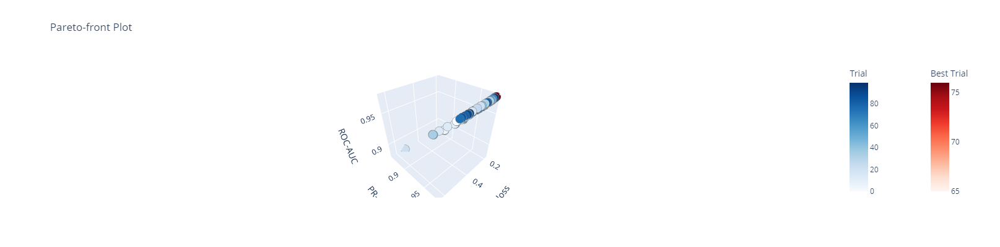

Optimization Progress: 100%|##########| 100/100 [4:02:03<00:00, 145.24s/it]


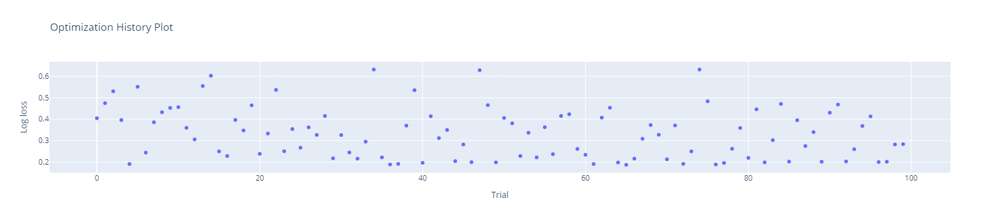

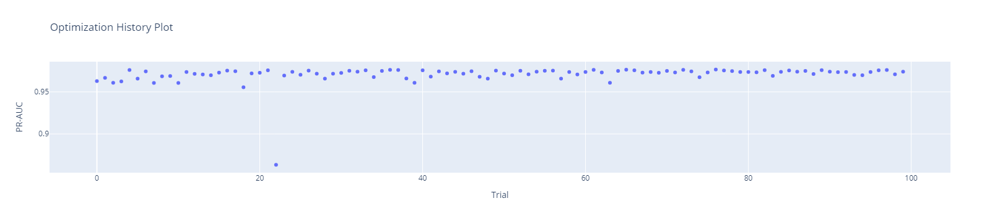

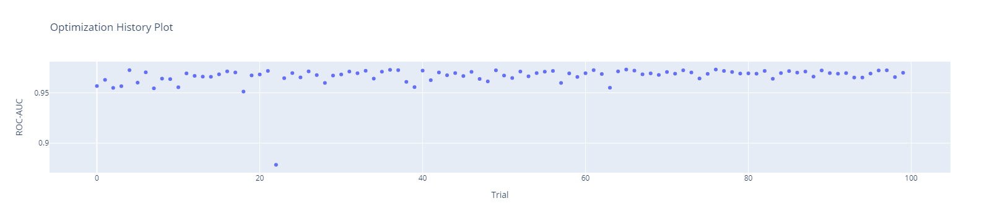

<span style = 'font-size: 18px; font-weight: bold;'> Training with Best Trial 65 </span>

Full_params: {'objective': 'binary:logistic', 'device': 'cpu', 'verbosity': 1, 'validate_parameters': True, 'eval_metric': ['logloss', 'auc', 'aucpr'], 'seed': 42, 'max_depth': 0, 'sampling_method': 'uniform', 'num_parallel_tree': 1, 'booster': 'gbtree', 'eta': 0.08759379181951674, 'gamma': 4.671021255322478e-06, 'min_child_weight': 2.6427694911817074e-05, 'max_delta_step': 65.5415383777442, 'subsample': 0.5614298448675313, 'colsample_bytree': 0.8129876656630327, 'colsample_bylevel': 0.9184442500782993, 'colsample_bynode': 0.6255082544056032, 'lambda': 7.025644820629422, 'alpha': 0.03727945540630586, 'tree_method': 'auto', 'scale_pos_weight': 1, 'grow_policy': 'depthwise', 'max_leaves': 128, 'max_bin': 47, 'num_boost_round': 97}
Training Elapsed Time: 2.7084125000001222 seconds
Log loss: (Train) 0.18729623942177334 vs (Test) 0.1927517325225934
PR-AUC:   (Train) 0.976406633670879 vs (Test) 0.975962677739389
ROC-AUC:  (Train) 0.9731661086371626 vs (Test) 0.9725283483506415


<span style = 'font-size: 18px; font-weight: bold;'> Training with Best Trial 76 </span>

Full_params: {'objective': 'binary:logistic', 'device': 'cpu', 'verbosity': 1, 'validate_parameters': True, 'eval_metric': ['logloss', 'auc', 'aucpr'], 'seed': 42, 'max_depth': 0, 'sampling_method': 'uniform', 'num_parallel_tree': 1, 'booster': 'gbtree', 'eta': 0.06489083823042531, 'gamma': 1.733278388607598, 'min_child_weight': 0.0015768729934482134, 'max_delta_step': 37.67348822307136, 'subsample': 0.8942728317991482, 'colsample_bytree': 0.570634316092556, 'colsample_bylevel': 0.8376499027022023, 'colsample_bynode': 0.9166953679419032, 'lambda': 0.005622055563920644, 'alpha': 4.06229817623886e-08, 'tree_method': 'hist', 'scale_pos_weight': 1, 'grow_policy': 'depthwise', 'max_leaves': 196, 'max_bin': 92, 'num_boost_round': 73}
Training Elapsed Time: 3.324780799997825 seconds
Log loss: (Train) 0.18865200821954037 vs (Test) 0.19412531851812243
PR-AUC:   (Train) 0.9765158675564066 vs (Test) 0.9760041164203919
ROC-AUC:  (Train) 0.9730942189230347 vs (Test) 0.9721837774893096


In [32]:
trial_progress = tqdm(total = n_trials, desc = "Optimization Progress", leave = True,
                      ascii = True,  # Plain text mode
                      dynamic_ncols = True   # Auto-fit width
                     )

def update_progress(study_xgb, trial):
    trial_progress.update(1)

# Disable Optuna's stdout handler so notebook isn’t spammed
optuna.logging.disable_default_handler()

# Enable propagation to Python’s logging
optuna.logging.enable_propagation()
optuna.logging.set_verbosity(optuna.logging.DEBUG)

# Configure Python logging
logging.basicConfig(filename = "optuna_debug_XGBClassifier.log", filemode = "w", level = logging.DEBUG, format="%(asctime)s %(levelname)s %(message)s")

study_xgb = optuna.create_study(study_name = "Optuna with XGBClassifier", 
                                directions=["minimize", "maximize", "maximize"],
                                sampler = module.AutoSampler(seed = seed))

start_optuna = time.perf_counter()
study_xgb.optimize(objective, n_trials = n_trials, n_jobs = 1, callbacks = [update_progress])
end_optuna = time.perf_counter()
print(f'Optuna Optimization Elapsed Time: {end_optuna - start_optuna} seconds')

gc.collect()

fig = plot_pareto_front(study_xgb, target_names = ["Log loss", "PR-AUC", "ROC-AUC"])
fig.update_layout(width = 900, height = 400)
fig.show()

trial_progress.close()

# Plot optimization history for each objective
metrics = ["Log loss", "PR-AUC", "ROC-AUC"]
for i, obj in enumerate(metrics):
    optuna.visualization.plot_optimization_history(study_xgb,
                                                   target = lambda t: t.values[i],  # Correctly target each objective
                                                   target_name = obj).show()

best_trials = study_xgb.best_trials
best_trials_xgb = {}

exec_time_xgb, lloss_auc_train_xgb, lloss_auc_test_xgb, all_metrics = [], [], [], []
cm_xgb_all, cm_labels_xgb_all = [], []

for i, trial in enumerate(best_trials):

    display(Markdown(f"<span style = 'font-size: 18px; font-weight: bold;'> Training with Best Trial {trial.number} </span>"))

    best_params = trial.params     

    # Non-optimized and best Optuna optimized parameters
    full_params = {"objective": "binary:logistic",
                   "device": "cpu",
                   "verbosity": 1,
                   "validate_parameters": True,
                   "eval_metric": ["logloss", "auc", "aucpr"],
                   "seed": seed,
                   "max_depth": 0,
                   "sampling_method": "uniform",  # Only 'uniform' is supported on CPU    
                   "num_parallel_tree": 1,
                   **best_params
                  }      
    print("Full_params:", full_params)         
    best_trials_xgb[trial.number] = full_params

    dtrain_all = xgb.DMatrix(X_train, label = y_train, enable_categorical = True, nthread = -1)
    dtest_all = xgb.DMatrix(X_test, label = y_test, enable_categorical = True, nthread = -1)
  
    # Extract `num_boost_round` separately (default to 10 if not found)
    num_boost_round = full_params.pop("num_boost_round", 10)

    start_train = time.perf_counter()
    # https://xgboost.readthedocs.io/en/stable/python/python_api.html#xgboost.Booster
    final_xgb = xgb.train(params = full_params, 
                          dtrain = dtrain_all, 
                          num_boost_round = num_boost_round,  # Pass explicitly
                          #early_stopping_rounds = 50 # ValueError: Must have at least 1 validation dataset for early stopping
                         )
    end_train = time.perf_counter()
   
    print(f'Training Elapsed Time: {end_train - start_train} seconds') 

    y_prob_all = final_xgb.predict(dtest_all)
    y_pred_all = np.rint(y_prob_all)
    
    print(f'Log loss: (Train) {trial.values[0]} vs (Test) {log_loss(y_test, y_prob_all)}') 
    print(f'PR-AUC:   (Train) {trial.values[1]} vs (Test) {average_precision_score(y_test, y_prob_all)}')
    print(f'ROC-AUC:  (Train) {trial.values[2]} vs (Test) {roc_auc_score(y_test, y_prob_all)}')

    exec_time_xgb.append({"Classifier": "XGBClassifier",
                           "Best Trial": trial.number,
                           "Optimization Elapsed Time (s)": end_optuna - start_optuna,
                           "Training Elapsed Time (s)": end_train - start_train})

    lloss_auc_train_xgb.append({"Classifier": "XGBClassifier",
                                "Best Trial": trial.number,
                                "Set": "Training",
                                "Log loss": trial.values[0], 
                                "PR-AUC": trial.values[1], 
                                "ROC-AUC": trial.values[2]})

    lloss_auc_test_xgb.append({"Classifier": "XGBClassifier",
                              "Best Trial": trial.number,
                              "Set": "Test",
                              "Log loss": log_loss(y_test, y_prob_all), 
                              "PR-AUC": average_precision_score(y_test, y_prob_all), 
                              "ROC-AUC": roc_auc_score(y_test, y_prob_all)})
    
    report = classification_report(y_test, y_pred_all, target_names = ["Safe", "Risky"], output_dict = True)
    all_metrics.append({"Classifier": "XGBClassifier",
                        "Trial": trial.number,
                        "Accuracy": accuracy_score(y_test, y_pred_all),
                        "Precision (Safe)": report["Safe"]["precision"],
                        "Recall (Safe)": report["Safe"]["recall"],
                        "F1-score (Safe)": report["Safe"]["f1-score"],
                        "Precision (Risky)": report["Risky"]["precision"],
                        "Recall (Risky)": report["Risky"]["recall"],
                        "F1-score (Risky)": report["Risky"]["f1-score"],
                        "Precision (Macro avg)": report["macro avg"]["precision"],
                        "Recall (Macro avg)": report["macro avg"]["recall"],
                        "F1-score (Macro avg)": report["macro avg"]["f1-score"],
                        "Precision (Weighted avg)": report["weighted avg"]["precision"],
                        "Recall (Weighted avg)": report["weighted avg"]["recall"],
                        "F1-score (Weighted avg)": report["weighted avg"]["f1-score"]})

    # Store confusion matrix
    cm_final_xgb = confusion_matrix(y_test, y_pred_all)
    cm_xgb_all.append(cm_final_xgb)
    cm_labels_xgb_all.append(f'XGBoostClassifier Confusion Matrix for Best Trial {trial.number}')  # Store label for subplots         

df_metrics_xgb = pd.DataFrame(all_metrics)

gc.collect();

In [33]:
save_results(clf_name = "XGBClassifier",
             best_trials = best_trials_xgb,
             exec_time = exec_time_xgb,
             lloss_auc_train = lloss_auc_train_xgb,
             lloss_auc_test = lloss_auc_test_xgb,
             df_metrics = df_metrics_xgb,
             cm_final = cm_final_xgb,
             cm_all = cm_xgb_all,
             cm_labels = cm_labels_xgb_all)

## Optuna with CatBoostClassifier

In [34]:
gc.collect();

In [35]:
# Aggregated loan level data
X_df = clean_df.drop(columns = ["target", "anon_ssn"])

# https://catboost.ai/docs/en/concepts/algorithm-missing-values-processing
# Replace <NA> with NaN
X_df = X_df.fillna(np.nan)

# Identify categorical columns
cat_cols = X_df.select_dtypes(include = "category").columns.tolist()

# Convert missing NaN in Dtype categorical to "nan" as Dtype object
for col in cat_cols:
    X_df[col] = X_df[col].astype(str)
    
# Convert missing <NA> in Dtype nullable boolean and nullable Int to NaN as float
X_df = X_df.apply(lambda x: x.map(lambda z: np.nan if pd.isna(z) else z)) 

y_df = clean_df.target

anon_ssn = clean_df.anon_ssn;

In [36]:
# A single train-test split (80%-20%) using GroupShuffleSplit, ensuring that no anon_ssn (grouped by anon_ssn) appear in both sets
gss = GroupShuffleSplit(n_splits = 1, test_size = 0.2, random_state = 42)
train_idx, test_idx = next(gss.split(X_df, y_df, groups = anon_ssn))

X_train, X_test = X_df.iloc[train_idx], X_df.iloc[test_idx]
y_train, y_test = y_df.iloc[train_idx], y_df.iloc[test_idx]

# Keep track of anon_ssn for cross-validation
anon_ssn_train = anon_ssn[train_idx]  

In [37]:
del X_df, y_df, gss, train_idx, test_idx;

In [38]:
# Define the objective function
def objective(trial):
    
    # Error: bayesian bootstrap doesn't support 'subsample' option
    bootstrap_type = trial.suggest_categorical("bootstrap_type", ["Bayesian", "Bernoulli", 
                                                                  #"Poisson" # CPU doesn't support
                                                                 ] 
                                              )
    if bootstrap_type == "Bayesian":
        # Do not suggest subsample for Bayesian
        subsample = None
    else:
        subsample = trial.suggest_float("subsample", 1e-1, 1e0)
    
    grow_policy = trial.suggest_categorical("grow_policy", ["SymmetricTree", 
                                                            "Lossguide", # Only for 'Ordered' and CPU
                                                            "Depthwise", 
                                                            #"Region" # GrowPolicy Region is unimplemented for CPU
                                                           ] 
                                           )
    
    # Conditionally set sampling_frequency based on grow_policy
    if grow_policy == "Lossguide":
        sampling_frequency = "PerTree"
    else:
        sampling_frequency = trial.suggest_categorical("sampling_frequency", ["PerTree", "PerTreeLevel"])      

    posterior_sampling = trial.suggest_categorical("posterior_sampling", [True, False]) # CPU only
    if posterior_sampling == True:
        model_shrink_mode = "Constant"
    else: 
        model_shrink_mode = trial.suggest_categorical("model_shrink_mode", ["Constant", "Decreasing"]) #CPU only

    # https://catboost.ai/docs/en/references/training-parameters/
    # https://catboost.ai/docs/en/concepts/python-reference_catboostclassifier
    # https://catboost.ai/docs/en/concepts/speed-up-training
    params = {"task_type": "CPU",
              "objective": "Logloss",
              "eval_metric": "Logloss",
              "custom_metric": ["AUC", "PRAUC"],
              "iterations": trial.suggest_int("iterations", 5, 100),
              "learning_rate": trial.suggest_float("learning_rate", 1e-2, 1e-1, log = True), 
              "random_seed": seed,
              "l2_leaf_reg": trial.suggest_float("l2_leaf_reg", 1e-8, 1e1, log = True), 
              "bootstrap_type": bootstrap_type,
              "subsample": subsample,
              "sampling_frequency":  sampling_frequency,
              "random_strength": trial.suggest_float("random_strength", 1e-2, 10.0, log = True),
              "depth": trial.suggest_int("depth", 1, 16),
              "grow_policy": grow_policy, 
              "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 5, 200), # Minimum data in one leaf
              "has_time": trial.suggest_categorical("has_time", [True, False]),
              "rsm": trial.suggest_float("rsm", 1e-1, 1e0),
              "leaf_estimation_method": trial.suggest_categorical("leaf_estimation_method", ["Newton", "Gradient"]),
              "leaf_estimation_backtracking": trial.suggest_categorical("leaf_estimation_backtracking", ["No", "AnyImprovement"]),
              "fold_len_multiplier": trial.suggest_float("fold_len_multiplier", 1e0, 1e1),
              "approx_on_full_history": False, # Can't use approx-on-full-history with Plain boosting-type 
              "auto_class_weights": trial.suggest_categorical("auto_class_weights", ["None", "Balanced", "SqrtBalanced"]),
              "boosting_type": "Plain", # for CPU 
              "boost_from_average": trial.suggest_categorical("boost_from_average", [True, False]),
              "posterior_sampling": posterior_sampling,
              "allow_const_label": trial.suggest_categorical("allow_const_label", [True, False]),
              "score_function": trial.suggest_categorical("score_function", ["Cosine", "L2", # CPU only
                                                                            ]
                                                         ),
              "model_shrink_mode": model_shrink_mode,
              "thread_count": -1,
              "border_count": trial.suggest_int("border_count", 40, 255),
              "verbose": True, # Keeps live per-iteration training logs visible in the output cell
              "allow_writing_files": False # Avoid CatBoost "Error 32" on Windows (file-lock in catboost_info); disables writing into catboost_info/ (so no file lock issues)
             }

    # Ensure max_leaves (# Number of leaves in one tree) is only used when grow_policy is Lossguide
    if params["grow_policy"] == "Lossguide":
        params["max_leaves"] = trial.suggest_int("max_leaves", 2, 256)
        
    sgkf = StratifiedGroupKFold(n_splits = 5, shuffle = True, random_state = seed)
    lloss_scores, pr_auc_scores, roc_auc_scores = [], [], []
    
    for fold_idx, (train_index, valid_index) in enumerate(sgkf.split(X_train, y_train, groups = anon_ssn_train), start = 1):

        # Split data into training and validation sets
        X_train_fold, X_valid_fold = X_train.iloc[train_index], X_train.iloc[valid_index]
        y_train_fold, y_valid_fold = y_train.iloc[train_index], y_train.iloc[valid_index]   
        
        # Summarize the composition of classes in the train and validation sets
        train_0, train_1 = len(y_train_fold[y_train_fold == 0]), len(y_train_fold[y_train_fold == 1])
        valid_0, valid_1 = len(y_valid_fold[y_valid_fold == 0]), len(y_valid_fold[y_valid_fold == 1])

        print(f'Trial {trial.number}, Fold {fold_idx}: Train size = {len(train_index)} where 0 = {train_0}, 1 = {train_1}, 0/1 = {train_0/train_1}')
        print(f'Trial {trial.number}, Fold {fold_idx}: Validation size = {len(valid_index)} where  0 = {valid_0}, 1 = {valid_1}, 0/1 = {valid_0/valid_1}')

        # Create Pool objects for training and validation
        train_pool_fold = Pool(X_train_fold, y_train_fold, cat_features = cat_cols)
        valid_pool_fold = Pool(X_valid_fold, y_valid_fold, cat_features = cat_cols)
      
        start_fold = time.perf_counter()
        clf = CatBoostClassifier(**params).fit(train_pool_fold, eval_set = valid_pool_fold) 
        end_fold = time.perf_counter()
        
        # Get probabilities and for the positive class
        y_prob_fold = clf.predict_proba(X_valid_fold)[:, 1]         
        y_pred_fold = clf.predict(X_valid_fold) # Class prediction

        print(f'Trial {trial.number}, Fold {fold_idx}: '
              f'Log loss = {log_loss(y_valid_fold, y_prob_fold)}, '
              f'Average precision = {average_precision_score(y_valid_fold, y_prob_fold)}, '
              f'ROC-AUC = {roc_auc_score(y_valid_fold, y_prob_fold)}, '
              f'Elapsed Time = {end_fold - start_fold} seconds')     
        
        lloss_scores.append(log_loss(y_valid_fold, y_prob_fold))
        pr_auc_scores.append(average_precision_score(y_valid_fold, y_prob_fold))
        roc_auc_scores.append(roc_auc_score(y_valid_fold, y_prob_fold))

        del X_train_fold, X_valid_fold, y_train_fold, y_valid_fold, train_pool_fold, valid_pool_fold, clf, start_fold, end_fold
        gc.collect()        

    mean_lloss = np.mean(lloss_scores)
    mean_pr_auc = np.mean(pr_auc_scores)
    mean_roc_auc = np.mean(roc_auc_scores)

    del lloss_scores, pr_auc_scores, roc_auc_scores
    gc.collect()
    
    return mean_lloss, mean_pr_auc, mean_roc_auc

Optimization Progress:   0%|          | 0/100 [00:00<?, ?it/s]

Trial 0, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 0, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6749843	test: 0.6749868	best: 0.6749868 (0)	total: 427ms	remaining: 8.54s
1:	learn: 0.6566303	test: 0.6566865	best: 0.6566865 (1)	total: 639ms	remaining: 6.07s
2:	learn: 0.6411094	test: 0.6411880	best: 0.6411880 (2)	total: 906ms	remaining: 5.43s
3:	learn: 0.6222098	test: 0.6219594	best: 0.6219594 (3)	total: 1.16s	remaining: 4.92s
4:	learn: 0.6095943	test: 0.6094700	best: 0.6094700 (4)	total: 1.36s	remaining: 4.37s
5:	learn: 0.5962167	test: 0.5963761	best: 0.5963761 (5)	total: 1.61s	remaining: 4.03s
6:	learn: 0.5836222	test: 0.5838488	best: 0.5838488 (6)	total: 1.86s	remaining: 3.72s
7:	learn: 0.5704152	test: 0.5706220	best: 0.5706220 (7)	total: 2.12s	remaining: 3.44s
8:	learn: 0.5562966	test: 0.5564756	best: 0.5564756 (8)	total: 2.31s	remaining: 3.08s
9:	learn: 0.5448487	test: 0.5450990	best: 0.5

Optimization Progress:   1%|1         | 1/100 [00:33<54:45, 33.18s/it]

Trial 0, Fold 5: Log loss = 0.44753672082994483, Average precision = 0.9531065401172362, ROC-AUC = 0.9474237407799639, Elapsed Time = 4.487887499999488 seconds
Trial 1, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 1, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6844508	test: 0.6845223	best: 0.6845223 (0)	total: 18ms	remaining: 1.01s
1:	learn: 0.6753745	test: 0.6755910	best: 0.6755910 (1)	total: 39ms	remaining: 1.07s
2:	learn: 0.6647018	test: 0.6648454	best: 0.6648454 (2)	total: 65.4ms	remaining: 1.18s
3:	learn: 0.6551796	test: 0.6552181	best: 0.6552181 (3)	total: 88.5ms	remaining: 1.17s
4:	learn: 0.6479090	test: 0.6478007	best: 0.6478007 (4)	total: 105ms	remaining: 1.1s
5:	learn: 0.6410936	test: 0.6410499	best: 0.6410499 (5)	total: 125ms	remaining: 1.06s
6:	learn: 0.6336999	test: 0.6336278	best: 0.6336278 (6)	total: 142ms	remaining: 1.02s
7:	learn: 0.6258583	test: 0.6257618	best: 0.6257618 (7)	to

Optimization Progress:   2%|2         | 2/100 [00:49<37:38, 23.05s/it]

Trial 2, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 2, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6804296	test: 0.6806120	best: 0.6806120 (0)	total: 153ms	remaining: 11.6s
1:	learn: 0.6677884	test: 0.6680673	best: 0.6680673 (1)	total: 296ms	remaining: 11.1s
2:	learn: 0.6554878	test: 0.6559308	best: 0.6559308 (2)	total: 449ms	remaining: 11.1s
3:	learn: 0.6434826	test: 0.6440523	best: 0.6440523 (3)	total: 596ms	remaining: 10.9s
4:	learn: 0.6323349	test: 0.6331974	best: 0.6331974 (4)	total: 752ms	remaining: 10.8s
5:	learn: 0.6210927	test: 0.6221362	best: 0.6221362 (5)	total: 900ms	remaining: 10.6s
6:	learn: 0.6110129	test: 0.6125733	best: 0.6125733 (6)	total: 1.06s	remaining: 10.7s
7:	learn: 0.6000466	test: 0.6016630	best: 0.6016630 (7)	total: 1.21s	remaining: 10.4s
8:	learn: 0.5894133	test: 0.5913387	best: 0.5913387 (8)	total: 1.4s	remaining: 10.6s
9:	learn: 0.5790718	test: 0.5811954	best: 0.58

Optimization Progress:   3%|3         | 3/100 [02:00<1:12:45, 45.00s/it]

Trial 3, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 3, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6210638	test: 0.6256852	best: 0.6256852 (0)	total: 1.97s	remaining: 1m 42s
1:	learn: 0.5595196	test: 0.5674321	best: 0.5674321 (1)	total: 4.29s	remaining: 1m 49s
2:	learn: 0.5057908	test: 0.5203140	best: 0.5203140 (2)	total: 6.39s	remaining: 1m 46s
3:	learn: 0.4613019	test: 0.4790619	best: 0.4790619 (3)	total: 8.44s	remaining: 1m 43s
4:	learn: 0.4226066	test: 0.4437747	best: 0.4437747 (4)	total: 10.5s	remaining: 1m 40s
5:	learn: 0.3901047	test: 0.4136660	best: 0.4136660 (5)	total: 12.5s	remaining: 1m 38s
6:	learn: 0.3625389	test: 0.3881014	best: 0.3881014 (6)	total: 14.6s	remaining: 1m 35s
7:	learn: 0.3376649	test: 0.3665084	best: 0.3665084 (7)	total: 16.6s	remaining: 1m 33s
8:	learn: 0.3170532	test: 0.3475663	best: 0.3475663 (8)	total: 18.6s	remaining: 1m 31s
9:	learn: 0.2992470	test: 0.3312340	

Optimization Progress:   4%|4         | 4/100 [11:14<6:33:50, 246.15s/it]

Trial 4, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 4, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6751291	test: 0.6756952	best: 0.6756952 (0)	total: 424ms	remaining: 8.48s
1:	learn: 0.6580755	test: 0.6588961	best: 0.6588961 (1)	total: 878ms	remaining: 8.34s
2:	learn: 0.6414485	test: 0.6425834	best: 0.6425834 (2)	total: 1.32s	remaining: 7.91s
3:	learn: 0.6255995	test: 0.6270070	best: 0.6270070 (3)	total: 1.79s	remaining: 7.62s
4:	learn: 0.6102941	test: 0.6119646	best: 0.6119646 (4)	total: 2.18s	remaining: 6.97s
5:	learn: 0.5955309	test: 0.5974463	best: 0.5974463 (5)	total: 2.58s	remaining: 6.44s
6:	learn: 0.5812521	test: 0.5834002	best: 0.5834002 (6)	total: 3.01s	remaining: 6.01s
7:	learn: 0.5677320	test: 0.5701475	best: 0.5701475 (7)	total: 3.37s	remaining: 5.47s
8:	learn: 0.5546584	test: 0.5572836	best: 0.5572836 (8)	total: 3.81s	remaining: 5.08s
9:	learn: 0.5420135	test: 0.5449337	best: 0.5

Optimization Progress:   5%|5         | 5/100 [12:07<4:39:15, 176.38s/it]

Trial 5, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 5, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6773268	test: 0.6774498	best: 0.6774498 (0)	total: 101ms	remaining: 6.8s
1:	learn: 0.6619110	test: 0.6625295	best: 0.6625295 (1)	total: 204ms	remaining: 6.75s
2:	learn: 0.6468069	test: 0.6475521	best: 0.6475521 (2)	total: 313ms	remaining: 6.79s
3:	learn: 0.6321747	test: 0.6329820	best: 0.6329820 (3)	total: 416ms	remaining: 6.66s
4:	learn: 0.6188141	test: 0.6200537	best: 0.6200537 (4)	total: 531ms	remaining: 6.7s
5:	learn: 0.6056048	test: 0.6070380	best: 0.6070380 (5)	total: 649ms	remaining: 6.7s
6:	learn: 0.5929134	test: 0.5947511	best: 0.5947511 (6)	total: 770ms	remaining: 6.71s
7:	learn: 0.5799498	test: 0.5820043	best: 0.5820043 (7)	total: 884ms	remaining: 6.63s
8:	learn: 0.5677034	test: 0.5698802	best: 0.5698802 (8)	total: 999ms	remaining: 6.55s
9:	learn: 0.5559479	test: 0.5581774	best: 0.5581

Optimization Progress:   6%|6         | 6/100 [12:54<3:27:22, 132.37s/it]

Trial 6, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 6, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6802252	test: 0.6804421	best: 0.6804421 (0)	total: 21.6ms	remaining: 260ms
1:	learn: 0.6682112	test: 0.6683883	best: 0.6683883 (1)	total: 43.2ms	remaining: 237ms
2:	learn: 0.6589036	test: 0.6589366	best: 0.6589366 (2)	total: 64.3ms	remaining: 214ms
3:	learn: 0.6448929	test: 0.6448146	best: 0.6448146 (3)	total: 85ms	remaining: 191ms
4:	learn: 0.6338868	test: 0.6337594	best: 0.6337594 (4)	total: 106ms	remaining: 169ms
5:	learn: 0.6256641	test: 0.6255702	best: 0.6255702 (5)	total: 125ms	remaining: 146ms
6:	learn: 0.6150270	test: 0.6149716	best: 0.6149716 (6)	total: 145ms	remaining: 124ms
7:	learn: 0.6067636	test: 0.6065486	best: 0.6065486 (7)	total: 165ms	remaining: 103ms
8:	learn: 0.5986717	test: 0.5983345	best: 0.5983345 (8)	total: 185ms	remaining: 82.1ms
9:	learn: 0.5880264	test: 0.5876876	best: 

Optimization Progress:   7%|7         | 7/100 [13:03<2:22:45, 92.10s/it] 

Trial 7, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 7, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5989916	test: 0.5987729	best: 0.5987729 (0)	total: 48.7ms	remaining: 682ms
1:	learn: 0.5212612	test: 0.5209932	best: 0.5209932 (1)	total: 97ms	remaining: 631ms
2:	learn: 0.4632245	test: 0.4633237	best: 0.4633237 (2)	total: 142ms	remaining: 568ms
3:	learn: 0.4174577	test: 0.4177841	best: 0.4177841 (3)	total: 189ms	remaining: 519ms
4:	learn: 0.3814671	test: 0.3829626	best: 0.3829626 (4)	total: 233ms	remaining: 465ms
5:	learn: 0.3555651	test: 0.3578947	best: 0.3578947 (5)	total: 281ms	remaining: 422ms
6:	learn: 0.3310748	test: 0.3339130	best: 0.3339130 (6)	total: 325ms	remaining: 372ms
7:	learn: 0.3140789	test: 0.3184745	best: 0.3184745 (7)	total: 372ms	remaining: 325ms
8:	learn: 0.2981974	test: 0.3031023	best: 0.3031023 (8)	total: 418ms	remaining: 278ms
9:	learn: 0.2870217	test: 0.2923589	best: 0.2

Optimization Progress:   8%|8         | 8/100 [13:15<1:41:53, 66.45s/it]

Trial 8, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 8, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6235132	test: 0.6233448	best: 0.6233448 (0)	total: 229ms	remaining: 20.1s
1:	learn: 0.5639866	test: 0.5645558	best: 0.5645558 (1)	total: 471ms	remaining: 20.5s
2:	learn: 0.5133377	test: 0.5151054	best: 0.5151054 (2)	total: 720ms	remaining: 20.6s
3:	learn: 0.4703528	test: 0.4728199	best: 0.4728199 (3)	total: 970ms	remaining: 20.6s
4:	learn: 0.4344873	test: 0.4379380	best: 0.4379380 (4)	total: 1.22s	remaining: 20.5s
5:	learn: 0.4033720	test: 0.4076159	best: 0.4076159 (5)	total: 1.47s	remaining: 20.4s
6:	learn: 0.3767150	test: 0.3816499	best: 0.3816499 (6)	total: 1.72s	remaining: 20.1s
7:	learn: 0.3536239	test: 0.3595380	best: 0.3595380 (7)	total: 1.98s	remaining: 20s
8:	learn: 0.3342543	test: 0.3409849	best: 0.3409849 (8)	total: 2.27s	remaining: 20.1s
9:	learn: 0.3182201	test: 0.3257850	best: 0.325

Optimization Progress:   9%|9         | 9/100 [15:21<2:09:17, 85.25s/it]

Trial 9, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 9, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5936707	test: 0.5933712	best: 0.5933712 (0)	total: 446ms	remaining: 14.3s
1:	learn: 0.5169584	test: 0.5169710	best: 0.5169710 (1)	total: 842ms	remaining: 13.1s
2:	learn: 0.4557980	test: 0.4561473	best: 0.4561473 (2)	total: 1.29s	remaining: 12.9s
3:	learn: 0.4102913	test: 0.4111520	best: 0.4111520 (3)	total: 1.64s	remaining: 11.9s
4:	learn: 0.3729478	test: 0.3742570	best: 0.3742570 (4)	total: 2.02s	remaining: 11.3s
5:	learn: 0.3443626	test: 0.3463007	best: 0.3463007 (5)	total: 2.37s	remaining: 10.6s
6:	learn: 0.3212944	test: 0.3238142	best: 0.3238142 (6)	total: 2.85s	remaining: 10.6s
7:	learn: 0.3018028	test: 0.3048864	best: 0.3048864 (7)	total: 3.23s	remaining: 10.1s
8:	learn: 0.2870346	test: 0.2905007	best: 0.2905007 (8)	total: 3.51s	remaining: 9.35s
9:	learn: 0.2742177	test: 0.2782839	best: 0.2

Optimization Progress:  10%|#         | 10/100 [16:33<2:01:52, 81.25s/it]

Trial 10, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 10, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6506128	test: 0.6515501	best: 0.6515501 (0)	total: 248ms	remaining: 3.47s
1:	learn: 0.6110494	test: 0.6131081	best: 0.6131081 (1)	total: 553ms	remaining: 3.6s
2:	learn: 0.5753256	test: 0.5784900	best: 0.5784900 (2)	total: 841ms	remaining: 3.36s
3:	learn: 0.5420402	test: 0.5461008	best: 0.5461008 (3)	total: 1.13s	remaining: 3.1s
4:	learn: 0.5115528	test: 0.5169230	best: 0.5169230 (4)	total: 1.42s	remaining: 2.84s
5:	learn: 0.4844937	test: 0.4911414	best: 0.4911414 (5)	total: 1.71s	remaining: 2.57s
6:	learn: 0.4594776	test: 0.4672055	best: 0.4672055 (6)	total: 1.96s	remaining: 2.23s
7:	learn: 0.4367891	test: 0.4453762	best: 0.4453762 (7)	total: 2.23s	remaining: 1.95s
8:	learn: 0.4159033	test: 0.4258133	best: 0.4258133 (8)	total: 2.55s	remaining: 1.7s
9:	learn: 0.3964793	test: 0.4081034	best: 0.40

Optimization Progress:  11%|#1        | 11/100 [17:05<1:37:52, 65.99s/it]

Trial 11, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 11, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6792982	test: 0.6795236	best: 0.6795236 (0)	total: 211ms	remaining: 13.9s
1:	learn: 0.6613199	test: 0.6614242	best: 0.6614242 (1)	total: 430ms	remaining: 14s
2:	learn: 0.6454800	test: 0.6455000	best: 0.6455000 (2)	total: 672ms	remaining: 14.3s
3:	learn: 0.6316974	test: 0.6319361	best: 0.6319361 (3)	total: 902ms	remaining: 14.2s
4:	learn: 0.6164283	test: 0.6165959	best: 0.6165959 (4)	total: 1.13s	remaining: 14s
5:	learn: 0.6018727	test: 0.6020022	best: 0.6020022 (5)	total: 1.34s	remaining: 13.7s
6:	learn: 0.5880905	test: 0.5883114	best: 0.5883114 (6)	total: 1.56s	remaining: 13.4s
7:	learn: 0.5758505	test: 0.5760261	best: 0.5760261 (7)	total: 1.76s	remaining: 13s
8:	learn: 0.5646255	test: 0.5648380	best: 0.5648380 (8)	total: 1.96s	remaining: 12.6s
9:	learn: 0.5531004	test: 0.5532903	best: 0.55329

Optimization Progress:  12%|#2        | 12/100 [18:29<1:44:46, 71.44s/it]

Trial 12, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 12, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5384561	test: 0.5403447	best: 0.5403447 (0)	total: 491ms	remaining: 48.6s
1:	learn: 0.4310432	test: 0.4363623	best: 0.4363623 (1)	total: 1.12s	remaining: 55s
2:	learn: 0.3619269	test: 0.3696297	best: 0.3696297 (2)	total: 1.76s	remaining: 56.9s
3:	learn: 0.3111326	test: 0.3220037	best: 0.3220037 (3)	total: 2.42s	remaining: 58.1s
4:	learn: 0.2729093	test: 0.2877730	best: 0.2877730 (4)	total: 3.1s	remaining: 58.9s
5:	learn: 0.2457871	test: 0.2640025	best: 0.2640025 (5)	total: 3.77s	remaining: 59.1s
6:	learn: 0.2231111	test: 0.2444385	best: 0.2444385 (6)	total: 4.47s	remaining: 59.4s
7:	learn: 2.4701636	test: 0.2325594	best: 0.2325594 (7)	total: 5.11s	remaining: 58.8s
8:	learn: 10.6390693	test: 12.9046381	best: 0.2325594 (7)	total: 5.78s	remaining: 58.5s
9:	learn: 13.3196306	test: 12.8510000	best: 

Training has stopped (degenerate solution on iteration 14, probably too small l2-regularization, try to increase it)



bestTest = 0.2325594147
bestIteration = 7

Shrink model to first 8 iterations.
Trial 12, Fold 1: Log loss = 0.23255941469882188, Average precision = 0.9719359413186033, ROC-AUC = 0.9677732461297275, Elapsed Time = 9.332107500002166 seconds
Trial 12, Fold 2: Train size = 20701 where 0 = 10471, 1 = 10230, 0/1 = 1.0235581622678396
Trial 12, Fold 2: Validation size = 5137 where  0 = 2654, 1 = 2483, 0/1 = 1.0688683044703986
0:	learn: 0.5252559	test: 0.5296265	best: 0.5296265 (0)	total: 665ms	remaining: 1m 5s
1:	learn: 0.4190479	test: 0.4251401	best: 0.4251401 (1)	total: 1.4s	remaining: 1m 8s
2:	learn: 0.3497104	test: 0.3597729	best: 0.3597729 (2)	total: 2.08s	remaining: 1m 7s
3:	learn: 0.3042432	test: 0.3148924	best: 0.3148924 (3)	total: 2.8s	remaining: 1m 7s
4:	learn: 0.2699026	test: 0.2838566	best: 0.2838566 (4)	total: 3.57s	remaining: 1m 7s
5:	learn: 0.2428225	test: 0.2598137	best: 0.2598137 (5)	total: 4.29s	remaining: 1m 7s
6:	learn: 0.2255687	test: 0.2455997	best: 0.2455997 (6)	total:

Training has stopped (degenerate solution on iteration 21, probably too small l2-regularization, try to increase it)



bestTest = 0.1976059236
bestIteration = 14

Shrink model to first 15 iterations.
Trial 12, Fold 2: Log loss = 0.19760592357393936, Average precision = 0.9738911728355482, ROC-AUC = 0.970783315998678, Elapsed Time = 13.0962698000003 seconds
Trial 12, Fold 3: Train size = 20682 where 0 = 10517, 1 = 10165, 0/1 = 1.034628627643876
Trial 12, Fold 3: Validation size = 5156 where  0 = 2608, 1 = 2548, 0/1 = 1.0235478806907379
0:	learn: 0.5405717	test: 0.5405482	best: 0.5405482 (0)	total: 592ms	remaining: 58.6s
1:	learn: 0.4380485	test: 0.4406064	best: 0.4406064 (1)	total: 1.23s	remaining: 1m
2:	learn: 0.3555325	test: 0.3610371	best: 0.3610371 (2)	total: 1.81s	remaining: 58.7s
3:	learn: 0.3060056	test: 0.3158127	best: 0.3158127 (3)	total: 2.53s	remaining: 1m
4:	learn: 0.2712005	test: 0.2833835	best: 0.2833835 (4)	total: 3.16s	remaining: 1m
5:	learn: 0.2432929	test: 0.2578149	best: 0.2578149 (5)	total: 3.88s	remaining: 1m
6:	learn: 2.9382892	test: 0.2442496	best: 0.2442496 (6)	total: 4.54s	rema

Training has stopped (degenerate solution on iteration 15, probably too small l2-regularization, try to increase it)



bestTest = 0.2209059064
bestIteration = 8

Shrink model to first 9 iterations.
Trial 12, Fold 3: Log loss = 0.22090590640476881, Average precision = 0.972677075566525, ROC-AUC = 0.9699477847415512, Elapsed Time = 9.988151199999265 seconds
Trial 12, Fold 4: Train size = 20656 where 0 = 10479, 1 = 10177, 0/1 = 1.0296747568045592
Trial 12, Fold 4: Validation size = 5182 where  0 = 2646, 1 = 2536, 0/1 = 1.0433753943217665
0:	learn: 0.5337580	test: 0.5358030	best: 0.5358030 (0)	total: 569ms	remaining: 56.4s
1:	learn: 0.4279728	test: 0.4322761	best: 0.4322761 (1)	total: 1.15s	remaining: 56.5s
2:	learn: 0.3636670	test: 0.3725890	best: 0.3725890 (2)	total: 1.82s	remaining: 58.7s
3:	learn: 0.3006959	test: 0.3121006	best: 0.3121006 (3)	total: 2.6s	remaining: 1m 2s
4:	learn: 0.2591788	test: 0.2731217	best: 0.2731217 (4)	total: 3.38s	remaining: 1m 4s
5:	learn: 0.2354564	test: 0.2517987	best: 0.2517987 (5)	total: 4.02s	remaining: 1m 3s
6:	learn: 0.2205635	test: 0.2389304	best: 0.2389304 (6)	total:

Training has stopped (degenerate solution on iteration 16, probably too small l2-regularization, try to increase it)



bestTest = 0.2189336578
bestIteration = 11

Shrink model to first 12 iterations.
Trial 12, Fold 5: Log loss = 0.21893365778022436, Average precision = 0.972602290968769, ROC-AUC = 0.9685415528677331, Elapsed Time = 10.713243800000782 seconds


Optimization Progress:  13%|#3        | 13/100 [19:58<1:51:13, 76.70s/it]

Trial 13, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 13, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6362268	test: 0.6369981	best: 0.6369981 (0)	total: 172ms	remaining: 6s
1:	learn: 0.5884682	test: 0.5887326	best: 0.5887326 (1)	total: 355ms	remaining: 6.04s
2:	learn: 0.5494788	test: 0.5503714	best: 0.5503714 (2)	total: 541ms	remaining: 5.95s
3:	learn: 0.5141643	test: 0.5154301	best: 0.5154301 (3)	total: 747ms	remaining: 5.98s
4:	learn: 0.4837059	test: 0.4848689	best: 0.4848689 (4)	total: 931ms	remaining: 5.77s
5:	learn: 0.4534961	test: 0.4544274	best: 0.4544274 (5)	total: 1.12s	remaining: 5.6s
6:	learn: 0.4310285	test: 0.4323185	best: 0.4323185 (6)	total: 1.3s	remaining: 5.37s
7:	learn: 0.4071864	test: 0.4086668	best: 0.4086668 (7)	total: 1.5s	remaining: 5.24s
8:	learn: 0.3908716	test: 0.3925285	best: 0.3925285 (8)	total: 1.66s	remaining: 4.99s
9:	learn: 0.3696076	test: 0.3716048	best: 0.37160

Optimization Progress:  14%|#4        | 14/100 [20:40<1:35:04, 66.33s/it]

Trial 14, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 14, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5801609	test: 0.5909252	best: 0.5909252 (0)	total: 3.17s	remaining: 2m 19s
1:	learn: 0.4936147	test: 0.5096646	best: 0.5096646 (1)	total: 6.14s	remaining: 2m 11s
2:	learn: 0.4258390	test: 0.4477475	best: 0.4477475 (2)	total: 9.18s	remaining: 2m 8s
3:	learn: 0.3703814	test: 0.4004829	best: 0.4004829 (3)	total: 12.4s	remaining: 2m 6s
4:	learn: 0.3300916	test: 0.3629523	best: 0.3629523 (4)	total: 15.4s	remaining: 2m 3s
5:	learn: 0.2984747	test: 0.3345477	best: 0.3345477 (5)	total: 18.5s	remaining: 2m
6:	learn: 0.2702072	test: 0.3118904	best: 0.3118904 (6)	total: 21.4s	remaining: 1m 56s
7:	learn: 0.2462469	test: 0.2949055	best: 0.2949055 (7)	total: 24.1s	remaining: 1m 51s
8:	learn: 0.2281451	test: 0.2814214	best: 0.2814214 (8)	total: 27.4s	remaining: 1m 49s
9:	learn: 0.2154538	test: 0.2711527	best:

Optimization Progress:  15%|#5        | 15/100 [32:12<6:01:13, 254.98s/it]

Trial 15, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 15, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6728683	test: 0.6732393	best: 0.6732393 (0)	total: 141ms	remaining: 7.04s
1:	learn: 0.6541275	test: 0.6545015	best: 0.6545015 (1)	total: 287ms	remaining: 7.02s
2:	learn: 0.6368697	test: 0.6372832	best: 0.6372832 (2)	total: 424ms	remaining: 6.79s
3:	learn: 0.6211260	test: 0.6216329	best: 0.6216329 (3)	total: 553ms	remaining: 6.49s
4:	learn: 0.6054688	test: 0.6059944	best: 0.6059944 (4)	total: 694ms	remaining: 6.39s
5:	learn: 0.5895789	test: 0.5901938	best: 0.5901938 (5)	total: 824ms	remaining: 6.18s
6:	learn: 0.5751578	test: 0.5758150	best: 0.5758150 (6)	total: 957ms	remaining: 6.02s
7:	learn: 0.5613624	test: 0.5621416	best: 0.5621416 (7)	total: 1.1s	remaining: 5.91s
8:	learn: 0.5480040	test: 0.5487776	best: 0.5487776 (8)	total: 1.25s	remaining: 5.85s
9:	learn: 0.5354522	test: 0.5363188	best: 0.

Optimization Progress:  16%|#6        | 16/100 [32:56<4:27:57, 191.40s/it]

Trial 16, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 16, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6112437	test: 0.6129955	best: 0.6129955 (0)	total: 1.04s	remaining: 20.8s
1:	learn: 0.5527328	test: 0.5557880	best: 0.5557880 (1)	total: 2.15s	remaining: 20.5s
2:	learn: 0.5058588	test: 0.5085660	best: 0.5085660 (2)	total: 3.08s	remaining: 18.5s
3:	learn: 0.4679376	test: 0.4721209	best: 0.4721209 (3)	total: 4.15s	remaining: 17.6s
4:	learn: 0.4264395	test: 0.4310013	best: 0.4310013 (4)	total: 5.25s	remaining: 16.8s
5:	learn: 0.3972670	test: 0.4019986	best: 0.4019986 (5)	total: 6.11s	remaining: 15.3s
6:	learn: 0.3745662	test: 0.3790426	best: 0.3790426 (6)	total: 7.19s	remaining: 14.4s
7:	learn: 0.3550913	test: 0.3602187	best: 0.3602187 (7)	total: 8.01s	remaining: 13s
8:	learn: 0.3342404	test: 0.3401219	best: 0.3401219 (8)	total: 8.97s	remaining: 12s
9:	learn: 0.3218753	test: 0.3281902	best: 0.328

Optimization Progress:  17%|#7        | 17/100 [34:51<3:52:58, 168.42s/it]

Trial 17, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 17, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6524703	test: 0.6522438	best: 0.6522438 (0)	total: 51.4ms	remaining: 2.83s
1:	learn: 0.6159441	test: 0.6156141	best: 0.6156141 (1)	total: 108ms	remaining: 2.93s
2:	learn: 0.5835970	test: 0.5833237	best: 0.5833237 (2)	total: 163ms	remaining: 2.87s
3:	learn: 0.5536792	test: 0.5533433	best: 0.5533433 (3)	total: 213ms	remaining: 2.76s
4:	learn: 0.5279274	test: 0.5277444	best: 0.5277444 (4)	total: 264ms	remaining: 2.69s
5:	learn: 0.5029440	test: 0.5027275	best: 0.5027275 (5)	total: 314ms	remaining: 2.62s
6:	learn: 0.4807604	test: 0.4807579	best: 0.4807579 (6)	total: 364ms	remaining: 2.55s
7:	learn: 0.4607105	test: 0.4609005	best: 0.4609005 (7)	total: 413ms	remaining: 2.48s
8:	learn: 0.4420271	test: 0.4421695	best: 0.4421695 (8)	total: 463ms	remaining: 2.42s
9:	learn: 0.4250389	test: 0.4251735	best: 

Optimization Progress:  18%|#8        | 18/100 [35:15<2:50:59, 125.12s/it]

Trial 18, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 18, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6674286	test: 0.6677229	best: 0.6677229 (0)	total: 181ms	remaining: 12.1s
1:	learn: 0.6432510	test: 0.6438432	best: 0.6438432 (1)	total: 350ms	remaining: 11.6s
2:	learn: 0.6203010	test: 0.6212118	best: 0.6212118 (2)	total: 534ms	remaining: 11.6s
3:	learn: 0.5984492	test: 0.5997089	best: 0.5997089 (3)	total: 750ms	remaining: 12s
4:	learn: 0.5778435	test: 0.5795152	best: 0.5795152 (4)	total: 937ms	remaining: 11.8s
5:	learn: 0.5583987	test: 0.5604094	best: 0.5604094 (5)	total: 1.13s	remaining: 11.6s
6:	learn: 0.5401218	test: 0.5423817	best: 0.5423817 (6)	total: 1.3s	remaining: 11.3s
7:	learn: 0.5226471	test: 0.5252553	best: 0.5252553 (7)	total: 1.47s	remaining: 11s
8:	learn: 0.5064308	test: 0.5093129	best: 0.5093129 (8)	total: 1.64s	remaining: 10.8s
9:	learn: 0.4910992	test: 0.4942924	best: 0.4942

Optimization Progress:  19%|#9        | 19/100 [36:32<2:29:23, 110.66s/it]

Trial 19, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 19, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6493495	test: 0.6493227	best: 0.6493227 (0)	total: 58.3ms	remaining: 233ms
1:	learn: 0.6100900	test: 0.6100392	best: 0.6100392 (1)	total: 121ms	remaining: 181ms
2:	learn: 0.5817833	test: 0.5819830	best: 0.5819830 (2)	total: 183ms	remaining: 122ms
3:	learn: 0.5564804	test: 0.5570457	best: 0.5570457 (3)	total: 240ms	remaining: 59.9ms
4:	learn: 0.5284393	test: 0.5291573	best: 0.5291573 (4)	total: 304ms	remaining: 0us

bestTest = 0.5291573093
bestIteration = 4

Trial 19, Fold 1: Log loss = 0.5294335510119113, Average precision = 0.9694654657745588, ROC-AUC = 0.9645724896402402, Elapsed Time = 0.4126544999999169 seconds
Trial 19, Fold 2: Train size = 20701 where 0 = 10471, 1 = 10230, 0/1 = 1.0235581622678396
Trial 19, Fold 2: Validation size = 5137 where  0 = 2654, 1 = 2483, 0/1 = 1.0688683044703986

Optimization Progress:  20%|##        | 20/100 [36:43<1:47:31, 80.65s/it] 

Trial 20, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 20, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6600030	test: 0.6596422	best: 0.6596422 (0)	total: 15.1ms	remaining: 908ms
1:	learn: 0.6351353	test: 0.6349128	best: 0.6349128 (1)	total: 33.4ms	remaining: 984ms
2:	learn: 0.6067821	test: 0.6062365	best: 0.6062365 (2)	total: 50ms	remaining: 967ms
3:	learn: 0.5856293	test: 0.5848043	best: 0.5848043 (3)	total: 69.8ms	remaining: 995ms
4:	learn: 0.5668055	test: 0.5658969	best: 0.5658969 (4)	total: 91.9ms	remaining: 1.03s
5:	learn: 0.5469435	test: 0.5457626	best: 0.5457626 (5)	total: 114ms	remaining: 1.04s
6:	learn: 0.5233196	test: 0.5220183	best: 0.5220183 (6)	total: 132ms	remaining: 1.02s
7:	learn: 0.5100441	test: 0.5090627	best: 0.5090627 (7)	total: 153ms	remaining: 1.01s
8:	learn: 0.4942716	test: 0.4933097	best: 0.4933097 (8)	total: 175ms	remaining: 1.01s
9:	learn: 0.4756191	test: 0.4743885	best

Optimization Progress:  21%|##1       | 21/100 [36:58<1:20:15, 60.95s/it]

Trial 20, Fold 5: Log loss = 0.26414094643409086, Average precision = 0.9619330790696504, ROC-AUC = 0.9570425282871634, Elapsed Time = 1.4874039000023913 seconds
Trial 21, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 21, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6052402	test: 0.6056813	best: 0.6056813 (0)	total: 298ms	remaining: 4.17s
1:	learn: 0.5345421	test: 0.5357213	best: 0.5357213 (1)	total: 680ms	remaining: 4.42s
2:	learn: 0.4777000	test: 0.4796167	best: 0.4796167 (2)	total: 1.08s	remaining: 4.32s
3:	learn: 0.4332827	test: 0.4362740	best: 0.4362740 (3)	total: 1.4s	remaining: 3.85s
4:	learn: 0.3946632	test: 0.3981686	best: 0.3981686 (4)	total: 1.77s	remaining: 3.54s
5:	learn: 0.3648220	test: 0.3692311	best: 0.3692311 (5)	total: 2.15s	remaining: 3.22s
6:	learn: 0.3402481	test: 0.3454375	best: 0.3454375 (6)	total: 2.5s	remaining: 2.86s
7:	learn: 0.3204276	test: 0.3265295	best: 0.3265295 (7)

Optimization Progress:  22%|##2       | 22/100 [37:31<1:08:23, 52.61s/it]

Trial 22, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 22, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6484288	test: 0.6485089	best: 0.6485089 (0)	total: 125ms	remaining: 873ms
1:	learn: 0.6092857	test: 0.6096999	best: 0.6096999 (1)	total: 254ms	remaining: 762ms
2:	learn: 0.5698356	test: 0.5699160	best: 0.5699160 (2)	total: 398ms	remaining: 663ms
3:	learn: 0.5376881	test: 0.5379766	best: 0.5379766 (3)	total: 537ms	remaining: 537ms
4:	learn: 0.5088473	test: 0.5095523	best: 0.5095523 (4)	total: 665ms	remaining: 399ms
5:	learn: 0.4821093	test: 0.4829636	best: 0.4829636 (5)	total: 810ms	remaining: 270ms
6:	learn: 0.4580630	test: 0.4592787	best: 0.4592787 (6)	total: 947ms	remaining: 135ms
7:	learn: 0.4363021	test: 0.4376143	best: 0.4376143 (7)	total: 1.1s	remaining: 0us

bestTest = 0.4376143381
bestIteration = 7

Trial 22, Fold 1: Log loss = 0.43821208600053174, Average precision = 0.9714780359988808

Optimization Progress:  23%|##3       | 23/100 [37:46<52:52, 41.20s/it]  

Trial 23, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 23, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5946378	test: 0.5951884	best: 0.5951884 (0)	total: 96.1ms	remaining: 5.86s
1:	learn: 0.5161184	test: 0.5179206	best: 0.5179206 (1)	total: 191ms	remaining: 5.72s
2:	learn: 0.4556386	test: 0.4575610	best: 0.4575610 (2)	total: 287ms	remaining: 5.64s
3:	learn: 0.4084679	test: 0.4113166	best: 0.4113166 (3)	total: 386ms	remaining: 5.59s
4:	learn: 0.3708326	test: 0.3740405	best: 0.3740405 (4)	total: 485ms	remaining: 5.53s
5:	learn: 0.3418623	test: 0.3456504	best: 0.3456504 (5)	total: 588ms	remaining: 5.49s
6:	learn: 0.3181901	test: 0.3226266	best: 0.3226266 (6)	total: 689ms	remaining: 5.42s
7:	learn: 0.2991157	test: 0.3043136	best: 0.3043136 (7)	total: 792ms	remaining: 5.34s
8:	learn: 0.2834271	test: 0.2892065	best: 0.2892065 (8)	total: 891ms	remaining: 5.25s
9:	learn: 0.2701944	test: 0.2765020	best: 

Optimization Progress:  24%|##4       | 24/100 [38:32<54:20, 42.90s/it]

Trial 24, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 24, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6438578	test: 0.6455061	best: 0.6455061 (0)	total: 260ms	remaining: 24.2s
1:	learn: 0.5998870	test: 0.6031787	best: 0.6031787 (1)	total: 523ms	remaining: 24s
2:	learn: 0.5605713	test: 0.5651558	best: 0.5651558 (2)	total: 773ms	remaining: 23.4s
3:	learn: 0.5254198	test: 0.5306228	best: 0.5306228 (3)	total: 1.06s	remaining: 23.8s
4:	learn: 0.4935897	test: 0.5001612	best: 0.5001612 (4)	total: 1.38s	remaining: 24.5s
5:	learn: 0.4653441	test: 0.4723755	best: 0.4723755 (5)	total: 1.63s	remaining: 23.9s
6:	learn: 0.4395657	test: 0.4472658	best: 0.4472658 (6)	total: 1.88s	remaining: 23.4s
7:	learn: 0.4167117	test: 0.4248842	best: 0.4248842 (7)	total: 2.12s	remaining: 22.8s
8:	learn: 0.3965549	test: 0.4056319	best: 0.4056319 (8)	total: 2.36s	remaining: 22.3s
9:	learn: 0.3787996	test: 0.3888457	best: 0.3

Optimization Progress:  25%|##5       | 25/100 [40:28<1:20:43, 64.58s/it]

Trial 25, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 25, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6551025	test: 0.6551884	best: 0.6551884 (0)	total: 768ms	remaining: 28.4s
1:	learn: 0.6220195	test: 0.6217118	best: 0.6217118 (1)	total: 1.54s	remaining: 27.7s
2:	learn: 0.5914368	test: 0.5913060	best: 0.5913060 (2)	total: 2.34s	remaining: 27.4s
3:	learn: 0.5635964	test: 0.5635380	best: 0.5635380 (3)	total: 3.13s	remaining: 26.6s
4:	learn: 0.5393063	test: 0.5396114	best: 0.5396114 (4)	total: 3.9s	remaining: 25.7s
5:	learn: 0.5124410	test: 0.5129131	best: 0.5129131 (5)	total: 4.72s	remaining: 25.2s
6:	learn: 0.4853965	test: 0.4863230	best: 0.4863230 (6)	total: 5.51s	remaining: 24.4s
7:	learn: 0.4644841	test: 0.4658430	best: 0.4658430 (7)	total: 6.31s	remaining: 23.7s
8:	learn: 0.4482538	test: 0.4497906	best: 0.4497906 (8)	total: 7.11s	remaining: 22.9s
9:	learn: 0.4333099	test: 0.4351463	best: 0.

Optimization Progress:  26%|##6       | 26/100 [43:10<1:55:58, 94.04s/it]

Trial 26, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 26, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5961897	test: 0.5966535	best: 0.5966535 (0)	total: 81.2ms	remaining: 6.9s
1:	learn: 0.5176279	test: 0.5181272	best: 0.5181272 (1)	total: 162ms	remaining: 6.8s
2:	learn: 0.4570094	test: 0.4575511	best: 0.4575511 (2)	total: 238ms	remaining: 6.58s
3:	learn: 0.4092952	test: 0.4103357	best: 0.4103357 (3)	total: 315ms	remaining: 6.45s
4:	learn: 0.3722963	test: 0.3734406	best: 0.3734406 (4)	total: 392ms	remaining: 6.34s
5:	learn: 0.3425457	test: 0.3445832	best: 0.3445832 (5)	total: 468ms	remaining: 6.24s
6:	learn: 0.3185460	test: 0.3214509	best: 0.3214509 (6)	total: 544ms	remaining: 6.13s
7:	learn: 0.3009166	test: 0.3043608	best: 0.3043608 (7)	total: 620ms	remaining: 6.04s
8:	learn: 0.2853562	test: 0.2893107	best: 0.2893107 (8)	total: 695ms	remaining: 5.95s
9:	learn: 0.2722718	test: 0.2767430	best: 0.

Optimization Progress:  27%|##7       | 27/100 [43:57<1:36:54, 79.65s/it]

Trial 27, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 27, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6436326	test: 0.6448571	best: 0.6448571 (0)	total: 1.9s	remaining: 2m 28s
1:	learn: 0.5991320	test: 0.6016533	best: 0.6016533 (1)	total: 4.12s	remaining: 2m 38s
2:	learn: 0.5658325	test: 0.5688523	best: 0.5688523 (2)	total: 6.11s	remaining: 2m 34s
3:	learn: 0.5302039	test: 0.5342642	best: 0.5342642 (3)	total: 8.07s	remaining: 2m 31s
4:	learn: 0.4925786	test: 0.4991456	best: 0.4991456 (4)	total: 10.2s	remaining: 2m 31s
5:	learn: 0.4613896	test: 0.4698042	best: 0.4698042 (5)	total: 12.3s	remaining: 2m 29s
6:	learn: 0.4333218	test: 0.4428999	best: 0.4428999 (6)	total: 14.4s	remaining: 2m 28s
7:	learn: 0.4080162	test: 0.4184690	best: 0.4184690 (7)	total: 17s	remaining: 2m 31s
8:	learn: 0.3860175	test: 0.3967641	best: 0.3967641 (8)	total: 19.6s	remaining: 2m 32s
9:	learn: 0.3645788	test: 0.3768134	b

Optimization Progress:  28%|##8       | 28/100 [57:08<5:51:48, 293.17s/it]

Trial 28, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 28, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6802173	test: 0.6804548	best: 0.6804548 (0)	total: 9.43ms	remaining: 830ms
1:	learn: 0.6683060	test: 0.6688853	best: 0.6688853 (1)	total: 21.4ms	remaining: 932ms
2:	learn: 0.6572897	test: 0.6582149	best: 0.6582149 (2)	total: 33.6ms	remaining: 964ms
3:	learn: 0.6474847	test: 0.6487702	best: 0.6487702 (3)	total: 45.4ms	remaining: 964ms
4:	learn: 0.6333719	test: 0.6343600	best: 0.6343600 (4)	total: 53ms	remaining: 890ms
5:	learn: 0.6254519	test: 0.6266107	best: 0.6266107 (5)	total: 65ms	remaining: 900ms
6:	learn: 0.6131641	test: 0.6140267	best: 0.6140267 (6)	total: 76.4ms	remaining: 895ms
7:	learn: 0.6019959	test: 0.6025644	best: 0.6025644 (7)	total: 83.5ms	remaining: 845ms
8:	learn: 0.5935620	test: 0.5942326	best: 0.5942326 (8)	total: 94.8ms	remaining: 843ms
9:	learn: 0.5835186	test: 0.5839067	be

Optimization Progress:  29%|##9       | 29/100 [57:21<4:07:29, 209.14s/it]

Trial 29, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 29, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5234054	test: 0.5269370	best: 0.5269370 (0)	total: 107ms	remaining: 748ms
1:	learn: 0.4077799	test: 0.4151052	best: 0.4151052 (1)	total: 232ms	remaining: 697ms
2:	learn: 0.3443801	test: 0.3568744	best: 0.3568744 (2)	total: 339ms	remaining: 565ms
3:	learn: 0.3011532	test: 0.3167597	best: 0.3167597 (3)	total: 440ms	remaining: 440ms
4:	learn: 0.2689592	test: 0.2888302	best: 0.2888302 (4)	total: 547ms	remaining: 328ms
5:	learn: 0.2463223	test: 0.2703737	best: 0.2703737 (5)	total: 658ms	remaining: 219ms
6:	learn: 0.2249648	test: 0.2525461	best: 0.2525461 (6)	total: 769ms	remaining: 110ms
7:	learn: 0.2132401	test: 0.2425724	best: 0.2425724 (7)	total: 860ms	remaining: 0us

bestTest = 0.2425723814
bestIteration = 7

Trial 29, Fold 1: Log loss = 0.24257238140409293, Average precision = 0.973729868260609

Optimization Progress:  30%|###       | 30/100 [57:34<2:55:18, 150.26s/it]

Trial 30, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 30, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6297320	test: 0.6292425	best: 0.6292425 (0)	total: 19.4ms	remaining: 194ms
1:	learn: 0.5775852	test: 0.5768352	best: 0.5768352 (1)	total: 41.6ms	remaining: 187ms
2:	learn: 0.5356362	test: 0.5347636	best: 0.5347636 (2)	total: 62.2ms	remaining: 166ms
3:	learn: 0.4875776	test: 0.4860527	best: 0.4860527 (3)	total: 82ms	remaining: 144ms
4:	learn: 0.4577605	test: 0.4563919	best: 0.4563919 (4)	total: 101ms	remaining: 122ms
5:	learn: 0.4222557	test: 0.4204229	best: 0.4204229 (5)	total: 121ms	remaining: 101ms
6:	learn: 0.3943860	test: 0.3924508	best: 0.3924508 (6)	total: 141ms	remaining: 80.4ms
7:	learn: 0.3704038	test: 0.3681564	best: 0.3681564 (7)	total: 160ms	remaining: 60.1ms
8:	learn: 0.3524545	test: 0.3499191	best: 0.3499191 (8)	total: 180ms	remaining: 40ms
9:	learn: 0.3451964	test: 0.3431423	best

Optimization Progress:  31%|###1      | 31/100 [57:43<2:04:04, 107.89s/it]

Trial 31, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 31, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6533743	test: 0.6532918	best: 0.6532918 (0)	total: 65.6ms	remaining: 328ms
1:	learn: 0.6194632	test: 0.6194319	best: 0.6194319 (1)	total: 141ms	remaining: 281ms
2:	learn: 0.5793730	test: 0.5792039	best: 0.5792039 (2)	total: 218ms	remaining: 218ms
3:	learn: 0.5449760	test: 0.5449069	best: 0.5449069 (3)	total: 287ms	remaining: 143ms
4:	learn: 0.5066023	test: 0.5071254	best: 0.5071254 (4)	total: 376ms	remaining: 75.3ms
5:	learn: 0.4808199	test: 0.4816899	best: 0.4816899 (5)	total: 458ms	remaining: 0us

bestTest = 0.4816899151
bestIteration = 5

Trial 31, Fold 1: Log loss = 0.48227684860666004, Average precision = 0.9616832003120429, ROC-AUC = 0.9561859535041558, Elapsed Time = 0.5688093000026129 seconds
Trial 31, Fold 2: Train size = 20701 where 0 = 10471, 1 = 10230, 0/1 = 1.0235581622678396
Trial

Optimization Progress:  32%|###2      | 32/100 [57:53<1:29:08, 78.65s/it] 

Trial 32, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 32, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6844625	test: 0.6846968	best: 0.6846968 (0)	total: 17.5ms	remaining: 997ms
1:	learn: 0.6761904	test: 0.6766631	best: 0.6766631 (1)	total: 35.6ms	remaining: 998ms
2:	learn: 0.6683833	test: 0.6690876	best: 0.6690876 (2)	total: 57.3ms	remaining: 1.05s
3:	learn: 0.6588414	test: 0.6593342	best: 0.6593342 (3)	total: 79.3ms	remaining: 1.07s
4:	learn: 0.6516333	test: 0.6523409	best: 0.6523409 (4)	total: 100ms	remaining: 1.06s
5:	learn: 0.6449855	test: 0.6457598	best: 0.6457598 (5)	total: 119ms	remaining: 1.03s
6:	learn: 0.6361549	test: 0.6367266	best: 0.6367266 (6)	total: 140ms	remaining: 1.02s
7:	learn: 0.6278496	test: 0.6282190	best: 0.6282190 (7)	total: 163ms	remaining: 1.02s
8:	learn: 0.6200458	test: 0.6202143	best: 0.6202143 (8)	total: 184ms	remaining: 1s
9:	learn: 0.6127196	test: 0.6126888	best: 

Optimization Progress:  33%|###3      | 33/100 [58:09<1:06:41, 59.73s/it]

Trial 33, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 33, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6797377	test: 0.6802594	best: 0.6802594 (0)	total: 470ms	remaining: 21.6s
1:	learn: 0.6668473	test: 0.6673814	best: 0.6673814 (1)	total: 913ms	remaining: 20.6s
2:	learn: 0.6544500	test: 0.6550625	best: 0.6550625 (2)	total: 1.36s	remaining: 20s
3:	learn: 0.6423785	test: 0.6431145	best: 0.6431145 (3)	total: 1.81s	remaining: 19.4s
4:	learn: 0.6305508	test: 0.6313342	best: 0.6313342 (4)	total: 2.25s	remaining: 18.9s
5:	learn: 0.6193913	test: 0.6202447	best: 0.6202447 (5)	total: 2.75s	remaining: 18.8s
6:	learn: 0.6082789	test: 0.6092181	best: 0.6092181 (6)	total: 3.24s	remaining: 18.5s
7:	learn: 0.5974721	test: 0.5985155	best: 0.5985155 (7)	total: 3.74s	remaining: 18.2s
8:	learn: 0.5870666	test: 0.5880974	best: 0.5880974 (8)	total: 4.13s	remaining: 17.4s
9:	learn: 0.5769250	test: 0.5779843	best: 0.5

Optimization Progress:  34%|###4      | 34/100 [1:00:07<1:24:54, 77.19s/it]

Trial 34, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 34, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5943476	test: 0.5990645	best: 0.5990645 (0)	total: 190ms	remaining: 4.38s
1:	learn: 0.5212467	test: 0.5274094	best: 0.5274094 (1)	total: 372ms	remaining: 4.09s
2:	learn: 0.4649574	test: 0.4731094	best: 0.4731094 (2)	total: 549ms	remaining: 3.84s
3:	learn: 0.4104977	test: 0.4204379	best: 0.4204379 (3)	total: 731ms	remaining: 3.65s
4:	learn: 0.3753823	test: 0.3892092	best: 0.3892092 (4)	total: 919ms	remaining: 3.49s
5:	learn: 0.3437354	test: 0.3602125	best: 0.3602125 (5)	total: 1.14s	remaining: 3.41s
6:	learn: 0.3154581	test: 0.3346817	best: 0.3346817 (6)	total: 1.36s	remaining: 3.3s
7:	learn: 0.2891738	test: 0.3112655	best: 0.3112655 (7)	total: 1.56s	remaining: 3.12s
8:	learn: 0.2699985	test: 0.2956367	best: 0.2956367 (8)	total: 1.78s	remaining: 2.97s
9:	learn: 0.2515779	test: 0.2790994	best: 0.

Training has stopped (degenerate solution on iteration 16, probably too small l2-regularization, try to increase it)



bestTest = 0.2293057997
bestIteration = 15

Shrink model to first 16 iterations.
Trial 34, Fold 1: Log loss = 0.22953166751640147, Average precision = 0.973807404451311, ROC-AUC = 0.9697118923349727, Elapsed Time = 3.7016322999988915 seconds
Trial 34, Fold 2: Train size = 20701 where 0 = 10471, 1 = 10230, 0/1 = 1.0235581622678396
Trial 34, Fold 2: Validation size = 5137 where  0 = 2654, 1 = 2483, 0/1 = 1.0688683044703986
0:	learn: 0.6056415	test: 0.6069813	best: 0.6069813 (0)	total: 175ms	remaining: 4.01s
1:	learn: 0.5193939	test: 0.5247933	best: 0.5247933 (1)	total: 395ms	remaining: 4.35s
2:	learn: 0.4653923	test: 0.4727238	best: 0.4727238 (2)	total: 578ms	remaining: 4.05s
3:	learn: 0.4158795	test: 0.4247616	best: 0.4247616 (3)	total: 771ms	remaining: 3.85s
4:	learn: 0.3829056	test: 0.3939249	best: 0.3939249 (4)	total: 979ms	remaining: 3.72s
5:	learn: 0.3517505	test: 0.3647171	best: 0.3647171 (5)	total: 1.19s	remaining: 3.57s
6:	learn: 0.3260694	test: 0.3415961	best: 0.3415961 (6)	to

Training has stopped (degenerate solution on iteration 23, probably too small l2-regularization, try to increase it)



bestTest = 0.217660783
bestIteration = 20

Shrink model to first 21 iterations.
Trial 34, Fold 4: Log loss = 0.2176669441894009, Average precision = 0.9709851008514145, ROC-AUC = 0.9698864693090696, Elapsed Time = 5.810770200001571 seconds
Trial 34, Fold 5: Train size = 20650 where 0 = 10500, 1 = 10150, 0/1 = 1.0344827586206897
Trial 34, Fold 5: Validation size = 5188 where  0 = 2625, 1 = 2563, 0/1 = 1.0241904018728054
0:	learn: 0.5944791	test: 0.5979486	best: 0.5979486 (0)	total: 208ms	remaining: 4.79s
1:	learn: 0.5221860	test: 0.5329186	best: 0.5329186 (1)	total: 382ms	remaining: 4.2s
2:	learn: 0.4600844	test: 0.4730636	best: 0.4730636 (2)	total: 568ms	remaining: 3.98s
3:	learn: 0.4157845	test: 0.4308862	best: 0.4308862 (3)	total: 757ms	remaining: 3.79s
4:	learn: 0.3803584	test: 0.3983018	best: 0.3983018 (4)	total: 990ms	remaining: 3.76s
5:	learn: 0.3412906	test: 0.3637792	best: 0.3637792 (5)	total: 1.2s	remaining: 3.6s
6:	learn: 0.3103205	test: 0.3349416	best: 0.3349416 (6)	total: 

Optimization Progress:  35%|###5      | 35/100 [1:00:41<1:09:45, 64.39s/it]

Trial 35, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 35, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5937483	test: 0.5966649	best: 0.5966649 (0)	total: 68.9ms	remaining: 2.48s
1:	learn: 0.5094030	test: 0.5140879	best: 0.5140879 (1)	total: 159ms	remaining: 2.79s
2:	learn: 0.4231109	test: 0.4316569	best: 0.4316569 (2)	total: 246ms	remaining: 2.79s
3:	learn: 0.3738528	test: 0.3845591	best: 0.3845591 (3)	total: 338ms	remaining: 2.79s
4:	learn: 0.3259108	test: 0.3385297	best: 0.3385297 (4)	total: 429ms	remaining: 2.75s
5:	learn: 0.2980231	test: 0.3122958	best: 0.3122958 (5)	total: 525ms	remaining: 2.71s
6:	learn: 0.2767767	test: 0.2931342	best: 0.2931342 (6)	total: 617ms	remaining: 2.65s
7:	learn: 0.2615518	test: 0.2782832	best: 0.2782832 (7)	total: 708ms	remaining: 2.57s
8:	learn: 0.2455048	test: 0.2639997	best: 0.2639997 (8)	total: 803ms	remaining: 2.5s
9:	learn: 0.2335749	test: 0.2541992	best: 0

Optimization Progress:  36%|###6      | 36/100 [1:01:06<55:57, 52.46s/it]  

Trial 36, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 36, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6335414	test: 0.6332409	best: 0.6332409 (0)	total: 32.2ms	remaining: 967ms
1:	learn: 0.5829026	test: 0.5825127	best: 0.5825127 (1)	total: 63.4ms	remaining: 919ms
2:	learn: 0.5379638	test: 0.5374102	best: 0.5374102 (2)	total: 96.1ms	remaining: 897ms
3:	learn: 0.4991890	test: 0.4987643	best: 0.4987643 (3)	total: 128ms	remaining: 867ms
4:	learn: 0.4664064	test: 0.4658071	best: 0.4658071 (4)	total: 161ms	remaining: 835ms
5:	learn: 0.4379235	test: 0.4373468	best: 0.4373468 (5)	total: 192ms	remaining: 801ms
6:	learn: 0.4127562	test: 0.4121545	best: 0.4121545 (6)	total: 225ms	remaining: 771ms
7:	learn: 0.3913927	test: 0.3907187	best: 0.3907187 (7)	total: 256ms	remaining: 736ms
8:	learn: 0.3734834	test: 0.3729463	best: 0.3729463 (8)	total: 292ms	remaining: 715ms
9:	learn: 0.3591529	test: 0.3586467	best

Optimization Progress:  37%|###7      | 37/100 [1:01:19<42:49, 40.79s/it]

Trial 37, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 37, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6695437	test: 0.6695171	best: 0.6695171 (0)	total: 588ms	remaining: 53.5s
1:	learn: 0.6472349	test: 0.6472905	best: 0.6472905 (1)	total: 1.17s	remaining: 52.6s
2:	learn: 0.6259377	test: 0.6260614	best: 0.6260614 (2)	total: 1.68s	remaining: 49.8s
3:	learn: 0.6075096	test: 0.6077917	best: 0.6077917 (3)	total: 2.25s	remaining: 49.5s
4:	learn: 0.5904155	test: 0.5908382	best: 0.5908382 (4)	total: 2.74s	remaining: 47.7s
5:	learn: 0.5738991	test: 0.5744462	best: 0.5744462 (5)	total: 3.17s	remaining: 45.4s
6:	learn: 0.5569791	test: 0.5577504	best: 0.5577504 (6)	total: 3.69s	remaining: 44.8s
7:	learn: 0.5423353	test: 0.5433830	best: 0.5433830 (7)	total: 4.25s	remaining: 44.7s
8:	learn: 0.5262154	test: 0.5275270	best: 0.5275270 (8)	total: 4.81s	remaining: 44.3s
9:	learn: 0.5117036	test: 0.5131838	best: 0

Optimization Progress:  38%|###8      | 38/100 [1:05:16<1:42:49, 99.52s/it]

Trial 38, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 38, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6755498	test: 0.6755016	best: 0.6755016 (0)	total: 47.5ms	remaining: 3.33s
1:	learn: 0.6600072	test: 0.6601579	best: 0.6601579 (1)	total: 106ms	remaining: 3.64s
2:	learn: 0.6458545	test: 0.6456915	best: 0.6456915 (2)	total: 163ms	remaining: 3.69s
3:	learn: 0.6317653	test: 0.6314952	best: 0.6314952 (3)	total: 222ms	remaining: 3.72s
4:	learn: 0.6134193	test: 0.6130813	best: 0.6130813 (4)	total: 283ms	remaining: 3.73s
5:	learn: 0.5994553	test: 0.5992984	best: 0.5992984 (5)	total: 344ms	remaining: 3.73s
6:	learn: 0.5862994	test: 0.5864132	best: 0.5864132 (6)	total: 399ms	remaining: 3.65s
7:	learn: 0.5729108	test: 0.5732096	best: 0.5732096 (7)	total: 458ms	remaining: 3.6s
8:	learn: 0.5617437	test: 0.5618737	best: 0.5618737 (8)	total: 519ms	remaining: 3.58s
9:	learn: 0.5485363	test: 0.5485881	best: 0

Optimization Progress:  39%|###9      | 39/100 [1:05:48<1:20:41, 79.37s/it]

Trial 39, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 39, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6028764	test: 0.6044165	best: 0.6044165 (0)	total: 212ms	remaining: 16.3s
1:	learn: 0.5301267	test: 0.5324554	best: 0.5324554 (1)	total: 421ms	remaining: 16s
2:	learn: 0.4704575	test: 0.4741452	best: 0.4741452 (2)	total: 641ms	remaining: 16s
3:	learn: 0.4228651	test: 0.4269718	best: 0.4269718 (3)	total: 857ms	remaining: 15.9s
4:	learn: 0.3852993	test: 0.3906589	best: 0.3906589 (4)	total: 1.08s	remaining: 15.7s
5:	learn: 0.3541797	test: 0.3600447	best: 0.3600447 (5)	total: 1.31s	remaining: 15.7s
6:	learn: 0.3281914	test: 0.3350601	best: 0.3350601 (6)	total: 1.53s	remaining: 15.5s
7:	learn: 0.3069893	test: 0.3145209	best: 0.3145209 (7)	total: 1.75s	remaining: 15.3s
8:	learn: 0.2896389	test: 0.2978298	best: 0.2978298 (8)	total: 1.97s	remaining: 15.1s
9:	learn: 0.2754968	test: 0.2848583	best: 0.284

Optimization Progress:  40%|####      | 40/100 [1:07:32<1:26:43, 86.72s/it]

Trial 40, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 40, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6554782	test: 0.6556461	best: 0.6556461 (0)	total: 58.3ms	remaining: 5.48s
1:	learn: 0.6162421	test: 0.6166916	best: 0.6166916 (1)	total: 114ms	remaining: 5.32s
2:	learn: 0.5862515	test: 0.5865632	best: 0.5865632 (2)	total: 173ms	remaining: 5.3s
3:	learn: 0.5518687	test: 0.5520777	best: 0.5520777 (3)	total: 233ms	remaining: 5.31s
4:	learn: 0.5309729	test: 0.5310357	best: 0.5310357 (4)	total: 290ms	remaining: 5.23s
5:	learn: 0.5124120	test: 0.5120463	best: 0.5120463 (5)	total: 345ms	remaining: 5.11s
6:	learn: 0.4926145	test: 0.4926005	best: 0.4926005 (6)	total: 400ms	remaining: 5.03s
7:	learn: 0.4777359	test: 0.4774964	best: 0.4774964 (7)	total: 455ms	remaining: 4.95s
8:	learn: 0.4625226	test: 0.4624646	best: 0.4624646 (8)	total: 513ms	remaining: 4.9s
9:	learn: 0.4492872	test: 0.4496400	best: 0.

Optimization Progress:  41%|####1     | 41/100 [1:08:12<1:11:28, 72.69s/it]

Trial 41, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 41, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6798004	test: 0.6797463	best: 0.6797463 (0)	total: 22.7ms	remaining: 1.45s
1:	learn: 0.6668658	test: 0.6667675	best: 0.6667675 (1)	total: 45.2ms	remaining: 1.42s
2:	learn: 0.6543340	test: 0.6541587	best: 0.6541587 (2)	total: 67.3ms	remaining: 1.39s
3:	learn: 0.6422706	test: 0.6419201	best: 0.6419201 (3)	total: 89ms	remaining: 1.36s
4:	learn: 0.6326356	test: 0.6323496	best: 0.6323496 (4)	total: 111ms	remaining: 1.33s
5:	learn: 0.6212273	test: 0.6209026	best: 0.6209026 (5)	total: 133ms	remaining: 1.31s
6:	learn: 0.6102101	test: 0.6097477	best: 0.6097477 (6)	total: 156ms	remaining: 1.29s
7:	learn: 0.6007955	test: 0.6004163	best: 0.6004163 (7)	total: 178ms	remaining: 1.27s
8:	learn: 0.5923047	test: 0.5919116	best: 0.5919116 (8)	total: 201ms	remaining: 1.25s
9:	learn: 0.5837588	test: 0.5832416	best:

Optimization Progress:  42%|####2     | 42/100 [1:08:28<53:51, 55.72s/it]  

Trial 42, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 42, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6801055	test: 0.6801152	best: 0.6801152 (0)	total: 246ms	remaining: 23.9s
1:	learn: 0.6670661	test: 0.6670421	best: 0.6670421 (1)	total: 499ms	remaining: 24s
2:	learn: 0.6547151	test: 0.6547102	best: 0.6547102 (2)	total: 757ms	remaining: 24s
3:	learn: 0.6421933	test: 0.6423392	best: 0.6423392 (3)	total: 1.01s	remaining: 23.8s
4:	learn: 0.6303974	test: 0.6305314	best: 0.6305314 (4)	total: 1.28s	remaining: 23.9s
5:	learn: 0.6188101	test: 0.6190026	best: 0.6190026 (5)	total: 1.53s	remaining: 23.5s
6:	learn: 0.6083346	test: 0.6085968	best: 0.6085968 (6)	total: 1.8s	remaining: 23.4s
7:	learn: 0.5976734	test: 0.5979936	best: 0.5979936 (7)	total: 2.05s	remaining: 23s
8:	learn: 0.5872979	test: 0.5877204	best: 0.5877204 (8)	total: 2.3s	remaining: 22.8s
9:	learn: 0.5769345	test: 0.5774203	best: 0.5774203

Optimization Progress:  43%|####3     | 43/100 [1:10:42<1:15:10, 79.14s/it]

Trial 43, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 43, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5460660	test: 0.5450925	best: 0.5450925 (0)	total: 39.8ms	remaining: 358ms
1:	learn: 0.4601231	test: 0.4600283	best: 0.4600283 (1)	total: 76.4ms	remaining: 306ms
2:	learn: 0.3965213	test: 0.3962833	best: 0.3962833 (2)	total: 113ms	remaining: 263ms
3:	learn: 0.3598688	test: 0.3600733	best: 0.3600733 (3)	total: 148ms	remaining: 222ms
4:	learn: 0.3338137	test: 0.3344572	best: 0.3344572 (4)	total: 183ms	remaining: 183ms
5:	learn: 0.3068850	test: 0.3084256	best: 0.3084256 (5)	total: 220ms	remaining: 147ms
6:	learn: 0.2888460	test: 0.2912281	best: 0.2912281 (6)	total: 258ms	remaining: 111ms
7:	learn: 0.2724850	test: 0.2757664	best: 0.2757664 (7)	total: 295ms	remaining: 73.7ms
8:	learn: 0.2610050	test: 0.2656276	best: 0.2656276 (8)	total: 332ms	remaining: 36.9ms
9:	learn: 0.2543256	test: 0.2595717	bes

Optimization Progress:  44%|####4     | 44/100 [1:10:52<54:36, 58.51s/it]  

Trial 44, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 44, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5844485	test: 0.5860317	best: 0.5860317 (0)	total: 150ms	remaining: 9.89s
1:	learn: 0.5011915	test: 0.5041480	best: 0.5041480 (1)	total: 276ms	remaining: 8.97s
2:	learn: 0.4373466	test: 0.4424333	best: 0.4424333 (2)	total: 414ms	remaining: 8.82s
3:	learn: 0.3890854	test: 0.3951325	best: 0.3951325 (3)	total: 546ms	remaining: 8.6s
4:	learn: 0.3502443	test: 0.3581723	best: 0.3581723 (4)	total: 683ms	remaining: 8.46s
5:	learn: 0.3217753	test: 0.3321859	best: 0.3321859 (5)	total: 821ms	remaining: 8.35s
6:	learn: 0.2992649	test: 0.3107299	best: 0.3107299 (6)	total: 947ms	remaining: 8.12s
7:	learn: 0.2788515	test: 0.2919434	best: 0.2919434 (7)	total: 1.09s	remaining: 8.02s
8:	learn: 0.2623307	test: 0.2769269	best: 0.2769269 (8)	total: 1.23s	remaining: 7.94s
9:	learn: 0.2497562	test: 0.2654506	best: 0.

Optimization Progress:  45%|####5     | 45/100 [1:11:47<52:33, 57.34s/it]

Trial 45, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 45, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6197849	test: 0.6218831	best: 0.6218831 (0)	total: 217ms	remaining: 2.38s
1:	learn: 0.5579534	test: 0.5607020	best: 0.5607020 (1)	total: 405ms	remaining: 2.02s
2:	learn: 0.5075304	test: 0.5106510	best: 0.5106510 (2)	total: 612ms	remaining: 1.83s
3:	learn: 0.4645591	test: 0.4732353	best: 0.4732353 (3)	total: 876ms	remaining: 1.75s
4:	learn: 0.4320801	test: 0.4419082	best: 0.4419082 (4)	total: 1.11s	remaining: 1.56s
5:	learn: 0.4042108	test: 0.4144016	best: 0.4144016 (5)	total: 1.38s	remaining: 1.38s
6:	learn: 0.3821669	test: 0.3935248	best: 0.3935248 (6)	total: 1.6s	remaining: 1.14s
7:	learn: 0.3602152	test: 0.3720033	best: 0.3720033 (7)	total: 1.83s	remaining: 916ms
8:	learn: 0.3420685	test: 0.3547263	best: 0.3547263 (8)	total: 2.06s	remaining: 686ms
9:	learn: 0.3256564	test: 0.3396126	best: 0.

Optimization Progress:  46%|####6     | 46/100 [1:12:08<41:52, 46.54s/it]

Trial 46, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 46, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6718597	test: 0.6721007	best: 0.6721007 (0)	total: 32.5ms	remaining: 1.4s
1:	learn: 0.6521733	test: 0.6524398	best: 0.6524398 (1)	total: 64ms	remaining: 1.34s
2:	learn: 0.6321114	test: 0.6325184	best: 0.6325184 (2)	total: 96.7ms	remaining: 1.32s
3:	learn: 0.6131947	test: 0.6135452	best: 0.6135452 (3)	total: 131ms	remaining: 1.31s
4:	learn: 0.5969040	test: 0.5971384	best: 0.5971384 (4)	total: 162ms	remaining: 1.26s
5:	learn: 0.5801479	test: 0.5803663	best: 0.5803663 (5)	total: 193ms	remaining: 1.22s
6:	learn: 0.5654499	test: 0.5656246	best: 0.5656246 (6)	total: 223ms	remaining: 1.18s
7:	learn: 0.5514368	test: 0.5516281	best: 0.5516281 (7)	total: 255ms	remaining: 1.15s
8:	learn: 0.5380913	test: 0.5382040	best: 0.5382040 (8)	total: 286ms	remaining: 1.11s
9:	learn: 0.5248912	test: 0.5249626	best: 0

Optimization Progress:  47%|####6     | 47/100 [1:12:24<32:52, 37.22s/it]

Trial 47, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 47, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5445765	test: 0.5485984	best: 0.5485984 (0)	total: 178ms	remaining: 15.8s
1:	learn: 0.4299264	test: 0.4366798	best: 0.4366798 (1)	total: 349ms	remaining: 15.3s
2:	learn: 0.3603643	test: 0.3724235	best: 0.3724235 (2)	total: 546ms	remaining: 15.8s
3:	learn: 0.3140387	test: 0.3300967	best: 0.3300967 (3)	total: 730ms	remaining: 15.7s
4:	learn: 0.2775221	test: 0.2979354	best: 0.2979354 (4)	total: 930ms	remaining: 15.8s
5:	learn: 0.2458362	test: 0.2704039	best: 0.2704039 (5)	total: 1.14s	remaining: 16s
6:	learn: 0.2238562	test: 0.2528266	best: 0.2528266 (6)	total: 1.36s	remaining: 16.2s
7:	learn: 0.2070770	test: 0.2402302	best: 0.2402302 (7)	total: 1.56s	remaining: 16s
8:	learn: 0.1927852	test: 0.2290207	best: 0.2290207 (8)	total: 1.74s	remaining: 15.7s
9:	learn: 0.1828432	test: 0.2224468	best: 0.222

Training has stopped (degenerate solution on iteration 19, probably too small l2-regularization, try to increase it)



bestTest = 0.2187628502
bestIteration = 10

Shrink model to first 11 iterations.
Trial 47, Fold 1: Log loss = 0.2188074000879337, Average precision = 0.9724157484850913, ROC-AUC = 0.9689162400883268, Elapsed Time = 3.7517687999970804 seconds
Trial 47, Fold 2: Train size = 20701 where 0 = 10471, 1 = 10230, 0/1 = 1.0235581622678396
Trial 47, Fold 2: Validation size = 5137 where  0 = 2654, 1 = 2483, 0/1 = 1.0688683044703986
0:	learn: 0.5411664	test: 0.5493164	best: 0.5493164 (0)	total: 194ms	remaining: 17.2s
1:	learn: 0.4199534	test: 0.4324356	best: 0.4324356 (1)	total: 384ms	remaining: 16.9s
2:	learn: 0.3558354	test: 0.3695494	best: 0.3695494 (2)	total: 562ms	remaining: 16.3s
3:	learn: 0.3040169	test: 0.3213347	best: 0.3213347 (3)	total: 763ms	remaining: 16.4s
4:	learn: 0.2637208	test: 0.2824708	best: 0.2824708 (4)	total: 973ms	remaining: 16.5s
5:	learn: 0.2346057	test: 0.2591154	best: 0.2591154 (5)	total: 1.2s	remaining: 16.8s
6:	learn: 0.2126006	test: 0.2400408	best: 0.2400408 (6)	tot

Training has stopped (degenerate solution on iteration 27, probably too small l2-regularization, try to increase it)


Trial 47, Fold 2: Log loss = 0.18946390033828614, Average precision = 0.9756765924089011, ROC-AUC = 0.9731557408766955, Elapsed Time = 5.012145599997893 seconds
Trial 47, Fold 3: Train size = 20682 where 0 = 10517, 1 = 10165, 0/1 = 1.034628627643876
Trial 47, Fold 3: Validation size = 5156 where  0 = 2608, 1 = 2548, 0/1 = 1.0235478806907379
0:	learn: 0.5266539	test: 0.5306859	best: 0.5306859 (0)	total: 197ms	remaining: 17.6s
1:	learn: 0.4245679	test: 0.4309326	best: 0.4309326 (1)	total: 387ms	remaining: 17s
2:	learn: 0.3616663	test: 0.3715064	best: 0.3715064 (2)	total: 590ms	remaining: 17.1s
3:	learn: 0.3050630	test: 0.3182559	best: 0.3182559 (3)	total: 772ms	remaining: 16.6s
4:	learn: 0.2679481	test: 0.2867087	best: 0.2867087 (4)	total: 991ms	remaining: 16.8s
5:	learn: 0.2376870	test: 0.2601645	best: 0.2601645 (5)	total: 1.18s	remaining: 16.6s
6:	learn: 0.2151076	test: 0.2417223	best: 0.2417223 (6)	total: 1.43s	remaining: 17s
7:	learn: 0.1978812	test: 0.2286708	best: 0.2286708 (7)	tot

Training has stopped (degenerate solution on iteration 34, probably too small l2-regularization, try to increase it)


Trial 47, Fold 3: Log loss = 0.2196358003113448, Average precision = 0.9733511790412094, ROC-AUC = 0.9703974336903237, Elapsed Time = 6.92220449999877 seconds
Trial 47, Fold 4: Train size = 20656 where 0 = 10479, 1 = 10177, 0/1 = 1.0296747568045592
Trial 47, Fold 4: Validation size = 5182 where  0 = 2646, 1 = 2536, 0/1 = 1.0433753943217665
0:	learn: 0.5446024	test: 0.5477560	best: 0.5477560 (0)	total: 188ms	remaining: 16.7s
1:	learn: 0.4438218	test: 0.4490892	best: 0.4490892 (1)	total: 364ms	remaining: 16s
2:	learn: 0.3765651	test: 0.3852653	best: 0.3852653 (2)	total: 577ms	remaining: 16.7s
3:	learn: 0.3167976	test: 0.3304497	best: 0.3304497 (3)	total: 789ms	remaining: 17s
4:	learn: 0.2814704	test: 0.2979695	best: 0.2979695 (4)	total: 989ms	remaining: 16.8s
5:	learn: 0.2550445	test: 0.2745692	best: 0.2745692 (5)	total: 1.2s	remaining: 16.9s
6:	learn: 0.2331345	test: 0.2565067	best: 0.2565067 (6)	total: 1.42s	remaining: 16.8s
7:	learn: 0.2157695	test: 0.2446878	best: 0.2446878 (7)	total

Training has stopped (degenerate solution on iteration 19, probably too small l2-regularization, try to increase it)


Trial 47, Fold 4: Log loss = 0.23151441709257464, Average precision = 0.9722849244760045, ROC-AUC = 0.9682106018011831, Elapsed Time = 4.109465400000772 seconds
Trial 47, Fold 5: Train size = 20650 where 0 = 10500, 1 = 10150, 0/1 = 1.0344827586206897
Trial 47, Fold 5: Validation size = 5188 where  0 = 2625, 1 = 2563, 0/1 = 1.0241904018728054
0:	learn: 0.5321272	test: 0.5373220	best: 0.5373220 (0)	total: 213ms	remaining: 19s
1:	learn: 0.4259160	test: 0.4411418	best: 0.4411418 (1)	total: 422ms	remaining: 18.6s
2:	learn: 0.3580407	test: 0.3762831	best: 0.3762831 (2)	total: 615ms	remaining: 17.8s
3:	learn: 0.3082562	test: 0.3344205	best: 0.3344205 (3)	total: 834ms	remaining: 17.9s
4:	learn: 0.2684827	test: 0.2994503	best: 0.2994503 (4)	total: 1.04s	remaining: 17.7s
5:	learn: 0.2382337	test: 0.2723594	best: 0.2723594 (5)	total: 1.29s	remaining: 18.1s
6:	learn: 0.2164230	test: 0.2542840	best: 0.2542840 (6)	total: 1.55s	remaining: 18.4s
7:	learn: 0.2022145	test: 0.2425345	best: 0.2425345 (7)	

Training has stopped (degenerate solution on iteration 17, probably too small l2-regularization, try to increase it)



bestTest = 0.2425344631
bestIteration = 7

Shrink model to first 8 iterations.
Trial 47, Fold 5: Log loss = 0.242535836249544, Average precision = 0.9710069158723872, ROC-AUC = 0.9665398807201383, Elapsed Time = 4.201541700000234 seconds


Optimization Progress:  48%|####8     | 48/100 [1:12:56<30:53, 35.65s/it]

Trial 48, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 48, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6792664	test: 0.6794444	best: 0.6794444 (0)	total: 204ms	remaining: 14.7s
1:	learn: 0.6658175	test: 0.6661715	best: 0.6661715 (1)	total: 410ms	remaining: 14.5s
2:	learn: 0.6526446	test: 0.6531355	best: 0.6531355 (2)	total: 637ms	remaining: 14.9s
3:	learn: 0.6399495	test: 0.6406199	best: 0.6406199 (3)	total: 832ms	remaining: 14.3s
4:	learn: 0.6276409	test: 0.6284870	best: 0.6284870 (4)	total: 1.03s	remaining: 14s
5:	learn: 0.6157320	test: 0.6167990	best: 0.6167990 (5)	total: 1.24s	remaining: 13.9s
6:	learn: 0.6039515	test: 0.6052771	best: 0.6052771 (6)	total: 1.48s	remaining: 14s
7:	learn: 0.5926401	test: 0.5941191	best: 0.5941191 (7)	total: 1.7s	remaining: 13.8s
8:	learn: 0.5815731	test: 0.5832748	best: 0.5832748 (8)	total: 1.9s	remaining: 13.5s
9:	learn: 0.5709932	test: 0.5728782	best: 0.57287

Optimization Progress:  49%|####9     | 49/100 [1:14:29<44:50, 52.75s/it]

Trial 49, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 49, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6226962	test: 0.6264346	best: 0.6264346 (0)	total: 199ms	remaining: 8.75s
1:	learn: 0.5565129	test: 0.5638150	best: 0.5638150 (1)	total: 414ms	remaining: 8.9s
2:	learn: 0.5006705	test: 0.5103924	best: 0.5103924 (2)	total: 607ms	remaining: 8.5s
3:	learn: 0.4525667	test: 0.4649841	best: 0.4649841 (3)	total: 830ms	remaining: 8.51s
4:	learn: 0.4117866	test: 0.4278813	best: 0.4278813 (4)	total: 1.06s	remaining: 8.5s
5:	learn: 0.3781477	test: 0.3963360	best: 0.3963360 (5)	total: 1.27s	remaining: 8.25s
6:	learn: 0.3498402	test: 0.3705774	best: 0.3705774 (6)	total: 1.49s	remaining: 8.08s
7:	learn: 0.3254497	test: 0.3484773	best: 0.3484773 (7)	total: 1.74s	remaining: 8.04s
8:	learn: 0.3040151	test: 0.3287622	best: 0.3287622 (8)	total: 1.93s	remaining: 7.73s
9:	learn: 0.2860215	test: 0.3121868	best: 0.31

Optimization Progress:  50%|#####     | 50/100 [1:15:30<46:09, 55.38s/it]

Trial 50, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 50, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6181454	test: 0.6197185	best: 0.6197185 (0)	total: 239ms	remaining: 10.8s
1:	learn: 0.5546949	test: 0.5578788	best: 0.5578788 (1)	total: 498ms	remaining: 11s
2:	learn: 0.5013938	test: 0.5058207	best: 0.5058207 (2)	total: 739ms	remaining: 10.6s
3:	learn: 0.4570279	test: 0.4628527	best: 0.4628527 (3)	total: 1.01s	remaining: 10.6s
4:	learn: 0.4187699	test: 0.4258721	best: 0.4258721 (4)	total: 1.28s	remaining: 10.5s
5:	learn: 0.3866805	test: 0.3948618	best: 0.3948618 (5)	total: 1.53s	remaining: 10.2s
6:	learn: 0.3595621	test: 0.3692960	best: 0.3692960 (6)	total: 1.81s	remaining: 10.1s
7:	learn: 0.3369295	test: 0.3480191	best: 0.3480191 (7)	total: 2.14s	remaining: 10.1s
8:	learn: 0.3171539	test: 0.3292654	best: 0.3292654 (8)	total: 2.45s	remaining: 10.1s
9:	learn: 0.3004260	test: 0.3133805	best: 0.3

Optimization Progress:  51%|#####1    | 51/100 [1:16:43<49:39, 60.80s/it]

Trial 51, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 51, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6634209	test: 0.6637522	best: 0.6637522 (0)	total: 55.6ms	remaining: 3.89s
1:	learn: 0.6375511	test: 0.6382479	best: 0.6382479 (1)	total: 115ms	remaining: 3.96s
2:	learn: 0.6097466	test: 0.6106364	best: 0.6106364 (2)	total: 173ms	remaining: 3.92s
3:	learn: 0.5853449	test: 0.5862071	best: 0.5862071 (3)	total: 229ms	remaining: 3.84s
4:	learn: 0.5637241	test: 0.5648126	best: 0.5648126 (4)	total: 291ms	remaining: 3.85s
5:	learn: 0.5429040	test: 0.5444362	best: 0.5444362 (5)	total: 352ms	remaining: 3.81s
6:	learn: 0.5276308	test: 0.5299587	best: 0.5299587 (6)	total: 414ms	remaining: 3.79s
7:	learn: 0.5131802	test: 0.5159000	best: 0.5159000 (7)	total: 486ms	remaining: 3.83s
8:	learn: 0.4975942	test: 0.5005517	best: 0.5005517 (8)	total: 551ms	remaining: 3.79s
9:	learn: 0.4851651	test: 0.4881047	best: 

Optimization Progress:  52%|#####2    | 52/100 [1:17:16<41:50, 52.30s/it]

Trial 52, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 52, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6007363	test: 0.6117303	best: 0.6117303 (0)	total: 214ms	remaining: 16.7s
1:	learn: 0.5330657	test: 0.5516216	best: 0.5516216 (1)	total: 419ms	remaining: 16.1s
2:	learn: 0.4784990	test: 0.5018970	best: 0.5018970 (2)	total: 632ms	remaining: 16s
3:	learn: 0.4336885	test: 0.4603398	best: 0.4603398 (3)	total: 870ms	remaining: 16.3s
4:	learn: 0.3999728	test: 0.4251496	best: 0.4251496 (4)	total: 1.09s	remaining: 16.2s
5:	learn: 0.3708225	test: 0.3945938	best: 0.3945938 (5)	total: 1.31s	remaining: 15.9s
6:	learn: 0.3449674	test: 0.3676794	best: 0.3676794 (6)	total: 1.55s	remaining: 16s
7:	learn: 0.3259138	test: 0.3471731	best: 0.3471731 (7)	total: 1.84s	remaining: 16.3s
8:	learn: 0.3107728	test: 0.3327771	best: 0.3327771 (8)	total: 2.1s	remaining: 16.4s
9:	learn: 0.2937127	test: 0.3161216	best: 0.3161

Training has stopped (degenerate solution on iteration 33, probably too small l2-regularization, try to increase it)



bestTest = 0.2108272576
bestIteration = 27

Shrink model to first 28 iterations.
Trial 52, Fold 1: Log loss = 0.21069644814043154, Average precision = 0.9717256097227264, ROC-AUC = 0.9694559602672747, Elapsed Time = 9.182990499997686 seconds
Trial 52, Fold 2: Train size = 20701 where 0 = 10471, 1 = 10230, 0/1 = 1.0235581622678396
Trial 52, Fold 2: Validation size = 5137 where  0 = 2654, 1 = 2483, 0/1 = 1.0688683044703986
0:	learn: 0.6111835	test: 0.6226610	best: 0.6226610 (0)	total: 218ms	remaining: 17s
1:	learn: 0.5394007	test: 0.5589982	best: 0.5589982 (1)	total: 442ms	remaining: 17s
2:	learn: 0.4878466	test: 0.5128214	best: 0.5128214 (2)	total: 690ms	remaining: 17.5s
3:	learn: 0.4439685	test: 0.4699998	best: 0.4699998 (3)	total: 959ms	remaining: 18s
4:	learn: 0.4043180	test: 0.4323217	best: 0.4323217 (4)	total: 1.23s	remaining: 18.1s
5:	learn: 0.3712810	test: 0.3995021	best: 0.3995021 (5)	total: 1.48s	remaining: 18s
6:	learn: 0.3457900	test: 0.3719430	best: 0.3719430 (6)	total: 1.7

Training has stopped (degenerate solution on iteration 25, probably too small l2-regularization, try to increase it)



bestTest = 0.2149729902
bestIteration = 24

Shrink model to first 25 iterations.
Trial 52, Fold 2: Log loss = 0.2148990726437246, Average precision = 0.9747406236409003, ROC-AUC = 0.9717614063499165, Elapsed Time = 7.07240389999788 seconds
Trial 52, Fold 3: Train size = 20682 where 0 = 10517, 1 = 10165, 0/1 = 1.034628627643876
Trial 52, Fold 3: Validation size = 5156 where  0 = 2608, 1 = 2548, 0/1 = 1.0235478806907379
0:	learn: 0.6062642	test: 0.6156540	best: 0.6156540 (0)	total: 234ms	remaining: 18.2s
1:	learn: 0.5407220	test: 0.5564034	best: 0.5564034 (1)	total: 448ms	remaining: 17.3s
2:	learn: 0.4881608	test: 0.5081456	best: 0.5081456 (2)	total: 652ms	remaining: 16.5s
3:	learn: 0.4459415	test: 0.4694549	best: 0.4694549 (3)	total: 878ms	remaining: 16.5s
4:	learn: 0.4080858	test: 0.4328094	best: 0.4328094 (4)	total: 1.2s	remaining: 17.8s
5:	learn: 0.3812365	test: 0.4041893	best: 0.4041893 (5)	total: 1.56s	remaining: 19s
6:	learn: 0.3562090	test: 0.3787593	best: 0.3787593 (6)	total: 1

Training has stopped (degenerate solution on iteration 20, probably too small l2-regularization, try to increase it)



bestTest = 0.2420455077
bestIteration = 18

Shrink model to first 19 iterations.
Trial 52, Fold 3: Log loss = 0.24250937468924788, Average precision = 0.9713262805111159, ROC-AUC = 0.9697353752732806, Elapsed Time = 6.117950899999414 seconds
Trial 52, Fold 4: Train size = 20656 where 0 = 10479, 1 = 10177, 0/1 = 1.0296747568045592
Trial 52, Fold 4: Validation size = 5182 where  0 = 2646, 1 = 2536, 0/1 = 1.0433753943217665
0:	learn: 0.6133301	test: 0.6155228	best: 0.6155228 (0)	total: 199ms	remaining: 15.5s
1:	learn: 0.5476824	test: 0.5555812	best: 0.5555812 (1)	total: 412ms	remaining: 15.9s
2:	learn: 0.4942530	test: 0.5052748	best: 0.5052748 (2)	total: 677ms	remaining: 17.2s
3:	learn: 0.4517225	test: 0.4647773	best: 0.4647773 (3)	total: 916ms	remaining: 17.2s
4:	learn: 0.4181274	test: 0.4355127	best: 0.4355127 (4)	total: 1.15s	remaining: 17s
5:	learn: 0.3860266	test: 0.4063332	best: 0.4063332 (5)	total: 1.39s	remaining: 16.9s
6:	learn: 0.3623489	test: 0.3837529	best: 0.3837529 (6)	tota

Training has stopped (degenerate solution on iteration 26, probably too small l2-regularization, try to increase it)



bestTest = 0.2199384653
bestIteration = 25

Shrink model to first 26 iterations.
Trial 52, Fold 4: Log loss = 0.21992247379741797, Average precision = 0.9736665888102406, ROC-AUC = 0.9709873960099286, Elapsed Time = 6.823154199999408 seconds
Trial 52, Fold 5: Train size = 20650 where 0 = 10500, 1 = 10150, 0/1 = 1.0344827586206897
Trial 52, Fold 5: Validation size = 5188 where  0 = 2625, 1 = 2563, 0/1 = 1.0241904018728054
0:	learn: 0.5963745	test: 0.5999505	best: 0.5999505 (0)	total: 227ms	remaining: 17.7s
1:	learn: 0.5325007	test: 0.5355169	best: 0.5355169 (1)	total: 422ms	remaining: 16.3s
2:	learn: 0.4842094	test: 0.4896419	best: 0.4896419 (2)	total: 630ms	remaining: 16s
3:	learn: 0.4379176	test: 0.4479523	best: 0.4479523 (3)	total: 835ms	remaining: 15.7s
4:	learn: 0.4048628	test: 0.4157127	best: 0.4157127 (4)	total: 1.06s	remaining: 15.7s
5:	learn: 0.3719044	test: 0.3856948	best: 0.3856948 (5)	total: 1.27s	remaining: 15.4s
6:	learn: 0.3470246	test: 0.3631662	best: 0.3631662 (6)	tota

Training has stopped (degenerate solution on iteration 38, probably too small l2-regularization, try to increase it)



bestTest = 0.2081745998
bestIteration = 36

Shrink model to first 37 iterations.
Trial 52, Fold 5: Log loss = 0.20776672363436344, Average precision = 0.9726535945074268, ROC-AUC = 0.9700186908942274, Elapsed Time = 9.64951579999979 seconds


Optimization Progress:  53%|#####3    | 53/100 [1:18:03<39:49, 50.84s/it]

Trial 53, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 53, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6207185	test: 0.6257933	best: 0.6257933 (0)	total: 2.42s	remaining: 2m 5s
1:	learn: 0.5582711	test: 0.5678019	best: 0.5678019 (1)	total: 4.87s	remaining: 2m 4s
2:	learn: 0.5048060	test: 0.5189623	best: 0.5189623 (2)	total: 7.32s	remaining: 2m 1s
3:	learn: 0.4599540	test: 0.4771747	best: 0.4771747 (3)	total: 9.92s	remaining: 2m 1s
4:	learn: 0.4205278	test: 0.4418999	best: 0.4418999 (4)	total: 12.5s	remaining: 1m 59s
5:	learn: 0.3878088	test: 0.4116257	best: 0.4116257 (5)	total: 15s	remaining: 1m 57s
6:	learn: 0.3597961	test: 0.3862717	best: 0.3862717 (6)	total: 17.6s	remaining: 1m 55s
7:	learn: 0.3349984	test: 0.3647314	best: 0.3647314 (7)	total: 20.2s	remaining: 1m 53s
8:	learn: 0.3143271	test: 0.3458138	best: 0.3458138 (8)	total: 22.6s	remaining: 1m 50s
9:	learn: 0.2950605	test: 0.3300087	best

Optimization Progress:  54%|#####4    | 54/100 [1:28:49<2:55:41, 229.16s/it]

Trial 54, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 54, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6702089	test: 0.6701121	best: 0.6701121 (0)	total: 62.2ms	remaining: 4.35s
1:	learn: 0.6488508	test: 0.6488653	best: 0.6488653 (1)	total: 123ms	remaining: 4.24s
2:	learn: 0.6239838	test: 0.6238830	best: 0.6238830 (2)	total: 183ms	remaining: 4.15s
3:	learn: 0.6079443	test: 0.6076796	best: 0.6076796 (3)	total: 247ms	remaining: 4.13s
4:	learn: 0.5854009	test: 0.5851546	best: 0.5851546 (4)	total: 307ms	remaining: 4.05s
5:	learn: 0.5647849	test: 0.5644729	best: 0.5644729 (5)	total: 369ms	remaining: 3.99s
6:	learn: 0.5454227	test: 0.5450967	best: 0.5450967 (6)	total: 429ms	remaining: 3.92s
7:	learn: 0.5332533	test: 0.5327199	best: 0.5327199 (7)	total: 490ms	remaining: 3.85s
8:	learn: 0.5218859	test: 0.5211759	best: 0.5211759 (8)	total: 551ms	remaining: 3.8s
9:	learn: 0.5052860	test: 0.5045866	best: 0

Optimization Progress:  55%|#####5    | 55/100 [1:29:22<2:07:48, 170.40s/it]

Trial 55, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 55, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6718912	test: 0.6723943	best: 0.6723943 (0)	total: 383ms	remaining: 34.8s
1:	learn: 0.6517942	test: 0.6525750	best: 0.6525750 (1)	total: 760ms	remaining: 34.2s
2:	learn: 0.6324438	test: 0.6334824	best: 0.6334824 (2)	total: 1.15s	remaining: 34.1s
3:	learn: 0.6160213	test: 0.6173741	best: 0.6173741 (3)	total: 1.53s	remaining: 33.7s
4:	learn: 0.5980892	test: 0.5995899	best: 0.5995899 (4)	total: 1.91s	remaining: 33.2s
5:	learn: 0.5810802	test: 0.5827271	best: 0.5827271 (5)	total: 2.28s	remaining: 32.7s
6:	learn: 0.5661755	test: 0.5681185	best: 0.5681185 (6)	total: 2.68s	remaining: 32.6s
7:	learn: 0.5521967	test: 0.5544954	best: 0.5544954 (7)	total: 3.09s	remaining: 32.4s
8:	learn: 0.5380939	test: 0.5409797	best: 0.5409797 (8)	total: 3.46s	remaining: 31.9s
9:	learn: 0.5233331	test: 0.5265428	best: 0

Optimization Progress:  56%|#####6    | 56/100 [1:32:26<2:07:52, 174.37s/it]

Trial 56, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 56, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6791099	test: 0.6792828	best: 0.6792828 (0)	total: 134ms	remaining: 9s
1:	learn: 0.6650798	test: 0.6652052	best: 0.6652052 (1)	total: 284ms	remaining: 9.37s
2:	learn: 0.6522115	test: 0.6524164	best: 0.6524164 (2)	total: 450ms	remaining: 9.75s
3:	learn: 0.6402167	test: 0.6404911	best: 0.6404911 (3)	total: 621ms	remaining: 9.93s
4:	learn: 0.6284741	test: 0.6287646	best: 0.6287646 (4)	total: 777ms	remaining: 9.79s
5:	learn: 0.6156846	test: 0.6159536	best: 0.6159536 (5)	total: 923ms	remaining: 9.53s
6:	learn: 0.6042537	test: 0.6046326	best: 0.6046326 (6)	total: 1.06s	remaining: 9.21s
7:	learn: 0.5940262	test: 0.5944768	best: 0.5944768 (7)	total: 1.23s	remaining: 9.21s
8:	learn: 0.5829904	test: 0.5836252	best: 0.5836252 (8)	total: 1.37s	remaining: 9.01s
9:	learn: 0.5729716	test: 0.5736634	best: 0.57

Optimization Progress:  57%|#####6    | 57/100 [1:33:28<1:40:56, 140.84s/it]

Trial 57, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 57, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5890787	test: 0.5936873	best: 0.5936873 (0)	total: 522ms	remaining: 48.5s
1:	learn: 0.5084948	test: 0.5145016	best: 0.5145016 (1)	total: 989ms	remaining: 45.5s
2:	learn: 0.4453946	test: 0.4528188	best: 0.4528188 (2)	total: 1.48s	remaining: 44.9s
3:	learn: 0.3962743	test: 0.4047435	best: 0.4047435 (3)	total: 1.88s	remaining: 42.4s
4:	learn: 0.3565412	test: 0.3671223	best: 0.3671223 (4)	total: 2.36s	remaining: 42s
5:	learn: 0.3261005	test: 0.3381460	best: 0.3381460 (5)	total: 2.74s	remaining: 40.2s
6:	learn: 0.3030712	test: 0.3171905	best: 0.3171905 (6)	total: 3.17s	remaining: 39.5s
7:	learn: 0.2826533	test: 0.2983120	best: 0.2983120 (7)	total: 3.59s	remaining: 38.6s
8:	learn: 0.2658466	test: 0.2832187	best: 0.2832187 (8)	total: 4.05s	remaining: 38.2s
9:	learn: 0.2527713	test: 0.2711335	best: 0.2

Optimization Progress:  58%|#####8    | 58/100 [1:36:47<1:50:41, 158.12s/it]

Trial 58, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 58, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6563950	test: 0.6565181	best: 0.6565181 (0)	total: 111ms	remaining: 3.88s
1:	learn: 0.6032791	test: 0.6052388	best: 0.6052388 (1)	total: 1.93s	remaining: 32.8s
2:	learn: 0.5609840	test: 0.5650305	best: 0.5650305 (2)	total: 4s	remaining: 44s
3:	learn: 0.5161422	test: 0.5234598	best: 0.5234598 (3)	total: 6.08s	remaining: 48.7s
4:	learn: 0.4861434	test: 0.4943470	best: 0.4943470 (4)	total: 8.18s	remaining: 50.7s
5:	learn: 0.4502123	test: 0.4592075	best: 0.4592075 (5)	total: 10.2s	remaining: 51s
6:	learn: 0.4186427	test: 0.4292636	best: 0.4292636 (6)	total: 12.3s	remaining: 50.9s
7:	learn: 0.3969615	test: 0.4083434	best: 0.4083434 (7)	total: 14.3s	remaining: 50.1s
8:	learn: 0.3683639	test: 0.3825851	best: 0.3825851 (8)	total: 16.4s	remaining: 49.1s
9:	learn: 0.3473279	test: 0.3626512	best: 0.362651

Optimization Progress:  59%|#####8    | 59/100 [1:42:51<2:30:23, 220.09s/it]

Trial 59, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 59, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6788082	test: 0.6791267	best: 0.6791267 (0)	total: 498ms	remaining: 21.9s
1:	learn: 0.6648502	test: 0.6656751	best: 0.6656751 (1)	total: 987ms	remaining: 21.2s
2:	learn: 0.6514918	test: 0.6526205	best: 0.6526205 (2)	total: 1.4s	remaining: 19.6s
3:	learn: 0.6386050	test: 0.6399956	best: 0.6399956 (3)	total: 1.85s	remaining: 19s
4:	learn: 0.6257946	test: 0.6275125	best: 0.6275125 (4)	total: 2.5s	remaining: 20s
5:	learn: 0.6133042	test: 0.6153863	best: 0.6153863 (5)	total: 3.12s	remaining: 20.3s
6:	learn: 0.6012732	test: 0.6036819	best: 0.6036819 (6)	total: 3.69s	remaining: 20.1s
7:	learn: 0.5897229	test: 0.5924413	best: 0.5924413 (7)	total: 4.21s	remaining: 19.5s
8:	learn: 0.5784649	test: 0.5815324	best: 0.5815324 (8)	total: 4.72s	remaining: 18.9s
9:	learn: 0.5675754	test: 0.5709684	best: 0.57096

Optimization Progress:  60%|######    | 60/100 [1:44:56<2:07:40, 191.52s/it]

Trial 60, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 60, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6413976	test: 0.6414130	best: 0.6414130 (0)	total: 47.6ms	remaining: 1.71s
1:	learn: 0.6014448	test: 0.6007142	best: 0.6007142 (1)	total: 79.1ms	remaining: 1.38s
2:	learn: 0.5637975	test: 0.5633736	best: 0.5633736 (2)	total: 177ms	remaining: 2.01s
3:	learn: 0.5271508	test: 0.5279555	best: 0.5279555 (3)	total: 1.7s	remaining: 14s
4:	learn: 0.5123892	test: 0.5128429	best: 0.5128429 (4)	total: 1.73s	remaining: 11.1s
5:	learn: 0.4948159	test: 0.4951438	best: 0.4951438 (5)	total: 1.76s	remaining: 9.11s
6:	learn: 0.4831600	test: 0.4835002	best: 0.4835002 (6)	total: 1.8s	remaining: 7.73s
7:	learn: 0.4710140	test: 0.4714156	best: 0.4714156 (7)	total: 1.84s	remaining: 6.68s
8:	learn: 0.4501674	test: 0.4513507	best: 0.4513507 (8)	total: 3.5s	remaining: 10.9s
9:	learn: 0.4394774	test: 0.4409881	best: 0.44

Optimization Progress:  61%|######1   | 61/100 [1:46:35<1:46:27, 163.78s/it]

Trial 61, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 61, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5311544	test: 0.5345780	best: 0.5345780 (0)	total: 114ms	remaining: 2.27s
1:	learn: 0.4264863	test: 0.4314730	best: 0.4314730 (1)	total: 222ms	remaining: 2.11s
2:	learn: 0.3606027	test: 0.3680394	best: 0.3680394 (2)	total: 339ms	remaining: 2.03s
3:	learn: 0.3150024	test: 0.3260176	best: 0.3260176 (3)	total: 458ms	remaining: 1.95s
4:	learn: 0.2793900	test: 0.2935812	best: 0.2935812 (4)	total: 577ms	remaining: 1.85s
5:	learn: 0.2583997	test: 0.2745268	best: 0.2745268 (5)	total: 691ms	remaining: 1.73s
6:	learn: 0.2392554	test: 0.2576366	best: 0.2576366 (6)	total: 807ms	remaining: 1.61s
7:	learn: 0.2234033	test: 0.2437379	best: 0.2437379 (7)	total: 923ms	remaining: 1.5s
8:	learn: 0.2127209	test: 0.2355047	best: 0.2355047 (8)	total: 1.06s	remaining: 1.41s
9:	learn: 0.2019645	test: 0.2275382	best: 0.

Optimization Progress:  62%|######2   | 62/100 [1:46:56<1:16:38, 121.02s/it]

Trial 62, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 62, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6844508	test: 0.6845223	best: 0.6845223 (0)	total: 17.5ms	remaining: 978ms
1:	learn: 0.6753745	test: 0.6755910	best: 0.6755910 (1)	total: 39ms	remaining: 1.07s
2:	learn: 0.6647018	test: 0.6648454	best: 0.6648454 (2)	total: 65.2ms	remaining: 1.17s
3:	learn: 0.6552653	test: 0.6552997	best: 0.6552997 (3)	total: 88.9ms	remaining: 1.18s
4:	learn: 0.6479941	test: 0.6478817	best: 0.6478817 (4)	total: 106ms	remaining: 1.1s
5:	learn: 0.6414312	test: 0.6413197	best: 0.6413197 (5)	total: 126ms	remaining: 1.07s
6:	learn: 0.6344055	test: 0.6341630	best: 0.6341630 (6)	total: 142ms	remaining: 1.02s
7:	learn: 0.6272578	test: 0.6269855	best: 0.6269855 (7)	total: 164ms	remaining: 1s
8:	learn: 0.6197120	test: 0.6192801	best: 0.6192801 (8)	total: 191ms	remaining: 1.02s
9:	learn: 0.6128665	test: 0.6123594	best: 0.6

Optimization Progress:  63%|######3   | 63/100 [1:47:14<55:23, 89.83s/it]   

Trial 63, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 63, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5820811	test: 0.5824604	best: 0.5824604 (0)	total: 88.5ms	remaining: 7.52s
1:	learn: 0.5103345	test: 0.5105672	best: 0.5105672 (1)	total: 183ms	remaining: 7.7s
2:	learn: 0.4512765	test: 0.4516506	best: 0.4516506 (2)	total: 282ms	remaining: 7.81s
3:	learn: 0.3954563	test: 0.3957980	best: 0.3957980 (3)	total: 386ms	remaining: 7.9s
4:	learn: 0.3603886	test: 0.3607285	best: 0.3607285 (4)	total: 483ms	remaining: 7.83s
5:	learn: 0.3391203	test: 0.3396635	best: 0.3396635 (5)	total: 586ms	remaining: 7.82s
6:	learn: 0.3152734	test: 0.3160064	best: 0.3160064 (6)	total: 690ms	remaining: 7.78s
7:	learn: 0.2967210	test: 0.2977905	best: 0.2977905 (7)	total: 793ms	remaining: 7.73s
8:	learn: 0.2881499	test: 0.2898108	best: 0.2898108 (8)	total: 893ms	remaining: 7.64s
9:	learn: 0.2765536	test: 0.2788190	best: 0.

Optimization Progress:  64%|######4   | 64/100 [1:48:07<47:23, 78.97s/it]

Trial 64, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 64, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6270816	test: 0.6272108	best: 0.6272108 (0)	total: 63.6ms	remaining: 3.31s
1:	learn: 0.5709433	test: 0.5711774	best: 0.5711774 (1)	total: 128ms	remaining: 3.25s
2:	learn: 0.5232252	test: 0.5237121	best: 0.5237121 (2)	total: 191ms	remaining: 3.19s
3:	learn: 0.4823789	test: 0.4829348	best: 0.4829348 (3)	total: 254ms	remaining: 3.12s
4:	learn: 0.4476997	test: 0.4485957	best: 0.4485957 (4)	total: 321ms	remaining: 3.08s
5:	learn: 0.4176515	test: 0.4190183	best: 0.4190183 (5)	total: 384ms	remaining: 3.01s
6:	learn: 0.3923052	test: 0.3938203	best: 0.3938203 (6)	total: 445ms	remaining: 2.93s
7:	learn: 0.3694487	test: 0.3711216	best: 0.3711216 (7)	total: 507ms	remaining: 2.85s
8:	learn: 0.3500923	test: 0.3521287	best: 0.3521287 (8)	total: 571ms	remaining: 2.79s
9:	learn: 0.3336712	test: 0.3360098	best: 

Optimization Progress:  65%|######5   | 65/100 [1:48:34<36:53, 63.23s/it]

Trial 65, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 65, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6703911	test: 0.6707235	best: 0.6707235 (0)	total: 275ms	remaining: 25.6s
1:	learn: 0.6468697	test: 0.6509662	best: 0.6509662 (1)	total: 531ms	remaining: 24.4s
2:	learn: 0.6248171	test: 0.6320659	best: 0.6320659 (2)	total: 821ms	remaining: 24.9s
3:	learn: 0.6017511	test: 0.6118859	best: 0.6118859 (3)	total: 1.08s	remaining: 24.4s
4:	learn: 0.5823891	test: 0.5948790	best: 0.5948790 (4)	total: 1.38s	remaining: 24.6s
5:	learn: 0.5632086	test: 0.5778545	best: 0.5778545 (5)	total: 1.7s	remaining: 24.9s
6:	learn: 0.5445946	test: 0.5609259	best: 0.5609259 (6)	total: 2.04s	remaining: 25.4s
7:	learn: 0.5271383	test: 0.5450710	best: 0.5450710 (7)	total: 2.32s	remaining: 24.9s
8:	learn: 0.5127842	test: 0.5320540	best: 0.5320540 (8)	total: 2.6s	remaining: 24.5s
9:	learn: 0.4981510	test: 0.5186083	best: 0.5

Optimization Progress:  66%|######6   | 66/100 [1:50:52<48:36, 85.79s/it]

Trial 66, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 66, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6038481	test: 0.6125825	best: 0.6125825 (0)	total: 6.31s	remaining: 44.2s
1:	learn: 0.5188425	test: 0.5425638	best: 0.5425638 (1)	total: 14.1s	remaining: 42.2s
2:	learn: 0.4562161	test: 0.4901837	best: 0.4901837 (2)	total: 20.4s	remaining: 34s
3:	learn: 0.4043148	test: 0.4462300	best: 0.4462300 (3)	total: 25.8s	remaining: 25.8s
4:	learn: 0.3525741	test: 0.4048929	best: 0.4048929 (4)	total: 31.7s	remaining: 19s
5:	learn: 0.3168511	test: 0.3752779	best: 0.3752779 (5)	total: 37s	remaining: 12.3s
6:	learn: 0.2783105	test: 0.3446947	best: 0.3446947 (6)	total: 42.6s	remaining: 6.09s
7:	learn: 0.2486222	test: 0.3212030	best: 0.3212030 (7)	total: 48.1s	remaining: 0us

bestTest = 0.3212030184
bestIteration = 7

Trial 66, Fold 1: Log loss = 0.3212030184293957, Average precision = 0.9676886982497143, ROC-

Optimization Progress:  67%|######7   | 67/100 [1:54:54<1:12:56, 132.61s/it]

Trial 67, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 67, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5308367	test: 0.5334931	best: 0.5334931 (0)	total: 61.5ms	remaining: 1.04s
1:	learn: 0.4119444	test: 0.4171130	best: 0.4171130 (1)	total: 125ms	remaining: 999ms
2:	learn: 0.3379642	test: 0.3449680	best: 0.3449680 (2)	total: 188ms	remaining: 942ms
3:	learn: 0.3011151	test: 0.3083902	best: 0.3083902 (3)	total: 247ms	remaining: 864ms
4:	learn: 0.2696773	test: 0.2773132	best: 0.2773132 (4)	total: 308ms	remaining: 802ms
5:	learn: 0.2498357	test: 0.2592433	best: 0.2592433 (5)	total: 372ms	remaining: 743ms
6:	learn: 0.2347770	test: 0.2458484	best: 0.2458484 (6)	total: 431ms	remaining: 677ms
7:	learn: 0.2255207	test: 0.2379487	best: 0.2379487 (7)	total: 492ms	remaining: 615ms
8:	learn: 0.2177878	test: 0.2318626	best: 0.2318626 (8)	total: 554ms	remaining: 554ms
9:	learn: 0.2123682	test: 0.2282185	best: 

Optimization Progress:  68%|######8   | 68/100 [1:55:08<51:47, 97.12s/it]   

Trial 68, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 68, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6715229	test: 0.6713295	best: 0.6713295 (0)	total: 38.4ms	remaining: 1.65s
1:	learn: 0.6507826	test: 0.6513380	best: 0.6513380 (1)	total: 77ms	remaining: 1.62s
2:	learn: 0.6307988	test: 0.6319539	best: 0.6319539 (2)	total: 116ms	remaining: 1.59s
3:	learn: 0.6125123	test: 0.6135329	best: 0.6135329 (3)	total: 155ms	remaining: 1.54s
4:	learn: 0.5954194	test: 0.5963300	best: 0.5963300 (4)	total: 196ms	remaining: 1.53s
5:	learn: 0.5802584	test: 0.5811088	best: 0.5811088 (5)	total: 234ms	remaining: 1.48s
6:	learn: 0.5642124	test: 0.5650419	best: 0.5650419 (6)	total: 280ms	remaining: 1.48s
7:	learn: 0.5488591	test: 0.5496760	best: 0.5496760 (7)	total: 321ms	remaining: 1.44s
8:	learn: 0.5345535	test: 0.5353299	best: 0.5353299 (8)	total: 364ms	remaining: 1.42s
9:	learn: 0.5214069	test: 0.5221706	best: 0

Optimization Progress:  69%|######9   | 69/100 [1:55:26<37:49, 73.22s/it]

Trial 69, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 69, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6794093	test: 0.6795162	best: 0.6795162 (0)	total: 213ms	remaining: 14.3s
1:	learn: 0.6660886	test: 0.6662427	best: 0.6662427 (1)	total: 426ms	remaining: 14.1s
2:	learn: 0.6529153	test: 0.6532755	best: 0.6532755 (2)	total: 634ms	remaining: 13.7s
3:	learn: 0.6405112	test: 0.6409635	best: 0.6409635 (3)	total: 839ms	remaining: 13.4s
4:	learn: 0.6281987	test: 0.6286968	best: 0.6286968 (4)	total: 1.05s	remaining: 13.3s
5:	learn: 0.6162780	test: 0.6169003	best: 0.6169003 (5)	total: 1.27s	remaining: 13.1s
6:	learn: 0.6048092	test: 0.6055020	best: 0.6055020 (6)	total: 1.52s	remaining: 13.3s
7:	learn: 0.5936816	test: 0.5944523	best: 0.5944523 (7)	total: 1.72s	remaining: 12.9s
8:	learn: 0.5828043	test: 0.5837378	best: 0.5837378 (8)	total: 1.93s	remaining: 12.6s
9:	learn: 0.5722969	test: 0.5734740	best: 0

Optimization Progress:  70%|#######   | 70/100 [1:56:52<38:36, 77.23s/it]

Trial 70, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 70, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5905772	test: 0.5924819	best: 0.5924819 (0)	total: 494ms	remaining: 48s
1:	learn: 0.5099826	test: 0.5149647	best: 0.5149647 (1)	total: 1.22s	remaining: 58.6s
2:	learn: 0.4462398	test: 0.4533661	best: 0.4533661 (2)	total: 1.84s	remaining: 58.4s
3:	learn: 0.3968159	test: 0.4056015	best: 0.4056015 (3)	total: 2.5s	remaining: 58.6s
4:	learn: 0.3574138	test: 0.3689089	best: 0.3689089 (4)	total: 3.19s	remaining: 59.4s
5:	learn: 0.3278006	test: 0.3417506	best: 0.3417506 (5)	total: 3.77s	remaining: 57.8s
6:	learn: 0.3024417	test: 0.3180534	best: 0.3180534 (6)	total: 4.24s	remaining: 55.1s
7:	learn: 0.2833687	test: 0.3008918	best: 0.3008918 (7)	total: 4.68s	remaining: 52.6s
8:	learn: 0.2660724	test: 0.2850664	best: 0.2850664 (8)	total: 5.17s	remaining: 51.2s
9:	learn: 0.2524903	test: 0.2736993	best: 0.27

Optimization Progress:  71%|#######1  | 71/100 [2:00:51<1:00:42, 125.62s/it]

Trial 71, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 71, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5937818	test: 0.5937905	best: 0.5937905 (0)	total: 88.5ms	remaining: 5.4s
1:	learn: 0.5161468	test: 0.5171198	best: 0.5171198 (1)	total: 182ms	remaining: 5.46s
2:	learn: 0.4561093	test: 0.4571813	best: 0.4571813 (2)	total: 275ms	remaining: 5.41s
3:	learn: 0.4088388	test: 0.4102799	best: 0.4102799 (3)	total: 369ms	remaining: 5.35s
4:	learn: 0.3708212	test: 0.3728695	best: 0.3728695 (4)	total: 467ms	remaining: 5.32s
5:	learn: 0.3413325	test: 0.3439232	best: 0.3439232 (5)	total: 566ms	remaining: 5.28s
6:	learn: 0.3169946	test: 0.3204268	best: 0.3204268 (6)	total: 665ms	remaining: 5.23s
7:	learn: 0.2982813	test: 0.3025617	best: 0.3025617 (7)	total: 768ms	remaining: 5.18s
8:	learn: 0.2828963	test: 0.2874215	best: 0.2874215 (8)	total: 871ms	remaining: 5.13s
9:	learn: 0.2698101	test: 0.2752712	best: 0

Optimization Progress:  72%|#######2  | 72/100 [2:01:34<47:01, 100.78s/it]  

Trial 72, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 72, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6149957	test: 0.6187336	best: 0.6187336 (0)	total: 548ms	remaining: 24.1s
1:	learn: 0.5483818	test: 0.5553574	best: 0.5553574 (1)	total: 1.17s	remaining: 25.2s
2:	learn: 0.4915612	test: 0.5016770	best: 0.5016770 (2)	total: 1.82s	remaining: 25.6s
3:	learn: 0.4441540	test: 0.4571943	best: 0.4571943 (3)	total: 2.62s	remaining: 26.9s
4:	learn: 0.4045897	test: 0.4206978	best: 0.4206978 (4)	total: 3.33s	remaining: 26.6s
5:	learn: 0.3701658	test: 0.3896019	best: 0.3896019 (5)	total: 4.1s	remaining: 26.7s
6:	learn: 0.3426143	test: 0.3636252	best: 0.3636252 (6)	total: 4.68s	remaining: 25.4s
7:	learn: 0.3181619	test: 0.3421305	best: 0.3421305 (7)	total: 5.38s	remaining: 24.9s
8:	learn: 0.2974555	test: 0.3241772	best: 0.3241772 (8)	total: 6.09s	remaining: 24.4s
9:	learn: 0.2798658	test: 0.3085502	best: 0.

Optimization Progress:  73%|#######3  | 73/100 [2:04:32<55:48, 124.02s/it]

Trial 73, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 73, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6769995	test: 0.6773118	best: 0.6773118 (0)	total: 222ms	remaining: 14.7s
1:	learn: 0.6608383	test: 0.6610702	best: 0.6610702 (1)	total: 423ms	remaining: 13.7s
2:	learn: 0.6472116	test: 0.6473207	best: 0.6473207 (2)	total: 623ms	remaining: 13.3s
3:	learn: 0.6334409	test: 0.6335228	best: 0.6335228 (3)	total: 814ms	remaining: 12.8s
4:	learn: 0.6201762	test: 0.6202000	best: 0.6202000 (4)	total: 1.01s	remaining: 12.5s
5:	learn: 0.6070844	test: 0.6071853	best: 0.6071853 (5)	total: 1.21s	remaining: 12.3s
6:	learn: 0.5944063	test: 0.5944753	best: 0.5944753 (6)	total: 1.41s	remaining: 12s
7:	learn: 0.5814867	test: 0.5815458	best: 0.5815458 (7)	total: 1.63s	remaining: 12s
8:	learn: 0.5702497	test: 0.5703317	best: 0.5703317 (8)	total: 1.84s	remaining: 11.9s
9:	learn: 0.5598461	test: 0.5601085	best: 0.560

Optimization Progress:  74%|#######4  | 74/100 [2:05:45<47:07, 108.74s/it]

Trial 74, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 74, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6232529	test: 0.6255123	best: 0.6255123 (0)	total: 1.72s	remaining: 2m 46s
1:	learn: 0.5634242	test: 0.5694901	best: 0.5694901 (1)	total: 3.45s	remaining: 2m 45s
2:	learn: 0.5119092	test: 0.5205986	best: 0.5205986 (2)	total: 5.22s	remaining: 2m 45s
3:	learn: 0.4677107	test: 0.4787723	best: 0.4787723 (3)	total: 7.05s	remaining: 2m 45s
4:	learn: 0.4307119	test: 0.4437289	best: 0.4437289 (4)	total: 8.76s	remaining: 2m 43s
5:	learn: 0.3992726	test: 0.4136569	best: 0.4136569 (5)	total: 10.5s	remaining: 2m 41s
6:	learn: 0.3707956	test: 0.3880211	best: 0.3880211 (6)	total: 12.4s	remaining: 2m 40s
7:	learn: 0.3465285	test: 0.3659645	best: 0.3659645 (7)	total: 14.1s	remaining: 2m 38s
8:	learn: 0.3251271	test: 0.3468582	best: 0.3468582 (8)	total: 15.8s	remaining: 2m 36s
9:	learn: 0.3063085	test: 0.330590

Optimization Progress:  75%|#######5  | 75/100 [2:19:59<2:18:31, 332.46s/it]

Trial 75, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 75, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5097813	test: 0.5126082	best: 0.5126082 (0)	total: 201ms	remaining: 1.41s
1:	learn: 0.4078349	test: 0.4143247	best: 0.4143247 (1)	total: 402ms	remaining: 1.21s
2:	learn: 0.3377477	test: 0.3489414	best: 0.3489414 (2)	total: 628ms	remaining: 1.05s
3:	learn: 0.2877183	test: 0.3029563	best: 0.3029563 (3)	total: 848ms	remaining: 848ms
4:	learn: 0.2565791	test: 0.2753284	best: 0.2753284 (4)	total: 1.07s	remaining: 643ms
5:	learn: 0.2344505	test: 0.2559626	best: 0.2559626 (5)	total: 1.27s	remaining: 424ms
6:	learn: 0.2171929	test: 0.2410710	best: 0.2410710 (6)	total: 1.46s	remaining: 209ms
7:	learn: 0.2030235	test: 0.2301766	best: 0.2301766 (7)	total: 1.69s	remaining: 0us

bestTest = 0.2301766315
bestIteration = 7

Trial 75, Fold 1: Log loss = 0.23017663145427283, Average precision = 0.972065052174806

Optimization Progress:  76%|#######6  | 76/100 [2:20:17<1:35:14, 238.09s/it]

Trial 76, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 76, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6531104	test: 0.6532013	best: 0.6532013 (0)	total: 83.6ms	remaining: 4.59s
1:	learn: 0.6171570	test: 0.6171406	best: 0.6171406 (1)	total: 163ms	remaining: 4.4s
2:	learn: 0.5840155	test: 0.5838715	best: 0.5838715 (2)	total: 244ms	remaining: 4.3s
3:	learn: 0.5586446	test: 0.5587452	best: 0.5587452 (3)	total: 324ms	remaining: 4.21s
4:	learn: 0.5307507	test: 0.5306415	best: 0.5306415 (4)	total: 401ms	remaining: 4.09s
5:	learn: 0.5056393	test: 0.5054170	best: 0.5054170 (5)	total: 481ms	remaining: 4.01s
6:	learn: 0.4830397	test: 0.4828917	best: 0.4828917 (6)	total: 571ms	remaining: 4s
7:	learn: 0.4621968	test: 0.4619300	best: 0.4619300 (7)	total: 651ms	remaining: 3.9s
8:	learn: 0.4451438	test: 0.4448856	best: 0.4448856 (8)	total: 732ms	remaining: 3.82s
9:	learn: 0.4298765	test: 0.4297603	best: 0.4297

Optimization Progress:  77%|#######7  | 77/100 [2:20:52<1:07:53, 177.11s/it]

Trial 77, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 77, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5565804	test: 0.5536771	best: 0.5536771 (0)	total: 145ms	remaining: 12.9s
1:	learn: 0.4730340	test: 0.4714051	best: 0.4714051 (1)	total: 300ms	remaining: 13.2s
2:	learn: 0.4116212	test: 0.4102433	best: 0.4102433 (2)	total: 447ms	remaining: 13s
3:	learn: 0.3711878	test: 0.3712388	best: 0.3712388 (3)	total: 599ms	remaining: 12.9s
4:	learn: 0.3340063	test: 0.3352479	best: 0.3352479 (4)	total: 734ms	remaining: 12.5s
5:	learn: 0.3072189	test: 0.3097578	best: 0.3097578 (5)	total: 862ms	remaining: 12.1s
6:	learn: 0.2810098	test: 0.2850808	best: 0.2850808 (6)	total: 1.01s	remaining: 12s
7:	learn: 0.2646874	test: 0.2700704	best: 0.2700704 (7)	total: 1.15s	remaining: 11.8s
8:	learn: 0.2516047	test: 0.2584804	best: 0.2584804 (8)	total: 1.3s	remaining: 11.7s
9:	learn: 0.2403658	test: 0.2482175	best: 0.2482

Training has stopped (degenerate solution on iteration 51, probably too small l2-regularization, try to increase it)


Trial 77, Fold 1: Log loss = 0.23989395324427604, Average precision = 0.9677350413395026, ROC-AUC = 0.9640070791691162, Elapsed Time = 7.274260000001959 seconds
Trial 77, Fold 2: Train size = 20701 where 0 = 10471, 1 = 10230, 0/1 = 1.0235581622678396
Trial 77, Fold 2: Validation size = 5137 where  0 = 2654, 1 = 2483, 0/1 = 1.0688683044703986
0:	learn: 0.5780279	test: 0.5786035	best: 0.5786035 (0)	total: 153ms	remaining: 13.6s
1:	learn: 0.4827739	test: 0.4847063	best: 0.4847063 (1)	total: 339ms	remaining: 14.9s
2:	learn: 0.4201291	test: 0.4216690	best: 0.4216690 (2)	total: 489ms	remaining: 14.2s
3:	learn: 0.3767015	test: 0.3792734	best: 0.3792734 (3)	total: 639ms	remaining: 13.7s
4:	learn: 0.3454090	test: 0.3487198	best: 0.3487198 (4)	total: 800ms	remaining: 13.6s
5:	learn: 0.3069652	test: 0.3117192	best: 0.3117192 (5)	total: 965ms	remaining: 13.5s
6:	learn: 0.2830240	test: 0.2892132	best: 0.2892132 (6)	total: 1.13s	remaining: 13.4s
7:	learn: 0.2662770	test: 0.2722603	best: 0.2722603 (7

Training has stopped (degenerate solution on iteration 36, probably too small l2-regularization, try to increase it)



bestTest = 0.2429889915
bestIteration = 10

Shrink model to first 11 iterations.
Trial 77, Fold 2: Log loss = 0.2429889914899703, Average precision = 0.9712504661585221, ROC-AUC = 0.967077786825318, Elapsed Time = 5.351572499999747 seconds
Trial 77, Fold 3: Train size = 20682 where 0 = 10517, 1 = 10165, 0/1 = 1.034628627643876
Trial 77, Fold 3: Validation size = 5156 where  0 = 2608, 1 = 2548, 0/1 = 1.0235478806907379
0:	learn: 0.5728092	test: 0.5709514	best: 0.5709514 (0)	total: 163ms	remaining: 14.5s
1:	learn: 0.4828826	test: 0.4817103	best: 0.4817103 (1)	total: 342ms	remaining: 15s
2:	learn: 0.4247475	test: 0.4238877	best: 0.4238877 (2)	total: 497ms	remaining: 14.4s
3:	learn: 0.3800704	test: 0.3790955	best: 0.3790955 (3)	total: 645ms	remaining: 13.9s
4:	learn: 0.3426243	test: 0.3430445	best: 0.3430445 (4)	total: 808ms	remaining: 13.7s
5:	learn: 0.3147867	test: 0.3156043	best: 0.3156043 (5)	total: 950ms	remaining: 13.3s
6:	learn: 0.2959852	test: 0.2967269	best: 0.2967269 (6)	total: 

Training has stopped (degenerate solution on iteration 42, probably too small l2-regularization, try to increase it)



bestTest = 0.234211359
bestIteration = 10

Shrink model to first 11 iterations.
Trial 77, Fold 4: Log loss = 0.23421135897576462, Average precision = 0.9724300880487378, ROC-AUC = 0.9673531829486088, Elapsed Time = 6.118050200002472 seconds
Trial 77, Fold 5: Train size = 20650 where 0 = 10500, 1 = 10150, 0/1 = 1.0344827586206897
Trial 77, Fold 5: Validation size = 5188 where  0 = 2625, 1 = 2563, 0/1 = 1.0241904018728054
0:	learn: 0.5648622	test: 0.5668813	best: 0.5668813 (0)	total: 190ms	remaining: 16.9s
1:	learn: 0.4894681	test: 0.4923432	best: 0.4923432 (1)	total: 338ms	remaining: 14.9s
2:	learn: 0.4195867	test: 0.4214040	best: 0.4214040 (2)	total: 493ms	remaining: 14.3s
3:	learn: 0.3703088	test: 0.3742635	best: 0.3742635 (3)	total: 651ms	remaining: 14s
4:	learn: 0.3336377	test: 0.3396583	best: 0.3396583 (4)	total: 832ms	remaining: 14.1s
5:	learn: 0.3068980	test: 0.3141934	best: 0.3141934 (5)	total: 984ms	remaining: 13.8s
6:	learn: 0.2841855	test: 0.2926142	best: 0.2926142 (6)	total

Training has stopped (degenerate solution on iteration 29, probably too small l2-regularization, try to increase it)


Trial 77, Fold 5: Log loss = 0.22022421278444518, Average precision = 0.970420295649105, ROC-AUC = 0.9660487895509355, Elapsed Time = 4.705272299997887 seconds


Optimization Progress:  78%|#######8  | 78/100 [2:21:36<50:16, 137.12s/it]  

Trial 78, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 78, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6793145	test: 0.6796342	best: 0.6796342 (0)	total: 250ms	remaining: 24.3s
1:	learn: 0.6659242	test: 0.6663420	best: 0.6663420 (1)	total: 548ms	remaining: 26.3s
2:	learn: 0.6531666	test: 0.6536834	best: 0.6536834 (2)	total: 795ms	remaining: 25.2s
3:	learn: 0.6407016	test: 0.6412586	best: 0.6412586 (3)	total: 1.05s	remaining: 24.7s
4:	learn: 0.6285480	test: 0.6291655	best: 0.6291655 (4)	total: 1.34s	remaining: 24.9s
5:	learn: 0.6168079	test: 0.6174345	best: 0.6174345 (5)	total: 1.61s	remaining: 24.7s
6:	learn: 0.6053878	test: 0.6061092	best: 0.6061092 (6)	total: 1.95s	remaining: 25.4s
7:	learn: 0.5941093	test: 0.5948889	best: 0.5948889 (7)	total: 2.26s	remaining: 25.4s
8:	learn: 0.5831834	test: 0.5840054	best: 0.5840054 (8)	total: 2.58s	remaining: 25.5s
9:	learn: 0.5727399	test: 0.5736660	best: 0

Optimization Progress:  79%|#######9  | 79/100 [2:24:00<48:46, 139.34s/it]

Trial 79, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 79, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6825476	test: 0.6828433	best: 0.6828433 (0)	total: 35.4ms	remaining: 815ms
1:	learn: 0.6725666	test: 0.6728272	best: 0.6728272 (1)	total: 71.3ms	remaining: 784ms
2:	learn: 0.6616335	test: 0.6619511	best: 0.6619511 (2)	total: 108ms	remaining: 758ms
3:	learn: 0.6508057	test: 0.6511323	best: 0.6511323 (3)	total: 146ms	remaining: 728ms
4:	learn: 0.6397463	test: 0.6399790	best: 0.6399790 (4)	total: 181ms	remaining: 688ms
5:	learn: 0.6290711	test: 0.6292841	best: 0.6292841 (5)	total: 216ms	remaining: 649ms
6:	learn: 0.6186491	test: 0.6188141	best: 0.6188141 (6)	total: 253ms	remaining: 613ms
7:	learn: 0.6085253	test: 0.6086273	best: 0.6086273 (7)	total: 289ms	remaining: 578ms
8:	learn: 0.5987580	test: 0.5988602	best: 0.5988602 (8)	total: 327ms	remaining: 544ms
9:	learn: 0.5893275	test: 0.5894758	best:

Optimization Progress:  80%|########  | 80/100 [2:24:14<33:49, 101.49s/it]

Trial 80, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 80, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5529500	test: 0.5528939	best: 0.5528939 (0)	total: 101ms	remaining: 8.97s
1:	learn: 0.4472210	test: 0.4489717	best: 0.4489717 (1)	total: 206ms	remaining: 9.07s
2:	learn: 0.3876643	test: 0.3908444	best: 0.3908444 (2)	total: 309ms	remaining: 8.96s
3:	learn: 0.3348323	test: 0.3406929	best: 0.3406929 (3)	total: 410ms	remaining: 8.81s
4:	learn: 0.3059041	test: 0.3125768	best: 0.3125768 (4)	total: 500ms	remaining: 8.5s
5:	learn: 0.2787688	test: 0.2871093	best: 0.2871093 (5)	total: 602ms	remaining: 8.42s
6:	learn: 0.2621827	test: 0.2721093	best: 0.2721093 (6)	total: 700ms	remaining: 8.3s
7:	learn: 0.2448374	test: 0.2557445	best: 0.2557445 (7)	total: 804ms	remaining: 8.24s
8:	learn: 4.7553184	test: 0.2443686	best: 0.2443686 (8)	total: 908ms	remaining: 8.17s
9:	learn: 4.7454163	test: 0.2357062	best: 0.2

Training has stopped (degenerate solution on iteration 17, probably too small l2-regularization, try to increase it)



bestTest = 0.2196266537
bestIteration = 12

Shrink model to first 13 iterations.
Trial 80, Fold 1: Log loss = 0.21962665373815726, Average precision = 0.9736935458727383, ROC-AUC = 0.969040882814031, Elapsed Time = 1.926980200005346 seconds
Trial 80, Fold 2: Train size = 20701 where 0 = 10471, 1 = 10230, 0/1 = 1.0235581622678396
Trial 80, Fold 2: Validation size = 5137 where  0 = 2654, 1 = 2483, 0/1 = 1.0688683044703986
0:	learn: 0.5363507	test: 0.5383151	best: 0.5383151 (0)	total: 104ms	remaining: 9.26s
1:	learn: 0.4394560	test: 0.4437305	best: 0.4437305 (1)	total: 208ms	remaining: 9.17s
2:	learn: 0.3768750	test: 0.3826198	best: 0.3826198 (2)	total: 319ms	remaining: 9.25s
3:	learn: 0.3276336	test: 0.3341281	best: 0.3341281 (3)	total: 422ms	remaining: 9.07s
4:	learn: 0.2946404	test: 0.3024942	best: 0.3024942 (4)	total: 527ms	remaining: 8.95s
5:	learn: 0.2700044	test: 0.2786865	best: 0.2786865 (5)	total: 635ms	remaining: 8.89s
6:	learn: 0.2475294	test: 0.2572929	best: 0.2572929 (6)	tot

Training has stopped (degenerate solution on iteration 12, probably too small l2-regularization, try to increase it)



bestTest = 0.2125029044
bestIteration = 11

Shrink model to first 12 iterations.
Trial 80, Fold 2: Log loss = 0.2125029043547971, Average precision = 0.9746115179581751, ROC-AUC = 0.9721019283805082, Elapsed Time = 1.4735628999987966 seconds
Trial 80, Fold 3: Train size = 20682 where 0 = 10517, 1 = 10165, 0/1 = 1.034628627643876
Trial 80, Fold 3: Validation size = 5156 where  0 = 2608, 1 = 2548, 0/1 = 1.0235478806907379
0:	learn: 0.5230123	test: 0.5244451	best: 0.5244451 (0)	total: 120ms	remaining: 10.7s
1:	learn: 0.4369878	test: 0.4387668	best: 0.4387668 (1)	total: 216ms	remaining: 9.52s
2:	learn: 0.3722028	test: 0.3757026	best: 0.3757026 (2)	total: 318ms	remaining: 9.24s
3:	learn: 0.3290222	test: 0.3326867	best: 0.3326867 (3)	total: 418ms	remaining: 8.99s
4:	learn: 0.2902896	test: 0.2951478	best: 0.2951478 (4)	total: 529ms	remaining: 8.99s
5:	learn: 0.2654312	test: 0.2716437	best: 0.2716437 (5)	total: 635ms	remaining: 8.89s
6:	learn: 0.2476247	test: 0.2560263	best: 0.2560263 (6)	tot

Training has stopped (degenerate solution on iteration 14, probably too small l2-regularization, try to increase it)



bestTest = 0.2062639631
bestIteration = 13

Shrink model to first 14 iterations.
Trial 80, Fold 4: Log loss = 0.20626396314467765, Average precision = 0.97516142641915, ROC-AUC = 0.971032848821267, Elapsed Time = 1.6831536000026972 seconds
Trial 80, Fold 5: Train size = 20650 where 0 = 10500, 1 = 10150, 0/1 = 1.0344827586206897
Trial 80, Fold 5: Validation size = 5188 where  0 = 2625, 1 = 2563, 0/1 = 1.0241904018728054
0:	learn: 0.5423717	test: 0.5460791	best: 0.5460791 (0)	total: 111ms	remaining: 9.88s
1:	learn: 0.4401360	test: 0.4458539	best: 0.4458539 (1)	total: 213ms	remaining: 9.35s
2:	learn: 0.3800993	test: 0.3881039	best: 0.3881039 (2)	total: 325ms	remaining: 9.43s
3:	learn: 0.3312859	test: 0.3409895	best: 0.3409895 (3)	total: 427ms	remaining: 9.19s
4:	learn: 0.2960988	test: 0.3069963	best: 0.3069963 (4)	total: 530ms	remaining: 9s
5:	learn: 0.2716820	test: 0.2848152	best: 0.2848152 (5)	total: 639ms	remaining: 8.95s
6:	learn: 0.2515691	test: 0.2668433	best: 0.2668433 (6)	total: 

Optimization Progress:  81%|########1 | 81/100 [2:24:44<25:24, 80.22s/it] 

Trial 81, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 81, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6482903	test: 0.6509808	best: 0.6509808 (0)	total: 1.78s	remaining: 24.9s
1:	learn: 0.6083457	test: 0.6129483	best: 0.6129483 (1)	total: 3.53s	remaining: 23s
2:	learn: 0.5715556	test: 0.5785374	best: 0.5785374 (2)	total: 5.4s	remaining: 21.6s
3:	learn: 0.5381297	test: 0.5479297	best: 0.5479297 (3)	total: 7.29s	remaining: 20s
4:	learn: 0.5084421	test: 0.5194222	best: 0.5194222 (4)	total: 9.05s	remaining: 18.1s
5:	learn: 0.4810553	test: 0.4942125	best: 0.4942125 (5)	total: 11s	remaining: 16.6s
6:	learn: 0.4549130	test: 0.4712900	best: 0.4712900 (6)	total: 13.2s	remaining: 15.1s
7:	learn: 0.4323980	test: 0.4504097	best: 0.4504097 (7)	total: 15.1s	remaining: 13.2s
8:	learn: 0.4120358	test: 0.4308878	best: 0.4308878 (8)	total: 17s	remaining: 11.3s
9:	learn: 0.3927969	test: 0.4136924	best: 0.4136924 

Optimization Progress:  82%|########2 | 82/100 [2:27:05<29:33, 98.51s/it]

Trial 82, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 82, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6792135	test: 0.6794098	best: 0.6794098 (0)	total: 146ms	remaining: 10.5s
1:	learn: 0.6655851	test: 0.6660033	best: 0.6660033 (1)	total: 299ms	remaining: 10.6s
2:	learn: 0.6524160	test: 0.6530500	best: 0.6530500 (2)	total: 451ms	remaining: 10.5s
3:	learn: 0.6395385	test: 0.6404013	best: 0.6404013 (3)	total: 608ms	remaining: 10.5s
4:	learn: 0.6271336	test: 0.6282315	best: 0.6282315 (4)	total: 771ms	remaining: 10.5s
5:	learn: 0.6150301	test: 0.6163224	best: 0.6163224 (5)	total: 938ms	remaining: 10.5s
6:	learn: 0.6033852	test: 0.6048642	best: 0.6048642 (6)	total: 1.09s	remaining: 10.3s
7:	learn: 0.5920285	test: 0.5937406	best: 0.5937406 (7)	total: 1.25s	remaining: 10.1s
8:	learn: 0.5813017	test: 0.5834310	best: 0.5834310 (8)	total: 1.41s	remaining: 10s
9:	learn: 0.5705995	test: 0.5729515	best: 0.5

Optimization Progress:  83%|########2 | 83/100 [2:28:18<25:44, 90.87s/it]

Trial 83, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 83, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6756482	test: 0.6756304	best: 0.6756304 (0)	total: 149ms	remaining: 597ms
1:	learn: 0.6571632	test: 0.6571571	best: 0.6571571 (1)	total: 282ms	remaining: 423ms
2:	learn: 0.6390481	test: 0.6391530	best: 0.6391530 (2)	total: 436ms	remaining: 291ms
3:	learn: 0.6225629	test: 0.6227631	best: 0.6227631 (3)	total: 590ms	remaining: 148ms
4:	learn: 0.6080865	test: 0.6083350	best: 0.6083350 (4)	total: 743ms	remaining: 0us

bestTest = 0.6083349893
bestIteration = 4

Trial 83, Fold 1: Log loss = 0.6085548097717014, Average precision = 0.9677374077073312, ROC-AUC = 0.9623888148052555, Elapsed Time = 0.855243199999677 seconds
Trial 83, Fold 2: Train size = 20701 where 0 = 10471, 1 = 10230, 0/1 = 1.0235581622678396
Trial 83, Fold 2: Validation size = 5137 where  0 = 2654, 1 = 2483, 0/1 = 1.0688683044703986
0:

Optimization Progress:  84%|########4 | 84/100 [2:28:30<17:55, 67.19s/it]

Trial 84, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 84, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6347000	test: 0.6385112	best: 0.6385112 (0)	total: 1.79s	remaining: 2m 19s
1:	learn: 0.5828302	test: 0.5892120	best: 0.5892120 (1)	total: 3.87s	remaining: 2m 29s
2:	learn: 0.5377779	test: 0.5462544	best: 0.5462544 (2)	total: 6.03s	remaining: 2m 32s
3:	learn: 0.4967567	test: 0.5070984	best: 0.5070984 (3)	total: 8.09s	remaining: 2m 31s
4:	learn: 0.4610533	test: 0.4730432	best: 0.4730432 (4)	total: 10.2s	remaining: 2m 30s
5:	learn: 0.4286883	test: 0.4434998	best: 0.4434998 (5)	total: 12.2s	remaining: 2m 27s
6:	learn: 0.3999757	test: 0.4171453	best: 0.4171453 (6)	total: 14.2s	remaining: 2m 25s
7:	learn: 0.3739428	test: 0.3936614	best: 0.3936614 (7)	total: 16.1s	remaining: 2m 23s
8:	learn: 0.3513454	test: 0.3734758	best: 0.3734758 (8)	total: 18.1s	remaining: 2m 20s
9:	learn: 0.3327455	test: 0.356665

Optimization Progress:  85%|########5 | 85/100 [2:42:09<1:13:10, 292.69s/it]

Trial 85, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 85, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5770920	test: 0.5797050	best: 0.5797050 (0)	total: 319ms	remaining: 14.3s
1:	learn: 0.4824920	test: 0.4881338	best: 0.4881338 (1)	total: 719ms	remaining: 15.8s
2:	learn: 0.4203312	test: 0.4290134	best: 0.4290134 (2)	total: 1.06s	remaining: 15.1s
3:	learn: 0.3642862	test: 0.3751569	best: 0.3751569 (3)	total: 1.42s	remaining: 14.9s
4:	learn: 0.3280895	test: 0.3410348	best: 0.3410348 (4)	total: 1.78s	remaining: 14.6s
5:	learn: 0.2988066	test: 0.3149886	best: 0.3149886 (5)	total: 2.21s	remaining: 14.7s
6:	learn: 0.2721591	test: 0.2921860	best: 0.2921860 (6)	total: 2.75s	remaining: 15.3s
7:	learn: 0.2522520	test: 0.2745029	best: 0.2745029 (7)	total: 3.3s	remaining: 15.7s
8:	learn: 0.2353302	test: 0.2601624	best: 0.2601624 (8)	total: 3.78s	remaining: 15.5s
9:	learn: 0.2250600	test: 0.2515370	best: 0.

Optimization Progress:  86%|########6 | 86/100 [2:43:51<54:56, 235.45s/it]  

Trial 86, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 86, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6607903	test: 0.6614257	best: 0.6614257 (0)	total: 129ms	remaining: 11.8s
1:	learn: 0.6267838	test: 0.6288625	best: 0.6288625 (1)	total: 285ms	remaining: 12.8s
2:	learn: 0.6018658	test: 0.6049775	best: 0.6049775 (2)	total: 436ms	remaining: 12.9s
3:	learn: 0.5705498	test: 0.5743843	best: 0.5743843 (3)	total: 599ms	remaining: 13.2s
4:	learn: 0.5501953	test: 0.5547343	best: 0.5547343 (4)	total: 728ms	remaining: 12.7s
5:	learn: 0.5277518	test: 0.5332887	best: 0.5332887 (5)	total: 880ms	remaining: 12.6s
6:	learn: 0.5043359	test: 0.5112466	best: 0.5112466 (6)	total: 1.06s	remaining: 12.9s
7:	learn: 0.4836345	test: 0.4913260	best: 0.4913260 (7)	total: 1.24s	remaining: 13s
8:	learn: 0.4647843	test: 0.4730046	best: 0.4730046 (8)	total: 1.4s	remaining: 12.9s
9:	learn: 0.4451632	test: 0.4546503	best: 0.45

Optimization Progress:  87%|########7 | 87/100 [2:45:12<40:57, 189.07s/it]

Trial 87, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 87, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5979648	test: 0.5986029	best: 0.5986029 (0)	total: 483ms	remaining: 15.5s
1:	learn: 0.5336807	test: 0.5342894	best: 0.5342894 (1)	total: 925ms	remaining: 14.3s
2:	learn: 0.4708385	test: 0.4721676	best: 0.4721676 (2)	total: 1.43s	remaining: 14.3s
3:	learn: 0.4233674	test: 0.4254571	best: 0.4254571 (3)	total: 1.91s	remaining: 13.8s
4:	learn: 0.3843473	test: 0.3874524	best: 0.3874524 (4)	total: 2.35s	remaining: 13.2s
5:	learn: 0.3544349	test: 0.3583425	best: 0.3583425 (5)	total: 2.83s	remaining: 12.7s
6:	learn: 0.3290461	test: 0.3333950	best: 0.3333950 (6)	total: 3.28s	remaining: 12.2s
7:	learn: 0.3097138	test: 0.3152287	best: 0.3152287 (7)	total: 3.75s	remaining: 11.7s
8:	learn: 0.2925720	test: 0.2991148	best: 0.2991148 (8)	total: 4.26s	remaining: 11.3s
9:	learn: 0.2811674	test: 0.2883987	best: 0

Optimization Progress:  88%|########8 | 88/100 [2:46:37<31:34, 157.84s/it]

Trial 88, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 88, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6224519	test: 0.6231479	best: 0.6231479 (0)	total: 130ms	remaining: 1.17s
1:	learn: 0.5622996	test: 0.5634602	best: 0.5634602 (1)	total: 242ms	remaining: 969ms
2:	learn: 0.5123254	test: 0.5138418	best: 0.5138418 (2)	total: 353ms	remaining: 824ms
3:	learn: 0.4704919	test: 0.4728426	best: 0.4728426 (3)	total: 472ms	remaining: 708ms
4:	learn: 0.4351923	test: 0.4385608	best: 0.4385608 (4)	total: 616ms	remaining: 616ms
5:	learn: 0.4034795	test: 0.4079117	best: 0.4079117 (5)	total: 752ms	remaining: 501ms
6:	learn: 0.3764601	test: 0.3815135	best: 0.3815135 (6)	total: 871ms	remaining: 373ms
7:	learn: 0.3539116	test: 0.3596568	best: 0.3596568 (7)	total: 992ms	remaining: 248ms
8:	learn: 0.3355914	test: 0.3419586	best: 0.3419586 (8)	total: 1.11s	remaining: 124ms
9:	learn: 0.3192551	test: 0.3265294	best: 0

Optimization Progress:  89%|########9 | 89/100 [2:46:52<21:05, 115.01s/it]

Trial 89, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 89, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6013315	test: 0.6025500	best: 0.6025500 (0)	total: 318ms	remaining: 31.2s
1:	learn: 0.5257102	test: 0.5271772	best: 0.5271772 (1)	total: 614ms	remaining: 29.8s
2:	learn: 0.4700853	test: 0.4715170	best: 0.4715170 (2)	total: 898ms	remaining: 28.7s
3:	learn: 0.4220272	test: 0.4240443	best: 0.4240443 (3)	total: 1.19s	remaining: 28.3s
4:	learn: 0.3909089	test: 0.3933190	best: 0.3933190 (4)	total: 1.46s	remaining: 27.5s
5:	learn: 0.3625561	test: 0.3653810	best: 0.3653810 (5)	total: 1.71s	remaining: 26.6s
6:	learn: 0.3396757	test: 0.3434287	best: 0.3434287 (6)	total: 2.01s	remaining: 26.5s
7:	learn: 0.3211635	test: 0.3256694	best: 0.3256694 (7)	total: 2.24s	remaining: 25.4s
8:	learn: 0.3057485	test: 0.3127153	best: 0.3127153 (8)	total: 2.49s	remaining: 24.9s
9:	learn: 0.2904888	test: 0.2977730	best: 0

Training has stopped (degenerate solution on iteration 23, probably too small l2-regularization, try to increase it)



bestTest = 0.2241722929
bestIteration = 22

Shrink model to first 23 iterations.
Trial 89, Fold 1: Log loss = 0.22403616605955526, Average precision = 0.9728023961458518, ROC-AUC = 0.9680574823274688, Elapsed Time = 6.91963570000371 seconds
Trial 89, Fold 2: Train size = 20701 where 0 = 10471, 1 = 10230, 0/1 = 1.0235581622678396
Trial 89, Fold 2: Validation size = 5137 where  0 = 2654, 1 = 2483, 0/1 = 1.0688683044703986
0:	learn: 0.5902305	test: 0.5911349	best: 0.5911349 (0)	total: 302ms	remaining: 29.6s
1:	learn: 0.5217683	test: 0.5238795	best: 0.5238795 (1)	total: 606ms	remaining: 29.4s
2:	learn: 0.4680902	test: 0.4711911	best: 0.4711911 (2)	total: 908ms	remaining: 29.1s
3:	learn: 0.4225324	test: 0.4260958	best: 0.4260958 (3)	total: 1.21s	remaining: 28.8s
4:	learn: 0.3860159	test: 0.3899937	best: 0.3899937 (4)	total: 1.48s	remaining: 27.8s
5:	learn: 0.3608215	test: 0.3655095	best: 0.3655095 (5)	total: 1.77s	remaining: 27.4s
6:	learn: 0.3414423	test: 0.3466158	best: 0.3466158 (6)	tot

Training has stopped (degenerate solution on iteration 41, probably too small l2-regularization, try to increase it)


Trial 89, Fold 2: Log loss = 0.20292609529155894, Average precision = 0.97405188344116, ROC-AUC = 0.971974004997358, Elapsed Time = 11.54586019999988 seconds
Trial 89, Fold 3: Train size = 20682 where 0 = 10517, 1 = 10165, 0/1 = 1.034628627643876
Trial 89, Fold 3: Validation size = 5156 where  0 = 2608, 1 = 2548, 0/1 = 1.0235478806907379
0:	learn: 0.6065515	test: 0.6056032	best: 0.6056032 (0)	total: 264ms	remaining: 25.9s
1:	learn: 0.5322196	test: 0.5316723	best: 0.5316723 (1)	total: 545ms	remaining: 26.4s
2:	learn: 0.4724222	test: 0.4716816	best: 0.4716816 (2)	total: 844ms	remaining: 27s
3:	learn: 0.4244193	test: 0.4237725	best: 0.4237725 (3)	total: 1.1s	remaining: 26.2s
4:	learn: 0.3880140	test: 0.3879097	best: 0.3879097 (4)	total: 1.41s	remaining: 26.5s
5:	learn: 0.3576776	test: 0.3575856	best: 0.3575856 (5)	total: 1.72s	remaining: 26.7s
6:	learn: 0.3363683	test: 0.3364709	best: 0.3364709 (6)	total: 2.03s	remaining: 26.7s
7:	learn: 0.3150018	test: 0.3155758	best: 0.3155758 (7)	total

Training has stopped (degenerate solution on iteration 52, probably too small l2-regularization, try to increase it)



bestTest = 0.1989359254
bestIteration = 35

Shrink model to first 36 iterations.
Trial 89, Fold 3: Log loss = 0.1987894436384647, Average precision = 0.9754225044156319, ROC-AUC = 0.9718194409665708, Elapsed Time = 13.423010099999374 seconds
Trial 89, Fold 4: Train size = 20656 where 0 = 10479, 1 = 10177, 0/1 = 1.0296747568045592
Trial 89, Fold 4: Validation size = 5182 where  0 = 2646, 1 = 2536, 0/1 = 1.0433753943217665
0:	learn: 0.5946326	test: 0.5953119	best: 0.5953119 (0)	total: 279ms	remaining: 27.3s
1:	learn: 0.5271274	test: 0.5279984	best: 0.5279984 (1)	total: 578ms	remaining: 28.1s
2:	learn: 0.4764557	test: 0.4774341	best: 0.4774341 (2)	total: 851ms	remaining: 27.2s
3:	learn: 0.4314397	test: 0.4328545	best: 0.4328545 (3)	total: 1.14s	remaining: 27.1s
4:	learn: 0.3915860	test: 0.3936177	best: 0.3936177 (4)	total: 1.45s	remaining: 27.2s
5:	learn: 0.3577563	test: 0.3612776	best: 0.3612776 (5)	total: 1.76s	remaining: 27.3s
6:	learn: 0.3295966	test: 0.3335407	best: 0.3335407 (6)	to

Optimization Progress:  90%|######### | 90/100 [2:48:14<17:31, 105.14s/it]

Trial 89, Fold 5: Log loss = 0.20299273275865473, Average precision = 0.9739603927737867, ROC-AUC = 0.9704795347713803, Elapsed Time = 21.790719999997236 seconds
Trial 90, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 90, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6247489	test: 0.6244435	best: 0.6244435 (0)	total: 17.3ms	remaining: 1.54s
1:	learn: 0.5811202	test: 0.5813624	best: 0.5813624 (1)	total: 35.9ms	remaining: 1.58s
2:	learn: 0.5408880	test: 0.5404131	best: 0.5404131 (2)	total: 56ms	remaining: 1.62s
3:	learn: 0.5149893	test: 0.5148705	best: 0.5148705 (3)	total: 74.7ms	remaining: 1.61s
4:	learn: 0.4664361	test: 0.4662511	best: 0.4662511 (4)	total: 94.6ms	remaining: 1.61s
5:	learn: 0.4316747	test: 0.4313231	best: 0.4313231 (5)	total: 113ms	remaining: 1.58s
6:	learn: 0.4064880	test: 0.4062864	best: 0.4062864 (6)	total: 133ms	remaining: 1.58s
7:	learn: 0.3832688	test: 0.3836813	best: 0.383681

Optimization Progress:  91%|#########1| 91/100 [2:48:33<11:52, 79.17s/it] 

Trial 91, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 91, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5881843	test: 0.5896063	best: 0.5896063 (0)	total: 322ms	remaining: 28.3s
1:	learn: 0.5071535	test: 0.5101896	best: 0.5101896 (1)	total: 634ms	remaining: 27.6s
2:	learn: 0.4435901	test: 0.4480414	best: 0.4480414 (2)	total: 984ms	remaining: 28.2s
3:	learn: 0.3949678	test: 0.4014205	best: 0.4014205 (3)	total: 1.28s	remaining: 27.2s
4:	learn: 0.3568471	test: 0.3649220	best: 0.3649220 (4)	total: 1.56s	remaining: 26.3s
5:	learn: 0.3275776	test: 0.3371185	best: 0.3371185 (5)	total: 1.87s	remaining: 25.9s
6:	learn: 0.3027732	test: 0.3136327	best: 0.3136327 (6)	total: 2.17s	remaining: 25.4s
7:	learn: 0.2841425	test: 0.2966280	best: 0.2966280 (7)	total: 2.48s	remaining: 25.1s
8:	learn: 0.2678213	test: 0.2811195	best: 0.2811195 (8)	total: 2.81s	remaining: 25s
9:	learn: 0.2550950	test: 0.2698545	best: 0.2

Optimization Progress:  92%|#########2| 92/100 [2:50:46<12:43, 95.48s/it]

Trial 92, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 92, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5956332	test: 0.5955421	best: 0.5955421 (0)	total: 92.5ms	remaining: 5.08s
1:	learn: 0.5193324	test: 0.5193298	best: 0.5193298 (1)	total: 192ms	remaining: 5.17s
2:	learn: 0.4594002	test: 0.4595830	best: 0.4595830 (2)	total: 295ms	remaining: 5.21s
3:	learn: 0.4118118	test: 0.4123675	best: 0.4123675 (3)	total: 401ms	remaining: 5.21s
4:	learn: 0.3743687	test: 0.3748782	best: 0.3748782 (4)	total: 508ms	remaining: 5.18s
5:	learn: 0.3443778	test: 0.3454412	best: 0.3454412 (5)	total: 618ms	remaining: 5.15s
6:	learn: 0.3213494	test: 0.3229271	best: 0.3229271 (6)	total: 731ms	remaining: 5.11s
7:	learn: 0.3022276	test: 0.3040114	best: 0.3040114 (7)	total: 847ms	remaining: 5.08s
8:	learn: 0.2861403	test: 0.2881999	best: 0.2881999 (8)	total: 954ms	remaining: 4.98s
9:	learn: 0.2740314	test: 0.2767556	best: 

Optimization Progress:  93%|#########3| 93/100 [2:51:28<09:16, 79.48s/it]

Trial 93, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 93, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6001769	test: 0.5993738	best: 0.5993738 (0)	total: 71.6ms	remaining: 6.08s
1:	learn: 0.5280358	test: 0.5271895	best: 0.5271895 (1)	total: 143ms	remaining: 6s
2:	learn: 0.4706813	test: 0.4698631	best: 0.4698631 (2)	total: 212ms	remaining: 5.87s
3:	learn: 0.4264982	test: 0.4255930	best: 0.4255930 (3)	total: 285ms	remaining: 5.84s
4:	learn: 0.3928484	test: 0.3923467	best: 0.3923467 (4)	total: 361ms	remaining: 5.85s
5:	learn: 0.3636328	test: 0.3630249	best: 0.3630249 (5)	total: 439ms	remaining: 5.85s
6:	learn: 0.3435455	test: 0.3434831	best: 0.3434831 (6)	total: 516ms	remaining: 5.82s
7:	learn: 0.3260767	test: 0.3265752	best: 0.3265752 (7)	total: 606ms	remaining: 5.91s
8:	learn: 0.3091944	test: 0.3095396	best: 0.3095396 (8)	total: 681ms	remaining: 5.83s
9:	learn: 0.2946213	test: 0.2950359	best: 0.2

Optimization Progress:  94%|#########3| 94/100 [2:52:08<06:44, 67.39s/it]

Trial 94, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 94, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6374221	test: 0.6388598	best: 0.6388598 (0)	total: 296ms	remaining: 13.3s
1:	learn: 0.5886071	test: 0.5910520	best: 0.5910520 (1)	total: 658ms	remaining: 14.5s
2:	learn: 0.5449047	test: 0.5484331	best: 0.5484331 (2)	total: 1.01s	remaining: 14.4s
3:	learn: 0.5064686	test: 0.5113521	best: 0.5113521 (3)	total: 1.41s	remaining: 14.8s
4:	learn: 0.4722868	test: 0.4781373	best: 0.4781373 (4)	total: 1.77s	remaining: 14.5s
5:	learn: 0.4428693	test: 0.4500039	best: 0.4500039 (5)	total: 2.16s	remaining: 14.4s
6:	learn: 0.4161340	test: 0.4242286	best: 0.4242286 (6)	total: 2.55s	remaining: 14.2s
7:	learn: 0.3925698	test: 0.4017535	best: 0.4017535 (7)	total: 2.9s	remaining: 13.8s
8:	learn: 0.3720813	test: 0.3825471	best: 0.3825471 (8)	total: 3.24s	remaining: 13.3s
9:	learn: 0.3534811	test: 0.3647414	best: 0.

Optimization Progress:  95%|#########5| 95/100 [2:53:24<05:50, 70.11s/it]

Trial 95, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 95, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6780774	test: 0.6781281	best: 0.6781281 (0)	total: 43.7ms	remaining: 2.92s
1:	learn: 0.6637968	test: 0.6638729	best: 0.6638729 (1)	total: 86.9ms	remaining: 2.87s
2:	learn: 0.6500259	test: 0.6501122	best: 0.6501122 (2)	total: 132ms	remaining: 2.86s
3:	learn: 0.6385117	test: 0.6386051	best: 0.6386051 (3)	total: 174ms	remaining: 2.79s
4:	learn: 0.6254711	test: 0.6254909	best: 0.6254909 (4)	total: 220ms	remaining: 2.78s
5:	learn: 0.6131001	test: 0.6131605	best: 0.6131605 (5)	total: 265ms	remaining: 2.74s
6:	learn: 0.6022874	test: 0.6024672	best: 0.6024672 (6)	total: 310ms	remaining: 2.7s
7:	learn: 0.5904933	test: 0.5906082	best: 0.5906082 (7)	total: 355ms	remaining: 2.66s
8:	learn: 0.5793606	test: 0.5793379	best: 0.5793379 (8)	total: 398ms	remaining: 2.6s
9:	learn: 0.5688099	test: 0.5688322	best: 0

Optimization Progress:  96%|#########6| 96/100 [2:53:48<03:45, 56.39s/it]

Trial 96, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 96, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6167493	test: 0.6169072	best: 0.6169072 (0)	total: 58.5ms	remaining: 4.97s
1:	learn: 0.5646745	test: 0.5650281	best: 0.5650281 (1)	total: 124ms	remaining: 5.19s
2:	learn: 0.5101653	test: 0.5104059	best: 0.5104059 (2)	total: 184ms	remaining: 5.1s
3:	learn: 0.4628358	test: 0.4630011	best: 0.4630011 (3)	total: 251ms	remaining: 5.15s
4:	learn: 0.4237167	test: 0.4245030	best: 0.4245030 (4)	total: 324ms	remaining: 5.25s
5:	learn: 0.3954397	test: 0.3959613	best: 0.3959613 (5)	total: 397ms	remaining: 5.29s
6:	learn: 0.3691118	test: 0.3701217	best: 0.3701217 (6)	total: 468ms	remaining: 5.28s
7:	learn: 0.3511150	test: 0.3520386	best: 0.3520386 (7)	total: 520ms	remaining: 5.07s
8:	learn: 0.3308723	test: 0.3317996	best: 0.3317996 (8)	total: 588ms	remaining: 5.03s
9:	learn: 0.3149037	test: 0.3155921	best: 0

Optimization Progress:  97%|#########7| 97/100 [2:54:29<02:35, 51.70s/it]

Trial 97, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 97, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6242062	test: 0.6253154	best: 0.6253154 (0)	total: 217ms	remaining: 19.1s
1:	learn: 0.5671448	test: 0.5694278	best: 0.5694278 (1)	total: 429ms	remaining: 18.6s
2:	learn: 0.5163842	test: 0.5199639	best: 0.5199639 (2)	total: 659ms	remaining: 18.9s
3:	learn: 0.4740568	test: 0.4779965	best: 0.4779965 (3)	total: 888ms	remaining: 18.9s
4:	learn: 0.4378443	test: 0.4425196	best: 0.4425196 (4)	total: 1.12s	remaining: 18.8s
5:	learn: 0.4060623	test: 0.4114563	best: 0.4114563 (5)	total: 1.35s	remaining: 18.7s
6:	learn: 0.3805406	test: 0.3864833	best: 0.3864833 (6)	total: 1.58s	remaining: 18.5s
7:	learn: 0.3584780	test: 0.3648486	best: 0.3648486 (7)	total: 1.81s	remaining: 18.3s
8:	learn: 0.3384992	test: 0.3455346	best: 0.3455346 (8)	total: 2.04s	remaining: 18.1s
9:	learn: 0.3220730	test: 0.3297077	best: 0

Optimization Progress:  98%|#########8| 98/100 [2:56:27<02:23, 71.62s/it]

Trial 98, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 98, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.5968750	test: 0.5991725	best: 0.5991725 (0)	total: 138ms	remaining: 10.5s
1:	learn: 0.5167462	test: 0.5208641	best: 0.5208641 (1)	total: 281ms	remaining: 10.5s
2:	learn: 0.4547995	test: 0.4584184	best: 0.4584184 (2)	total: 410ms	remaining: 10.1s
3:	learn: 0.4095910	test: 0.4147788	best: 0.4147788 (3)	total: 557ms	remaining: 10.2s
4:	learn: 0.3766586	test: 0.3820032	best: 0.3820032 (4)	total: 697ms	remaining: 10s
5:	learn: 0.3478912	test: 0.3546664	best: 0.3546664 (5)	total: 831ms	remaining: 9.83s
6:	learn: 0.3195902	test: 0.3280797	best: 0.3280797 (6)	total: 978ms	remaining: 9.78s
7:	learn: 0.3019855	test: 0.3116274	best: 0.3116274 (7)	total: 1.11s	remaining: 9.58s
8:	learn: 0.2838560	test: 0.2944675	best: 0.2944675 (8)	total: 1.26s	remaining: 9.53s
9:	learn: 0.2688377	test: 0.2817223	best: 0.2

Training has stopped (degenerate solution on iteration 17, probably too small l2-regularization, try to increase it)


Trial 98, Fold 1: Log loss = 0.22696060308168534, Average precision = 0.9719228885972324, ROC-AUC = 0.9674070847851337, Elapsed Time = 2.6826937000005273 seconds
Trial 98, Fold 2: Train size = 20701 where 0 = 10471, 1 = 10230, 0/1 = 1.0235581622678396
Trial 98, Fold 2: Validation size = 5137 where  0 = 2654, 1 = 2483, 0/1 = 1.0688683044703986
0:	learn: 0.6016898	test: 0.6029375	best: 0.6029375 (0)	total: 144ms	remaining: 11s
1:	learn: 0.5279998	test: 0.5304055	best: 0.5304055 (1)	total: 282ms	remaining: 10.6s
2:	learn: 0.4590162	test: 0.4637861	best: 0.4637861 (2)	total: 444ms	remaining: 11s
3:	learn: 0.4147109	test: 0.4213086	best: 0.4213086 (3)	total: 579ms	remaining: 10.6s
4:	learn: 0.3727901	test: 0.3797932	best: 0.3797932 (4)	total: 730ms	remaining: 10.5s
5:	learn: 0.3403563	test: 0.3487030	best: 0.3487030 (5)	total: 864ms	remaining: 10.2s
6:	learn: 0.3153129	test: 0.3238323	best: 0.3238323 (6)	total: 1.01s	remaining: 10.1s
7:	learn: 0.2940122	test: 0.3036071	best: 0.3036071 (7)	t

Training has stopped (degenerate solution on iteration 31, probably too small l2-regularization, try to increase it)



bestTest = 0.2322450297
bestIteration = 13

Shrink model to first 14 iterations.
Trial 98, Fold 2: Log loss = 0.23230951948803025, Average precision = 0.9733879690908728, ROC-AUC = 0.9699329972828041, Elapsed Time = 4.96705149999616 seconds
Trial 98, Fold 3: Train size = 20682 where 0 = 10517, 1 = 10165, 0/1 = 1.034628627643876
Trial 98, Fold 3: Validation size = 5156 where  0 = 2608, 1 = 2548, 0/1 = 1.0235478806907379
0:	learn: 0.5942542	test: 0.5969691	best: 0.5969691 (0)	total: 271ms	remaining: 20.6s
1:	learn: 0.5055235	test: 0.5084790	best: 0.5084790 (1)	total: 541ms	remaining: 20.3s
2:	learn: 0.4493551	test: 0.4527923	best: 0.4527923 (2)	total: 740ms	remaining: 18.3s
3:	learn: 0.4061785	test: 0.4111673	best: 0.4111673 (3)	total: 947ms	remaining: 17.3s
4:	learn: 0.3703365	test: 0.3757627	best: 0.3757627 (4)	total: 1.14s	remaining: 16.4s
5:	learn: 0.3398797	test: 0.3456551	best: 0.3456551 (5)	total: 1.32s	remaining: 15.7s
6:	learn: 0.3170382	test: 0.3236042	best: 0.3236042 (6)	tota

Training has stopped (degenerate solution on iteration 30, probably too small l2-regularization, try to increase it)



bestTest = 0.208957374
bestIteration = 19

Shrink model to first 20 iterations.
Trial 98, Fold 3: Log loss = 0.20909505132557127, Average precision = 0.9720119165738083, ROC-AUC = 0.970647765359093, Elapsed Time = 5.5795787000024575 seconds
Trial 98, Fold 4: Train size = 20656 where 0 = 10479, 1 = 10177, 0/1 = 1.0296747568045592
Trial 98, Fold 4: Validation size = 5182 where  0 = 2646, 1 = 2536, 0/1 = 1.0433753943217665
0:	learn: 0.5982989	test: 0.5996583	best: 0.5996583 (0)	total: 154ms	remaining: 11.7s
1:	learn: 0.5398699	test: 0.5431375	best: 0.5431375 (1)	total: 283ms	remaining: 10.6s
2:	learn: 0.4729225	test: 0.4762672	best: 0.4762672 (2)	total: 445ms	remaining: 11s
3:	learn: 0.4153591	test: 0.4215758	best: 0.4215758 (3)	total: 607ms	remaining: 11.1s
4:	learn: 0.3798469	test: 0.3864927	best: 0.3864927 (4)	total: 782ms	remaining: 11.3s
5:	learn: 0.3502816	test: 0.3574635	best: 0.3574635 (5)	total: 916ms	remaining: 10.8s
6:	learn: 0.3246987	test: 0.3320685	best: 0.3320685 (6)	total

Training has stopped (degenerate solution on iteration 34, probably too small l2-regularization, try to increase it)



bestTest = 0.2123961827
bestIteration = 19

Shrink model to first 20 iterations.
Trial 98, Fold 4: Log loss = 0.21227717522735867, Average precision = 0.9746143472649325, ROC-AUC = 0.9699343810429886, Elapsed Time = 5.330942900000082 seconds
Trial 98, Fold 5: Train size = 20650 where 0 = 10500, 1 = 10150, 0/1 = 1.0344827586206897
Trial 98, Fold 5: Validation size = 5188 where  0 = 2625, 1 = 2563, 0/1 = 1.0241904018728054
0:	learn: 0.5897678	test: 0.5942515	best: 0.5942515 (0)	total: 154ms	remaining: 11.7s
1:	learn: 0.5068883	test: 0.5158148	best: 0.5158148 (1)	total: 301ms	remaining: 11.3s
2:	learn: 0.4397798	test: 0.4490221	best: 0.4490221 (2)	total: 455ms	remaining: 11.2s
3:	learn: 0.3985913	test: 0.4078524	best: 0.4078524 (3)	total: 600ms	remaining: 11s
4:	learn: 0.3634282	test: 0.3738948	best: 0.3738948 (4)	total: 740ms	remaining: 10.7s
5:	learn: 0.3379700	test: 0.3495524	best: 0.3495524 (5)	total: 886ms	remaining: 10.5s
6:	learn: 0.3144078	test: 0.3275431	best: 0.3275431 (6)	tota

Training has stopped (degenerate solution on iteration 32, probably too small l2-regularization, try to increase it)



bestTest = 0.2158848539
bestIteration = 18

Shrink model to first 19 iterations.
Trial 98, Fold 5: Log loss = 0.21565013467815503, Average precision = 0.9731286815912488, ROC-AUC = 0.9690805046169852, Elapsed Time = 4.74505119999958 seconds


Optimization Progress:  99%|#########9| 99/100 [2:56:59<00:59, 59.68s/it]

Trial 99, Fold 1: Train size = 20663 where 0 = 10533, 1 = 10130, 0/1 = 1.0397828232971371
Trial 99, Fold 1: Validation size = 5175 where  0 = 2592, 1 = 2583, 0/1 = 1.0034843205574913
0:	learn: 0.6744634	test: 0.6743991	best: 0.6743991 (0)	total: 641ms	remaining: 28.2s
1:	learn: 0.6566847	test: 0.6565880	best: 0.6565880 (1)	total: 1.33s	remaining: 28.6s
2:	learn: 0.6393980	test: 0.6392001	best: 0.6392001 (2)	total: 1.94s	remaining: 27.2s
3:	learn: 0.6228420	test: 0.6227753	best: 0.6227753 (3)	total: 2.59s	remaining: 26.6s
4:	learn: 0.6072265	test: 0.6070361	best: 0.6070361 (4)	total: 3.23s	remaining: 25.9s
5:	learn: 0.5931676	test: 0.5931443	best: 0.5931443 (5)	total: 3.87s	remaining: 25.2s
6:	learn: 0.5796245	test: 0.5797473	best: 0.5797473 (6)	total: 4.5s	remaining: 24.5s
7:	learn: 0.5662836	test: 0.5664043	best: 0.5664043 (7)	total: 5.16s	remaining: 23.9s
8:	learn: 0.5532878	test: 0.5535266	best: 0.5535266 (8)	total: 5.83s	remaining: 23.3s
9:	learn: 0.5407660	test: 0.5410758	best: 0.

Optimization Progress: 100%|##########| 100/100 [2:59:34<00:00, 88.22s/it]

Optuna Optimization Elapsed Time: 10774.411937399997 seconds


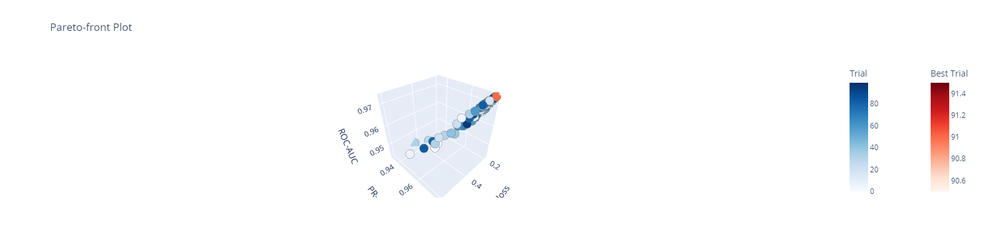

Optimization Progress: 100%|##########| 100/100 [2:59:34<00:00, 107.75s/it]


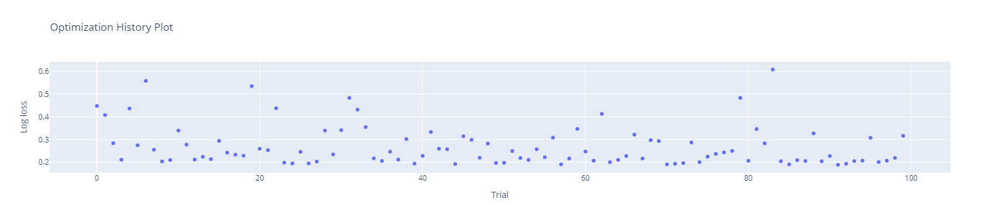

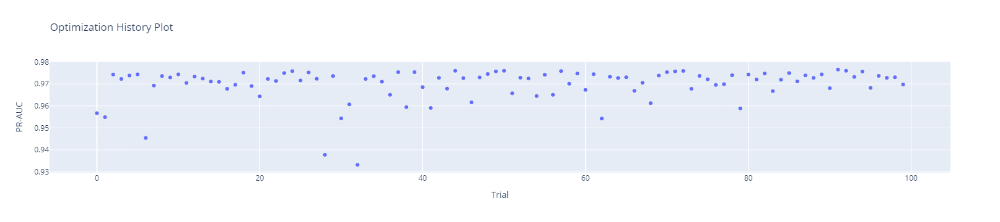

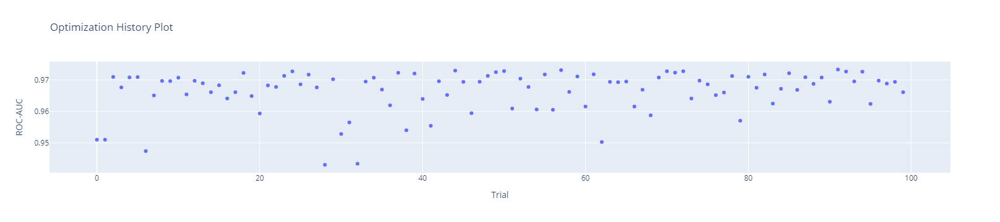

<span style = 'font-size: 18px; font-weight: bold;'> Training with Best Trial 91 </span>

Full_params: {'objective': 'Logloss', 'eval_metric': 'Logloss', 'custom_metric': ['AUC', 'PRAUC'], 'random_seed': 42, 'thread_count': -1, 'verbose': True, 'allow_writing_files': False, 'bootstrap_type': 'Bernoulli', 'subsample': 0.8903206126906871, 'grow_policy': 'Lossguide', 'posterior_sampling': False, 'model_shrink_mode': 'Constant', 'iterations': 89, 'learning_rate': 0.08799821484684099, 'l2_leaf_reg': 0.26486908504555773, 'random_strength': 0.8218257282282394, 'depth': 11, 'min_data_in_leaf': 46, 'has_time': False, 'rsm': 0.8824980018648074, 'leaf_estimation_method': 'Gradient', 'leaf_estimation_backtracking': 'No', 'fold_len_multiplier': 3.6584072693303096, 'auto_class_weights': 'SqrtBalanced', 'boost_from_average': False, 'allow_const_label': True, 'score_function': 'L2', 'border_count': 165, 'max_leaves': 48}
0:	learn: 0.5885022	total: 427ms	remaining: 37.5s
1:	learn: 0.5083766	total: 774ms	remaining: 33.7s
2:	learn: 0.4461774	total: 1.12s	remaining: 32s
3:	learn: 0.3964089	tot

In [39]:
trial_progress = tqdm(total = n_trials, desc = "Optimization Progress", leave = True,
                      ascii = True,  # Plain text mode
                      dynamic_ncols = True   # Auto-fit width
                     )

def update_progress(study_cbc, trial):
    trial_progress.update(1)

# Disable Optuna's stdout handler so notebook isn’t spammed
optuna.logging.disable_default_handler()

# Enable propagation to Python’s logging
optuna.logging.enable_propagation()
optuna.logging.set_verbosity(optuna.logging.DEBUG)

# Configure Python logging
logging.basicConfig(filename = "optuna_debug_CatBoostClassifier.log", filemode = "w", level = logging.DEBUG, format="%(asctime)s %(levelname)s %(message)s")

study_cbc = optuna.create_study(study_name = "Optuna for CatBoostClassifier",
                                directions = ["minimize", "maximize", "maximize"],
                                sampler = module.AutoSampler(seed = seed)
                               )

start_optuna = time.perf_counter()
study_cbc.optimize(objective, n_trials = n_trials, n_jobs = 1, callbacks = [update_progress])
end_optuna = time.perf_counter()
print(f'Optuna Optimization Elapsed Time: {end_optuna - start_optuna} seconds')

gc.collect()

fig = plot_pareto_front(study_cbc, target_names = ["Log loss", "PR-AUC", "ROC-AUC"])
fig.update_layout(width = 900, height = 400)
fig.show()

trial_progress.close()

# Plot optimization history for each objective
metrics = ["Log loss", "PR-AUC", "ROC-AUC"]
for i, obj in enumerate(metrics):
    optuna.visualization.plot_optimization_history(study_cbc,
                                                   target = lambda t: t.values[i],  # Correctly target each objective
                                                   target_name = obj).show()

best_trials = study_cbc.best_trials
best_trials_cbc = {}

exec_time_cbc, lloss_auc_train_cbc, lloss_auc_test_cbc, all_metrics = [],[], [], []
cm_cbc_all, cm_labels_cbc_all = [],[]

# Prepare the data - 80% training set and 20% test set
train_pool_all = Pool(X_train, y_train, cat_features = cat_cols)
test_pool_all = Pool(X_test, y_test, cat_features = cat_cols)

for i, trial in enumerate(best_trials):

    display(Markdown(f"<span style = 'font-size: 18px; font-weight: bold;'> Training with Best Trial {trial.number} </span>"))

    best_params = trial.params

    display(HTML(best_params.__repr__()))

    # Non-optimized and best Optuna optimized parameters
    full_params = {"objective": "Logloss",
                   "eval_metric": "Logloss",
                   "custom_metric": ["AUC", "PRAUC"],                
                   "random_seed": seed,
                   "thread_count": -1,
                   "verbose": True,              
                   "allow_writing_files": False,
                   **best_params
                  }      
    print("Full_params:", full_params)  
    best_trials_cbc[trial.number] = full_params

    # https://catboost.ai/docs/en/references/training-parameters/common#auto_class_weights
    # https://catboost.ai/docs/en/references/training-parameters/performance
    final_cbc = CatBoostClassifier(**full_params)

    start_train = time.perf_counter()
    final_cbc.fit(train_pool_all) 
    end_train = time.perf_counter()
   
    print(f'Training Elapsed Time: {end_train - start_train} seconds') 

    y_prob_all = final_cbc.predict_proba(X_test)[:, 1]      
    y_pred_all = final_cbc.predict(X_test)  

    print(f'Log loss: (Train) {trial.values[0]} vs (Test) {log_loss(y_test, y_prob_all)}')
    print(f'PR-AUC:   (Train) {trial.values[1]} vs (Test) {average_precision_score(y_test, y_prob_all)}')
    print(f'ROC-AUC:  (Train) {trial.values[2]} vs (Test) {roc_auc_score(y_test, y_prob_all)}')

    exec_time_cbc.append({"Classifier": "CatBoostClassifier",
                          "Best Trial": trial.number,
                          "Optimization Elapsed Time (s)": end_optuna - start_optuna,
                          "Training Elapsed Time (s)": end_train - start_train})

    lloss_auc_train_cbc.append({"Classifier": "CatBoostClassifier",
                                "Best Trial": trial.number,
                                "Set": "Training",
                                "Log loss": trial.values[0], 
                                "PR-AUC": trial.values[1],                       
                                "ROC-AUC": trial.values[2]})

    lloss_auc_test_cbc.append({"Classifier": "CatBoostClassifier",
                               "Best Trial": trial.number,
                               "Set": "Test",
                               "Log loss": log_loss(y_test, y_prob_all), 
                               "PR-AUC": average_precision_score(y_test, y_prob_all), 
                               "ROC-AUC": roc_auc_score(y_test, y_prob_all)})
    
    report = classification_report(y_test, y_pred_all, target_names = ["Safe", "Risky"], output_dict = True)
    all_metrics.append({"Classifier": "CatBoostClassifier",
                        "Trial": trial.number,
                        "Accuracy": accuracy_score(y_test, y_pred_all),
                        "Precision (Safe)": report["Safe"]["precision"],
                        "Recall (Safe)": report["Safe"]["recall"],
                        "F1-score (Safe)": report["Safe"]["f1-score"],
                        "Precision (Risky)": report["Risky"]["precision"],
                        "Recall (Risky)": report["Risky"]["recall"],
                        "F1-score (Risky)": report["Risky"]["f1-score"],
                        "Precision (Macro avg)": report["macro avg"]["precision"],
                        "Recall (Macro avg)": report["macro avg"]["recall"],
                        "F1-score (Macro avg)": report["macro avg"]["f1-score"],
                        "Precision (Weighted avg)": report["weighted avg"]["precision"],
                        "Recall (Weighted avg)": report["weighted avg"]["recall"],
                        "F1-score (Weighted avg)": report["weighted avg"]["f1-score"]})
    
    # Store confusion matrix
    cm_final_cbc = confusion_matrix(y_test, y_pred_all)
    cm_cbc_all.append(cm_final_cbc)
    cm_labels_cbc_all.append(f'CatBoostClassifier Confusion Matrix for Best Trial {trial.number}')  # Store label for subplots                                      
            
df_metrics_cbc = pd.DataFrame(all_metrics)    

gc.collect();

In [40]:
save_results(clf_name = "CatBoostClassifier",
             best_trials = best_trials_cbc,
             exec_time = exec_time_cbc,
             lloss_auc_train = lloss_auc_train_cbc,
             lloss_auc_test = lloss_auc_test_cbc,
             df_metrics = df_metrics_cbc,
             cm_final = cm_final_cbc,
             cm_all = cm_cbc_all,
             cm_labels = cm_labels_cbc_all)

# Comparison (best trials)
- Parameters
- Mutli-objectives
- Classification report
- Confusion matrices
- Elapsed times

In [41]:
# List of classifiers for downstream processing
clfs = ["LGBM", "HistGradientBoostingClassifier", "CatBoostClassifier", "XGBClassifier"]

## Parameters

In [42]:
# List of JSON files and classifier names
json_files = [{"file": "best_trials_LGBM.json", "clf": "LGBMClassifier"},
              {"file": "best_trials_HistGradientBoostingClassifier.json", "clf": "HistGradientBoostingClassifier"},
              {"file": "best_trials_CatBoostClassifier.json", "clf": "CatBoostClassifier"},
              {"file": "best_trials_XGBClassifier.json", "clf": "XGBClassifier"}
             ]

# Dictionary to store the combined data
all_records = {}

# Read and process JSON files
for item in json_files:
    file_path = os.path.join(temp_dir, item["file"])
    clf_name = item["clf"]
    
    with open(file_path, "r") as f:
        data = json.load(f)
    
    # Store parameters for each model and trial in the dictionary
    for trial_num, params in data.items():
        all_records[(clf_name, trial_num)] = params

# Show all rows without truncation
pd.set_option("display.max_rows", None)  

display(pd.DataFrame(all_records))

# Default setting
pd.reset_option("display.max_rows")

LGBMClassifier  \
                                                                    68   
objective                                                       binary   
metric                        [binary_logloss, auc, average_precision]   
device_type                                                        cpu   
verbosity                                                            2   
random_state                                                        42   
deterministic                                                     True   
bagging_seed                                                        42   
feature_fraction_seed                                               42   
drop_seed                                                           42   
force_col_wise                                                    True   
num_threads                                                         -1   
max_depth                                                           -1   
boosting_type                                                     gbdt   
lambda_l1                                                     0.001799   
lambda_l2                                                          0.0   
num_leaves                                                          81   
feature_fraction                                              0.852907   
bagging_fraction                                              0.723172   
bagging_freq                                                         6   
min_child_samples                                                   28   
learning_rate                                                 0.074913   
is_unbalance                                                      True   
max_bin                                                            184   
min_sum_hessian_in_leaf                                         0.0052   
max_delta_step                                               40.700039   
feature_fraction_bynode                                       0.952448   
num_boost_round                                                     88   
loss                                                               NaN   
verbose                                                            NaN   
categorical_features                                               NaN   
max_iter                                                           NaN   
max_leaf_nodes                                                     NaN   
min_samples_leaf                                                   NaN   
l2_regularization                                                  NaN   
class_weight                                                       NaN   
max_features                                                       NaN   
max_bins                                                           NaN   
interaction_cst                                                    NaN   
warm_start                                                         NaN   
eval_metric                                                        NaN   
custom_metric                                                      NaN   
random_seed                                                        NaN   
thread_count                                                       NaN   
allow_writing_files                                                NaN   
bootstrap_type                                                     NaN   
subsample                                                          NaN   
grow_policy                                                        NaN   
posterior_sampling                                                 NaN   
model_shrink_mode                                                  NaN   
iterations                                                         NaN   
l2_leaf_reg                                                        NaN   
random_strength                                                    NaN   
depth                                                       

## Multi-objectives
- log-loss, PR-AUC, ROC-AUC

In [43]:
# Combine training/test performance metrics CSVs
lloss_auc_train_df = pd.concat([pd.read_csv(f'{temp_dir}/lloss_auc_train_{clf}.csv') for clf in clfs], ignore_index = True)
lloss_auc_test_df = pd.concat([pd.read_csv(f'{temp_dir}/lloss_auc_test_{clf}.csv') for clf in clfs], ignore_index = True)
lloss_auc_df = pd.concat([lloss_auc_train_df, lloss_auc_test_df], ignore_index = True).sort_values(by = ["Classifier", "Best Trial", "Set"], 
                                                                                                   ascending=[False, True, False]).reset_index(drop = True)

# Reshape to long format
df_long = lloss_auc_df.melt(id_vars = ["Classifier", "Best Trial", "Set"],
                            value_vars = ["Log loss", "PR-AUC", "ROC-AUC"],
                            var_name = "Metric",
                            value_name = "Score")

# Combine Classifier+Trial label for x-axis
df_long["Classifier_Trial"] = df_long["Classifier"] + " (Trial " + df_long["Best Trial"].astype(str) + ")"

fig = px.bar(df_long, x = "Classifier_Trial", y = "Score",
             color = "Set", barmode = "group", facet_col = "Metric",
             text = "Score",              
             color_discrete_map = {"Training": "#56B4E9", "Test": "#009E73"},
             facet_col_spacing = 0.04 # Increase facet spacing
            )

# Format numbers on bars
fig.update_traces(texttemplate = "%{text:.3f}", textposition = "outside")

# Independent y-axes for each facet
fig.update_yaxes(matches = None, showticklabels = True, showgrid = True)

# Remove "Classifier_Trial" from x-aixs title
fig.update_xaxes(title_text = None)

# Remove all y-axis titles, then add only for the first facet
fig.update_yaxes(title_text = None)
fig.layout["yaxis"].title.text = "Score"

# Title and layout tweaks
fig.update_layout(height = 600, width = 1600, title = dict(text = "Classifier Performance (Train vs Test Across Metrics and Best Trials)", 
                                                           x = 0.5, xanchor = "center", yanchor = "top",
                                                           font = dict(size = 20, family = "Arial", color = "black", weight = "bold")),
                  legend_title = dict(text = "Set", side = "top"),
                  legend = dict(orientation = "v", x = 1.04, xanchor = "center", y = 0.9, yanchor = "bottom"),
                  margin = dict(t = 80, b = 40)
                 )

# Remove "Metric=" from facet titles
fig.for_each_annotation(lambda a: a.update(text = a.text.split("=")[-1]))

# Custom intervals for y-axis
fig.layout["yaxis1"].range = [0.18, 0.23]   # PR-AUC facet
fig.layout["yaxis2"].range = [0.96, 0.98]   # PR-AUC facet
fig.layout["yaxis3"].range = [0.96, 0.98]   # ROC-AUC facet

fig.show();

display(lloss_auc_df)

del lloss_auc_train_df, lloss_auc_test_df, lloss_auc_df, df_long, fig;

,Classifier,Best Trial,Set,Log loss,PR-AUC,ROC-AUC
0,XGBClassifier,65,Training,0.187296,0.976407,0.973166
1,XGBClassifier,65,Test,0.192752,0.975963,0.972528
2,XGBClassifier,76,Training,0.188652,0.976516,0.973094
3,XGBClassifier,76,Test,0.194125,0.976004,0.972184
4,LGBM,68,Training,0.186913,0.976984,0.973562
5,LGBM,68,Test,0.193374,0.975140,0.971766
6,HistGradientBoostingClassifier,69,Training,0.211290,0.971433,0.966883
7,HistGradientBoostingClassifier,69,Test,0.221352,0.967821,0.962714
8,CatBoostClassifier,91,Training,0.189004,0.976552,0.973292
9,CatBoostClassifier,91,Test,0.193193,0.975743,0.972252


The grouped bar chart above compares the training and test performance of 4 tree-based classifiers (two XGBoost variants, LightGBM, HistGradientBoostingClassifier and CatBoostClassifier) based on the best trial selected from the multi-objective 5-fold, 100-trial Optuna optimization. The metrics reported include log-loss as a calibration measure, and PR-AUC and ROC-AUC as discriminative measures.

A lower log-loss indicates that the model’s predicted probabilities align more closely with the actual outcomes, reflecting both well-calibrated probability estimates and improved predictive accuracy. In contrast, PR-AUC and ROC-AUC assess the model’s ability to distinguish between safe and risky loans across decision thresholds, with higher values indicating stronger discriminative power. A smaller train–test gap across these metrics suggests better generalization to unseen data and reduced risk of overfitting.

Looking first at the two XGBoost models i.e. *Trial 65* and *Trial 76*, both perform at nearly identical levels, with very strong discriminative power (PR-AUC $\approx 0.976$, ROC-AUC $\approx 0.972$) and competitive calibration (test log-loss $\approx 0.193 - 0.194$). Their train–test gaps are exceptionally small i.e. \$<0.001\$ for both PR-AUC and ROC-AUC, and $\approx 0.005 - 0.006$ in log-loss. Between the two, XGBoost *Trial 65* has a slight edge, with marginally lower test log-loss (0.1928 vs. 0.1941) and higher ROC-AUC (0.9725 vs. 0.9722), making it the more robust choice.

CatBoostClassifier and LightGBM also achieve strong results, clearly outperforming HistGradientBoostingClassifier. CatBoostClassifier, in particular, records one of the lowest test log-loss values ($\approx 0.1932$) and maintains excellent AUCs (PR-AUC $\approx 0.9757$, ROC-AUC $\approx 0.9723$), though with slightly larger train–test gaps than XGBoost *Trial 65*. LightGBM is similarly competitive, with strong calibration (test log-loss $\approx 0.1934$) and high discriminative power (PR-AUC $\approx 0.9751$, ROC-AUC $\approx 0.9718$), though its train–test gaps are larger still.

In contrast, the HistGradientBoostingClassifier performs noticeably worse. Its test log-loss ($\approx 0.2214$) is substantially higher, and both PR-AUC ($\approx 0.9678$) and ROC-AUC ($\approx 0.9627$) are lower than the other models. This highlights its weaker calibration and discrimination.

Taken together, **XGBoost Trial 65** demonstrates the best overall balance of calibration, discriminative performance and generalization, with CatBoostClassifier and LightGBM as strong alternatives that also clearly outperform HistGradientBoostingClassifier.

So when these numbers are put in context for **XGBoost Trial 65**, the test *log-loss* of $\approx 0.193$ means that when the model assigns a loan a $\approx 19.3\%$ probability of being risky, the actual proportion of loans that the model scores at  $\approx 19.3\%$ tends to be close to  19.3% in reality. The test *PR-AUC* of  $\approx 0.976$ shows the model is performing at  $\approx 97.6\%$ of the best possible performance. In other words, it’s almost perfect at finding risky loans while making very few mistakes in wrongly flagging safe loans as risky, and it balances this well across different probability thresholds. Finally, the test *ROC-AUC* of  $\approx 0.973$ means that if we randomly select one safe and one risky loan, the model will correctly give the risky loan a higher risk score  $\approx 97.3\%$ of the time, regardless of where the decision threshold is set.

## Classification reports

In [44]:
# Combine classification report CSVs
metrics_df = pd.concat([pd.read_csv(f'{temp_dir}/df_metrics_{clf}.csv') for clf in clfs], ignore_index = True)

# Custom order of metrics
ordered_metrics = ["Accuracy",
                   "Precision (Safe)", "Precision (Risky)", "Precision (Macro avg)", "Precision (Weighted avg)",
                   "Recall (Safe)", "Recall (Risky)", "Recall (Macro avg)", "Recall (Weighted avg)",
                   "F1-score (Safe)", "F1-score (Risky)", "F1-score (Macro avg)", "F1-score (Weighted avg)"]

metrics_df["Classifier_Trial"] = metrics_df["Classifier"] + " (Trial " + metrics_df["Trial"].astype(str) + ")"

df_long = metrics_df.melt(id_vars=["Classifier_Trial"], value_vars = ordered_metrics,
                          var_name = "Metric", value_name = "Score")

fig = px.bar(df_long, x = "Metric", y = "Score",
             color = "Classifier_Trial", barmode = "group",
             category_orders = {"Metric": ordered_metrics},
            )

fig.update_layout(height = 600, width = 1600, 
                  title = dict(text = "Classifier Comparison Across Metrics (Best Trials)", 
                               x = 0.5, xanchor = "center", yanchor = "top",
                               font = dict(size = 20, family = "Arial", color = "black", weight = "bold")),
                  legend_title = None,
                  xaxis_tickangle = -45, template = "plotly_white",
                  yaxis = dict(range=[0.84, 0.98])
                 )

fig.show();

display(metrics_df.drop(columns = "Classifier_Trial"))

del metrics_df, ordered_metrics, df_long, fig;

,Classifier,Trial,Accuracy,Precision (Safe),Recall (Safe),F1-score (Safe),Precision (Risky),Recall (Risky),F1-score (Risky),Precision (Macro avg),Recall (Macro avg),F1-score (Macro avg),Precision (Weighted avg),Recall (Weighted avg),F1-score (Weighted avg)
0,LGBM,68,0.919215,0.879867,0.973122,0.924148,0.969155,0.864062,0.913597,0.924511,0.918592,0.918872,0.924001,0.919215,0.918933
1,HistGradientBoostingClassifier,69,0.913346,0.869317,0.975260,0.919246,0.971082,0.850000,0.906516,0.920199,0.912630,0.912881,0.919618,0.913346,0.912953
2,CatBoostClassifier,91,0.921841,0.880848,0.977703,0.926752,0.974296,0.864688,0.916225,0.927572,0.921195,0.921488,0.927038,0.921841,0.921549
3,XGBClassifier,65,0.919370,0.878855,0.974954,0.924414,0.971147,0.862500,0.913605,0.925001,0.918727,0.919009,0.924473,0.919370,0.919071
4,XGBClassifier,76,0.918134,0.878378,0.972816,0.923188,0.968750,0.862187,0.912368,0.923564,0.917502,0.917778,0.923048,0.918134,0.917840


At first glance, **CatBoostClassifier** stands out on the grouped bar chart because it shows the strongest classification report metrics overall i.e. accuracy, precision, recall, F1-score and both macro and weighted averages.

However, the most important question here is how well a model can catch risky loans, because missing them means real financial loss. On this point, CatBoostClassifier reports a recall on risky loans of $\approx 0.8647\$, which is very slightly lower than LightGBM's \$\approx 0.8641\$, but the difference is only in the fourth decimal place, essentially negligible in practice. In other words, both models correctly flag about 86 out of every 100 risky loans when using the standard 0.5 decision threshold.

It's worth noting that both CatBoostClassifier and LightGBM used class reweighting. LightGBM was tuned with `is_unbalance = True`, which applies a relatively strong weighting scheme by directly up-weighting risky loans. This often improves recall on the minority class but can also slightly reduce precision because the model becomes more aggressive in labeling loans as risky. CatBoostClassifier, in contrast, was tuned with `auto_class_weights = SqrtBalanced`, which applies a softer adjustment (inverse square-root of class frequencies). This's less aggressive than LightGBM’s scheme and tends to yield a more balanced trade-off between precision and recall.

Importantly, the choice of these weighting parameters reflects Optuna’s multi-objective optimization rather than true dataset imbalance. Even though the folds were nearly 1:1 balanced, Optuna favoured configurations with weighting because they slightly improved log-loss through better probability calibration and PR-AUC by enhancing sensitivity to risky loans. In this setting, class-weighting acted less as an imbalance correction and more as a fine-tuning mechanism that interacted with other hyperparameters to achieve marginal but meaningful gains in the combined objectives.

Despite this, CatBoostClassifier still edges out LightGBM overall, nearly matching it on risky recall ($\approx 0.8647$ vs $\approx 0.8641$) while clearly dominating on other key metrics like accuracy, precision, F1-score, both macro and weighted averages. This suggests that CatBoostClassifier benefits from weighting but does so in a way that preserves stability and avoids overcompensating. Its macro and weighted recall scores are also strong at $\approx 0.9212$ and $\approx 0.9218$, showing that it treats both safe and risky loans fairly well. Moreover, the model also shows the same level of consistency between training and test sets on the optimization metrics in log-loss, PR-AUC and ROC-AUC, suggesting its predictions are better calibrated and more likely to generalize well in practice.

Breaking down the numbers:
* Accuracy ($\approx 92.2\%$): Out of every 100 loans, CatBoostClassifier correctly flags $\approx 92$ as risky or safe.
* Safe loans:
  * Precision ($\approx 88.1\%$): When CatBoostClassifier says a loan is safe, it’s right ($\approx 88$) times out of 100.
  * Recall ($\approx 97.8\%$): Out of 100 genuinely safe loans, CatBoostClassifier correctly classifies ($\approx 98$) and misclassifies ($\approx 2$).
  * F1-score ($\approx 92.7\%$): Strong balance, showing it captures the majority of safe loans while avoiding unnecessary misclassifications.
* Risky loans:
  * Precision ($\approx 97.4\%$): When the model classifies a loan as risky, ($\approx 97$) in 100 are truly risky. Very few safe loans are mislabeled as risky.
  * Recall ($\approx 86.5\%$): Out of 100 truly risky loans, it catches about ($\approx 87$), with ($\approx 13$) slipping through incorrectly as safe.
  * F1-score ($\approx 91.6\%$): Shows a solid balance between catching risky loans and maintaining precision.
    
Looking at the averages:
* Macro precision ($\approx 92.8\%$) | Macro recall ($\approx 92.1\%$): Strong fairness, treating safe and risky loans equally well.
* Weighted precision ($\approx 92.7\%$) | Weighted recall ($\approx 92.2\%$): In real-world distributions, where datasets usually have far more safe loans, CatBoostClassifier still achieves the same levels of performance.

Summary:
* Both CatBoostClassifier and LightGBM use class weighting, but CatBoostClassifier applies a softer scheme (`SqrtBalanced`) that promotes balance rather than aggressiveness.
* CatBoostClassifier correctly classifies most safe loans and most risky loans, with particularly strong reliability when labeling risky loans (precision $\approx 97.4\%$).
* Its recall for risky loans ($\approx 86.5\%$) means it can identify the majority of high-risk loans, reducing the chance that risky loans are misclassified as safe.
* Its macro and weighted averages ($\approx 92\% - 93\%$) highlight that it treats both loan classes fairly.
* Its optimization consistency (log-loss, PR-AUC, ROC-AUC) suggests well-calibrated predictions and better generalization in practice.
* Optuna’s selection of weighting parameters, despite near-balanced folds, shows that subtle reweighting can still improve calibration and discrimination, reinforcing why CatBoostClassifier is the strongest overall choice.

## Confusion matrices

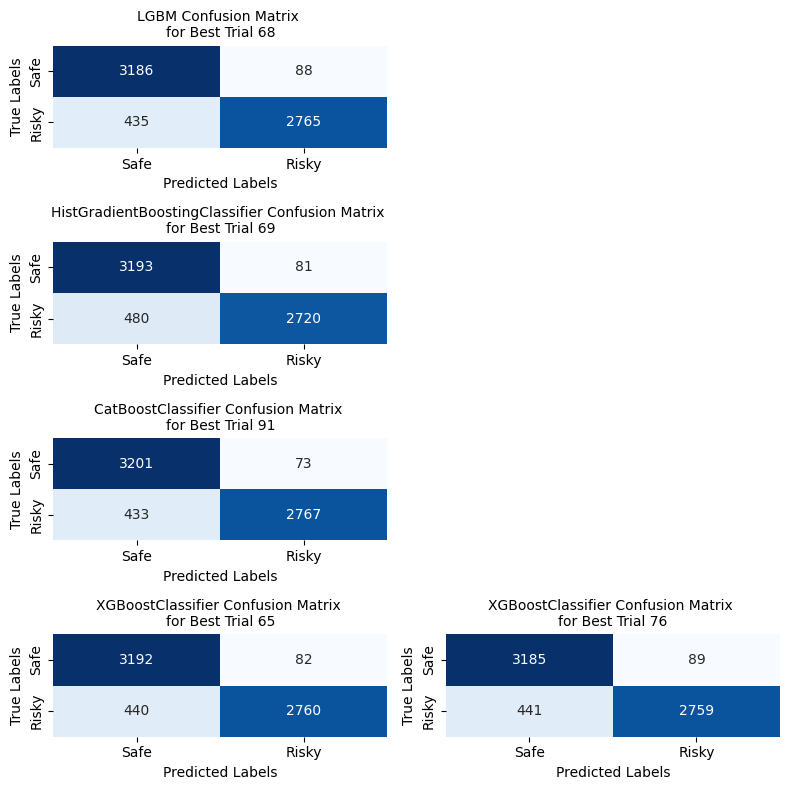

In [45]:
# Load confusion matrices and their labels 
grouped_matrices = []
grouped_labels = []

for clf in clfs:
    with open(f'{temp_dir}/cm_{clf}_all.pkl', "rb") as f:
        cm_all = pickle.load(f)
    with open(f'{temp_dir}/cm_labels_{clf}_all.pkl', "rb") as f:
        cm_labels = pickle.load(f)

    grouped_matrices.append(cm_all)
    grouped_labels.append(cm_labels)

# Plot confusion matrices
# Determine grid size: one row per classifier, columns = maximum number of matrices among classifiers
num_classifiers = len(grouped_matrices)
max_cols = max(len(cm_list) for cm_list in grouped_matrices)

# Subplots grid (rows = classifiers, cols = matrices) with size scaled for readability
fig, axes = plt.subplots(num_classifiers, max_cols, figsize = (4 * max_cols, 2 * num_classifiers))

# Ensure axes is a 2D array
if num_classifiers == 1:
    axes = [axes]
if max_cols == 1:
    axes = [[ax] for ax in axes]

# For each classifier group, plot all its confusion matrices along one row
for row_idx, (cm_list, label_list, row_axes) in enumerate(zip(grouped_matrices, grouped_labels, axes)):
    for col_idx in range(max_cols):
        if col_idx < len(label_list) and col_idx < len(cm_list):
            ax = row_axes[col_idx]
            sns.heatmap(cm_list[col_idx], annot = True, fmt = "d", cmap = "Blues",
                        ax = ax, cbar = False, annot_kws = {"size": 10})
            # Update title and axis labels (introducing newline for clarity)
            ax.set_title(label_list[col_idx].replace("for Best Trial", "\nfor Best Trial"), fontsize = 10)
            ax.set_xlabel("Predicted Labels", fontsize = 10)
            ax.set_ylabel("True Labels", fontsize = 10)
            ax.set_xticklabels(["Safe", "Risky"], fontsize = 10)
            ax.set_yticklabels(["Safe", "Risky"], fontsize = 10)
        else:
            row_axes[col_idx].axis('off')  # Hide empty subplot

plt.tight_layout()
plt.show()

del grouped_matrices, grouped_labels, num_classifiers, max_cols, fig, axes;

When looking at the confusion matrices of the best trials, it’s clear that in loan risk models, false negatives are especially costly. They represent risky loans wrongly classified as safe, which can directly translate into financial losses. Using the standard decision threshold of 0.5, **CatBoostClassifier** reports the lowest number of false negatives (433), slightly better than LightGBM (435) and ahead of both XGBoost (440–441) and HistGradientBoostingClassifier (480).

At the same time, CatBoostClassifier also produces the fewest false positives (73), meaning it avoids unnecessarily misclassifying safe loans as risky. By contrast, LightGBM makes 88 false positives, XGBoost 82–89 and HistGradientBoostingClassifier 81. This combination of strong recall on risky loans with minimal false alarms gives CatBoostClassifier the clearest edge among the models.

HistGradientBoostingClassifier performs notably worse at this threshold, allowing nearly 480 risky loans through incorrectly. XGBoost is stronger, but it still lags behind CatBoostClassifier by permitting more risky loans to slip through and by flagging more safe loans incorrectly.

Overall, **CatBoostClassifier** provides the best trade-off at the conventional 0.5 threshold. It captures the majority of risky loans while keeping false positives very low, which both protects the bank from defaults and preserves customer relationships by not unfairly labeling safe loans as risky. Importantly, Optuna’s optimization tuned CatBoostClassifier with `auto_class_weights = SqrtBalanced` and LightGBM with `is_unbalance = True`. While both involve class reweighting, CatBoostClassifier’s softer square-root scheme achieves a more balanced outcome, suggesting its results are not only competitive but also more stable and better calibrated in practice.

## Elapsed times

In [46]:
# Combine execution time CSVs
exec_time_df = pd.concat([pd.read_csv(f'{temp_dir}/exec_time_{clf}.csv') for clf in clfs], ignore_index = True)

display(exec_time_df);

del exec_time_df;

,Classifier,Best Trial,Optimization Elapsed Time (s),Training Elapsed Time (s)
0,LGBM,68,1416.186557,3.886080
1,HistGradientBoostingClassifier,69,1254.363137,3.126119
2,CatBoostClassifier,91,10774.411937,27.940682
3,XGBClassifier,65,14523.852434,2.708413
4,XGBClassifier,76,14523.852434,3.324781


In my setup, Optuna optimization and model training were run only on the CPU of my personal laptop. With these limited resources, models such as LightGBM and HistGradientBoosting were very efficient, completing training in just a few seconds and finishing optimization in $\approx 20$ minutes ($\approx 1,250 – 1,400$ seconds). CatBoostClassifier, on the other hand, required noticeably more time per training run, close to half a minute, and its full optimization stretched into several hours ($> 10,000$ seconds). XGBoost’s individual training runs were as fast as LightGBM and HistGradientBoostingClassifier, but the overall optimization process was by far the slowest, taking $> 4$ hours ($>14,000$ seconds). This slowdown was mainly due to Optuna exploring a larger and more complex hyperparameter space, which caused the optimization process to balloon far beyond the actual training time. On this kind of hardware, LightGBM appeared to be the most practical choice for speed.

These results, however, reflect the limits of personal hardware more than the true capabilities of the algorithms. Large organizations, especially banks, rely on advanced IT infrastructure with powerful servers, far more memory, and distributed frameworks that handle demanding machine learning workloads efficiently. In such environments, runtime differences between LightGBM, CatBoostClassifier and XGBoost become much smaller because the infrastructure is built for scale and speed.

That’s why I believe the focus should be on predictive performance rather than raw training time. In financial risk modeling, accuracy is what prevents losses. CatBoostClassifier has consistently shown stronger and more balanced predictive performance without the need for artificial weighting adjustments. While it ran more slowly on my laptop, in an enterprise IT setting the runtime disadvantage would no longer be a major concern. What ultimately matters is CatBoostClassifier’s ability to classify safe and risky loans accurately, which makes it the better choice.

# Overall Review  

## Context and Model Choice  
When I tested models on my personal laptop, some models such as LightGBM and HistGradientBoostingClassifier ran very fast while others like CatBoostClassifier and XGBoost felt slower. This difference was really more about the limits of my laptop than the models themselves.  

In a bank or corporation setting, models are normally trained on much more powerful machines with far greater processing power. On that type of setup, the slower models also run fast enough to be practical.  

During optimization, LightGBM produced repeated warnings such as "No further splits with positive gain" until the later trials. This's normal behavior when the algorithm cannot find additional useful splits. The warnings diminished toward the end and did not affect overall performance as shown by the small train–test gap in log-loss, PR-AUC and ROC-AUC.

For the modelling phase, the binary target is the loan’s *current status*, derived from a nominal feature and encoded so one class represents safe loans and the other represents risky loans. The important point here is that in this dataset the ratio of safe to risky loans is roughly equal, about one to one. Because of this balance, accuracy is a meaningful metric when comparing models. At the same time recall for risky loans is still especially important from a business perspective because missing those loans has greater financial consequences.  

So for me, the real question is not about speed but about which model provides the most reliable results while also recognizing that banks and regulators may require other measures for compliance and specific best practices, which go beyond my current knowledge. A good model should catch risky loans, treat safe loans fairly, produce risk scores that can be trusted, and be easy to explain when someone asks why a particular decision was made. Across these points, **CatBoostClassifier** stands out as the best overall choice.  

## Strengths and Limitations of CatBoostClassifier  

**Strengths**  
- Finds risky loans effectively without being overly harsh on safe ones  
- Handles different kinds of data naturally such as numbers, categories, and yes or no answers  
- Produces probabilities that are usually well-aligned with real outcomes  
- Includes tools such as feature importance and SHAP to help explain what drives predictions  
- Runs efficiently once used on enterprise‑level systems  

**Limitations**  
- Appears slower when run only on a small personal machine  
- Requires subject matter expert (SME) input to make sure the data used makes sense in a business and compliance setting  
- Needs periodic updates to stay reliable, such as tuning thresholds or retraining  
- Can become too complex if too many engineered features are added without proper discipline  
- Like any model, accuracy will decline over time if data drift occurs, for example when borrower behavior, inputs or their relationships change

## Data and Feature Engineering  
Adding richer and more varied data can improve the model’s ability to detect risk. Examples include loan usage patterns, broader economic conditions, ratios such as debt to income or balance to limit, and inputs from other trusted external sources.  

It's important to work with SMEs so that chosen features are not only predictive but also reasonable, explainable and compliant with business rules and regulatory expectations. Proper tracking and clear documentation of why each feature and data source included, make the model easier to explain and ensure traceability for audits.  

## Adjusting the Decision Threshold  
By default models apply a 50% cutoff where anything above is labeled risky and anything below is labeled safe. In lending though, missing a risky loan which is a false negative is generally much more costly than incorrectly flagging a safe loan as risky which is a false positive.  

So keeping the threshold fixed at 50% may not be the best option. For example lowering it to 40% would capture more risky loans but would incorrectly flag more safe loans. Raising it would cut down on false positives but would cause more risky loans to slip through.  

The best threshold is about finding the right balance for the business and aligning it with its appetite for financial risk. This should be reviewed regularly.  

## Monitoring and Data Drift  
Over time borrower behavior, financial status, loan types and market conditions change. Because of this, models do not stay accurate forever. This is known as data drift.  

To handle this we should track changes in input data and monitor how predictions behave. Alerts should be set up if recall or accuracy drops below an agreed level. The model should be retrained with recent data every few months, or faster if the market shifts quickly, such as during a downturn. Documentation on how drift is tracked and addressed should always be maintained.  

## Fairness and Bias  
The model must treat different borrower groups fairly, across loan types, incomes or regions. This can be checked by comparing performance across these groups and ensuring no group is consistently disadvantaged.  

Borrowers should also receive a clear, plain-language explanation when their loans are no longer in good standing. Fairness is therefore not just a technical matter, but also about how decisions are communicated back to customers.

## Interpretability and Business Narratives  
It's  not enough to simply say the model makes a prediction. The reasoning needs to be explained in plain words.  

For example, instead of giving a math‑heavy explanation, one could say "Debt to income ratio was a key factor because it reflects how comfortably someone can repay".

This kind of everyday explanation makes the model easier to defend with both internal teams and external reviewers.  

## Operational Integration  
The model should work smoothly in the loan lifecycle. Sometimes a quick decision is required, while in other cases checks can be run overnight in batches. What matters most is that the system works reliably, runs efficiently and always uses correct data so that decisions are not delayed.  

Before going live, the model should also be reviewed by an independent validation team to ensure checks are not only done by the same people who built.

## Data Quality and Governance  
Even the most advanced model will fail if the inputs are messy. Data quality checks for missing values, odd values, incorrect fields or format changes are necessary. Changes should be logged and a record kept so the data can be reviewed later if questions arise. This provides a clear audit trail for transparency and regulatory trust.

## Stress Testing and Segment Stability  
The model should also be tested under tough conditions such as higher unemployment or interest rate hikes. Stress testing shows if the model still provides useful guidance when the economy is unstable.  

It's also important to check how well the model performs across different loan products such as mortgages and credit cards, and across borrower groups. A reliable model should perform consistently and not favour one group over another.  

## Human in the Loop  
The model shouldn’t decide everything on its own. Loan officers need to review predictions and override them when needed. If overrides happen often, it may signal weaknesses in the model.

## Retraining Policy  
A decision should be made in advance about how often the model will be retrained. One option is retraining every quarter which is simpler to manage. Another option is continuous updates with new data which is more responsive but harder to govern. Whatever the approach, it should be clearly documented and approved.

## Privacy and Security  
When using new external data sources, it's important to ensure the data is handled safely and kept private. Data should only be used in ways that customers and regulators would view as fair and responsible.  

## Recommendations  
- Adopt **CatBoostClassifier** as the main model  
- Use **LightGBM** as a backup or in an ensemble
- Benchmark CatBoostClassifier against other algorithms to validate that it remains the best option  
- Work with SMEs to confirm features are meaningful and compliant  
- Adjust decision thresholds regularly to balance business needs and risk appetite  
- Put in place monitoring for drift and fairness  
- Carry out stress testing and stability checks across products and groups  
- Define override rules for credit officers  
- Create a clear retraining policy and data handling guidelines  
- Keep documentation transparent for both internal and external review  

## Next Steps  
- Work with SMEs to fine-tune which data the model uses
- Test how well the model’s thresholds work and adjust if needed
- Set up a monitoring system to track fairness, data drift and how the model performs in tough situations
- Decide how often the model should be updated, every few months or more often if needed
- Agree on whether the model will make predictions instantly (real-time) or in batches (like overnight runs)
- Pilot the model on a smaller group before deploying it widely
- Explore and benchmark alternative algorithms to confirm CatBoostClassifier remains the best choice
- Use benchmarking results to validate CatBoostClassifier’s performance and meet regulatory expectations

## Closing Message  
In this case, **CatBoostClassifier** is a strong choice for telling apart safe loans from risky ones. But the algorithm by itself isn’t enough. The real value comes from managing the model carefully throughout its entire life.

That means working with SMEs to choose the right data, fine-tuning thresholds, keeping an eye on changes over time, checking that the model is fair, testing how it performs under pressure, retraining it when needed, making sure it fits smoothly into everyday processess and letting people step in to review tricky cases.

Handled this way, the bank ends up with a model that is not only accurate but also fair, easy to explain, reliable and built to last. This protects both the business and its customers over the long run.

Neverthelss, the finer details on regulations and governance would need SME and legal guidance to ensure full compliance with regulatory, authorities, business needs and maintain customer trust.

# Session Information
Log the full session environment including OS, CPU, Python version and loaded modules to support reproducibility and assist in debugging environment-specific issues.

In [47]:
import importlib
importlib.metadata.version("markupsafe")

'3.0.2'

In [48]:
display(Markdown(f"<span style = 'font-size: 18px; font-weight: bold;'> Session Information </span>"))

# https://pypi.org/project/session-info/
session_info.show(na = True, os = True, cpu = True, jupyter = True, dependencies = True,
                  std_lib = True, private = True, write_req_file = False, req_file_name = None, html = None
                 )

<span style = 'font-size: 18px; font-weight: bold;'> Session Information </span>

C:\Users\grace\AppData\Local\Programs\Python\Python311\Lib\site-packages\session_info\main.py:213: UserWarning:

The '__version__' attribute is deprecated and will be removed in MarkupSafe 3.1. Use feature detection, or `importlib.metadata.version("markupsafe")`, instead.

